In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from scipy import signal
import random

import h5py
from IPython.utils import io

In [3]:
import sys
sys.path.append('../../../../nadavp/new_trap/Tools/')
sys.path.append('../../../../nadavp/new_trap/Tools/StatFramework/')
import BeadDataFile
from discharge_tools import *

In [4]:
from likelihood_calculator import likelihood_analyser
from likelihood_calculator import GravityFramework
from likelihood_calculator import auxiliary_functions as aux
gfw = GravityFramework.GravityFramework()

sys.path.append('/home/analysis_user/New_trap_code/SensitivityFramework/')
from signal_model_utilities import *

In [5]:
%matplotlib notebook

In [6]:
%reload_ext autoreload
%autoreload 2

### prepare gravity framework

In [7]:
bdf_discharge = load_dir(dirname='/data/new_trap/20200320/Bead1/Discharge/Discharge_after_Mass_20200402/After_spinning_again_20200403/',
                         start_file=230, max_file=40)
bdf_z = bdf_discharge[5:35]

530  files in folder
40  files loaded


In [8]:
m1_zscale = gfw.build_z_response(bdf_z, drive_freq=71, charges=6, bandwidth=2, decimate=10)

***************************************************
Z2-amplitude:  2.69e+02
reduced chi2:  441.1817586557403
***************************************************
Z2-amplitude:  2.61e+02
reduced chi2:  489.11799793403105
***************************************************
Z2-amplitude:  2.74e+02
reduced chi2:  367.3568553550266
***************************************************
Z2-amplitude:  2.79e+02
reduced chi2:  442.30175900475814
***************************************************
Z2-amplitude:  2.80e+02
reduced chi2:  462.4297708849329
***************************************************
Z2-amplitude:  2.75e+02
reduced chi2:  302.2298893710947
***************************************************
Z2-amplitude:  2.69e+02
reduced chi2:  554.2181314173092
***************************************************
Z2-amplitude:  2.65e+02
reduced chi2:  657.0098909304355
***************************************************
Z2-amplitude:  2.66e+02
reduced chi2:  512.0367862216774
*****************

No height data
No cantilever data
Error loading spinning data
No laser power data
No height data
No cantilever data
Error loading spinning data
No laser power data
No height data
No cantilever data
Error loading spinning data
No laser power data


<IPython.core.display.Javascript object>


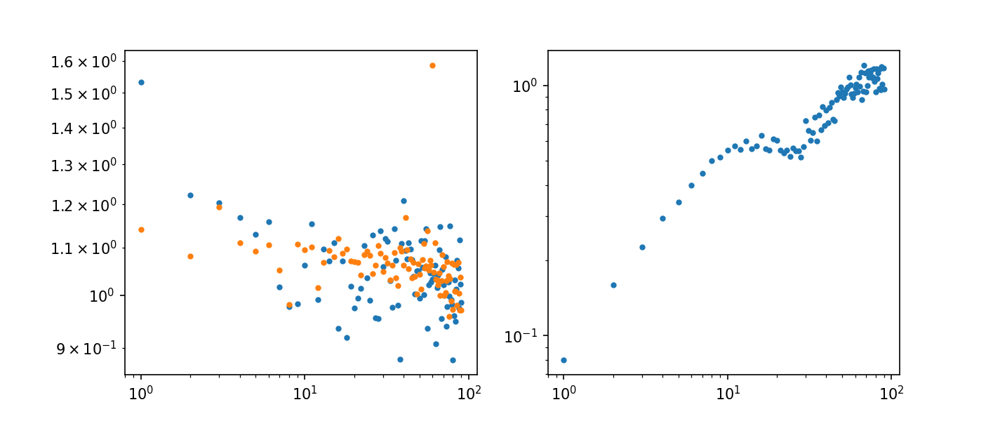

In [9]:
fname = r'/data/new_trap/20200320/Bead1/TransFunc/Repeat_TransFunc_20200104/TransFunc_X_m300k_250s_1hz.h5'
tf_x = BeadDataFile.BeadDataFile(fname)
fname = r'/data/new_trap/20200320/Bead1/TransFunc/Repeat_TransFunc_20200104/TransFunc_Y_m300k_250s_1hz.h5'
tf_y = BeadDataFile.BeadDataFile(fname)
fname = r'/data/new_trap/20200320/Bead1/TransFunc/Repeat_TransFunc_20200104/TransFunc_Z_m300k_250s_1hz.h5'
tf_z = BeadDataFile.BeadDataFile(fname)
gfw.build_transfer_function([tf_x, tf_y, tf_z], base_freq=1, number_of_harmonics=90, scale_freq=71, plot=True)

In [10]:
## 1000 files of shaking data for nose floor
data_bdfs2 = load_dir(dirname='/data/new_trap/20200320/Bead1/Shaking/Shaking2_20200403/',
                         file_prefix='NoShaking_1', start_file=0, max_file=500)

6905  files in folder
500  files loaded


In [36]:
gravity_freqs = 3*np.array([12, 11, 6, 7, 13, 9, 8, 14, 5, 2, 3, 4])
gravity_freqs = 3*np.array([12,11,14,8,7])
# gravity_freqs = 3*np.array([14])

In [32]:
noises_std =[]
for freq_ in gravity_freqs:
    tmp_list = []
    for bb in data_bdfs2:
        tmp_list.append(np.std(bb.response_at_freq2('z', drive_freq=freq_, bandwidth=2)))
    noises_std.append(np.std(tmp_list))
noises_std = np.array(noises_std)**2

<IPython.core.display.Javascript object>


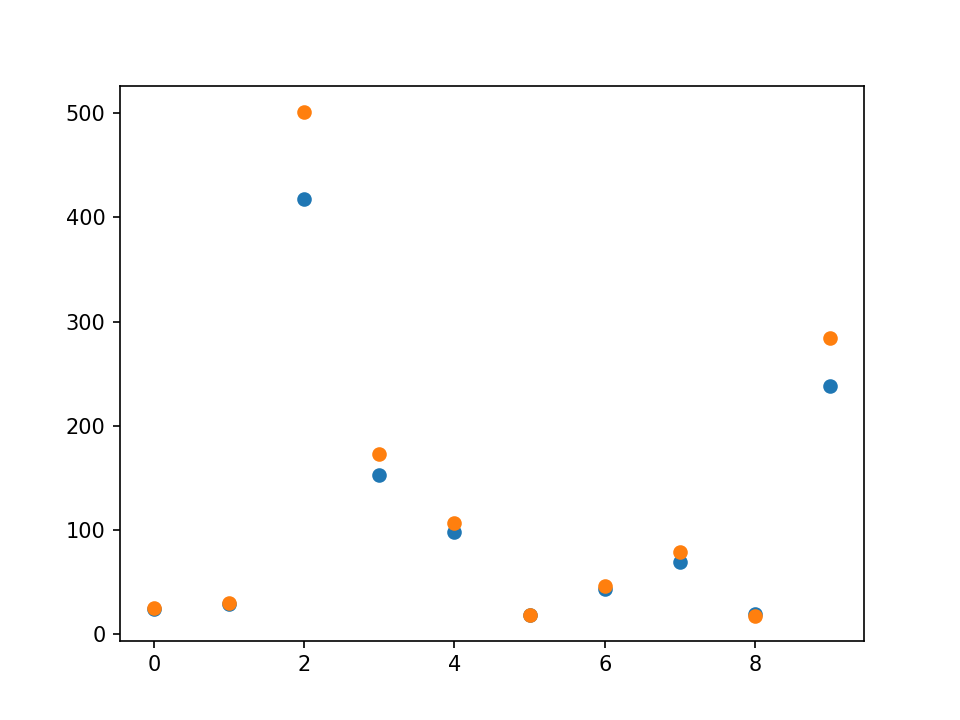

In [125]:
_,ax = plt.subplots()
ax.scatter(range(10), noises_std)
ax.scatter(range(10), noises_std2)

In [93]:
i = 100
fname = r'/data/new_trap/20200320/Bead1/Shaking/Shaking378/Shaking3_'+str(i)+'.h5'
# fname = r'/data/new_trap/20200320/Bead1/Shaking/Shaking2_20200403/NoShaking_1_'+str(i)+'.h5'
bb = BeadDataFile.BeadDataFile(fname=fname)

In [42]:
z_sep = -15.5e-6
num_harmonics = 1
m1_harmonics_new_378 = []
for i in range(4000,5000):
    fname = r'/data/new_trap/20200320/Bead1/Shaking/Shaking378/Shaking3_'+str(i)+'.h5'
    bb = BeadDataFile.BeadDataFile(fname=fname)
    fit_kwargs = {'A': 0.1, 'phi': 0.2, 'sigma':13.85,
              'error_A': 1, 'error_phi': 0.5, 'errordef': 1, 'error_sigma': 10,
              'limit_phi': [0, 2 * np.pi],
              'limit_A': [-1000, 1000], 'limit_sigma': [0, 1000000],
              'print_level': 0, 'fix_A': False, 'fix_phi': True, 'fix_sigma': False}
    
    mm_tmp2 = gfw.get_alpha_mle_multiHarmonics(bdf=bb, freqs_array=gravity_freqs[:num_harmonics], 
                                               noise_array=noises_std[:num_harmonics]/noises_std[0], 
                                               bandwidth=2, decimate=10, 
                                               x_focous=392.4, y_focous=437.3, lambda_par=0.0001,
                                      height=z_sep, suppress_print=False, large_bead=True, **fit_kwargs)
    m1_harmonics_new_378.append(mm_tmp2[2])

Large Bead:  True
Separation (face to face):  11.386302705768525
y-offset:  4.8833591136184396
Stroke:  201.08306260717833
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.55e+00
sigma mle:  1.81e+01
reduced chi2:  0.5430430120891748
Large Bead:  True
Separation (face to face):  11.385541476705225
y-offset:  4.883194464964049
Stroke:  201.08359559102666
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
p

***************************************************
alpha mle:  2.97e+00
sigma mle:  1.61e+01
reduced chi2:  0.5246381444011219
Large Bead:  True
Separation (face to face):  11.387008677328321
y-offset:  4.882934862992698
Stroke:  201.08294317796782
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.19e-01
sigma mle:  1.69e+01
reduced chi2:  0.5326404581021604
Large Bead:  True
Separation (face to face):  11.385525427445554
y-offset:  4.883286711542667
Stroke:  201.0832695209178
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

Large Bead:  True
Separation (face to face):  11.386079984286493
y-offset:  4.881952233065448
Stroke:  201.0823099797621
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.74e-01
sigma mle:  1.56e+01
reduced chi2:  0.5198604196491048
Large Bead:  True
Separation (face to face):  11.385791754900094
y-offset:  4.882324361882866
Stroke:  201.08332605860937
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
pos

***************************************************
alpha mle:  6.54e-01
sigma mle:  1.52e+01
reduced chi2:  0.515041728128945
Large Bead:  True
Separation (face to face):  11.386460638376388
y-offset:  4.882530807754904
Stroke:  201.08215241282696
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.18e+00
sigma mle:  1.71e+01
reduced chi2:  0.5341430305466358
Large Bead:  True
Separation (face to face):  11.386269782246426
y-offset:  4.882446613715217
Stroke:  201.08247171741223
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

***************************************************
alpha mle:  -6.40e+00
sigma mle:  1.42e+01
reduced chi2:  0.504102868155921
Large Bead:  True
Separation (face to face):  11.388301309375958
y-offset:  4.881962119718537
Stroke:  201.08226463136225
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.66e+00
sigma mle:  2.09e+01
reduced chi2:  0.5667241757635197
Large Bead:  True
Separation (face to face):  11.38883264052971
y-offset:  4.883232615813796
Stroke:  201.08225976760377
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.80e+00
sigma mle:  1.83e+01
reduced chi2:  0.5450592865653626
Large Bead:  True
Separation (face to face):  11.391727677675146
y-offset:  4.883983127131103
Stroke:  201.0811803409212
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
**************

***************************************************
alpha mle:  -2.72e+00
sigma mle:  1.63e+01
reduced chi2:  0.5264511560553136
Large Bead:  True
Separation (face to face):  11.392947976822267
y-offset:  4.8853721839191735
Stroke:  201.08000093704382
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.95e+00
sigma mle:  1.60e+01
reduced chi2:  0.5233140343473769
Large Bead:  True
Separation (face to face):  11.392707366090303
y-offset:  4.885490522564822
Stroke:  201.0803391643596
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

***************************************************
alpha mle:  1.36e+00
sigma mle:  1.51e+01
reduced chi2:  0.514485049383886
Large Bead:  True
Separation (face to face):  11.393699073300592
y-offset:  4.88359342305273
Stroke:  201.0809456306625
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.52e+00
sigma mle:  1.92e+01
reduced chi2:  0.5529879137501275
Large Bead:  True
Separation (face to face):  11.390996432041515
y-offset:  4.883745530438205
Stroke:  201.0820987976764
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking 

A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.32e+00
sigma mle:  1.67e+01
reduced chi2:  0.5301220830626947
Large Bead:  True
Separation (face to face):  11.394203773815274
y-offset:  4.884851550742894
Stroke:  201.080902552008
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.46e+00
sigma mle:  1.69e+01
reduced chi2:  0.5323088105233554
Large Bead:  True
Separation (face to face):  11.391978092771193
y-offset:  4.88442816742176
Stroke:  201.08236699965764
Time:  10.0
Your choice of separation or height is not ex

***************************************************
alpha mle:  -3.18e+00
sigma mle:  1.63e+01
reduced chi2:  0.5261151541571062
Large Bead:  True
Separation (face to face):  11.39447762248518
y-offset:  4.884938484019301
Stroke:  201.08081547211188
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.68e+00
sigma mle:  1.62e+01
reduced chi2:  0.525122383305381
Large Bead:  True
Separation (face to face):  11.391951824345721
y-offset:  4.8843942377659175
Stroke:  201.08207114783397
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.28e+00
sigma mle:  1.57e+01
reduced chi2:  0.5208689372513204
Large Bead:  True
Separation (face to face):  11.390536228209964
y-offset:  4.885185966959597
Stroke:  201.08163169566205
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.

***************************************************
alpha mle:  -2.37e+00
sigma mle:  1.75e+01
reduced chi2:  0.5383824753571288
Large Bead:  True
Separation (face to face):  11.3915609107902
y-offset:  4.884368963979682
Stroke:  201.08134951329487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.75e+00
sigma mle:  1.40e+01
reduced chi2:  0.5019243839599293
Large Bead:  True
Separation (face to face):  11.388302968547759
y-offset:  4.883351486849307
Stroke:  201.08244210497625
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

***************************************************
alpha mle:  -4.80e+00
sigma mle:  1.45e+01
reduced chi2:  0.5077749599735772
Large Bead:  True
Separation (face to face):  11.386701759849199
y-offset:  4.881195964619565
Stroke:  201.08272257897627
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.20e+00
sigma mle:  1.65e+01
reduced chi2:  0.5287038596976048
Large Bead:  True
Separation (face to face):  11.387842343584804
y-offset:  4.881200849929911
Stroke:  201.08199724620047
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

***************************************************
alpha mle:  -6.40e+00
sigma mle:  1.94e+01
reduced chi2:  0.5543696704157921
Large Bead:  True
Separation (face to face):  11.386724647380287
y-offset:  4.881291689059793
Stroke:  201.08193693165111
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.34e+00
sigma mle:  1.72e+01
reduced chi2:  0.5348445563779557
Large Bead:  True
Separation (face to face):  11.385625918151856
y-offset:  4.881682690555664
Stroke:  201.08311544722483
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Ta

***************************************************
alpha mle:  -8.49e+00
sigma mle:  1.55e+01
reduced chi2:  0.5181892607779776
Large Bead:  True
Separation (face to face):  11.388229442982276
y-offset:  4.8816498402195805
Stroke:  201.08240562408818
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.80e+00
sigma mle:  1.47e+01
reduced chi2:  0.5104937458862845
Large Bead:  True
Separation (face to face):  11.389666039977282
y-offset:  4.882245023371155
Stroke:  201.0813301111746
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

***************************************************
alpha mle:  -5.50e+00
sigma mle:  1.80e+01
reduced chi2:  0.5426250485341068
Large Bead:  True
Separation (face to face):  11.388606216432674
y-offset:  4.882249164260173
Stroke:  201.08266872776045
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.25e-01
sigma mle:  1.60e+01
reduced chi2:  0.5239999860566531
Large Bead:  True
Separation (face to face):  11.389212048006936
y-offset:  4.883077017039938
Stroke:  201.0814573716094
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

***************************************************
alpha mle:  -4.99e+00
sigma mle:  1.44e+01
reduced chi2:  0.5070698199638286
Large Bead:  True
Separation (face to face):  11.388444270875379
y-offset:  4.88096278715156
Stroke:  201.08297785980298
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.25e+00
sigma mle:  1.20e+01
reduced chi2:  0.47766058956173824
Large Bead:  True
Separation (face to face):  11.389787403147078
y-offset:  4.881426604523796
Stroke:  201.08260074578897
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Ta

***************************************************
alpha mle:  -8.84e+00
sigma mle:  1.39e+01
reduced chi2:  0.5015061995823414
Large Bead:  True
Separation (face to face):  11.390310198055555
y-offset:  4.882591473240723
Stroke:  201.08301275665505
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.45e+00
sigma mle:  1.84e+01
reduced chi2:  0.5457354251793977
Large Bead:  True
Separation (face to face):  11.389246820175412
y-offset:  4.881957697570357
Stroke:  201.0824285672551
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Ta

***************************************************
alpha mle:  -5.55e+00
sigma mle:  1.52e+01
reduced chi2:  0.5157778406646089
Large Bead:  True
Separation (face to face):  11.39058578312348
y-offset:  4.882049725683004
Stroke:  201.0823433935364
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.98e+00
sigma mle:  1.96e+01
reduced chi2:  0.5562019624874747
Large Bead:  True
Separation (face to face):  11.389086265140019
y-offset:  4.881263109045193
Stroke:  201.08330114250407
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

***************************************************
alpha mle:  -6.28e+00
sigma mle:  1.83e+01
reduced chi2:  0.54490605552647
Large Bead:  True
Separation (face to face):  11.390465496608794
y-offset:  4.882302796627613
Stroke:  201.08165853622813
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.34e+00
sigma mle:  1.84e+01
reduced chi2:  0.5457582196086945
Large Bead:  True
Separation (face to face):  11.39085125928592
y-offset:  4.882876366693466
Stroke:  201.0819646700916
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Takin

***************************************************
alpha mle:  -1.47e+00
sigma mle:  1.32e+01
reduced chi2:  0.49305306283784983
Large Bead:  True
Separation (face to face):  11.38925119051397
y-offset:  4.883246779103814
Stroke:  201.08243507992776
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.60e+00
sigma mle:  1.43e+01
reduced chi2:  0.5055804203347612
Large Bead:  True
Separation (face to face):  11.389505209231924
y-offset:  4.884126083305148
Stroke:  201.08193447914766
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

Large Bead:  True
Separation (face to face):  11.39382939656458
y-offset:  4.8857645429008585
Stroke:  201.08118394775448
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.99e-02
sigma mle:  1.92e+01
reduced chi2:  0.5524365967543937
Large Bead:  True
Separation (face to face):  11.392866790067398
y-offset:  4.884961390349389
Stroke:  201.0825621080541
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
pos

***************************************************
alpha mle:  -5.09e+00
sigma mle:  1.89e+01
reduced chi2:  0.5505838085419102
Large Bead:  True
Separation (face to face):  11.391941319060276
y-offset:  4.884844422160739
Stroke:  201.08179019537178
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.14e+01
sigma mle:  1.40e+01
reduced chi2:  0.502470526650094
Large Bead:  True
Separation (face to face):  11.39126083094818
y-offset:  4.88492176882275
Stroke:  201.08100016766574
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  -3.62e+00
sigma mle:  1.66e+01
reduced chi2:  0.5291792225557661
Large Bead:  True
Separation (face to face):  11.391915817181154
y-offset:  4.8858606087970315
Stroke:  201.0819381370304
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.50e+00
sigma mle:  1.99e+01
reduced chi2:  0.5589197535975728
Large Bead:  True
Separation (face to face):  11.391099896708976
y-offset:  4.8853399684306
Stroke:  201.0823815591316
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  -6.32e-01
sigma mle:  1.90e+01
reduced chi2:  0.5509549211465257
Large Bead:  True
Separation (face to face):  11.388451588015254
y-offset:  4.881881520047131
Stroke:  201.08244740983048
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.12e-01
sigma mle:  1.37e+01
reduced chi2:  0.4983412265606679
Large Bead:  True
Separation (face to face):  11.388639457456701
y-offset:  4.8814013037630275
Stroke:  201.0835599073136
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

Large Bead:  True
Separation (face to face):  11.387473825500205
y-offset:  4.881363004784021
Stroke:  201.08207343920492
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.36e-01
sigma mle:  1.40e+01
reduced chi2:  0.5018442132045229
Large Bead:  True
Separation (face to face):  11.388440744683816
y-offset:  4.881733413848423
Stroke:  201.0823537903757
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
po

Large Bead:  True
Separation (face to face):  11.38742282969515
y-offset:  4.881080584407471
Stroke:  201.0816487962817
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.19e+01
sigma mle:  1.87e+01
reduced chi2:  0.5487237346949321
Large Bead:  True
Separation (face to face):  11.38862852248253
y-offset:  4.881169447276221
Stroke:  201.0819815287514
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posve

***************************************************
alpha mle:  -1.86e+00
sigma mle:  1.61e+01
reduced chi2:  0.5242811386439665
Large Bead:  True
Separation (face to face):  11.389004796797177
y-offset:  4.880695187323937
Stroke:  201.08209143783017
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.78e+00
sigma mle:  1.41e+01
reduced chi2:  0.5030114979322214
Large Bead:  True
Separation (face to face):  11.388931395450424
y-offset:  4.879950058023496
Stroke:  201.08271317007356
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

Large Bead:  True
Separation (face to face):  11.387624943710602
y-offset:  4.880528860644716
Stroke:  201.08260883880882
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.62e-01
sigma mle:  1.38e+01
reduced chi2:  0.4994049483386342
Large Bead:  True
Separation (face to face):  11.387293673164958
y-offset:  4.879993089502875
Stroke:  201.08348766227758
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
po

***************************************************
alpha mle:  3.25e+00
sigma mle:  1.94e+01
reduced chi2:  0.5545847564222245
Large Bead:  True
Separation (face to face):  11.38907339936436
y-offset:  4.880668351211
Stroke:  201.0835314827571
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.02e+00
sigma mle:  1.72e+01
reduced chi2:  0.5355499109643981
Large Bead:  True
Separation (face to face):  11.389163900892708
y-offset:  4.880558931495358
Stroke:  201.08392174379813
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -

Large Bead:  True
Separation (face to face):  11.39097158584924
y-offset:  4.881018362066641
Stroke:  201.08307062838537
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.33e+00
sigma mle:  1.81e+01
reduced chi2:  0.5431185741515308
Large Bead:  True
Separation (face to face):  11.389856610020114
y-offset:  4.881608216618162
Stroke:  201.08271035021744
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
pos

***************************************************
alpha mle:  2.36e+00
sigma mle:  1.57e+01
reduced chi2:  0.5206523604667755
Large Bead:  True
Separation (face to face):  11.392044046994851
y-offset:  4.8817215628092185
Stroke:  201.08378193413088
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.46e+00
sigma mle:  1.22e+01
reduced chi2:  0.480798863805816
Large Bead:  True
Separation (face to face):  11.3917252063987
y-offset:  4.882106271456706
Stroke:  201.08244553208343
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Takin

***************************************************
alpha mle:  -1.61e+00
sigma mle:  1.73e+01
reduced chi2:  0.5360270972934861
Large Bead:  True
Separation (face to face):  11.39104480381975
y-offset:  4.881833573439565
Stroke:  201.0819218118102
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.39e+00
sigma mle:  1.35e+01
reduced chi2:  0.4960836091530099
Large Bead:  True
Separation (face to face):  11.389411192923784
y-offset:  4.8808574759887335
Stroke:  201.08225633448748
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

***************************************************
alpha mle:  -3.17e+00
sigma mle:  1.71e+01
reduced chi2:  0.5344311372931693
Large Bead:  True
Separation (face to face):  11.386249049352681
y-offset:  4.879782156371391
Stroke:  201.08229252378607
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.64e+00
sigma mle:  1.42e+01
reduced chi2:  0.5042333021158617
Large Bead:  True
Separation (face to face):  11.387889019475733
y-offset:  4.880050154495251
Stroke:  201.08148705376905
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

***************************************************
alpha mle:  -8.44e+00
sigma mle:  1.69e+01
reduced chi2:  0.5323156428707271
Large Bead:  True
Separation (face to face):  11.38549721219432
y-offset:  4.879099254578563
Stroke:  201.08294750917844
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.66e+00
sigma mle:  1.69e+01
reduced chi2:  0.5328096235669547
Large Bead:  True
Separation (face to face):  11.385047213488928
y-offset:  4.878889097550882
Stroke:  201.08281575079488
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

***************************************************
alpha mle:  -5.48e+00
sigma mle:  1.68e+01
reduced chi2:  0.5319019858033001
Large Bead:  True
Separation (face to face):  11.387327497500916
y-offset:  4.881161677981282
Stroke:  201.0809043666107
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.10e+00
sigma mle:  1.87e+01
reduced chi2:  0.5483910916518344
Large Bead:  True
Separation (face to face):  11.387786222523243
y-offset:  4.880797875638024
Stroke:  201.08149328557215
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Ta

***************************************************
alpha mle:  -3.77e+00
sigma mle:  1.45e+01
reduced chi2:  0.5079839521681532
Large Bead:  True
Separation (face to face):  11.384560949184628
y-offset:  4.879165874444453
Stroke:  201.08283059044712
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.10e+00
sigma mle:  1.76e+01
reduced chi2:  0.5386213899918406
Large Bead:  True
Separation (face to face):  11.386657749403081
y-offset:  4.879618931975273
Stroke:  201.08203498888247
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

***************************************************
alpha mle:  -5.60e+00
sigma mle:  1.44e+01
reduced chi2:  0.5069803704920776
Large Bead:  True
Separation (face to face):  11.387425366696856
y-offset:  4.8817245627531065
Stroke:  201.08136511891288
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.59e+00
sigma mle:  1.68e+01
reduced chi2:  0.5317803516942377
Large Bead:  True
Separation (face to face):  11.386612600929663
y-offset:  4.881321989854769
Stroke:  201.08142199536957
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

***************************************************
alpha mle:  3.08e+00
sigma mle:  1.81e+01
reduced chi2:  0.543269703458293
Large Bead:  True
Separation (face to face):  11.386856731671923
y-offset:  4.881620569511625
Stroke:  201.0829059103057
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.93e+00
sigma mle:  1.44e+01
reduced chi2:  0.5065546902672905
Large Bead:  True
Separation (face to face):  11.387346884166174
y-offset:  4.8816554168284085
Stroke:  201.08303600343896
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  -1.92e+00
sigma mle:  1.65e+01
reduced chi2:  0.5283926607130813
Large Bead:  True
Separation (face to face):  11.390554980216574
y-offset:  4.882836205731479
Stroke:  201.08092899199474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.34e+00
sigma mle:  2.20e+01
reduced chi2:  0.5749382178950565
Large Bead:  True
Separation (face to face):  11.390220055268355
y-offset:  4.8824627132593434
Stroke:  201.08247311151325
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation


***************************************************
alpha mle:  7.42e+00
sigma mle:  1.88e+01
reduced chi2:  0.5492166142418844
Large Bead:  True
Separation (face to face):  11.388665945334775
y-offset:  4.882218186886973
Stroke:  201.08213379315984
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.54e+00
sigma mle:  1.31e+01
reduced chi2:  0.4914709660453447
Large Bead:  True
Separation (face to face):  11.388637462228314
y-offset:  4.88309645347212
Stroke:  201.08207009456385
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  6.24e+00
sigma mle:  1.82e+01
reduced chi2:  0.5441598541336933
Large Bead:  True
Separation (face to face):  11.38663927956652
y-offset:  4.8818092170699
Stroke:  201.08226396041866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.16e+00
sigma mle:  1.76e+01
reduced chi2:  0.538999056172603
Large Bead:  True
Separation (face to face):  11.386060317732085
y-offset:  4.881252404289228
Stroke:  201.08207005497425
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking

***************************************************
alpha mle:  4.11e-01
sigma mle:  1.63e+01
reduced chi2:  0.5263517930963424
Large Bead:  True
Separation (face to face):  11.390266950273155
y-offset:  4.88345296040265
Stroke:  201.08071883864335
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.36e+00
sigma mle:  1.73e+01
reduced chi2:  0.5357594562182489
Large Bead:  True
Separation (face to face):  11.388339136338185
y-offset:  4.883253458596613
Stroke:  201.0821779333572
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  -3.92e+00
sigma mle:  2.16e+01
reduced chi2:  0.5713931492797815
Large Bead:  True
Separation (face to face):  11.391214570937574
y-offset:  4.884355947314873
Stroke:  201.08096484330162
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.54e+00
sigma mle:  1.55e+01
reduced chi2:  0.5181933002877365
Large Bead:  True
Separation (face to face):  11.390528686150628
y-offset:  4.884587654284132
Stroke:  201.07989168656596
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

***************************************************
alpha mle:  4.72e+00
sigma mle:  1.98e+01
reduced chi2:  0.5579547792759718
Large Bead:  True
Separation (face to face):  11.390473444533892
y-offset:  4.8824839469969845
Stroke:  201.08174902239267
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.94e+00
sigma mle:  1.56e+01
reduced chi2:  0.5194446812188389
Large Bead:  True
Separation (face to face):  11.392192358422857
y-offset:  4.882625182961391
Stroke:  201.0812081635418
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

***************************************************
alpha mle:  4.27e+00
sigma mle:  2.49e+01
reduced chi2:  0.5944096732637705
Large Bead:  True
Separation (face to face):  11.39340630137816
y-offset:  4.885803165229504
Stroke:  201.08150417775312
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.09e+00
sigma mle:  1.92e+01
reduced chi2:  0.5526323326771201
Large Bead:  True
Separation (face to face):  11.391610528503417
y-offset:  4.8847625197079765
Stroke:  201.08174593334653
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Ta

***************************************************
alpha mle:  4.66e+00
sigma mle:  1.58e+01
reduced chi2:  0.5212390997687154
Large Bead:  True
Separation (face to face):  11.393378015366306
y-offset:  4.885285689957158
Stroke:  201.08181060035642
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.07e+00
sigma mle:  1.95e+01
reduced chi2:  0.5553596576692829
Large Bead:  True
Separation (face to face):  11.39261727219515
y-offset:  4.885458029139926
Stroke:  201.08281974024214
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  -2.62e-01
sigma mle:  1.72e+01
reduced chi2:  0.5349538147017024
Large Bead:  True
Separation (face to face):  11.389427634609273
y-offset:  4.88075388706298
Stroke:  201.08283236432496
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.01e+00
sigma mle:  1.64e+01
reduced chi2:  0.5279536251862182
Large Bead:  True
Separation (face to face):  11.388599677155991
y-offset:  4.880630405530951
Stroke:  201.08316661681897
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Ta

***************************************************
alpha mle:  6.15e+00
sigma mle:  1.32e+01
reduced chi2:  0.49309145669505905
Large Bead:  True
Separation (face to face):  11.386742331775405
y-offset:  4.881225141786217
Stroke:  201.08281673029842
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.09e+00
sigma mle:  1.41e+01
reduced chi2:  0.5033399813082676
Large Bead:  True
Separation (face to face):  11.38814249275067
y-offset:  4.881717817997611
Stroke:  201.0817511102335
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

Large Bead:  True
Separation (face to face):  11.389489812403507
y-offset:  4.88044539324801
Stroke:  201.08220824834652
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.07e+00
sigma mle:  1.76e+01
reduced chi2:  0.539137541008117
Large Bead:  True
Separation (face to face):  11.389582303998747
y-offset:  4.881125882386357
Stroke:  201.08160856194178
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
pos

***************************************************
alpha mle:  5.64e+00
sigma mle:  2.16e+01
reduced chi2:  0.5713496475602708
Large Bead:  True
Separation (face to face):  11.38606796915435
y-offset:  4.880005469287454
Stroke:  201.08334636152188
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.25e+00
sigma mle:  1.85e+01
reduced chi2:  0.5468294690094471
Large Bead:  True
Separation (face to face):  11.388526941849658
y-offset:  4.880674475628325
Stroke:  201.08205833488324
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  4.64e+00
sigma mle:  2.05e+01
reduced chi2:  0.5632708372840093
Large Bead:  True
Separation (face to face):  11.390194289272767
y-offset:  4.882590140828171
Stroke:  201.0835744603597
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.31e+00
sigma mle:  1.72e+01
reduced chi2:  0.5353294078607221
Large Bead:  True
Separation (face to face):  11.388894938392706
y-offset:  4.882204593589364
Stroke:  201.0835311083209
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.02e+01
sigma mle:  2.26e+01
reduced chi2:  0.5786521071876526
Large Bead:  True
Separation (face to face):  11.389260285366685
y-offset:  4.88234092025246
Stroke:  201.08248493604978
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.53e+00
sigma mle:  1.66e+01
reduced chi2:  0.5290376802662908
Large Bead:  True
Separat

***************************************************
alpha mle:  -7.30e-01
sigma mle:  1.90e+01
reduced chi2:  0.5509622054067833
Large Bead:  True
Separation (face to face):  11.389980100933553
y-offset:  4.88395090276893
Stroke:  201.08210407428936
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.55e-01
sigma mle:  2.24e+01
reduced chi2:  0.5778153719020045
Large Bead:  True
Separation (face to face):  11.391066497912345
y-offset:  4.884775935511726
Stroke:  201.0816251851066
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  5.51e-01
sigma mle:  1.85e+01
reduced chi2:  0.5467739885016789
Large Bead:  True
Separation (face to face):  11.392750407925472
y-offset:  4.883725799914259
Stroke:  201.08169071847917
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.60e+00
sigma mle:  1.90e+01
reduced chi2:  0.5510660328934631
Large Bead:  True
Separation (face to face):  11.391667691034865
y-offset:  4.883238190374499
Stroke:  201.08156371515955
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

***************************************************
alpha mle:  -8.22e+00
sigma mle:  1.91e+01
reduced chi2:  0.5522240149488391
Large Bead:  True
Separation (face to face):  11.390145368867262
y-offset:  4.881769088377297
Stroke:  201.08291103186644
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.17e+00
sigma mle:  1.83e+01
reduced chi2:  0.5449580196774222
Large Bead:  True
Separation (face to face):  11.390555046388112
y-offset:  4.882013552708486
Stroke:  201.08169684345924
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

***************************************************
alpha mle:  -6.72e-01
sigma mle:  1.39e+01
reduced chi2:  0.5007950991101581
Large Bead:  True
Separation (face to face):  11.391350019004062
y-offset:  4.881907744056775
Stroke:  201.08200901978736
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.40e+00
sigma mle:  1.81e+01
reduced chi2:  0.5434220349942416
Large Bead:  True
Separation (face to face):  11.390180285611176
y-offset:  4.881370820101523
Stroke:  201.08247282452552
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

***************************************************
alpha mle:  1.76e+00
sigma mle:  1.65e+01
reduced chi2:  0.528888999419915
Large Bead:  True
Separation (face to face):  11.384588995094543
y-offset:  4.87963578673515
Stroke:  201.08372090687402
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.27e+00
sigma mle:  1.42e+01
reduced chi2:  0.5049934384271648
Large Bead:  True
Separation (face to face):  11.386001822535615
y-offset:  4.8800559421380285
Stroke:  201.08304770578948
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

***************************************************
alpha mle:  -5.90e+00
sigma mle:  1.59e+01
reduced chi2:  0.5227925577168622
Large Bead:  True
Separation (face to face):  11.387378828754844
y-offset:  4.879613013856584
Stroke:  201.08204159800934
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.28e+00
sigma mle:  1.81e+01
reduced chi2:  0.5431386478420431
Large Bead:  True
Separation (face to face):  11.385165352166222
y-offset:  4.879506551048422
Stroke:  201.08261095361624
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
T

***************************************************
alpha mle:  -4.42e+00
sigma mle:  1.89e+01
reduced chi2:  0.5498889727979974
Large Bead:  True
Separation (face to face):  11.388915232042972
y-offset:  4.880574015751762
Stroke:  201.0823966991741
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.56e+00
sigma mle:  1.99e+01
reduced chi2:  0.5583787439276442
Large Bead:  True
Separation (face to face):  11.386034540663626
y-offset:  4.879202891016632
Stroke:  201.08360619806385
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Tak

***************************************************
alpha mle:  6.46e+00
sigma mle:  1.72e+01
reduced chi2:  0.5355123355137308
Large Bead:  True
Separation (face to face):  11.386143827275657
y-offset:  4.881420258113025
Stroke:  201.0825974423818
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.34e+00
sigma mle:  1.33e+01
reduced chi2:  0.4938911806880877
Large Bead:  True
Separation (face to face):  11.38738795334957
y-offset:  4.881831818741119
Stroke:  201.08236274413113
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  -2.15e+00
sigma mle:  1.82e+01
reduced chi2:  0.5442540685308996
Large Bead:  True
Separation (face to face):  11.388351668099755
y-offset:  4.881706025776992
Stroke:  201.0822037745731
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.44e+00
sigma mle:  1.90e+01
reduced chi2:  0.5513820035687781
Large Bead:  True
Separation (face to face):  11.386440339226237
y-offset:  4.882066919006093
Stroke:  201.0833242103653
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  3.61e+00
sigma mle:  1.42e+01
reduced chi2:  0.5046142961785987
Large Bead:  True
Separation (face to face):  11.388959384840586
y-offset:  4.882231538919314
Stroke:  201.08214107122663
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.68e+00
sigma mle:  1.86e+01
reduced chi2:  0.5480103093971629
Large Bead:  True
Separation (face to face):  11.388871035259637
y-offset:  4.882520651049674
Stroke:  201.08169572356857
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Ta

***************************************************
alpha mle:  6.12e+00
sigma mle:  2.20e+01
reduced chi2:  0.5746808632738091
Large Bead:  True
Separation (face to face):  11.388669653270153
y-offset:  4.880169977751308
Stroke:  201.08306843122003
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.90e+00
sigma mle:  1.80e+01
reduced chi2:  0.5425568499408687
Large Bead:  True
Separation (face to face):  11.389367605298968
y-offset:  4.881982952791702
Stroke:  201.08243853218715
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Ta

***************************************************
alpha mle:  3.33e+00
sigma mle:  1.91e+01
reduced chi2:  0.5517408773209352
Large Bead:  True
Separation (face to face):  11.387387772715623
y-offset:  4.8816691549612585
Stroke:  201.08288674252432
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.81e+00
sigma mle:  1.51e+01
reduced chi2:  0.514006014783449
Large Bead:  True
Separation (face to face):  11.38802303533431
y-offset:  4.881067510596154
Stroke:  201.08454002080333
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  1.84e+01
sigma mle:  1.98e+01
reduced chi2:  0.5580277177255621
Large Bead:  True
Separation (face to face):  11.389842232943305
y-offset:  4.884549255285918
Stroke:  201.08304533543935
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.97e+00
sigma mle:  1.73e+01
reduced chi2:  0.5358019480011031
Large Bead:  True
Separation (face to face):  11.389442851587386
y-offset:  4.884070036940869
Stroke:  201.0835667542948
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taki

***************************************************
alpha mle:  4.94e+00
sigma mle:  2.04e+01
reduced chi2:  0.5623089751199443
Large Bead:  True
Separation (face to face):  11.393128956998577
y-offset:  4.884512372263259
Stroke:  201.0817918417858
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.37e+01
sigma mle:  1.63e+01
reduced chi2:  0.5266610864500539
Large Bead:  True
Separation (face to face):  11.393480491520403
y-offset:  4.884643446525445
Stroke:  201.0818349813072
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Takin

In [41]:
gfw.lc_i.harmoincs_phases, gravity_freqs

(array([[1.57079633e+00],
        [3.14159265e+00],
        [1.57079633e+00],
        [4.71238898e+00],
        [8.88178420e-16]]),
 array([36, 33, 42, 24, 21]))

In [43]:
mm_alpha = [m1_.values[0] for m1_ in m1_harmonics_new_378]
mm_sig = [m1_.values[2] for m1_ in m1_harmonics_new_378]

In [44]:
np.mean(mm_alpha), np.std(mm_alpha)/np.sqrt(1000)

(-0.5229199330574053, 0.16890545990432432)

In [493]:
mm_alpha376 = [m1_.values[0] for m1_ in m1_harmonics376]
mm_sig376 = [m1_.values[2] for m1_ in m1_harmonics376]

mm_alpha373 = [m1_.values[0] for m1_ in m1_harmonics373]
mm_sig373 = [m1_.values[2] for m1_ in m1_harmonics373]

mm_alpha376_SmallGrid = [m1_.values[0] for m1_ in m1_harmonics376_SmallGrid]
mm_sig376_SmallGrid = [m1_.values[2] for m1_ in m1_harmonics376_SmallGrid]

mm_alpha375_SmallGrid = [m1_.values[0] for m1_ in m1_harmonics375_SmallGrid]
mm_sig375_SmallGrid = [m1_.values[2] for m1_ in m1_harmonics375_SmallGrid]

mm_alpha374_SmallGrid = [m1_.values[0] for m1_ in m1_harmonics374_SmallGrid]
mm_sig374_SmallGrid = [m1_.values[2] for m1_ in m1_harmonics374_SmallGrid]

mm_alpha373_SmallGrid = [m1_.values[0] for m1_ in m1_harmonics373_SmallGrid]
mm_sig373_SmallGrid = [m1_.values[2] for m1_ in m1_harmonics373_SmallGrid]

mm_alpha372_SmallGrid = [m1_.values[0] for m1_ in m1_harmonics372_SmallGrid]
mm_sig372_SmallGrid = [m1_.values[2] for m1_ in m1_harmonics372_SmallGrid]

In [446]:
np.mean(mm_alpha), np.std(mm_alpha), np.mean(mm_alpha376), np.std(mm_alpha376), np.mean(mm_alpha373), np.std(mm_alpha373)

(-1.0902422356316095,
 6.321886345880115,
 -0.989126670231491,
 5.887185300980069,
 0.7199924113108188,
 8.015839734083086)

<IPython.core.display.Javascript object>


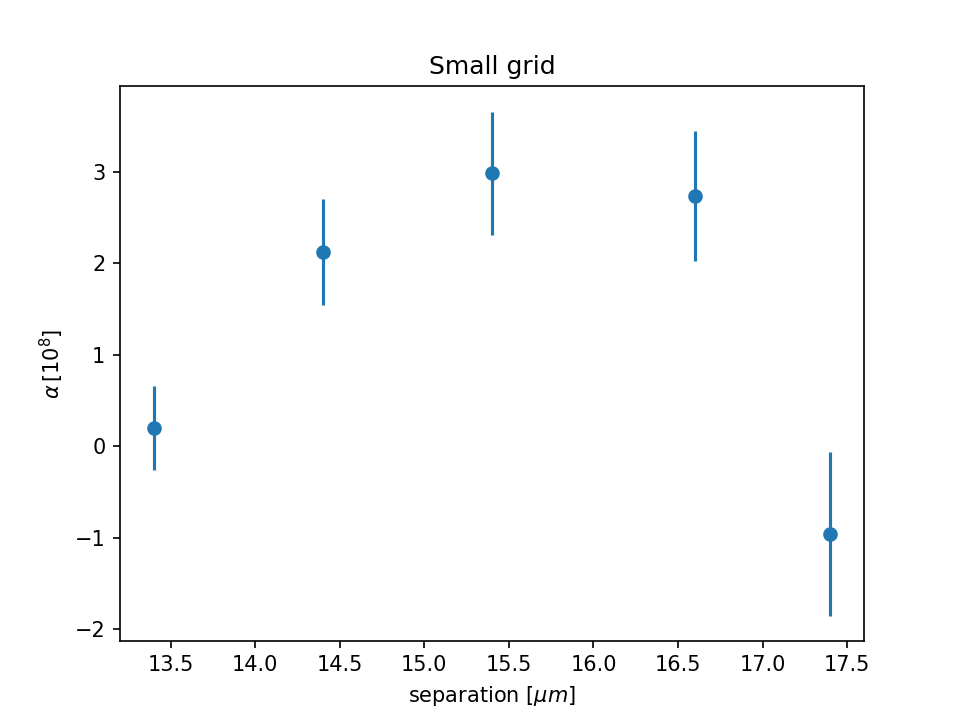

[Text(0, 0.5, '$\\alpha \\, [10^{8}]$'),
 Text(0.5, 0, 'separation [$\\mu m$]'),
 Text(0.5, 1.0, 'Small grid')]

In [497]:
means_grid = np.array([np.mean(mm_alpha376_SmallGrid), np.mean(mm_alpha375_SmallGrid), np.mean(mm_alpha374_SmallGrid),
              np.mean(mm_alpha373_SmallGrid), np.mean(mm_alpha372_SmallGrid)])
errors_grid = np.array([np.std(mm_alpha376_SmallGrid), np.std(mm_alpha375_SmallGrid), np.std(mm_alpha374_SmallGrid),
                np.std(mm_alpha373_SmallGrid), np.std(mm_alpha372_SmallGrid)])
dists = [13.4, 14.4, 15.4, 16.6, 17.4]
_,ax = plt.subplots()
ax.errorbar(dists, means_grid, yerr=errors_grid/np.sqrt(100),fmt='o')
ax.set(title='Small grid', xlabel=r'separation [$\mu m$]', ylabel=r'$\alpha \, [10^{8}]$')

<IPython.core.display.Javascript object>


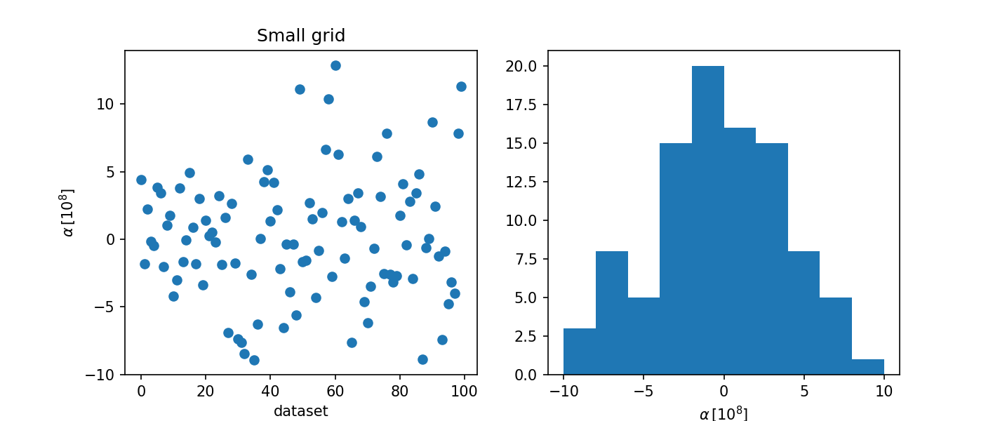

[Text(0.5, 0, '$\\alpha \\, [10^{8}]$')]

In [501]:
_,ax = plt.subplots(1,2,figsize=(9.5,4))
ax[0].scatter(range(100), mm_alpha376_SmallGrid)
ax[0].set(title='Small grid', xlabel=r'dataset', ylabel=r'$\alpha \, [10^{8}]$')

ax[1].hist(mm_alpha376_SmallGrid, range=(-10,10))
ax[1].set(xlabel=r'$\alpha \, [10^{8}]$')

In [166]:
gravity_freqs2 = 2*np.arange(1,20)

In [394]:
std_freqs_x4 = []
for i in range(4000,5000):
    std_freqs_tmp = []
    print(i, '**************')
    fname = r'/data/new_trap/20200320/Bead1/Shaking/Shaking378/Shaking3_'+str(i)+'.h5'
#     fname = r'/data/new_trap/20200320/Bead1/Shaking/Shaking2_20200403/NoShaking_1_'+str(i)+'.h5'
    bb = BeadDataFile.BeadDataFile(fname=fname)
    for freq_ in gravity_freqs:
        std_freqs_tmp.append(np.std(bb.response_at_freq2('x',drive_freq=freq_)))
    std_freqs_x4.append(std_freqs_tmp)
std_freqs_x4 = np.array(std_freqs_x4)

4000 **************
4001 **************
4002 **************
4003 **************
4004 **************
4005 **************
4006 **************
4007 **************
4008 **************
4009 **************
4010 **************
4011 **************
4012 **************
4013 **************
4014 **************
4015 **************
4016 **************
4017 **************
4018 **************
4019 **************
4020 **************
4021 **************
4022 **************
4023 **************
4024 **************
4025 **************
4026 **************
4027 **************
4028 **************
4029 **************
4030 **************
4031 **************
4032 **************
4033 **************
4034 **************
4035 **************
4036 **************
4037 **************
4038 **************
4039 **************
4040 **************
4041 **************
4042 **************
4043 **************
4044 **************
4045 **************
4046 **************
4047 **************
4048 **************
4049 **************


4410 **************
4411 **************
4412 **************
4413 **************
4414 **************
4415 **************
4416 **************
4417 **************
4418 **************
4419 **************
4420 **************
4421 **************
4422 **************
4423 **************
4424 **************
4425 **************
4426 **************
4427 **************
4428 **************
4429 **************
4430 **************
4431 **************
4432 **************
4433 **************
4434 **************
4435 **************
4436 **************
4437 **************
4438 **************
4439 **************
4440 **************
4441 **************
4442 **************
4443 **************
4444 **************
4445 **************
4446 **************
4447 **************
4448 **************
4449 **************
4450 **************
4451 **************
4452 **************
4453 **************
4454 **************
4455 **************
4456 **************
4457 **************
4458 **************
4459 **************


4821 **************
4822 **************
4823 **************
4824 **************
4825 **************
4826 **************
4827 **************
4828 **************
4829 **************
4830 **************
4831 **************
4832 **************
4833 **************
4834 **************
4835 **************
4836 **************
4837 **************
4838 **************
4839 **************
4840 **************
4841 **************
4842 **************
4843 **************
4844 **************
4845 **************
4846 **************
4847 **************
4848 **************
4849 **************
4850 **************
4851 **************
4852 **************
4853 **************
4854 **************
4855 **************
4856 **************
4857 **************
4858 **************
4859 **************
4860 **************
4861 **************
4862 **************
4863 **************
4864 **************
4865 **************
4866 **************
4867 **************
4868 **************
4869 **************
4870 **************


<IPython.core.display.Javascript object>


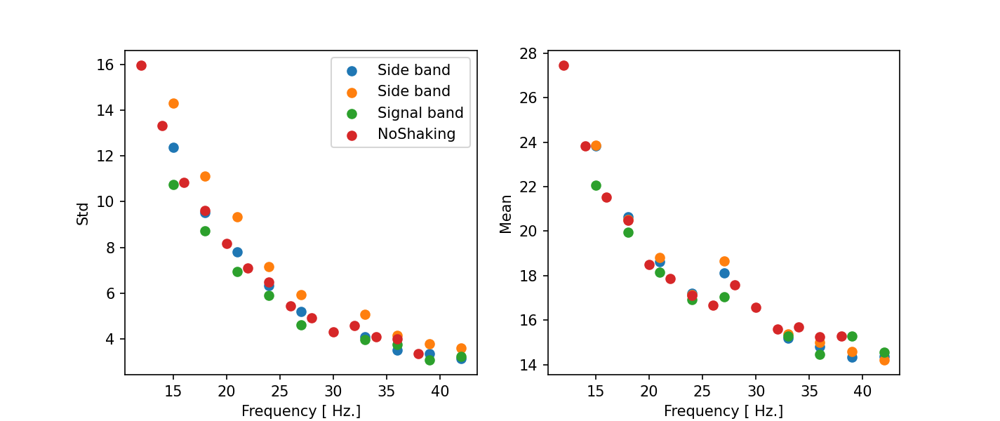

[Text(0, 0.5, 'Mean'), Text(0.5, 0, 'Frequency [ Hz.]')]

In [183]:
_,ax = plt.subplots(1,2,figsize=(9.5,4))
ax[0].scatter(gravity_freqs[:9], np.std(std_freqs, axis=0)[:9], label='Side band')
ax[0].scatter(gravity_freqs[:9], np.std(std_freqs2, axis=0)[:9], label='Side band')
ax[0].scatter(gravity_freqs[:9], np.std(std_freqs4, axis=0)[:9], label='Signal band')
ax[0].scatter(gravity_freqs2[5:], np.std(std_freqs3, axis=0)[5:], label='NoShaking')
ax[0].legend()
ax[0].set(xlabel='Frequency [ Hz.]', ylabel='Std')

ax[1].scatter(gravity_freqs[:9], np.mean(std_freqs, axis=0)[:9], label='Side band')
ax[1].scatter(gravity_freqs[:9], np.mean(std_freqs2, axis=0)[:9], label='Side band')
ax[1].scatter(gravity_freqs[:9], np.mean(std_freqs4, axis=0)[:9], label='Signal band')
ax[1].scatter(gravity_freqs2[5:], np.mean(std_freqs3, axis=0)[5:], label='NoShaking ')
ax[1].set(xlabel='Frequency [ Hz.]', ylabel='Mean')

In [274]:
phases_freqs4 = []
ffts_freqs4 = []
for i in range(4000,5000):
    std_freqs_tmp = []
    print(i, '**************')
    fname = r'/data/new_trap/20200320/Bead1/Shaking/Shaking378/Shaking3_'+str(i)+'.h5'
#     fname = r'/data/new_trap/20200320/Bead1/Shaking/Shaking2_20200403/NoShaking_1_'+str(i)+'.h5'
    bb = BeadDataFile.BeadDataFile(fname=fname)
    freq = np.fft.rfftfreq(len(bb.z2), 1 / 5000)
    fft_tmp = np.fft.rfft(bb.z2) * 2 / np.sqrt(50000 * 5000)
    angles_tmp = (np.angle(np.fft.rfft(bb.z2)) + np.pi / 2) % (2 * np.pi)
    phases_freqs_tmp = np.array([angles_tmp[freq == freq_] for freq_ in gravity_freqs])
    ffts_freqs_tmp = np.array([fft_tmp[freq == freq_] for freq_ in gravity_freqs])
    
    phases_freqs4.append(phases_freqs_tmp)
    ffts_freqs4.append(ffts_freqs_tmp)
phases_freqs4 = np.array(phases_freqs4)
ffts_freqs4 = np.array(ffts_freqs4)

4000 **************
4001 **************
4002 **************
4003 **************
4004 **************
4005 **************
4006 **************
4007 **************
4008 **************
4009 **************
4010 **************
4011 **************
4012 **************
4013 **************
4014 **************
4015 **************
4016 **************
4017 **************
4018 **************
4019 **************
4020 **************
4021 **************
4022 **************
4023 **************
4024 **************
4025 **************
4026 **************
4027 **************
4028 **************
4029 **************
4030 **************
4031 **************
4032 **************
4033 **************
4034 **************
4035 **************
4036 **************
4037 **************
4038 **************
4039 **************
4040 **************
4041 **************
4042 **************
4043 **************
4044 **************
4045 **************
4046 **************
4047 **************
4048 **************
4049 **************


4413 **************
4414 **************
4415 **************
4416 **************
4417 **************
4418 **************
4419 **************
4420 **************
4421 **************
4422 **************
4423 **************
4424 **************
4425 **************
4426 **************
4427 **************
4428 **************
4429 **************
4430 **************
4431 **************
4432 **************
4433 **************
4434 **************
4435 **************
4436 **************
4437 **************
4438 **************
4439 **************
4440 **************
4441 **************
4442 **************
4443 **************
4444 **************
4445 **************
4446 **************
4447 **************
4448 **************
4449 **************
4450 **************
4451 **************
4452 **************
4453 **************
4454 **************
4455 **************
4456 **************
4457 **************
4458 **************
4459 **************
4460 **************
4461 **************
4462 **************


4826 **************
4827 **************
4828 **************
4829 **************
4830 **************
4831 **************
4832 **************
4833 **************
4834 **************
4835 **************
4836 **************
4837 **************
4838 **************
4839 **************
4840 **************
4841 **************
4842 **************
4843 **************
4844 **************
4845 **************
4846 **************
4847 **************
4848 **************
4849 **************
4850 **************
4851 **************
4852 **************
4853 **************
4854 **************
4855 **************
4856 **************
4857 **************
4858 **************
4859 **************
4860 **************
4861 **************
4862 **************
4863 **************
4864 **************
4865 **************
4866 **************
4867 **************
4868 **************
4869 **************
4870 **************
4871 **************
4872 **************
4873 **************
4874 **************
4875 **************


In [203]:
gravity_freqs

array([36, 33, 18, 21, 39, 27, 24, 42, 15,  6,  9, 12])

<IPython.core.display.Javascript object>


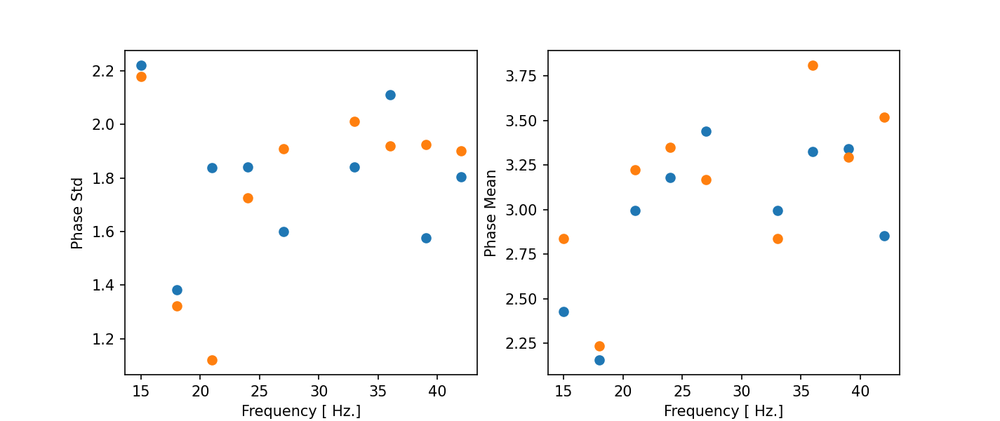

1.8137993642342178

In [209]:
_,ax = plt.subplots(1,2,figsize=(9.5,4))
ax[0].scatter(gravity_freqs[:9], np.std(phases_freqs, axis=0)[:9], label='Signal band')
ax[0].scatter(gravity_freqs[:9], np.std(phases_freqs2, axis=0)[:9], label='Signal band')
# ax[0].scatter(gravity_freqs[:9], np.std(std_freqs4, axis=0)[:9], label='Signal band')
# ax[0].scatter(gravity_freqs2[5:], np.std(std_freqs3, axis=0)[5:], label='NoShaking')
# ax[0].legend()
ax[0].set(xlabel='Frequency [ Hz.]', ylabel='Phase Std')

ax[1].scatter(gravity_freqs[:9], np.mean(phases_freqs, axis=0)[:9], label='Side band')
ax[1].scatter(gravity_freqs[:9], np.mean(phases_freqs2, axis=0)[:9], label='Side band')
# ax[1].scatter(gravity_freqs[:9], np.mean(std_freqs4, axis=0)[:9], label='Signal band')
# ax[1].scatter(gravity_freqs2[5:], np.mean(std_freqs3, axis=0)[5:], label='NoShaking ')
ax[1].set(xlabel='Frequency [ Hz.]', ylabel='Phase Mean')
np.pi*2/np.sqrt(12)

In [267]:
ffts_freqs = np.array(ffts_freqs)

<IPython.core.display.Javascript object>


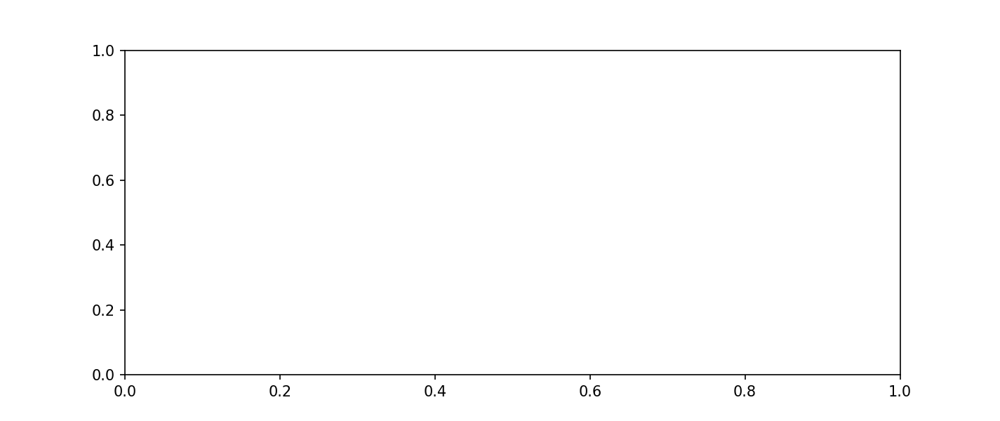

In [295]:
i=6
dist1 = phases_freqs3[:,i,0]
dist2 = phases_freqs4[:,i,0]
dist3 = phases_freqs5[:,i,0]
_,ax = plt.subplots(1,2,figsize=(9.5,4))
ax[0].hist(dist1, bins=30)
ax[0].hist(dist2, alpha=0.3, bins=30)
ax[0].hist(dist3, alpha=0.3, bins=30, label='NoShaking')
ax[0].legend()
ax[0].set(title=str(gravity_freqs[i])+' Hz.')

ffts_freqs_x3 = np.real(ffts_freqs3[:,i,0])
ffts_freqs_y3 = np.imag(ffts_freqs3[:,i,0])
ax[1].scatter(ffts_freqs_x3, ffts_freqs_y3, label='0-1000')

ffts_freqs_x4 = np.real(ffts_freqs4[:,i,0])
ffts_freqs_y4 = np.imag(ffts_freqs4[:,i,0])
ax[1].scatter(ffts_freqs_x4, ffts_freqs_y4, label='4000-5000')

In [378]:
mm_tmp = [mm_ for mm_,xx_ in zip(mm_alpha, np.mean(std_freqs_x, axis=1)) if xx_<1e-4]

In [379]:
np.mean(mm_tmp), len(mm_tmp)

(-1.1597009175888562, 1000)

In [428]:
std_freqs_x3.shape, len(mm_alpha)

((1000, 12), 999)

<IPython.core.display.Javascript object>


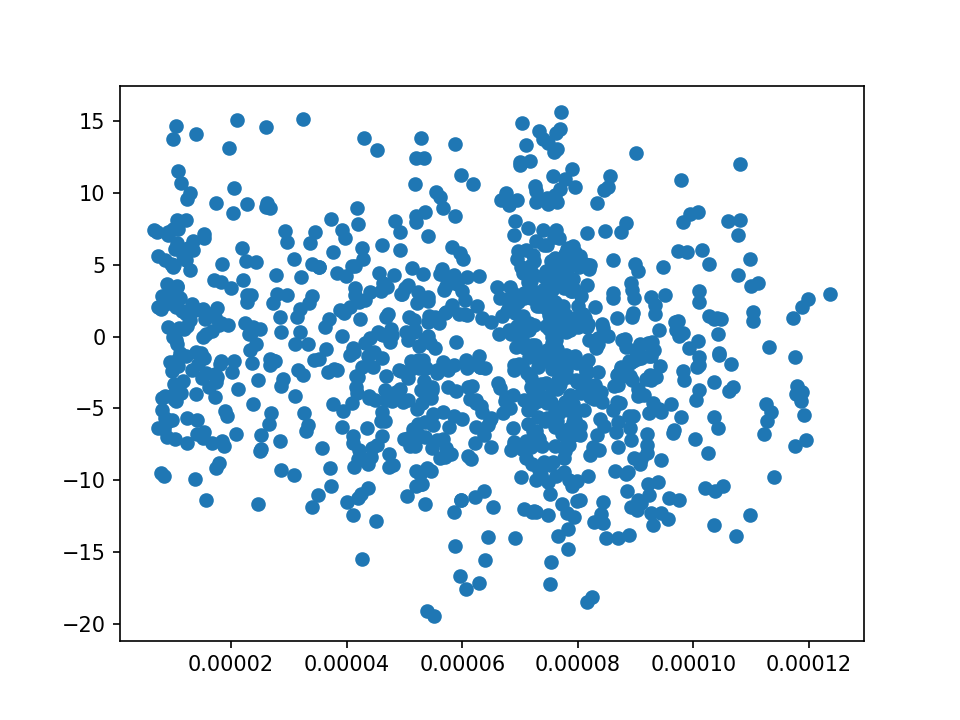

In [429]:
i = 0
_,ax = plt.subplots()
ax.scatter(std_freqs_x3[:-1,i], mm_alpha)

In [530]:
def get_limit(L):
    print('*****************')
    print('calculating lambda ', L)
    
    z_sep = -16e-6
    num_harmonics = 7
    m1_harmonics376_tmp = []
    for i in range(0,1000):
#         fname = r'/data/new_trap/20200320/Bead1/Shaking/Shaking2_20200403/Small_Grid/Shaking376_0_'+str(i)+'.h5'
        fname = r'/data/new_trap/20200320/Bead1/Shaking/Shaking378/Shaking3_'+str(i)+'.h5'
        bb = BeadDataFile.BeadDataFile(fname=fname)
        fit_kwargs = {'A': 0.1, 'phi': 0.2, 'sigma':13.85,
                  'error_A': 1, 'error_phi': 0.5, 'errordef': 1, 'error_sigma': 10,
                  'limit_phi': [0, 2 * np.pi],
                  'limit_A': [-100000, 100000], 'limit_sigma': [0, 1000000],
                  'print_level': 0, 'fix_A': False, 'fix_phi': True, 'fix_sigma': False}

        mm_tmp2 = gfw.get_alpha_mle_multiHarmonics(bdf=bb, freqs_array=gravity_freqs[:num_harmonics], 
                                                   noise_array=noises_std[:num_harmonics]/noises_std[0], 
                                                   bandwidth=2, decimate=10, 
                                                   x_focous=392.4, y_focous=437.3, lambda_par=L,
                                          height=z_sep, suppress_print=False, large_bead=True, **fit_kwargs)
        m1_harmonics376_tmp.append(mm_tmp2[2])
        
    mm_alpha376_tmp = [m1_.values[0] for m1_ in m1_harmonics376_tmp]
    return np.mean(mm_alpha376_tmp)+1.29*np.std(mm_alpha376_tmp)/np.sqrt(1000)

In [531]:
L2 = np.logspace(0.3, 3, 40)*1e-6
# get_lim(L=L[0])
limit2 = [get_limit(L=L_) for L_ in L2]

*****************
calculating lambda  1.9952623149688796e-06
Large Bead:  True
Separation (face to face):  11.39110158645111
y-offset:  4.884549098128645
Stroke:  201.09729873511608
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.57e+04
sigma mle:  1.74e+01
reduced chi2:  3.7617686937092185
Large Bead:  True
Separation (face to face):  11.390570904881383
y-offset:  4.8823024507154
Stroke:  201.0988989821136
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -

***************************************************
alpha mle:  -3.65e+04
sigma mle:  1.81e+01
reduced chi2:  3.800960113540042
Large Bead:  True
Separation (face to face):  11.388713730197036
y-offset:  4.880389023195164
Stroke:  201.09703953673363
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.63e+04
sigma mle:  1.83e+01
reduced chi2:  3.8157101965737343
Large Bead:  True
Separation (face to face):  11.388748277767444
y-offset:  4.879508585770509
Stroke:  201.09712061805106
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.44e+03
sigma mle:  1.81e+01
reduced chi2:  3.8029682486370304
Large Bead:  True
Separation (face to face):  11.38705797873423
y-offset:  4.8797114104073955
Stroke:  201.0955110699757
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.65e+04
sigma mle:  1.79e+01
reduced chi2:  3.7917308428230494
Large Bead:  True
Separation (face to face):  11.387278961913307
y-offset:  4.8811046187866225
Stroke:  201.09463568187218
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.39e+04
sigma mle:  1.93e+01
reduced chi2:  3.877995247550269
Large Bead:  True
Separation (face to face):  11.39175561668112
y-offset:  4.882116822493401
Stroke:  201.0934735965496
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.89e+04
sigma mle:  1.82e+01
reduced chi2:  3.806650410091007
Large Bead:  True
Separation (face to face):  11.390865004008116
y-offset:  4.882619669500514
Stroke:  201.09315931170394
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.62e+04
sigma mle:  1.99e+01
reduced chi2:  3.9085669204410634
Large Bead:  True
Separation (face to face):  11.393859720622697
y-offset:  4.88335994545389
Stroke:  201.09092144582655
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.09e+04
sigma mle:  1.83e+01
reduced chi2:  3.817895722225214
Large Bead:  True
Separation (face to face):  11.393290730712248
y-offset:  4.882597979717815
Stroke:  201.09113894800205
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.87e+04
sigma mle:  1.82e+01
reduced chi2:  3.812344630060675
Large Bead:  True
Separation (face to face):  11.39272327309352
y-offset:  4.884058190954988
Stroke:  201.0913566874052
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.50e+04
sigma mle:  1.79e+01
reduced chi2:  3.79024831123276
Large Bead:  True
Separation (face to face):  11.392832775647332
y-offset:  4.8842373473716805
Stroke:  201.0915837274394
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  4.18e+04
sigma mle:  1.96e+01
reduced chi2:  3.8949716689435006
Large Bead:  True
Separation (face to face):  11.3954466649521
y-offset:  4.885937044386338
Stroke:  201.08987553460736
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.29e+04
sigma mle:  1.82e+01
reduced chi2:  3.811561266151954
Large Bead:  True
Separation (face to face):  11.394120724144852
y-offset:  4.884931325381217
Stroke:  201.09012649874808
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.62e+04
sigma mle:  2.08e+01
reduced chi2:  3.9610208209719713
Large Bead:  True
Separation (face to face):  11.395776117235595
y-offset:  4.885785970130229
Stroke:  201.09016221911216
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.36e+04
sigma mle:  1.91e+01
reduced chi2:  3.8658841258248624
Large Bead:  True
Separation (face to face):  11.394847271467722
y-offset:  4.884530012649918
Stroke:  201.09105711116183
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.77e+04
sigma mle:  1.76e+01
reduced chi2:  3.775152852951153
Large Bead:  True
Separation (face to face):  11.395766086916364
y-offset:  4.884137913054332
Stroke:  201.08950822742221
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.60e+04
sigma mle:  1.82e+01
reduced chi2:  3.812384458590752
Large Bead:  True
Separation (face to face):  11.394457210748453
y-offset:  4.883755904683795
Stroke:  201.09101860351367
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -9.41e+03
sigma mle:  1.71e+01
reduced chi2:  3.742723981942599
Large Bead:  True
Separation (face to face):  11.391522385482585
y-offset:  4.8829988680057
Stroke:  201.0899416888276
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.04e+03
sigma mle:  1.94e+01
reduced chi2:  3.882591325342775
Large Bead:  True
Separation (face to face):  11.391239937416469
y-offset:  4.882450948288806
Stroke:  201.09050476670197
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  8.39e+03
sigma mle:  1.66e+01
reduced chi2:  3.7034504942476523
Large Bead:  True
Separation (face to face):  11.39214790904175
y-offset:  4.882334020881245
Stroke:  201.08930224062175
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.11e+04
sigma mle:  1.73e+01
reduced chi2:  3.7556618804091313
Large Bead:  True
Separation (face to face):  11.392319048566502
y-offset:  4.882910734324128
Stroke:  201.08906026417142
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.17e+03
sigma mle:  2.05e+01
reduced chi2:  3.944776478148389
Large Bead:  True
Separation (face to face):  11.390073800909544
y-offset:  4.881494259199428
Stroke:  201.08980379586515
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.02e+03
sigma mle:  1.78e+01
reduced chi2:  3.7831132023698464
Large Bead:  True
Separation (face to face):  11.392452481073871
y-offset:  4.880190106385555
Stroke:  201.0891634015014
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.25e+04
sigma mle:  1.93e+01
reduced chi2:  3.8778554008941164
Large Bead:  True
Separation (face to face):  11.388537201265546
y-offset:  4.880422580307425
Stroke:  201.08952096840142
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.41e+03
sigma mle:  1.72e+01
reduced chi2:  3.749496458465525
Large Bead:  True
Separation (face to face):  11.388565658453114
y-offset:  4.8810326796538845
Stroke:  201.0888150710016
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.89e+04
sigma mle:  1.75e+01
reduced chi2:  3.7632994609013903
Large Bead:  True
Separation (face to face):  11.387514684954237
y-offset:  4.8806775096742285
Stroke:  201.08924110297065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.62e+04
sigma mle:  1.93e+01
reduced chi2:  3.8778379328624233
Large Bead:  True
Separation (face to face):  11.388905571660143
y-offset:  4.882021062184549
Stroke:  201.089269443264
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.20e+04
sigma mle:  1.85e+01
reduced chi2:  3.8253696249671143
Large Bead:  True
Separation (face to face):  11.38962629094517
y-offset:  4.880483879198806
Stroke:  201.0890907787604
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.64e+04
sigma mle:  1.89e+01
reduced chi2:  3.849880697199313
Large Bead:  True
Separation (face to face):  11.390077358490839
y-offset:  4.880462498046654
Stroke:  201.08937701680065
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.29e+03
sigma mle:  1.86e+01
reduced chi2:  3.8359886882831495
Large Bead:  True
Separation (face to face):  11.389638157715819
y-offset:  4.880217795447692
Stroke:  201.0880399815962
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.69e+04
sigma mle:  1.94e+01
reduced chi2:  3.8809000174803385
Large Bead:  True
Separation (face to face):  11.387831960882988
y-offset:  4.879764404417301
Stroke:  201.08879247880319
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.76e+04
sigma mle:  2.01e+01
reduced chi2:  3.9185995369964917
Large Bead:  True
Separation (face to face):  11.387595049038293
y-offset:  4.8790807303170425
Stroke:  201.08798185602984
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.54e+03
sigma mle:  1.79e+01
reduced chi2:  3.7925926436694346
Large Bead:  True
Separation (face to face):  11.389955823507432
y-offset:  4.879053775433164
Stroke:  201.08771861051213
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.03e+04
sigma mle:  1.89e+01
reduced chi2:  3.851321678996192
Large Bead:  True
Separation (face to face):  11.390652975607974
y-offset:  4.879333925760761
Stroke:  201.08749264494168
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.40e+03
sigma mle:  1.88e+01
reduced chi2:  3.843051082579368
Large Bead:  True
Separation (face to face):  11.39032424557207
y-offset:  4.879739678717357
Stroke:  201.08772229495196
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.94e+04
sigma mle:  1.97e+01
reduced chi2:  3.897503807138418
Large Bead:  True
Separation (face to face):  11.389347779598108
y-offset:  4.880174539093218
Stroke:  201.08775517220053
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.76e+04
sigma mle:  1.82e+01
reduced chi2:  3.809913688860666
Large Bead:  True
Separation (face to face):  11.391704495532007
y-offset:  4.88038471123906
Stroke:  201.08661591504307
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.09e+04
sigma mle:  1.93e+01
reduced chi2:  3.8740815749356368
Large Bead:  True
Separation (face to face):  11.390223322040708
y-offset:  4.879882798595418
Stroke:  201.08713007623487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.48e+03
sigma mle:  2.00e+01
reduced chi2:  3.9129434220847608
Large Bead:  True
Separation (face to face):  11.388981350035305
y-offset:  4.87933366230439
Stroke:  201.08821940694293
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.77e+04
sigma mle:  1.93e+01
reduced chi2:  3.8761432433006626
Large Bead:  True
Separation (face to face):  11.387705081934609
y-offset:  4.879667593302457
Stroke:  201.08745234178008
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.10e+03
sigma mle:  1.93e+01
reduced chi2:  3.878188537242489
Large Bead:  True
Separation (face to face):  11.388357269575362
y-offset:  4.879618569456767
Stroke:  201.08726060041033
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.83e+04
sigma mle:  1.93e+01
reduced chi2:  3.8780996128500664
Large Bead:  True
Separation (face to face):  11.387896411309566
y-offset:  4.879675410526772
Stroke:  201.08740499728685
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.39e+03
sigma mle:  1.68e+01
reduced chi2:  3.7171062526115617
Large Bead:  True
Separation (face to face):  11.38706143232697
y-offset:  4.878748096145586
Stroke:  201.08671214874846
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.69e+03
sigma mle:  2.01e+01
reduced chi2:  3.9189184069943868
Large Bead:  True
Separation (face to face):  11.38541385710688
y-offset:  4.8782268661296655
Stroke:  201.0877060871589
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.10e+03
sigma mle:  1.76e+01
reduced chi2:  3.7749851070634626
Large Bead:  True
Separation (face to face):  11.386103590898198
y-offset:  4.878976331459739
Stroke:  201.08684916978473
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.68e+03
sigma mle:  1.88e+01
reduced chi2:  3.8488598332740067
Large Bead:  True
Separation (face to face):  11.38483236371054
y-offset:  4.877636474166081
Stroke:  201.08791910573734
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.25e+02
sigma mle:  1.91e+01
reduced chi2:  3.865923712195878
Large Bead:  True
Separation (face to face):  11.38515773075228
y-offset:  4.877851287303201
Stroke:  201.08630914053373
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.37e+03
sigma mle:  1.74e+01
reduced chi2:  3.762212091766182
Large Bead:  True
Separation (face to face):  11.385955187681656
y-offset:  4.877227352874911
Stroke:  201.08726657654398
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.73e+04
sigma mle:  1.98e+01
reduced chi2:  3.9042216319151137
Large Bead:  True
Separation (face to face):  11.386916837728744
y-offset:  4.87772974619719
Stroke:  201.0864581943622
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.45e+04
sigma mle:  1.98e+01
reduced chi2:  3.9037654523209713
Large Bead:  True
Separation (face to face):  11.38659097865219
y-offset:  4.877364229585396
Stroke:  201.08738379733654
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.42e+04
sigma mle:  1.90e+01
reduced chi2:  3.85937742806608
Large Bead:  True
Separation (face to face):  11.386315705226945
y-offset:  4.876900312276462
Stroke:  201.08735401676012
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.99e+04
sigma mle:  1.93e+01
reduced chi2:  3.8731720329461017
Large Bead:  True
Separation (face to face):  11.38646593043536
y-offset:  4.877620627386136
Stroke:  201.0873379245943
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.52e+03
sigma mle:  1.96e+01
reduced chi2:  3.8938737237602523
Large Bead:  True
Separation (face to face):  11.386959062391679
y-offset:  4.877103070478569
Stroke:  201.08764045705237
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.96e+03
sigma mle:  2.09e+01
reduced chi2:  3.9665211555310083
Large Bead:  True
Separation (face to face):  11.38909362826855
y-offset:  4.879328853327024
Stroke:  201.08794342187724
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.16e+04
sigma mle:  2.04e+01
reduced chi2:  3.9371664575711964
Large Bead:  True
Separation (face to face):  11.387848339533559
y-offset:  4.879404159331159
Stroke:  201.08655807492744
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.65e+04
sigma mle:  1.79e+01
reduced chi2:  3.789747633712875
Large Bead:  True
Separation (face to face):  11.38903857097564
y-offset:  4.8803609469364915
Stroke:  201.08659955036583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.14e+02
sigma mle:  1.96e+01
reduced chi2:  3.8934693118925874
Large Bead:  True
Separation (face to face):  11.387954452593998
y-offset:  4.879088703404989
Stroke:  201.08727008860495
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.26e+02
sigma mle:  1.84e+01
reduced chi2:  3.8211894399222617
Large Bead:  True
Separation (face to face):  11.388506545944164
y-offset:  4.880860166463009
Stroke:  201.0866615611359
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.36e+03
sigma mle:  1.86e+01
reduced chi2:  3.834677137891081
Large Bead:  True
Separation (face to face):  11.388945921460401
y-offset:  4.880167408538284
Stroke:  201.08549551639018
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.75e+04
sigma mle:  1.96e+01
reduced chi2:  3.8899887122168657
Large Bead:  True
Separation (face to face):  11.3878958246362
y-offset:  4.879407688489806
Stroke:  201.0863056273394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.75e+03
sigma mle:  1.87e+01
reduced chi2:  3.842316954797412
Large Bead:  True
Separation (face to face):  11.389847433670536
y-offset:  4.880220746787899
Stroke:  201.08574742985226
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  7.29e+04
sigma mle:  1.70e+01
reduced chi2:  3.735211510366798
Large Bead:  True
Separation (face to face):  11.392270575016436
y-offset:  4.880622875551353
Stroke:  201.08602288978886
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.35e+04
sigma mle:  1.82e+01
reduced chi2:  3.80840108885023
Large Bead:  True
Separation (face to face):  11.39234484961771
y-offset:  4.8804027014038525
Stroke:  201.0855073696355
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -7.39e+03
sigma mle:  1.71e+01
reduced chi2:  3.739941034657435
Large Bead:  True
Separation (face to face):  11.39037280070944
y-offset:  4.880436809492295
Stroke:  201.08504458362378
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.24e+04
sigma mle:  2.04e+01
reduced chi2:  3.9393574138495233
Large Bead:  True
Separation (face to face):  11.38905799525504
y-offset:  4.8806697671421375
Stroke:  201.08652963122046
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.46e+04
sigma mle:  1.78e+01
reduced chi2:  3.7836220152063227
Large Bead:  True
Separation (face to face):  11.387452632573183
y-offset:  4.879547099785128
Stroke:  201.0867357756709
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.44e+04
sigma mle:  1.96e+01
reduced chi2:  3.895323406854347
Large Bead:  True
Separation (face to face):  11.389973976379235
y-offset:  4.880239852616995
Stroke:  201.08586811435774
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.33e+04
sigma mle:  1.84e+01
reduced chi2:  3.8203862405048685
Large Bead:  True
Separation (face to face):  11.387086976027273
y-offset:  4.880003057532008
Stroke:  201.08551894134982
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.36e+04
sigma mle:  1.79e+01
reduced chi2:  3.7937101482585724
Large Bead:  True
Separation (face to face):  11.387228772246782
y-offset:  4.881226896913006
Stroke:  201.0853066253905
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.42e+03
sigma mle:  1.95e+01
reduced chi2:  3.885944314055054
Large Bead:  True
Separation (face to face):  11.385897492924425
y-offset:  4.879750670418673
Stroke:  201.08612105091277
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.10e+03
sigma mle:  1.69e+01
reduced chi2:  3.729780836899341
Large Bead:  True
Separation (face to face):  11.384221349741448
y-offset:  4.879478415995834
Stroke:  201.08702745969632
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.80e+04
sigma mle:  1.93e+01
reduced chi2:  3.874099648489623
Large Bead:  True
Separation (face to face):  11.38755802698888
y-offset:  4.87973909620959
Stroke:  201.08580080892992
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.83e+04
sigma mle:  1.85e+01
reduced chi2:  3.8280827075453243
Large Bead:  True
Separation (face to face):  11.388664966186308
y-offset:  4.879504275703113
Stroke:  201.08541693340294
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.30e+04
sigma mle:  1.94e+01
reduced chi2:  3.87916989448091
Large Bead:  True
Separation (face to face):  11.387715864122367
y-offset:  4.880385522512455
Stroke:  201.0845562201607
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.93e+03
sigma mle:  1.80e+01
reduced chi2:  3.7989858575326836
Large Bead:  True
Separation (face to face):  11.386333613298415
y-offset:  4.879360349282706
Stroke:  201.0845171478583
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.50e+04
sigma mle:  1.90e+01
reduced chi2:  3.859323641110824
Large Bead:  True
Separation (face to face):  11.387145443020653
y-offset:  4.879483019076787
Stroke:  201.08581290016522
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.41e+04
sigma mle:  2.04e+01
reduced chi2:  3.9364353493142414
Large Bead:  True
Separation (face to face):  11.389621461920694
y-offset:  4.880662306932152
Stroke:  201.0853028661281
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.46e+04
sigma mle:  1.98e+01
reduced chi2:  3.9029911133344943
Large Bead:  True
Separation (face to face):  11.387125373558046
y-offset:  4.879548824558725
Stroke:  201.0862494449897
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.44e+04
sigma mle:  1.72e+01
reduced chi2:  3.745056290571244
Large Bead:  True
Separation (face to face):  11.388036556939038
y-offset:  4.8801317998497495
Stroke:  201.08572432790487
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.93e+03
sigma mle:  1.89e+01
reduced chi2:  3.8501381706143585
Large Bead:  True
Separation (face to face):  11.388959039312805
y-offset:  4.881961615231461
Stroke:  201.08460685819597
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.66e+04
sigma mle:  2.01e+01
reduced chi2:  3.92136260097651
Large Bead:  True
Separation (face to face):  11.388154524958008
y-offset:  4.88127663544023
Stroke:  201.08536513343756
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.09e+03
sigma mle:  1.79e+01
reduced chi2:  3.792839860664231
Large Bead:  True
Separation (face to face):  11.38952624270554
y-offset:  4.880821414253546
Stroke:  201.0845234677715
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.67e+04
sigma mle:  1.95e+01
reduced chi2:  3.88768681013061
Large Bead:  True
Separation (face to face):  11.390553467996153
y-offset:  4.880742422038907
Stroke:  201.0845059165533
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  2.30e+04
sigma mle:  1.90e+01
reduced chi2:  3.8598365726979664
Large Bead:  True
Separation (face to face):  11.38927850767659
y-offset:  4.881546446266384
Stroke:  201.08443200066927
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.71e+02
sigma mle:  1.77e+01
reduced chi2:  3.778475201253405
Large Bead:  True
Separation (face to face):  11.388193301419744
y-offset:  4.880887807836302
Stroke:  201.08540080323434
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.93e+03
sigma mle:  1.82e+01
reduced chi2:  3.807788492103797
Large Bead:  True
Separation (face to face):  11.387921506426334
y-offset:  4.879987651525028
Stroke:  201.0843620021377
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.95e+04
sigma mle:  1.77e+01
reduced chi2:  3.777209263247646
Large Bead:  True
Separation (face to face):  11.387353560527128
y-offset:  4.880206365044842
Stroke:  201.08470047236779
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.04e+03
sigma mle:  1.84e+01
reduced chi2:  3.824369509693669
Large Bead:  True
Separation (face to face):  11.389825814199991
y-offset:  4.880902008087588
Stroke:  201.08451872302984
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.57e+01
sigma mle:  1.87e+01
reduced chi2:  3.8424195613545193
Large Bead:  True
Separation (face to face):  11.389366789264397
y-offset:  4.8802292442181
Stroke:  201.08547135537052
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.14e+03
sigma mle:  1.87e+01
reduced chi2:  3.84166947832407
Large Bead:  True
Separation (face to face):  11.386923613843702
y-offset:  4.877841173329898
Stroke:  201.08578566793642
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.44e+04
sigma mle:  1.71e+01
reduced chi2:  3.7406791555201573
Large Bead:  True
Separation (face to face):  11.3863361719885
y-offset:  4.878941597698173
Stroke:  201.08579738006796
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  2.89e+04
sigma mle:  1.85e+01
reduced chi2:  3.8256026843438913
Large Bead:  True
Separation (face to face):  11.38418235715842
y-offset:  4.877910857954532
Stroke:  201.08556578623836
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.44e+04
sigma mle:  1.90e+01
reduced chi2:  3.8584138061345485
Large Bead:  True
Separation (face to face):  11.382597385412065
y-offset:  4.877339729604529
Stroke:  201.08609307346958
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.26e+04
sigma mle:  1.89e+01
reduced chi2:  3.853503213003715
Large Bead:  True
Separation (face to face):  11.383848343784631
y-offset:  4.877258806866962
Stroke:  201.0856314073922
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.50e+04
sigma mle:  1.72e+01
reduced chi2:  3.7451683074926985
Large Bead:  True
Separation (face to face):  11.38408125945001
y-offset:  4.876895606306903
Stroke:  201.08520850368987
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.62e+04
sigma mle:  1.90e+01
reduced chi2:  3.8559945669916726
Large Bead:  True
Separation (face to face):  11.384325879527534
y-offset:  4.879997773233583
Stroke:  201.0853803195245
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.99e+04
sigma mle:  1.99e+01
reduced chi2:  3.9076198400578437
Large Bead:  True
Separation (face to face):  11.383784194219412
y-offset:  4.879350351089414
Stroke:  201.08536838540599
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.04e+04
sigma mle:  1.75e+01
reduced chi2:  3.767247839821115
Large Bead:  True
Separation (face to face):  11.385239311766792
y-offset:  4.878818188974719
Stroke:  201.08478913237727
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.09e+03
sigma mle:  1.75e+01
reduced chi2:  3.765435364277416
Large Bead:  True
Separation (face to face):  11.384774372897663
y-offset:  4.878048931922024
Stroke:  201.08532810832048
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.82e+04
sigma mle:  1.79e+01
reduced chi2:  3.7935675101708393
Large Bead:  True
Separation (face to face):  11.384775865981066
y-offset:  4.878075117080925
Stroke:  201.08582998000912
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.44e+04
sigma mle:  1.95e+01
reduced chi2:  3.8886352281015197
Large Bead:  True
Separation (face to face):  11.386308563381089
y-offset:  4.878743135607152
Stroke:  201.08534567609502
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.06e+04
sigma mle:  1.86e+01
reduced chi2:  3.836875300430263
Large Bead:  True
Separation (face to face):  11.385737895131125
y-offset:  4.878738455100887
Stroke:  201.08421586365586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.72e+04
sigma mle:  2.06e+01
reduced chi2:  3.9470104101092245
Large Bead:  True
Separation (face to face):  11.382407640790245
y-offset:  4.878086998766378
Stroke:  201.08599349815677
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.39e+03
sigma mle:  1.81e+01
reduced chi2:  3.8024233457515466
Large Bead:  True
Separation (face to face):  11.386342828886779
y-offset:  4.88143120137272
Stroke:  201.084306279086
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.47e+04
sigma mle:  1.70e+01
reduced chi2:  3.7319271084750647
Large Bead:  True
Separation (face to face):  11.385968234327901
y-offset:  4.880401158276754
Stroke:  201.08538304222353
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.09e+04
sigma mle:  1.79e+01
reduced chi2:  3.7921075386050846
Large Bead:  True
Separation (face to face):  11.38853068908345
y-offset:  4.879756658272271
Stroke:  201.08365334440663
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.32e+03
sigma mle:  1.97e+01
reduced chi2:  3.897881469279226
Large Bead:  True
Separation (face to face):  11.38738973081372
y-offset:  4.880032675066303
Stroke:  201.08302916811263
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.56e+04
sigma mle:  1.76e+01
reduced chi2:  3.7746813645414408
Large Bead:  True
Separation (face to face):  11.384008749683698
y-offset:  4.879157601897987
Stroke:  201.0852880964623
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.91e+04
sigma mle:  1.78e+01
reduced chi2:  3.7844246790887626
Large Bead:  True
Separation (face to face):  11.38605027010227
y-offset:  4.879383415478685
Stroke:  201.0845952432678
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.93e+04
sigma mle:  1.97e+01
reduced chi2:  3.8968814441446424
Large Bead:  True
Separation (face to face):  11.38751404784723
y-offset:  4.88170777813923
Stroke:  201.08545582182177
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.52e+03
sigma mle:  1.73e+01
reduced chi2:  3.7496921118854325
Large Bead:  True
Separation (face to face):  11.388400996132201
y-offset:  4.881384023756198
Stroke:  201.0849713336957
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.67e+04
sigma mle:  1.91e+01
reduced chi2:  3.865915151834864
Large Bead:  True
Separation (face to face):  11.385779790104902
y-offset:  4.881154299050166
Stroke:  201.0860388484916
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.47e+03
sigma mle:  1.90e+01
reduced chi2:  3.858277410796137
Large Bead:  True
Separation (face to face):  11.38458888948237
y-offset:  4.881121387128587
Stroke:  201.08490740931578
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.10e+04
sigma mle:  1.77e+01
reduced chi2:  3.776769916249549
Large Bead:  True
Separation (face to face):  11.386978083238727
y-offset:  4.881067534693045
Stroke:  201.08455075974948
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.62e+03
sigma mle:  1.77e+01
reduced chi2:  3.7814197068985096
Large Bead:  True
Separation (face to face):  11.387724874723528
y-offset:  4.880158205252997
Stroke:  201.08539581465294
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  8.08e+03
sigma mle:  1.63e+01
reduced chi2:  3.68589188187131
Large Bead:  True
Separation (face to face):  11.386337888143895
y-offset:  4.8799990958729325
Stroke:  201.0842655065612
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.69e+04
sigma mle:  1.80e+01
reduced chi2:  3.800167225132188
Large Bead:  True
Separation (face to face):  11.385854999369212
y-offset:  4.878953788846957
Stroke:  201.08622654783275
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.13e+04
sigma mle:  1.85e+01
reduced chi2:  3.830224674347595
Large Bead:  True
Separation (face to face):  11.382306712381602
y-offset:  4.876829447197309
Stroke:  201.08522951579448
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.51e+04
sigma mle:  1.84e+01
reduced chi2:  3.823746914233881
Large Bead:  True
Separation (face to face):  11.383401301435992
y-offset:  4.878942643329822
Stroke:  201.08556797569037
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.67e+04
sigma mle:  2.01e+01
reduced chi2:  3.920433608682079
Large Bead:  True
Separation (face to face):  11.382912367313349
y-offset:  4.878020228941978
Stroke:  201.08550142842824
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.56e+04
sigma mle:  1.71e+01
reduced chi2:  3.7385704779455833
Large Bead:  True
Separation (face to face):  11.383346492658585
y-offset:  4.87887232064304
Stroke:  201.08537213763407
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.01e+03
sigma mle:  1.79e+01
reduced chi2:  3.791685403628534
Large Bead:  True
Separation (face to face):  11.384056480915387
y-offset:  4.877217085273259
Stroke:  201.085448518135
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.62e+04
sigma mle:  1.70e+01
reduced chi2:  3.733781875093777
Large Bead:  True
Separation (face to face):  11.384848196129735
y-offset:  4.8770152831235976
Stroke:  201.0854808619588
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.63e+04
sigma mle:  1.85e+01
reduced chi2:  3.8273463001799035
Large Bead:  True
Separation (face to face):  11.384897230286025
y-offset:  4.879339720678161
Stroke:  201.08481506789494
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.35e+04
sigma mle:  1.83e+01
reduced chi2:  3.8179517332208124
Large Bead:  True
Separation (face to face):  11.38486896188375
y-offset:  4.878593206173576
Stroke:  201.08457503175987
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.80e+04
sigma mle:  1.65e+01
reduced chi2:  3.702121825492801
Large Bead:  True
Separation (face to face):  11.382693163182818
y-offset:  4.878214108326858
Stroke:  201.08593921985488
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.47e+04
sigma mle:  1.96e+01
reduced chi2:  3.895188502315928
Large Bead:  True
Separation (face to face):  11.382917683300217
y-offset:  4.87857912206448
Stroke:  201.08486061352858
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.41e+04
sigma mle:  3.66e+01
reduced chi2:  4.591404246571945
Large Bead:  True
Separation (face to face):  11.384371010998176
y-offset:  4.879006146194172
Stroke:  201.08470867160045
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.03e+04
sigma mle:  2.06e+01
reduced chi2:  3.9484743759721628
Large Bead:  True
Separation (face to face):  11.383181613119529
y-offset:  4.877720025760112
Stroke:  201.08526096870875
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.68e+04
sigma mle:  1.89e+01
reduced chi2:  3.8516343002991387
Large Bead:  True
Separation (face to face):  11.385550099270187
y-offset:  4.87932495920748
Stroke:  201.08425646219192
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.36e+04
sigma mle:  1.69e+01
reduced chi2:  3.723355141117071
Large Bead:  True
Separation (face to face):  11.38270266950924
y-offset:  4.877724938805812
Stroke:  201.08572729119516
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.59e+03
sigma mle:  1.99e+01
reduced chi2:  3.908291645543392
Large Bead:  True
Separation (face to face):  11.385911206116372
y-offset:  4.879520168880589
Stroke:  201.08507787357914
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.99e+04
sigma mle:  1.77e+01
reduced chi2:  3.7799294081630883
Large Bead:  True
Separation (face to face):  11.385424576778757
y-offset:  4.879808581002322
Stroke:  201.08472477807564
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.17e+04
sigma mle:  1.81e+01
reduced chi2:  3.8027521511598357
Large Bead:  True
Separation (face to face):  11.38444334194254
y-offset:  4.878674664283977
Stroke:  201.08477207335733
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.03e+04
sigma mle:  1.81e+01
reduced chi2:  3.8055158632085027
Large Bead:  True
Separation (face to face):  11.384167456234831
y-offset:  4.879437955009166
Stroke:  201.08553913130245
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.91e+03
sigma mle:  1.93e+01
reduced chi2:  3.874646193062668
Large Bead:  True
Separation (face to face):  11.38467480597718
y-offset:  4.878158392671793
Stroke:  201.085451406122
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.17e+01
sigma mle:  1.75e+01
reduced chi2:  3.7667681947326
Large Bead:  True
Separation (face to face):  11.385891515859281
y-offset:  4.878858051413118
Stroke:  201.08455276401915
Time:  10.0
Your choice of separation or height is not existing
Tak

***************************************************
alpha mle:  -1.92e+04
sigma mle:  1.84e+01
reduced chi2:  3.823479215306683
Large Bead:  True
Separation (face to face):  11.384585560249672
y-offset:  4.878940225415533
Stroke:  201.08518389877278
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.49e+03
sigma mle:  1.73e+01
reduced chi2:  3.7509802887769856
Large Bead:  True
Separation (face to face):  11.38702144867666
y-offset:  4.879598089055179
Stroke:  201.0837243627688
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.21e+04
sigma mle:  1.69e+01
reduced chi2:  3.7256915110777964
Large Bead:  True
Separation (face to face):  11.384323820071199
y-offset:  4.879560175187322
Stroke:  201.08336957615288
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.78e+04
sigma mle:  1.74e+01
reduced chi2:  3.758261439606921
Large Bead:  True
Separation (face to face):  11.383464922507596
y-offset:  4.879771902681057
Stroke:  201.08337727781534
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.39e+04
sigma mle:  1.77e+01
reduced chi2:  3.778470663974536
Large Bead:  True
Separation (face to face):  11.383443404420017
y-offset:  4.878499136710815
Stroke:  201.08389486874486
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.07e+04
sigma mle:  1.72e+01
reduced chi2:  3.7437769231994196
Large Bead:  True
Separation (face to face):  11.382678329172801
y-offset:  4.8782459896417265
Stroke:  201.08479912406509
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.45e+04
sigma mle:  1.84e+01
reduced chi2:  3.8229591147437465
Large Bead:  True
Separation (face to face):  11.382939495862114
y-offset:  4.878304416798613
Stroke:  201.08404449474065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.96e+04
sigma mle:  1.76e+01
reduced chi2:  3.768970394073404
Large Bead:  True
Separation (face to face):  11.38189590455438
y-offset:  4.877833327369359
Stroke:  201.08439073326616
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.71e+04
sigma mle:  1.62e+01
reduced chi2:  3.679802422826729
Large Bead:  True
Separation (face to face):  11.383147648161877
y-offset:  4.877482649680218
Stroke:  201.0841406865731
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.63e+03
sigma mle:  1.93e+01
reduced chi2:  3.8750814274978147
Large Bead:  True
Separation (face to face):  11.380292574662189
y-offset:  4.876689741105793
Stroke:  201.08465321396562
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.03e+04
sigma mle:  1.73e+01
reduced chi2:  3.749957163208506
Large Bead:  True
Separation (face to face):  11.382854981176262
y-offset:  4.876935034889385
Stroke:  201.084223752502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.43e+04
sigma mle:  1.89e+01
reduced chi2:  3.8529962238164037
Large Bead:  True
Separation (face to face):  11.383826541282314
y-offset:  4.8778262263246575
Stroke:  201.08405682131016
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -8.76e+03
sigma mle:  1.74e+01
reduced chi2:  3.7571974854411496
Large Bead:  True
Separation (face to face):  11.381756952128296
y-offset:  4.877218309538705
Stroke:  201.0850858636958
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.40e+04
sigma mle:  1.81e+01
reduced chi2:  3.802347669541817
Large Bead:  True
Separation (face to face):  11.381272620773597
y-offset:  4.8763874334591435
Stroke:  201.08555457694243
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.74e+04
sigma mle:  1.80e+01
reduced chi2:  3.799825535441695
Large Bead:  True
Separation (face to face):  11.384735542880275
y-offset:  4.879171398234746
Stroke:  201.0850236790552
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.23e+04
sigma mle:  1.67e+01
reduced chi2:  3.7102066358316557
Large Bead:  True
Separation (face to face):  11.38365458851349
y-offset:  4.878282756619825
Stroke:  201.08405320067308
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.70e+04
sigma mle:  1.93e+01
reduced chi2:  3.8744245496071748
Large Bead:  True
Separation (face to face):  11.383335539697281
y-offset:  4.880094511273853
Stroke:  201.08431878168545
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.93e+04
sigma mle:  1.83e+01
reduced chi2:  3.8157890517417936
Large Bead:  True
Separation (face to face):  11.381265908836678
y-offset:  4.879243774166611
Stroke:  201.0851168702844
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -4.01e+04
sigma mle:  1.94e+01
reduced chi2:  3.878453118949026
Large Bead:  True
Separation (face to face):  11.385297518898835
y-offset:  4.878974641407808
Stroke:  201.08354458551753
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.99e+04
sigma mle:  1.82e+01
reduced chi2:  3.80783546601539
Large Bead:  True
Separation (face to face):  11.385375851500452
y-offset:  4.88009255013165
Stroke:  201.0830220209781
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.97e+04
sigma mle:  1.79e+01
reduced chi2:  3.791024127567149
Large Bead:  True
Separation (face to face):  11.387167818283285
y-offset:  4.880855159814132
Stroke:  201.08364820579024
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.87e+04
sigma mle:  2.00e+01
reduced chi2:  3.917223496045551
Large Bead:  True
Separation (face to face):  11.385138882702233
y-offset:  4.87912070919765
Stroke:  201.0850665944829
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.47e+04
sigma mle:  1.73e+01
reduced chi2:  3.7552425509263543
Large Bead:  True
Separation (face to face):  11.386201138275634
y-offset:  4.879448352994871
Stroke:  201.08438313962668
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.33e+04
sigma mle:  1.76e+01
reduced chi2:  3.773398822848713
Large Bead:  True
Separation (face to face):  11.386884586308735
y-offset:  4.879520057578844
Stroke:  201.08268796090218
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.57e+04
sigma mle:  1.84e+01
reduced chi2:  3.820062462874089
Large Bead:  True
Separation (face to face):  11.388546054884454
y-offset:  4.87940582282377
Stroke:  201.08390014366088
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.79e+03
sigma mle:  1.63e+01
reduced chi2:  3.683792553652802
Large Bead:  True
Separation (face to face):  11.387555523742218
y-offset:  4.879206560504315
Stroke:  201.08458881440785
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.73e+04
sigma mle:  1.63e+01
reduced chi2:  3.6853922041594136
Large Bead:  True
Separation (face to face):  11.384387194781606
y-offset:  4.8779142561275535
Stroke:  201.0852131692117
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.13e+04
sigma mle:  1.56e+01
reduced chi2:  3.6395629848326294
Large Bead:  True
Separation (face to face):  11.384026715880577
y-offset:  4.878564807738172
Stroke:  201.08424565501434
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.48e+04
sigma mle:  1.67e+01
reduced chi2:  3.712381870095484
Large Bead:  True
Separation (face to face):  11.384171311026943
y-offset:  4.877331968814843
Stroke:  201.0843850350406
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.00e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.33e+04
sigma mle:  1.56e+01
reduced chi2:  3.636397381172908
Large Bead:  True
Separation (face to face):  11.38330106547745
y-offset:  4.877486134713109
Stroke:  201.08613705180906
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.33e+03
sigma mle:  1.77e+01
reduced chi2:  3.778529684459166
Large Bead:  True
Separation (face to face):  11.387303502666906
y-offset:  4.880745862622547
Stroke:  201.0971184702655
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.32e+04
sigma mle:  1.83e+01
reduced chi2:  3.8134967525569485
Large Bead:  True
Separation (face to face):  11.387247497089742
y-offset:  4.880579924886803
Stroke:  201.09774454074866
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.85e+03
sigma mle:  1.83e+01
reduced chi2:  3.817060097346574
Large Bead:  True
Separation (face to face):  11.38722391505048
y-offset:  4.880765011639426
Stroke:  201.09557953734173
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.46e+03
sigma mle:  1.93e+01
reduced chi2:  3.875797736633874
Large Bead:  True
Separation (face to face):  11.387852518054
y-offset:  4.880915992886315
Stroke:  201.09413707450298
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.75e+04
sigma mle:  1.96e+01
reduced chi2:  3.8922109602422132
Large Bead:  True
Separation (face to face):  11.38872813925077
y-offset:  4.882071954978272
Stroke:  201.0936006869655
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.76e+03
sigma mle:  1.88e+01
reduced chi2:  3.843225519582655
Large Bead:  True
Separation (face to face):  11.38843555897581
y-offset:  4.881274308764262
Stroke:  201.09362681070274
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.60e+03
sigma mle:  1.92e+01
reduced chi2:  3.8711113534748
Large Bead:  True
Separation (face to face):  11.393046766271663
y-offset:  4.88292938014996
Stroke:  201.09214317689424
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.42e+03
sigma mle:  1.99e+01
reduced chi2:  3.910312613561108
Large Bead:  True
Separation (face to face):  11.39250488375826
y-offset:  4.883720752270165
Stroke:  201.09160217839718
Time:  10.0
Your choice of separation or height is not existing
Tak

***************************************************
alpha mle:  9.92e+03
sigma mle:  1.97e+01
reduced chi2:  3.897280825111713
Large Bead:  True
Separation (face to face):  11.390971124754468
y-offset:  4.884062052683646
Stroke:  201.09183567419004
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.02e+02
sigma mle:  1.94e+01
reduced chi2:  3.8830425900742918
Large Bead:  True
Separation (face to face):  11.391777668477356
y-offset:  4.883802787162949
Stroke:  201.09202248553922
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.81e+03
sigma mle:  1.87e+01
reduced chi2:  3.8377504890456704
Large Bead:  True
Separation (face to face):  11.391575332065894
y-offset:  4.8861576452037525
Stroke:  201.08987340596948
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.13e+03
sigma mle:  1.99e+01
reduced chi2:  3.909507121312211
Large Bead:  True
Separation (face to face):  11.39080814622697
y-offset:  4.886821237363449
Stroke:  201.08917216523867
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -6.44e+02
sigma mle:  1.98e+01
reduced chi2:  3.904970146386158
Large Bead:  True
Separation (face to face):  11.394106923038418
y-offset:  4.886788463311802
Stroke:  201.0896307967544
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.74e+02
sigma mle:  2.02e+01
reduced chi2:  3.926375558663661
Large Bead:  True
Separation (face to face):  11.394115959477073
y-offset:  4.886451722433577
Stroke:  201.0906157049512
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.26e+04
sigma mle:  1.96e+01
reduced chi2:  3.890273041000695
Large Bead:  True
Separation (face to face):  11.394151384042754
y-offset:  4.884278071683042
Stroke:  201.09159420662073
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.29e+03
sigma mle:  1.79e+01
reduced chi2:  3.793813258220755
Large Bead:  True
Separation (face to face):  11.395368344469272
y-offset:  4.885495563861809
Stroke:  201.0897557776515
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.87e+03
sigma mle:  2.15e+01
reduced chi2:  3.994502826273483
Large Bead:  True
Separation (face to face):  11.39091043640202
y-offset:  4.881513654785948
Stroke:  201.09061247433834
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.57e+01
sigma mle:  1.82e+01
reduced chi2:  3.8080895646984554
Large Bead:  True
Separation (face to face):  11.393445091473563
y-offset:  4.882547261388737
Stroke:  201.09000292366605
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.41e+04
sigma mle:  1.57e+01
reduced chi2:  3.6417696945927545
Large Bead:  True
Separation (face to face):  11.391491021781643
y-offset:  4.883076784075513
Stroke:  201.09032114991123
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.94e+03
sigma mle:  1.73e+01
reduced chi2:  3.749698494278587
Large Bead:  True
Separation (face to face):  11.393090826012223
y-offset:  4.883459718676448
Stroke:  201.08910590714606
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.89e+03
sigma mle:  1.86e+01
reduced chi2:  3.834604310843065
Large Bead:  True
Separation (face to face):  11.390534564353356
y-offset:  4.880924859149928
Stroke:  201.08945769559224
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.40e+02
sigma mle:  1.74e+01
reduced chi2:  3.7563715239197633
Large Bead:  True
Separation (face to face):  11.392134098931091
y-offset:  4.881325996290599
Stroke:  201.0888335986449
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.79e+03
sigma mle:  1.76e+01
reduced chi2:  3.7746259060606113
Large Bead:  True
Separation (face to face):  11.390197932893397
y-offset:  4.881408647065911
Stroke:  201.08868028616382
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.73e+03
sigma mle:  1.83e+01
reduced chi2:  3.8148386800425556
Large Bead:  True
Separation (face to face):  11.390626126261349
y-offset:  4.8821363233346915
Stroke:  201.0892403667509
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -7.62e+03
sigma mle:  2.05e+01
reduced chi2:  3.9412252121981983
Large Bead:  True
Separation (face to face):  11.38774988837282
y-offset:  4.880386433627592
Stroke:  201.08924724256937
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.62e+03
sigma mle:  1.82e+01
reduced chi2:  3.806788127334294
Large Bead:  True
Separation (face to face):  11.388302325536028
y-offset:  4.879855155672942
Stroke:  201.08826930097013
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.39e+03
sigma mle:  1.71e+01
reduced chi2:  3.738503011158079
Large Bead:  True
Separation (face to face):  11.387615633425593
y-offset:  4.8800225731778255
Stroke:  201.08872814171428
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.09e+02
sigma mle:  1.93e+01
reduced chi2:  3.8739766521462857
Large Bead:  True
Separation (face to face):  11.388862230842573
y-offset:  4.8809001588465435
Stroke:  201.088308379145
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.03e+03
sigma mle:  1.78e+01
reduced chi2:  3.783194752407068
Large Bead:  True
Separation (face to face):  11.388756060344019
y-offset:  4.881045246460616
Stroke:  201.08856528261944
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.01e+03
sigma mle:  1.82e+01
reduced chi2:  3.8080800226404636
Large Bead:  True
Separation (face to face):  11.389389585969365
y-offset:  4.88142285489559
Stroke:  201.08813989276763
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.57e+03
sigma mle:  1.75e+01
reduced chi2:  3.7673206892343667
Large Bead:  True
Separation (face to face):  11.386599651629819
y-offset:  4.879575125553544
Stroke:  201.08902924574159
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.22e+04
sigma mle:  1.71e+01
reduced chi2:  3.7366226345023197
Large Bead:  True
Separation (face to face):  11.386576920014033
y-offset:  4.879034449148378
Stroke:  201.0889132266273
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.78e+03
sigma mle:  1.91e+01
reduced chi2:  3.8648536207651167
Large Bead:  True
Separation (face to face):  11.389200977497989
y-offset:  4.8790567443218436
Stroke:  201.08748089596835
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.84e+03
sigma mle:  1.83e+01
reduced chi2:  3.8176858229345463
Large Bead:  True
Separation (face to face):  11.39056180009909
y-offset:  4.879122947728945
Stroke:  201.08803504250236
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  4.66e+03
sigma mle:  1.71e+01
reduced chi2:  3.7428289437897413
Large Bead:  True
Separation (face to face):  11.390957996861527
y-offset:  4.880203273315914
Stroke:  201.08746290290486
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.10e+03
sigma mle:  2.14e+01
reduced chi2:  3.9915447319384976
Large Bead:  True
Separation (face to face):  11.390611728062549
y-offset:  4.880312200038844
Stroke:  201.08674773521903
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.03e+04
sigma mle:  1.99e+01
reduced chi2:  3.9090076573187105
Large Bead:  True
Separation (face to face):  11.39048572923458
y-offset:  4.88113408019899
Stroke:  201.087762381395
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.10e+04
sigma mle:  1.89e+01
reduced chi2:  3.8508419470092523
Large Bead:  True
Separation (face to face):  11.390067180700338
y-offset:  4.880073917187474
Stroke:  201.08799436657924
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.67e+03
sigma mle:  1.79e+01
reduced chi2:  3.7912721757346706
Large Bead:  True
Separation (face to face):  11.39060142217097
y-offset:  4.88036671888068
Stroke:  201.08649807224134
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.56e+03
sigma mle:  1.85e+01
reduced chi2:  3.8288158435786634
Large Bead:  True
Separation (face to face):  11.389137386436982
y-offset:  4.88013387036861
Stroke:  201.08743013948336
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  9.79e+03
sigma mle:  1.71e+01
reduced chi2:  3.7419808346635732
Large Bead:  True
Separation (face to face):  11.385545562562196
y-offset:  4.879589981066516
Stroke:  201.08652415061835
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.25e+04
sigma mle:  1.71e+01
reduced chi2:  3.7419759449410948
Large Bead:  True
Separation (face to face):  11.387417853347596
y-offset:  4.879583896323567
Stroke:  201.08668680204204
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.12e+03
sigma mle:  1.77e+01
reduced chi2:  3.779982280537409
Large Bead:  True
Separation (face to face):  11.387317596270702
y-offset:  4.879480101615542
Stroke:  201.0863480602313
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.93e+03
sigma mle:  1.75e+01
reduced chi2:  3.765472905146141
Large Bead:  True
Separation (face to face):  11.384865145586911
y-offset:  4.878691771820485
Stroke:  201.08750168321745
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -5.73e+02
sigma mle:  2.08e+01
reduced chi2:  3.9611610852848376
Large Bead:  True
Separation (face to face):  11.38662057274713
y-offset:  4.878047355764664
Stroke:  201.0864065608814
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.24e+03
sigma mle:  1.79e+01
reduced chi2:  3.7908609401940487
Large Bead:  True
Separation (face to face):  11.387374312321992
y-offset:  4.877944524874465
Stroke:  201.08657774723267
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.61e+03
sigma mle:  2.03e+01
reduced chi2:  3.9339383704337436
Large Bead:  True
Separation (face to face):  11.386329320156914
y-offset:  4.877609472106883
Stroke:  201.08743305263675
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.10e+03
sigma mle:  2.16e+01
reduced chi2:  4.0002567319506825
Large Bead:  True
Separation (face to face):  11.385956782387733
y-offset:  4.877303968638472
Stroke:  201.08688795622248
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.43e+03
sigma mle:  2.03e+01
reduced chi2:  3.929644041609223
Large Bead:  True
Separation (face to face):  11.385109036884682
y-offset:  4.876189787211615
Stroke:  201.0868855776288
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.73e+02
sigma mle:  1.85e+01
reduced chi2:  3.8296136161141985
Large Bead:  True
Separation (face to face):  11.383819108287025
y-offset:  4.8762260663899895
Stroke:  201.0882500317181
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.92e+03
sigma mle:  1.82e+01
reduced chi2:  3.8116792479170023
Large Bead:  True
Separation (face to face):  11.385735716218004
y-offset:  4.877695889625386
Stroke:  201.08687676875837
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.42e+03
sigma mle:  1.83e+01
reduced chi2:  3.8182711891884122
Large Bead:  True
Separation (face to face):  11.387494076130633
y-offset:  4.878542744013032
Stroke:  201.08622822811756
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.17e+03
sigma mle:  1.90e+01
reduced chi2:  3.8602542710812355
Large Bead:  True
Separation (face to face):  11.387235135957166
y-offset:  4.878815141327806
Stroke:  201.08635664548083
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.53e+03
sigma mle:  1.94e+01
reduced chi2:  3.879647173251041
Large Bead:  True
Separation (face to face):  11.387885438070565
y-offset:  4.878876554918094
Stroke:  201.08662834853376
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.10e+03
sigma mle:  1.80e+01
reduced chi2:  3.7998225448191043
Large Bead:  True
Separation (face to face):  11.385534300258154
y-offset:  4.878800394876777
Stroke:  201.08715368510363
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.97e+03
sigma mle:  1.89e+01
reduced chi2:  3.8493941890811314
Large Bead:  True
Separation (face to face):  11.385936546607933
y-offset:  4.878703092450564
Stroke:  201.08726916844756
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.24e+04
sigma mle:  1.83e+01
reduced chi2:  3.816566843032292
Large Bead:  True
Separation (face to face):  11.389420858418998
y-offset:  4.880323117462382
Stroke:  201.0852385540415
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.23e+03
sigma mle:  1.88e+01
reduced chi2:  3.844780373369785
Large Bead:  True
Separation (face to face):  11.389729536633308
y-offset:  4.880672532911717
Stroke:  201.08512690980695
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.20e+03
sigma mle:  1.85e+01
reduced chi2:  3.8287470431571773
Large Bead:  True
Separation (face to face):  11.389923336361289
y-offset:  4.8805697117736315
Stroke:  201.08679151246199
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.04e+03
sigma mle:  1.96e+01
reduced chi2:  3.894132216666469
Large Bead:  True
Separation (face to face):  11.389463817113562
y-offset:  4.880088142166471
Stroke:  201.08686297460426
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -3.63e+03
sigma mle:  1.86e+01
reduced chi2:  3.83151966790805
Large Bead:  True
Separation (face to face):  11.390969609369744
y-offset:  4.881099688054945
Stroke:  201.0858369059627
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.68e+03
sigma mle:  2.22e+01
reduced chi2:  4.03169139057279
Large Bead:  True
Separation (face to face):  11.390427326876146
y-offset:  4.880987988253651
Stroke:  201.08636968990263
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -9.34e+03
sigma mle:  1.77e+01
reduced chi2:  3.776603067554432
Large Bead:  True
Separation (face to face):  11.391645487056518
y-offset:  4.881839655173536
Stroke:  201.08537326230308
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.34e+03
sigma mle:  2.05e+01
reduced chi2:  3.9437313802702323
Large Bead:  True
Separation (face to face):  11.391478249146541
y-offset:  4.8808068800888975
Stroke:  201.08558869532263
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.73e+03
sigma mle:  1.85e+01
reduced chi2:  3.8292721467921704
Large Bead:  True
Separation (face to face):  11.389746445123773
y-offset:  4.88019402197034
Stroke:  201.08670427730894
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.82e+03
sigma mle:  1.74e+01
reduced chi2:  3.7588108740249244
Large Bead:  True
Separation (face to face):  11.390245619118058
y-offset:  4.880651116200738
Stroke:  201.08591078530208
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.79e+03
sigma mle:  1.89e+01
reduced chi2:  3.853986150553546
Large Bead:  True
Separation (face to face):  11.387633771462799
y-offset:  4.879162041702045
Stroke:  201.0863468377024
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.98e+02
sigma mle:  1.83e+01
reduced chi2:  3.8129394779914367
Large Bead:  True
Separation (face to face):  11.385833125793749
y-offset:  4.879267394338342
Stroke:  201.08607364062226
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.05e+03
sigma mle:  1.84e+01
reduced chi2:  3.8198641455200724
Large Bead:  True
Separation (face to face):  11.38455174843791
y-offset:  4.8789926661776235
Stroke:  201.0860628014055
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.64e+03
sigma mle:  1.74e+01
reduced chi2:  3.7574826641116505
Large Bead:  True
Separation (face to face):  11.38640047362112
y-offset:  4.8792996968048215
Stroke:  201.08568784212252
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.01e+04
sigma mle:  2.06e+01
reduced chi2:  3.9473500284923
Large Bead:  True
Separation (face to face):  11.386709365972433
y-offset:  4.880103568736928
Stroke:  201.085271919909
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.00e+03
sigma mle:  2.02e+01
reduced chi2:  3.928334122443582
Large Bead:  True
Separation (face to face):  11.384337135521161
y-offset:  4.879716534383732
Stroke:  201.08616270388436
Time:  10.0
Your choice of separation or height is not existing
Tak

***************************************************
alpha mle:  5.41e+03
sigma mle:  1.72e+01
reduced chi2:  3.745493230994052
Large Bead:  True
Separation (face to face):  11.38776306297019
y-offset:  4.880963785322649
Stroke:  201.08566904265487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.14e+03
sigma mle:  1.79e+01
reduced chi2:  3.7895093668771924
Large Bead:  True
Separation (face to face):  11.387435709784096
y-offset:  4.880412020631695
Stroke:  201.08588920808347
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.06e+03
sigma mle:  1.91e+01
reduced chi2:  3.8618730107853394
Large Bead:  True
Separation (face to face):  11.387376834062433
y-offset:  4.880472051284158
Stroke:  201.08529639882775
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.74e+03
sigma mle:  1.98e+01
reduced chi2:  3.903549625466108
Large Bead:  True
Separation (face to face):  11.388109313373786
y-offset:  4.880505506280855
Stroke:  201.08449947490837
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.83e+04
sigma mle:  1.97e+01
reduced chi2:  3.896362488415225
Large Bead:  True
Separation (face to face):  11.390825778686587
y-offset:  4.88208268853387
Stroke:  201.0844918578482
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.15e+02
sigma mle:  1.89e+01
reduced chi2:  3.848982391822794
Large Bead:  True
Separation (face to face):  11.390570701472495
y-offset:  4.881528995234049
Stroke:  201.08494974566867
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  6.06e+03
sigma mle:  1.79e+01
reduced chi2:  3.7905153692753633
Large Bead:  True
Separation (face to face):  11.387197310231453
y-offset:  4.88080531311175
Stroke:  201.08571810750294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.81e+03
sigma mle:  2.04e+01
reduced chi2:  3.935194515501205
Large Bead:  True
Separation (face to face):  11.387630404519268
y-offset:  4.880416334901469
Stroke:  201.0856447382959
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.14e+04
sigma mle:  1.91e+01
reduced chi2:  3.8654394664901495
Large Bead:  True
Separation (face to face):  11.391474822393672
y-offset:  4.880089846002193
Stroke:  201.0849556143971
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.32e+03
sigma mle:  1.81e+01
reduced chi2:  3.805531468946833
Large Bead:  True
Separation (face to face):  11.390793280730076
y-offset:  4.880872155453744
Stroke:  201.08429195695751
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -8.29e+02
sigma mle:  2.01e+01
reduced chi2:  3.921758744044721
Large Bead:  True
Separation (face to face):  11.391324095755703
y-offset:  4.880419895177681
Stroke:  201.08534448284027
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.69e+03
sigma mle:  1.98e+01
reduced chi2:  3.9051095006859744
Large Bead:  True
Separation (face to face):  11.390218583645048
y-offset:  4.881373343638103
Stroke:  201.08518491280253
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.23e+02
sigma mle:  1.86e+01
reduced chi2:  3.833499194643413
Large Bead:  True
Separation (face to face):  11.387485154883915
y-offset:  4.879944233135319
Stroke:  201.08456935625082
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.58e+03
sigma mle:  1.79e+01
reduced chi2:  3.7935492445554875
Large Bead:  True
Separation (face to face):  11.387555731029817
y-offset:  4.879547114483927
Stroke:  201.08495364779193
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.51e+03
sigma mle:  1.66e+01
reduced chi2:  3.7099338020082877
Large Bead:  True
Separation (face to face):  11.388360353654559
y-offset:  4.879784292636458
Stroke:  201.08564692974818
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.57e+02
sigma mle:  1.67e+01
reduced chi2:  3.7156917626650117
Large Bead:  True
Separation (face to face):  11.388645933121051
y-offset:  4.880688757867659
Stroke:  201.08560689584993
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.68e+03
sigma mle:  1.98e+01
reduced chi2:  3.903609075570917
Large Bead:  True
Separation (face to face):  11.38817082959265
y-offset:  4.878752745203826
Stroke:  201.08471257791805
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.98e+02
sigma mle:  1.80e+01
reduced chi2:  3.7984723168814964
Large Bead:  True
Separation (face to face):  11.387061316587687
y-offset:  4.879027993250588
Stroke:  201.08415378379866
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.47e+03
sigma mle:  1.76e+01
reduced chi2:  3.7730009551025394
Large Bead:  True
Separation (face to face):  11.386475368025355
y-offset:  4.879223006910394
Stroke:  201.0862460816381
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.18e+03
sigma mle:  1.92e+01
reduced chi2:  3.8724462836964855
Large Bead:  True
Separation (face to face):  11.385565041193114
y-offset:  4.879408725394654
Stroke:  201.08539552662953
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.27e+03
sigma mle:  1.74e+01
reduced chi2:  3.759908377132628
Large Bead:  True
Separation (face to face):  11.383736792386639
y-offset:  4.878311434528683
Stroke:  201.08523638455006
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.90e+03
sigma mle:  1.77e+01
reduced chi2:  3.7769751528965427
Large Bead:  True
Separation (face to face):  11.383753332156584
y-offset:  4.877939910455979
Stroke:  201.0857425303865
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.31e+03
sigma mle:  1.92e+01
reduced chi2:  3.8683667222651925
Large Bead:  True
Separation (face to face):  11.385140456182238
y-offset:  4.8785726780789105
Stroke:  201.08484064378894
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.06e+03
sigma mle:  1.82e+01
reduced chi2:  3.8066276435128694
Large Bead:  True
Separation (face to face):  11.385127806728303
y-offset:  4.878391670034716
Stroke:  201.08369972180836
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.19e+04
sigma mle:  1.83e+01
reduced chi2:  3.8144828627885365
Large Bead:  True
Separation (face to face):  11.386405916561966
y-offset:  4.878467943736098
Stroke:  201.083983151484
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.30e+03
sigma mle:  1.75e+01
reduced chi2:  3.7633021613696434
Large Bead:  True
Separation (face to face):  11.386573815654412
y-offset:  4.878965636535554
Stroke:  201.08422575494336
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.20e+03
sigma mle:  1.82e+01
reduced chi2:  3.8100758391286833
Large Bead:  True
Separation (face to face):  11.386523405573666
y-offset:  4.87918696528331
Stroke:  201.08562807793746
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.46e+02
sigma mle:  2.05e+01
reduced chi2:  3.9448051899603196
Large Bead:  True
Separation (face to face):  11.38652147031679
y-offset:  4.8800914792277865
Stroke:  201.0850058161239
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.55e+03
sigma mle:  1.87e+01
reduced chi2:  3.8411732458649803
Large Bead:  True
Separation (face to face):  11.385328436030658
y-offset:  4.878491613951752
Stroke:  201.08555723198475
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.72e+03
sigma mle:  1.88e+01
reduced chi2:  3.845116043412871
Large Bead:  True
Separation (face to face):  11.385810668983776
y-offset:  4.878653306858013
Stroke:  201.08591858211884
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.64e+03
sigma mle:  1.91e+01
reduced chi2:  3.8653146130434832
Large Bead:  True
Separation (face to face):  11.386336431962047
y-offset:  4.879882581658848
Stroke:  201.08498512737927
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.87e+01
sigma mle:  1.76e+01
reduced chi2:  3.774053312162275
Large Bead:  True
Separation (face to face):  11.383550232543495
y-offset:  4.879687259764637
Stroke:  201.08529881495096
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.79e+01
sigma mle:  1.84e+01
reduced chi2:  3.8205553045751386
Large Bead:  True
Separation (face to face):  11.387236369498122
y-offset:  4.881090999033773
Stroke:  201.08432745035657
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.05e+02
sigma mle:  1.88e+01
reduced chi2:  3.847432194805035
Large Bead:  True
Separation (face to face):  11.388331784881256
y-offset:  4.880276338454308
Stroke:  201.08398977301417
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.30e+03
sigma mle:  2.10e+01
reduced chi2:  3.9689117299507104
Large Bead:  True
Separation (face to face):  11.386632723715092
y-offset:  4.880071402160922
Stroke:  201.08445967894843
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.07e+03
sigma mle:  1.75e+01
reduced chi2:  3.765837900886459
Large Bead:  True
Separation (face to face):  11.386304373700636
y-offset:  4.880786917389855
Stroke:  201.08380485853615
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.39e+02
sigma mle:  1.72e+01
reduced chi2:  3.7466654424111043
Large Bead:  True
Separation (face to face):  11.38629483992322
y-offset:  4.880202437318786
Stroke:  201.08531551942755
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.27e+02
sigma mle:  1.90e+01
reduced chi2:  3.8598911183572877
Large Bead:  True
Separation (face to face):  11.3875372248017
y-offset:  4.880275382264244
Stroke:  201.08506113435254
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.18e+03
sigma mle:  1.89e+01
reduced chi2:  3.8530422792692938
Large Bead:  True
Separation (face to face):  11.386596968620847
y-offset:  4.88113876197383
Stroke:  201.08561395706923
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.04e+03
sigma mle:  2.01e+01
reduced chi2:  3.921617587444042
Large Bead:  True
Separation (face to face):  11.386882677191988
y-offset:  4.881184193063376
Stroke:  201.0848364526182
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.46e+03
sigma mle:  1.70e+01
reduced chi2:  3.7349813241317564
Large Bead:  True
Separation (face to face):  11.38610814738713
y-offset:  4.879407187057751
Stroke:  201.08598406919575
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.34e+03
sigma mle:  1.82e+01
reduced chi2:  3.808619611787502
Large Bead:  True
Separation (face to face):  11.386495142204819
y-offset:  4.879888309214948
Stroke:  201.08521520439112
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.89e+02
sigma mle:  1.78e+01
reduced chi2:  3.783036977248242
Large Bead:  True
Separation (face to face):  11.386398964346835
y-offset:  4.879835258300545
Stroke:  201.08578433003444
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.91e+02
sigma mle:  1.80e+01
reduced chi2:  3.799106121889098
Large Bead:  True
Separation (face to face):  11.38601489991812
y-offset:  4.879891560419281
Stroke:  201.08509777805773
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.64e+03
sigma mle:  1.88e+01
reduced chi2:  3.8471516434813022
Large Bead:  True
Separation (face to face):  11.38523310568753
y-offset:  4.87891801720599
Stroke:  201.08418221587607
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.10e+03
sigma mle:  1.84e+01
reduced chi2:  3.8209665062423372
Large Bead:  True
Separation (face to face):  11.383507990629152
y-offset:  4.878605125203393
Stroke:  201.085545431442
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.82e+03
sigma mle:  1.66e+01
reduced chi2:  3.708068568872041
Large Bead:  True
Separation (face to face):  11.383257250778922
y-offset:  4.877519131337351
Stroke:  201.08516754096516
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.95e+03
sigma mle:  1.98e+01
reduced chi2:  3.904118565454252
Large Bead:  True
Separation (face to face):  11.38222160345698
y-offset:  4.877099181579894
Stroke:  201.08659583652604
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.30e+03
sigma mle:  1.95e+01
reduced chi2:  3.884125398991147
Large Bead:  True
Separation (face to face):  11.383491763153199
y-offset:  4.877361014186562
Stroke:  201.08495070292636
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.20e+03
sigma mle:  1.63e+01
reduced chi2:  3.6867908414046053
Large Bead:  True
Separation (face to face):  11.38409400952646
y-offset:  4.877900648401237
Stroke:  201.08583004208944
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.10e+03
sigma mle:  1.78e+01
reduced chi2:  3.782723999160474
Large Bead:  True
Separation (face to face):  11.384900293755049
y-offset:  4.878225928107014
Stroke:  201.0848364561615
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.34e+04
sigma mle:  1.81e+01
reduced chi2:  3.8059832425306226
Large Bead:  True
Separation (face to face):  11.383334235530821
y-offset:  4.8776366514755125
Stroke:  201.08608486476345
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.05e+03
sigma mle:  1.92e+01
reduced chi2:  3.872190079687203
Large Bead:  True
Separation (face to face):  11.384507606264048
y-offset:  4.878793737635704
Stroke:  201.08531086918256
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.75e+03
sigma mle:  2.20e+01
reduced chi2:  4.021098591058466
Large Bead:  True
Separation (face to face):  11.384121833351127
y-offset:  4.879337035301575
Stroke:  201.08359301325538
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.24e+03
sigma mle:  1.85e+01
reduced chi2:  3.8309943949708245
Large Bead:  True
Separation (face to face):  11.384389943812561
y-offset:  4.877122436394984
Stroke:  201.0858085467633
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.21e+04
sigma mle:  2.02e+01
reduced chi2:  3.924540451127945
Large Bead:  True
Separation (face to face):  11.385636539082565
y-offset:  4.877345194273289
Stroke:  201.0854253181886
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.21e+03
sigma mle:  1.75e+01
reduced chi2:  3.763793384055164
Large Bead:  True
Separation (face to face):  11.386776690633507
y-offset:  4.878706375641627
Stroke:  201.08512578927417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.18e+03
sigma mle:  1.94e+01
reduced chi2:  3.8802179280585865
Large Bead:  True
Separation (face to face):  11.38595663993068
y-offset:  4.878363406459101
Stroke:  201.0858126818475
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.38e+03
sigma mle:  2.08e+01
reduced chi2:  3.957217442213253
Large Bead:  True
Separation (face to face):  11.385015871695611
y-offset:  4.879008595044212
Stroke:  201.08414844679197
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.91e+03
sigma mle:  1.84e+01
reduced chi2:  3.823007406644399
Large Bead:  True
Separation (face to face):  11.385718156075324
y-offset:  4.879309790652684
Stroke:  201.08445489056558
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  9.66e+02
sigma mle:  1.90e+01
reduced chi2:  3.8588690758273483
Large Bead:  True
Separation (face to face):  11.384240303643093
y-offset:  4.879502534800594
Stroke:  201.08488564396876
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.41e+03
sigma mle:  1.82e+01
reduced chi2:  3.8071670243799494
Large Bead:  True
Separation (face to face):  11.385051079399101
y-offset:  4.879475398477467
Stroke:  201.0847640169398
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.42e+03
sigma mle:  1.80e+01
reduced chi2:  3.798711991540731
Large Bead:  True
Separation (face to face):  11.38697520908131
y-offset:  4.879366729101889
Stroke:  201.08467981381932
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.26e+03
sigma mle:  1.80e+01
reduced chi2:  3.7980428245148157
Large Bead:  True
Separation (face to face):  11.387150690197483
y-offset:  4.879109380264595
Stroke:  201.0842976594258
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -6.86e+03
sigma mle:  1.98e+01
reduced chi2:  3.905937177400315
Large Bead:  True
Separation (face to face):  11.38535399119321
y-offset:  4.878800992769158
Stroke:  201.08422250972853
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.17e+03
sigma mle:  1.74e+01
reduced chi2:  3.7576601223211425
Large Bead:  True
Separation (face to face):  11.384952953439278
y-offset:  4.87918464740838
Stroke:  201.08446206642284
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.21e+03
sigma mle:  1.63e+01
reduced chi2:  3.6843866384306394
Large Bead:  True
Separation (face to face):  11.384541543351485
y-offset:  4.878802681833065
Stroke:  201.0836908794586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.42e+03
sigma mle:  1.72e+01
reduced chi2:  3.746858636559917
Large Bead:  True
Separation (face to face):  11.385704848354532
y-offset:  4.878555142864343
Stroke:  201.08315304390504
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.20e+03
sigma mle:  1.78e+01
reduced chi2:  3.7871079037946753
Large Bead:  True
Separation (face to face):  11.38149871367052
y-offset:  4.877593236454402
Stroke:  201.0846191229772
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.38e+03
sigma mle:  1.73e+01
reduced chi2:  3.7542204199232985
Large Bead:  True
Separation (face to face):  11.384273152585433
y-offset:  4.878934829048347
Stroke:  201.0843757700539
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.35e+03
sigma mle:  1.64e+01
reduced chi2:  3.6958293411753473
Large Bead:  True
Separation (face to face):  11.383124772330529
y-offset:  4.878266878818039
Stroke:  201.08508973043558
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.64e+03
sigma mle:  1.69e+01
reduced chi2:  3.728564811647176
Large Bead:  True
Separation (face to face):  11.381698691645578
y-offset:  4.877992343895727
Stroke:  201.08445382583056
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.31e+02
sigma mle:  1.77e+01
reduced chi2:  3.7753724737781993
Large Bead:  True
Separation (face to face):  11.382984202371073
y-offset:  4.877141096305962
Stroke:  201.08476696341
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.30e+03
sigma mle:  1.64e+01
reduced chi2:  3.693502775677036
Large Bead:  True
Separation (face to face):  11.381745866615415
y-offset:  4.876565192265218
Stroke:  201.0857601214888
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  9.75e+02
sigma mle:  1.63e+01
reduced chi2:  3.6839643961725876
Large Bead:  True
Separation (face to face):  11.381775845892218
y-offset:  4.875436911741588
Stroke:  201.08525941758288
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.68e+03
sigma mle:  1.65e+01
reduced chi2:  3.701557123359207
Large Bead:  True
Separation (face to face):  11.381138666888045
y-offset:  4.87583655312892
Stroke:  201.085698211666
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  2.49e+02
sigma mle:  1.54e+01
reduced chi2:  3.623743627870833
Large Bead:  True
Separation (face to face):  11.381311326244383
y-offset:  4.875928636265201
Stroke:  201.08546676181632
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.03e+03
sigma mle:  1.70e+01
reduced chi2:  3.7311183489535855
Large Bead:  True
Separation (face to face):  11.382512432194698
y-offset:  4.8768261226375955
Stroke:  201.08515482219553
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.29e+03
sigma mle:  1.76e+01
reduced chi2:  3.7746720494440327
Large Bead:  True
Separation (face to face):  11.383144409413898
y-offset:  4.877759574075583
Stroke:  201.08536800353716
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.04e+04
sigma mle:  1.74e+01
reduced chi2:  3.7605936299470564
Large Bead:  True
Separation (face to face):  11.383458973231267
y-offset:  4.878437207077496
Stroke:  201.08442332944452
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -4.72e+03
sigma mle:  1.74e+01
reduced chi2:  3.758483162214
Large Bead:  True
Separation (face to face):  11.381560245999946
y-offset:  4.879406436535504
Stroke:  201.08478788393904
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.05e+03
sigma mle:  1.99e+01
reduced chi2:  3.910716829369351
Large Bead:  True
Separation (face to face):  11.382572801899538
y-offset:  4.88008733806177
Stroke:  201.08365757029364
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  2.71e+02
sigma mle:  1.77e+01
reduced chi2:  3.779585573355108
Large Bead:  True
Separation (face to face):  11.383559052493819
y-offset:  4.878619258643113
Stroke:  201.08366227957097
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.47e+03
sigma mle:  1.70e+01
reduced chi2:  3.7342111492799455
Large Bead:  True
Separation (face to face):  11.384833879321388
y-offset:  4.878692346398111
Stroke:  201.0838074621131
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.48e+03
sigma mle:  1.94e+01
reduced chi2:  3.879579164017643
Large Bead:  True
Separation (face to face):  11.3857911954134
y-offset:  4.879596860510588
Stroke:  201.08318925696645
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.53e+03
sigma mle:  1.74e+01
reduced chi2:  3.759356360208452
Large Bead:  True
Separation (face to face):  11.384829971427177
y-offset:  4.879387432746398
Stroke:  201.08438548669474
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.33e+03
sigma mle:  1.84e+01
reduced chi2:  3.8240626760956946
Large Bead:  True
Separation (face to face):  11.385630807085658
y-offset:  4.880482766121588
Stroke:  201.08411960004193
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.56e+03
sigma mle:  1.92e+01
reduced chi2:  3.8683166591518665
Large Bead:  True
Separation (face to face):  11.385359145513814
y-offset:  4.87912438048707
Stroke:  201.08388272237733
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.06e+04
sigma mle:  1.86e+01
reduced chi2:  3.835014555100122
Large Bead:  True
Separation (face to face):  11.38747499784007
y-offset:  4.881183377257543
Stroke:  201.0834776788524
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.29e+03
sigma mle:  1.81e+01
reduced chi2:  3.805192021940353
Large Bead:  True
Separation (face to face):  11.386913133145935
y-offset:  4.880576988729615
Stroke:  201.08389994271772
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.94e+03
sigma mle:  1.79e+01
reduced chi2:  3.7910275746071185
Large Bead:  True
Separation (face to face):  11.385991597069232
y-offset:  4.87801501772384
Stroke:  201.08469845271344
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.06e+03
sigma mle:  1.65e+01
reduced chi2:  3.7016227453615618
Large Bead:  True
Separation (face to face):  11.385649950983474
y-offset:  4.878072857533795
Stroke:  201.08583270571572
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  5.16e+03
sigma mle:  1.56e+01
reduced chi2:  3.640401531082726
Large Bead:  True
Separation (face to face):  11.384714014359826
y-offset:  4.879387135609193
Stroke:  201.08388032046437
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.33e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.52e+03
sigma mle:  1.60e+01
reduced chi2:  3.66565217853852
Large Bead:  True
Separation (face to face):  11.385029926071422
y-offset:  4.8787913899749356
Stroke:  201.08377650061573
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.69e+03
sigma mle:  1.98e+01
reduced chi2:  3.9025539358549666
Large Bead:  True
Separation (face to face):  11.388714550586723
y-offset:  4.881684869747005
Stroke:  201.09777507821778
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.62e+02
sigma mle:  1.88e+01
reduced chi2:  3.8439139940081875
Large Bead:  True
Separation (face to face):  11.389822078941688
y-offset:  4.880600797956788
Stroke:  201.09756679532157
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  5.72e+02
sigma mle:  1.83e+01
reduced chi2:  3.816856097502957
Large Bead:  True
Separation (face to face):  11.390183479384245
y-offset:  4.8803737187671175
Stroke:  201.095644622541
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.35e+03
sigma mle:  1.90e+01
reduced chi2:  3.8550756979793777
Large Bead:  True
Separation (face to face):  11.388358502371613
y-offset:  4.880081165868944
Stroke:  201.09550782723784
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.62e+02
sigma mle:  1.88e+01
reduced chi2:  3.8430964003936334
Large Bead:  True
Separation (face to face):  11.387531808362109
y-offset:  4.881693630805728
Stroke:  201.09398389726013
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.86e+03
sigma mle:  1.85e+01
reduced chi2:  3.8299171530826883
Large Bead:  True
Separation (face to face):  11.387987313405983
y-offset:  4.882369835547934
Stroke:  201.09385633061981
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  4.24e+02
sigma mle:  2.00e+01
reduced chi2:  3.9132932016002844
Large Bead:  True
Separation (face to face):  11.391203507503814
y-offset:  4.882651013330332
Stroke:  201.0926162536777
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.21e+02
sigma mle:  1.87e+01
reduced chi2:  3.838690407711763
Large Bead:  True
Separation (face to face):  11.388668152029435
y-offset:  4.8823305934543555
Stroke:  201.09297108227304
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.92e+02
sigma mle:  1.84e+01
reduced chi2:  3.824354623403755
Large Bead:  True
Separation (face to face):  11.390649619610553
y-offset:  4.881560112796677
Stroke:  201.0930977747874
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.52e+03
sigma mle:  1.94e+01
reduced chi2:  3.8790596396178256
Large Bead:  True
Separation (face to face):  11.39065626906837
y-offset:  4.881827750724511
Stroke:  201.0928864592583
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -7.81e+02
sigma mle:  1.96e+01
reduced chi2:  3.890614751054794
Large Bead:  True
Separation (face to face):  11.393506314320813
y-offset:  4.886133295057192
Stroke:  201.09097124320942
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.21e+02
sigma mle:  2.01e+01
reduced chi2:  3.923577404486671
Large Bead:  True
Separation (face to face):  11.39208715267507
y-offset:  4.884624076342817
Stroke:  201.0915321877084
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.32e+02
sigma mle:  1.76e+01
reduced chi2:  3.7705398492032223
Large Bead:  True
Separation (face to face):  11.395488335788468
y-offset:  4.885687699639277
Stroke:  201.0905788873781
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.87e+01
sigma mle:  2.12e+01
reduced chi2:  3.9831293367138536
Large Bead:  True
Separation (face to face):  11.39350636307547
y-offset:  4.886387209008291
Stroke:  201.09118734760597
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.04e+03
sigma mle:  1.92e+01
reduced chi2:  3.871854703245353
Large Bead:  True
Separation (face to face):  11.395300734503348
y-offset:  4.886013413087483
Stroke:  201.0906321043205
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.72e+03
sigma mle:  1.83e+01
reduced chi2:  3.8166200953188825
Large Bead:  True
Separation (face to face):  11.395376908213347
y-offset:  4.885742602569877
Stroke:  201.08934627165692
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.69e+02
sigma mle:  1.79e+01
reduced chi2:  3.7896879660981635
Large Bead:  True
Separation (face to face):  11.39299713169505
y-offset:  4.881717548114835
Stroke:  201.09182696034486
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.47e+03
sigma mle:  1.82e+01
reduced chi2:  3.809796455084243
Large Bead:  True
Separation (face to face):  11.393478788474692
y-offset:  4.881853162717448
Stroke:  201.09058778834822
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.51e+02
sigma mle:  1.70e+01
reduced chi2:  3.7344463949921036
Large Bead:  True
Separation (face to face):  11.391702928473205
y-offset:  4.884386423844404
Stroke:  201.08835073823013
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.13e+03
sigma mle:  1.79e+01
reduced chi2:  3.7887627060755698
Large Bead:  True
Separation (face to face):  11.3903713594628
y-offset:  4.8831559268954265
Stroke:  201.0902988593513
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.26e+02
sigma mle:  1.84e+01
reduced chi2:  3.8214349915783483
Large Bead:  True
Separation (face to face):  11.392590519530085
y-offset:  4.882199466300392
Stroke:  201.08979949637114
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.39e+03
sigma mle:  1.81e+01
reduced chi2:  3.803231269669998
Large Bead:  True
Separation (face to face):  11.391082343457992
y-offset:  4.880751911112725
Stroke:  201.08953353066858
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.42e+03
sigma mle:  1.96e+01
reduced chi2:  3.894510280138588
Large Bead:  True
Separation (face to face):  11.390363984419377
y-offset:  4.879464354595456
Stroke:  201.09001027947434
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.73e+03
sigma mle:  1.93e+01
reduced chi2:  3.878052590736404
Large Bead:  True
Separation (face to face):  11.392019482849786
y-offset:  4.8807892534924235
Stroke:  201.08870825096957
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.88e+03
sigma mle:  1.87e+01
reduced chi2:  3.842213158083018
Large Bead:  True
Separation (face to face):  11.38976547050147
y-offset:  4.881282357111303
Stroke:  201.08860552004091
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.52e+02
sigma mle:  1.71e+01
reduced chi2:  3.740966476876676
Large Bead:  True
Separation (face to face):  11.388383213400754
y-offset:  4.880572172946472
Stroke:  201.0885811955659
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.75e+03
sigma mle:  1.76e+01
reduced chi2:  3.770987127228666
Large Bead:  True
Separation (face to face):  11.388134674366892
y-offset:  4.881212874656541
Stroke:  201.08889098390048
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.90e+02
sigma mle:  1.67e+01
reduced chi2:  3.716106656293267
Large Bead:  True
Separation (face to face):  11.388909696177858
y-offset:  4.880915160749851
Stroke:  201.08936058447745
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.57e+03
sigma mle:  1.97e+01
reduced chi2:  3.8977800188339673
Large Bead:  True
Separation (face to face):  11.387579396424268
y-offset:  4.88071388501649
Stroke:  201.08866790240538
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.69e+03
sigma mle:  1.84e+01
reduced chi2:  3.8223737435007545
Large Bead:  True
Separation (face to face):  11.387062630752279
y-offset:  4.880613776436405
Stroke:  201.08817372052417
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.65e+03
sigma mle:  1.73e+01
reduced chi2:  3.7537750960670855
Large Bead:  True
Separation (face to face):  11.388142650321708
y-offset:  4.879816597058493
Stroke:  201.08735723031478
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.63e+02
sigma mle:  1.84e+01
reduced chi2:  3.821473646871977
Large Bead:  True
Separation (face to face):  11.388818925554812
y-offset:  4.880200661071569
Stroke:  201.08715266416064
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.98e+03
sigma mle:  1.85e+01
reduced chi2:  3.827739516638136
Large Bead:  True
Separation (face to face):  11.388585659128875
y-offset:  4.878197549344691
Stroke:  201.08781671158852
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.26e+03
sigma mle:  1.91e+01
reduced chi2:  3.861759821283053
Large Bead:  True
Separation (face to face):  11.389580488072465
y-offset:  4.879039837619757
Stroke:  201.08692557744658
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.04e+03
sigma mle:  1.70e+01
reduced chi2:  3.7360639981729165
Large Bead:  True
Separation (face to face):  11.39149794123524
y-offset:  4.880477067693562
Stroke:  201.08688170588175
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.96e+02
sigma mle:  1.79e+01
reduced chi2:  3.793014727998339
Large Bead:  True
Separation (face to face):  11.389968330779833
y-offset:  4.880337473478619
Stroke:  201.08745040385932
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.21e+03
sigma mle:  1.82e+01
reduced chi2:  3.8078215198006546
Large Bead:  True
Separation (face to face):  11.39197257768934
y-offset:  4.8804403764474955
Stroke:  201.08688919876747
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.72e+03
sigma mle:  1.90e+01
reduced chi2:  3.8594385815702297
Large Bead:  True
Separation (face to face):  11.389598684631789
y-offset:  4.879536124797056
Stroke:  201.0883757728011
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.72e+02
sigma mle:  1.77e+01
reduced chi2:  3.776518521123605
Large Bead:  True
Separation (face to face):  11.389699014138113
y-offset:  4.880967791661817
Stroke:  201.08698222253656
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.33e+03
sigma mle:  1.93e+01
reduced chi2:  3.87338950372283
Large Bead:  True
Separation (face to face):  11.388438325966614
y-offset:  4.8799194858976875
Stroke:  201.08755570114891
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.63e+03
sigma mle:  1.75e+01
reduced chi2:  3.766390428424069
Large Bead:  True
Separation (face to face):  11.387152095592068
y-offset:  4.87944109166915
Stroke:  201.08846111772402
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.58e+03
sigma mle:  1.71e+01
reduced chi2:  3.7383812412793964
Large Bead:  True
Separation (face to face):  11.387417414944206
y-offset:  4.879973145036075
Stroke:  201.0866351173888
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.96e+03
sigma mle:  1.73e+01
reduced chi2:  3.7551893089656416
Large Bead:  True
Separation (face to face):  11.384724115499193
y-offset:  4.878121216756512
Stroke:  201.08673027880388
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.01e+03
sigma mle:  1.74e+01
reduced chi2:  3.75826198562456
Large Bead:  True
Separation (face to face):  11.385508177828921
y-offset:  4.87813256372462
Stroke:  201.08762816577257
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -5.95e+02
sigma mle:  1.87e+01
reduced chi2:  3.8390612310244254
Large Bead:  True
Separation (face to face):  11.386081019728987
y-offset:  4.878226822645701
Stroke:  201.08729570089662
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.12e+03
sigma mle:  1.86e+01
reduced chi2:  3.835695420459766
Large Bead:  True
Separation (face to face):  11.38471884249618
y-offset:  4.878307638521562
Stroke:  201.08689299490007
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.10e+03
sigma mle:  1.93e+01
reduced chi2:  3.8727781430200245
Large Bead:  True
Separation (face to face):  11.385644853694668
y-offset:  4.877513463994632
Stroke:  201.08747477672992
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.97e+03
sigma mle:  1.98e+01
reduced chi2:  3.906753756341941
Large Bead:  True
Separation (face to face):  11.385319258207414
y-offset:  4.877153729995001
Stroke:  201.08738819312669
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.88e+02
sigma mle:  1.83e+01
reduced chi2:  3.81839321611819
Large Bead:  True
Separation (face to face):  11.386296967416012
y-offset:  4.877241084437259
Stroke:  201.08703932245882
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.04e+03
sigma mle:  1.99e+01
reduced chi2:  3.911945634853932
Large Bead:  True
Separation (face to face):  11.386419215601574
y-offset:  4.878072232770478
Stroke:  201.08633622235465
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.58e+02
sigma mle:  2.01e+01
reduced chi2:  3.9181340132466667
Large Bead:  True
Separation (face to face):  11.386771456673511
y-offset:  4.8769022909228
Stroke:  201.08644966181902
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.30e+02
sigma mle:  1.88e+01
reduced chi2:  3.848461200706535
Large Bead:  True
Separation (face to face):  11.388099225710913
y-offset:  4.87713354844945
Stroke:  201.08614234084794
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  3.06e+01
sigma mle:  1.92e+01
reduced chi2:  3.868501149014214
Large Bead:  True
Separation (face to face):  11.38794727836854
y-offset:  4.878642813018189
Stroke:  201.08679123533656
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.40e+03
sigma mle:  1.75e+01
reduced chi2:  3.766795189984902
Large Bead:  True
Separation (face to face):  11.38729703317382
y-offset:  4.879295645847293
Stroke:  201.08602220822445
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  5.53e+02
sigma mle:  2.08e+01
reduced chi2:  3.9611345356025027
Large Bead:  True
Separation (face to face):  11.38749168991951
y-offset:  4.8790654290055215
Stroke:  201.08699788796346
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.91e+02
sigma mle:  1.82e+01
reduced chi2:  3.8120808409269555
Large Bead:  True
Separation (face to face):  11.386730472282135
y-offset:  4.879358127929834
Stroke:  201.08640190584325
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  8.93e+02
sigma mle:  1.85e+01
reduced chi2:  3.82641429226421
Large Bead:  True
Separation (face to face):  11.388357350568082
y-offset:  4.879782270804668
Stroke:  201.08600516985166
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.42e+02
sigma mle:  2.02e+01
reduced chi2:  3.9270339975739845
Large Bead:  True
Separation (face to face):  11.38564764272503
y-offset:  4.878662040111777
Stroke:  201.087026198284
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  2.22e+03
sigma mle:  1.90e+01
reduced chi2:  3.8551702415630658
Large Bead:  True
Separation (face to face):  11.388705964026837
y-offset:  4.880407008812654
Stroke:  201.08645239753181
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.72e+02
sigma mle:  1.99e+01
reduced chi2:  3.90848062621028
Large Bead:  True
Separation (face to face):  11.3898228433746
y-offset:  4.879763768847681
Stroke:  201.08575446884524
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  2.11e+03
sigma mle:  2.04e+01
reduced chi2:  3.939187129142195
Large Bead:  True
Separation (face to face):  11.388249128829624
y-offset:  4.87946394096204
Stroke:  201.0866691064206
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.14e+03
sigma mle:  1.90e+01
reduced chi2:  3.8588923406859523
Large Bead:  True
Separation (face to face):  11.388499438949747
y-offset:  4.879258646462944
Stroke:  201.08662816095105
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.71e+02
sigma mle:  2.00e+01
reduced chi2:  3.9176021276026716
Large Bead:  True
Separation (face to face):  11.391299923043231
y-offset:  4.880417864585837
Stroke:  201.08590873233334
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.70e+03
sigma mle:  1.89e+01
reduced chi2:  3.8538479361762445
Large Bead:  True
Separation (face to face):  11.391069790275434
y-offset:  4.881218192355163
Stroke:  201.08548768189826
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  3.52e+02
sigma mle:  1.76e+01
reduced chi2:  3.7715880552218186
Large Bead:  True
Separation (face to face):  11.390158433707722
y-offset:  4.880807760673235
Stroke:  201.0849434894522
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.78e+03
sigma mle:  1.78e+01
reduced chi2:  3.784763601236074
Large Bead:  True
Separation (face to face):  11.388676783977541
y-offset:  4.8795420074351625
Stroke:  201.08616620134853
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.53e+03
sigma mle:  1.75e+01
reduced chi2:  3.7644482961417953
Large Bead:  True
Separation (face to face):  11.386862498812047
y-offset:  4.879615102541607
Stroke:  201.08623568819493
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.42e+03
sigma mle:  1.81e+01
reduced chi2:  3.8005715474027912
Large Bead:  True
Separation (face to face):  11.389251580408835
y-offset:  4.878952205804978
Stroke:  201.08557898206294
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.42e+03
sigma mle:  2.00e+01
reduced chi2:  3.916910415275534
Large Bead:  True
Separation (face to face):  11.386843534275226
y-offset:  4.87949292782821
Stroke:  201.0854357968447
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.36e+02
sigma mle:  1.78e+01
reduced chi2:  3.7868288526797285
Large Bead:  True
Separation (face to face):  11.38627412985944
y-offset:  4.879258131936837
Stroke:  201.08613082083096
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.49e+03
sigma mle:  1.90e+01
reduced chi2:  3.8554915074619145
Large Bead:  True
Separation (face to face):  11.38511990102877
y-offset:  4.878742273527848
Stroke:  201.08638433902846
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.24e+03
sigma mle:  1.82e+01
reduced chi2:  3.8067032743775693
Large Bead:  True
Separation (face to face):  11.385900474207983
y-offset:  4.8795671220184715
Stroke:  201.08544604785408
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.18e+02
sigma mle:  1.84e+01
reduced chi2:  3.8235424776131395
Large Bead:  True
Separation (face to face):  11.387491467189033
y-offset:  4.879612863620963
Stroke:  201.08596556195877
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.77e+03
sigma mle:  1.86e+01
reduced chi2:  3.835595290127221
Large Bead:  True
Separation (face to face):  11.386570236391048
y-offset:  4.879312678414863
Stroke:  201.08637190041114
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  9.88e+02
sigma mle:  1.88e+01
reduced chi2:  3.8441891503768386
Large Bead:  True
Separation (face to face):  11.389523958648123
y-offset:  4.879317762238628
Stroke:  201.08437602210856
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.16e+03
sigma mle:  1.85e+01
reduced chi2:  3.829782765843729
Large Bead:  True
Separation (face to face):  11.386565638483386
y-offset:  4.878652933313873
Stroke:  201.0854960264113
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.75e+03
sigma mle:  1.74e+01
reduced chi2:  3.761571489759839
Large Bead:  True
Separation (face to face):  11.387768794400369
y-offset:  4.880724418488114
Stroke:  201.08569545467466
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.40e+03
sigma mle:  1.91e+01
reduced chi2:  3.8615442686512185
Large Bead:  True
Separation (face to face):  11.388578143904521
y-offset:  4.880508467875529
Stroke:  201.08600498999905
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.87e+03
sigma mle:  1.87e+01
reduced chi2:  3.839800105191826
Large Bead:  True
Separation (face to face):  11.387692275129961
y-offset:  4.881171801577352
Stroke:  201.0849245440018
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.59e+02
sigma mle:  1.78e+01
reduced chi2:  3.7827132551597176
Large Bead:  True
Separation (face to face):  11.386816211313214
y-offset:  4.881432078994635
Stroke:  201.08511180158624
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.96e+02
sigma mle:  1.88e+01
reduced chi2:  3.8438151740570725
Large Bead:  True
Separation (face to face):  11.38894727599769
y-offset:  4.881041816143153
Stroke:  201.08446538418073
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.27e+02
sigma mle:  2.12e+01
reduced chi2:  3.978552331027566
Large Bead:  True
Separation (face to face):  11.390310873190185
y-offset:  4.8808574907892535
Stroke:  201.08489791758913
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -8.37e+02
sigma mle:  1.89e+01
reduced chi2:  3.851940684895355
Large Bead:  True
Separation (face to face):  11.389797550274988
y-offset:  4.881061095848963
Stroke:  201.0845563417387
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.84e+03
sigma mle:  1.92e+01
reduced chi2:  3.8697230561865767
Large Bead:  True
Separation (face to face):  11.388023205123613
y-offset:  4.88087021104829
Stroke:  201.0847763099612
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.95e+02
sigma mle:  1.87e+01
reduced chi2:  3.840595471213917
Large Bead:  True
Separation (face to face):  11.389550576310352
y-offset:  4.880703086982265
Stroke:  201.08439904636967
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.57e+03
sigma mle:  1.82e+01
reduced chi2:  3.8071719776363655
Large Bead:  True
Separation (face to face):  11.389948319551774
y-offset:  4.880717246426514
Stroke:  201.08487533475864
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.74e+03
sigma mle:  1.85e+01
reduced chi2:  3.828565566131561
Large Bead:  True
Separation (face to face):  11.391057893595086
y-offset:  4.880971527199279
Stroke:  201.08453888977002
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.06e+02
sigma mle:  1.84e+01
reduced chi2:  3.822732772463082
Large Bead:  True
Separation (face to face):  11.388632125037201
y-offset:  4.88162581526629
Stroke:  201.08494068060224
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.62e+03
sigma mle:  1.90e+01
reduced chi2:  3.860448415655397
Large Bead:  True
Separation (face to face):  11.387659531544625
y-offset:  4.878457584408608
Stroke:  201.08510412232718
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.01e+03
sigma mle:  1.79e+01
reduced chi2:  3.7888475967343753
Large Bead:  True
Separation (face to face):  11.38609185159562
y-offset:  4.878468092421315
Stroke:  201.08595309463487
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.06e+03
sigma mle:  1.81e+01
reduced chi2:  3.801566049722866
Large Bead:  True
Separation (face to face):  11.385235710612402
y-offset:  4.879668783434454
Stroke:  201.08477400990412
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.30e+03
sigma mle:  1.85e+01
reduced chi2:  3.8249946124863428
Large Bead:  True
Separation (face to face):  11.385177764727484
y-offset:  4.879131404094352
Stroke:  201.0849252718817
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.36e+02
sigma mle:  1.95e+01
reduced chi2:  3.887717180333983
Large Bead:  True
Separation (face to face):  11.384931221216231
y-offset:  4.878335161310218
Stroke:  201.0849066941838
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.17e+02
sigma mle:  1.82e+01
reduced chi2:  3.808841811501051
Large Bead:  True
Separation (face to face):  11.383181345986042
y-offset:  4.87787198249427
Stroke:  201.08496501522848
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -4.53e+02
sigma mle:  1.80e+01
reduced chi2:  3.797549130898691
Large Bead:  True
Separation (face to face):  11.38563002169094
y-offset:  4.878537145280376
Stroke:  201.08563319163886
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.54e+03
sigma mle:  2.00e+01
reduced chi2:  3.914350130458245
Large Bead:  True
Separation (face to face):  11.385268361149269
y-offset:  4.879399726502385
Stroke:  201.08490721297272
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.18e+03
sigma mle:  1.79e+01
reduced chi2:  3.7900383330905947
Large Bead:  True
Separation (face to face):  11.385355780067083
y-offset:  4.879482509456977
Stroke:  201.08487630730033
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.90e+02
sigma mle:  1.89e+01
reduced chi2:  3.851408407299615
Large Bead:  True
Separation (face to face):  11.384328786814262
y-offset:  4.8790381827008105
Stroke:  201.08495742548763
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.78e+03
sigma mle:  1.92e+01
reduced chi2:  3.868781662380611
Large Bead:  True
Separation (face to face):  11.385243128735407
y-offset:  4.878562281746099
Stroke:  201.0847843632044
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.15e+03
sigma mle:  1.93e+01
reduced chi2:  3.8756038251416305
Large Bead:  True
Separation (face to face):  11.384254218656292
y-offset:  4.877322917806424
Stroke:  201.08592445825138
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.11e+03
sigma mle:  1.99e+01
reduced chi2:  3.9104055293575186
Large Bead:  True
Separation (face to face):  11.383024002757406
y-offset:  4.877563595155237
Stroke:  201.08616443695638
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.38e+02
sigma mle:  1.90e+01
reduced chi2:  3.8563998568838405
Large Bead:  True
Separation (face to face):  11.382867485939538
y-offset:  4.877618691841434
Stroke:  201.08609934578703
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.06e+03
sigma mle:  1.73e+01
reduced chi2:  3.7505325563917857
Large Bead:  True
Separation (face to face):  11.387203607154742
y-offset:  4.878833467219266
Stroke:  201.0847652311807
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.74e+03
sigma mle:  1.89e+01
reduced chi2:  3.849777172401399
Large Bead:  True
Separation (face to face):  11.386424183112592
y-offset:  4.879251873675912
Stroke:  201.08552730613474
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.65e+03
sigma mle:  1.86e+01
reduced chi2:  3.8365949012465226
Large Bead:  True
Separation (face to face):  11.385736682299363
y-offset:  4.879599369730045
Stroke:  201.08476580561393
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.57e+02
sigma mle:  1.98e+01
reduced chi2:  3.9019730731553612
Large Bead:  True
Separation (face to face):  11.387330564608657
y-offset:  4.880340278644752
Stroke:  201.08364393431293
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -8.05e+02
sigma mle:  1.63e+01
reduced chi2:  3.6829007481555194
Large Bead:  True
Separation (face to face):  11.387653067840755
y-offset:  4.8799948374306155
Stroke:  201.08447702461476
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.12e+03
sigma mle:  1.91e+01
reduced chi2:  3.8636199042702906
Large Bead:  True
Separation (face to face):  11.388520549182726
y-offset:  4.879743766558647
Stroke:  201.0843014084553
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.92e+03
sigma mle:  1.84e+01
reduced chi2:  3.8244127423426733
Large Bead:  True
Separation (face to face):  11.386778261571873
y-offset:  4.879555188410109
Stroke:  201.08548542130512
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.17e+03
sigma mle:  1.70e+01
reduced chi2:  3.734749750161889
Large Bead:  True
Separation (face to face):  11.387908107732937
y-offset:  4.8815941787606505
Stroke:  201.08363772922667
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -3.04e+03
sigma mle:  1.72e+01
reduced chi2:  3.7437972333538334
Large Bead:  True
Separation (face to face):  11.387808676387362
y-offset:  4.880945749969271
Stroke:  201.08497030288757
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.04e+01
sigma mle:  1.80e+01
reduced chi2:  3.7986207457833903
Large Bead:  True
Separation (face to face):  11.388515540817775
y-offset:  4.880955659312605
Stroke:  201.08447305378115
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -1.95e+03
sigma mle:  1.73e+01
reduced chi2:  3.7545370273098713
Large Bead:  True
Separation (face to face):  11.385713027430494
y-offset:  4.880298064315582
Stroke:  201.08502147765677
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.10e+03
sigma mle:  1.69e+01
reduced chi2:  3.7290166159127938
Large Bead:  True
Separation (face to face):  11.385014117634011
y-offset:  4.880513371229824
Stroke:  201.08525235864747
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -2.02e+03
sigma mle:  1.74e+01
reduced chi2:  3.758729158177678
Large Bead:  True
Separation (face to face):  11.387228541104047
y-offset:  4.88075939064683
Stroke:  201.08441491609312
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.05e+02
sigma mle:  1.80e+01
reduced chi2:  3.795199066176672
Large Bead:  True
Separation (face to face):  11.387717942509209
y-offset:  4.880443978034208
Stroke:  201.0845530205395
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.31e+03
sigma mle:  1.81e+01
reduced chi2:  3.801584221474672
Large Bead:  True
Separation (face to face):  11.384449590674944
y-offset:  4.878646163580925
Stroke:  201.08518664427268
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.37e+03
sigma mle:  1.73e+01
reduced chi2:  3.7548601889375006
Large Bead:  True
Separation (face to face):  11.386244724393247
y-offset:  4.879451996034248
Stroke:  201.0842620119859
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.25e+02
sigma mle:  1.93e+01
reduced chi2:  3.87747328790142
Large Bead:  True
Separation (face to face):  11.381583115475006
y-offset:  4.878131670421482
Stroke:  201.0850818033059
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.13e+02
sigma mle:  1.65e+01
reduced chi2:  3.6994101394954515
Large Bead:  True
Separation (face to face):  11.381102916112535
y-offset:  4.878007309943428
Stroke:  201.08526425013648
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.35e+02
sigma mle:  1.82e+01
reduced chi2:  3.8066831269287533
Large Bead:  True
Separation (face to face):  11.383781469633686
y-offset:  4.877867262213442
Stroke:  201.08458200838834
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.75e+02
sigma mle:  1.65e+01
reduced chi2:  3.7005681237690933
Large Bead:  True
Separation (face to face):  11.383148680035116
y-offset:  4.877746807839486
Stroke:  201.08607995697574
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  7.42e+02
sigma mle:  1.86e+01
reduced chi2:  3.832641004607465
Large Bead:  True
Separation (face to face):  11.385202548775066
y-offset:  4.878443929608551
Stroke:  201.08471480495228
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.98e+03
sigma mle:  1.74e+01
reduced chi2:  3.760458674084377
Large Bead:  True
Separation (face to face):  11.382312354565169
y-offset:  4.878369830012531
Stroke:  201.08571613143096
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.71e+03
sigma mle:  2.02e+01
reduced chi2:  3.9247027291037533
Large Bead:  True
Separation (face to face):  11.383389450640845
y-offset:  4.8785234204446795
Stroke:  201.08572565344244
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.71e+01
sigma mle:  1.87e+01
reduced chi2:  3.837970970819754
Large Bead:  True
Separation (face to face):  11.383015191400784
y-offset:  4.879086433827524
Stroke:  201.08491049450436
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.77e+02
sigma mle:  1.71e+01
reduced chi2:  3.739464006429429
Large Bead:  True
Separation (face to face):  11.38413373584417
y-offset:  4.878087347048421
Stroke:  201.08516125366708
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.69e+03
sigma mle:  1.89e+01
reduced chi2:  3.8546198361118877
Large Bead:  True
Separation (face to face):  11.38399268243803
y-offset:  4.8774337106807195
Stroke:  201.08590581958842
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.11e+03
sigma mle:  1.77e+01
reduced chi2:  3.777167076313863
Large Bead:  True
Separation (face to face):  11.384089315394998
y-offset:  4.879028700791963
Stroke:  201.08509796961152
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.34e+03
sigma mle:  1.72e+01
reduced chi2:  3.744612776084827
Large Bead:  True
Separation (face to face):  11.38485607601616
y-offset:  4.879855077589383
Stroke:  201.08440325609627
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.89e+02
sigma mle:  1.84e+01
reduced chi2:  3.820919490883
Large Bead:  True
Separation (face to face):  11.384678384288645
y-offset:  4.879074012637091
Stroke:  201.08428157393348
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.85e+03
sigma mle:  1.80e+01
reduced chi2:  3.7973483695901984
Large Bead:  True
Separation (face to face):  11.383539737979401
y-offset:  4.879069919507941
Stroke:  201.08563871135502
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -4.58e+02
sigma mle:  1.85e+01
reduced chi2:  3.8282235527880593
Large Bead:  True
Separation (face to face):  11.387310384865156
y-offset:  4.881287366327626
Stroke:  201.08420357052643
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.83e+03
sigma mle:  2.00e+01
reduced chi2:  3.914064504816909
Large Bead:  True
Separation (face to face):  11.387247306039296
y-offset:  4.880524848569621
Stroke:  201.08453583325866
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.10e+03
sigma mle:  1.81e+01
reduced chi2:  3.80258634488897
Large Bead:  True
Separation (face to face):  11.38648444964566
y-offset:  4.878854329391828
Stroke:  201.08476907331453
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.05e+03
sigma mle:  1.80e+01
reduced chi2:  3.797489860605206
Large Bead:  True
Separation (face to face):  11.385461547752936
y-offset:  4.879017809493405
Stroke:  201.08466247538186
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -8.58e+02
sigma mle:  1.73e+01
reduced chi2:  3.7542401309787876
Large Bead:  True
Separation (face to face):  11.38484759044577
y-offset:  4.87940684304337
Stroke:  201.0832875924522
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.79e+03
sigma mle:  1.83e+01
reduced chi2:  3.817123994825473
Large Bead:  True
Separation (face to face):  11.383008465253408
y-offset:  4.877369351593558
Stroke:  201.08490380796155
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.90e+03
sigma mle:  1.73e+01
reduced chi2:  3.755049232816934
Large Bead:  True
Separation (face to face):  11.384310147121038
y-offset:  4.87928287616711
Stroke:  201.08494189118272
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.72e+03
sigma mle:  1.71e+01
reduced chi2:  3.7401926440908024
Large Bead:  True
Separation (face to face):  11.384329593499
y-offset:  4.878778278162002
Stroke:  201.0849340766767
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  5.46e+02
sigma mle:  1.70e+01
reduced chi2:  3.736104611893024
Large Bead:  True
Separation (face to face):  11.382577150188535
y-offset:  4.877795215284266
Stroke:  201.08388787890766
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.31e+03
sigma mle:  1.84e+01
reduced chi2:  3.8235389281930483
Large Bead:  True
Separation (face to face):  11.38279826196175
y-offset:  4.877271084468589
Stroke:  201.0841894084003
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.83e+02
sigma mle:  1.88e+01
reduced chi2:  3.8482201788659607
Large Bead:  True
Separation (face to face):  11.382763332703245
y-offset:  4.878770781366654
Stroke:  201.08327455334262
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.50e+02
sigma mle:  1.71e+01
reduced chi2:  3.7396782298862297
Large Bead:  True
Separation (face to face):  11.381279525870251
y-offset:  4.87768057301912
Stroke:  201.08506052183228
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  9.83e+02
sigma mle:  1.80e+01
reduced chi2:  3.794280368650786
Large Bead:  True
Separation (face to face):  11.38026550368728
y-offset:  4.875724056128547
Stroke:  201.0855239585003
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.57e+02
sigma mle:  1.67e+01
reduced chi2:  3.7164011691403758
Large Bead:  True
Separation (face to face):  11.381601770584961
y-offset:  4.875662054649041
Stroke:  201.08507997355795
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  8.28e+02
sigma mle:  1.81e+01
reduced chi2:  3.801586255441554
Large Bead:  True
Separation (face to face):  11.378098306519131
y-offset:  4.876935807091627
Stroke:  201.08467178834152
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.97e+03
sigma mle:  1.74e+01
reduced chi2:  3.760223477336107
Large Bead:  True
Separation (face to face):  11.379913156044164
y-offset:  4.877058834496438
Stroke:  201.08518711154912
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.67e+02
sigma mle:  1.72e+01
reduced chi2:  3.7471671780400015
Large Bead:  True
Separation (face to face):  11.382864009958563
y-offset:  4.876435122272426
Stroke:  201.08480370487885
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.45e+02
sigma mle:  1.88e+01
reduced chi2:  3.844062863173496
Large Bead:  True
Separation (face to face):  11.38230202452645
y-offset:  4.876334140418635
Stroke:  201.08514730825897
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.10e+03
sigma mle:  1.90e+01
reduced chi2:  3.8595000187103934
Large Bead:  True
Separation (face to face):  11.382568123217435
y-offset:  4.876902094858082
Stroke:  201.08497826429027
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.40e+03
sigma mle:  1.83e+01
reduced chi2:  3.815360242404363
Large Bead:  True
Separation (face to face):  11.383235661513606
y-offset:  4.877398770887112
Stroke:  201.08536475308296
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.27e+03
sigma mle:  1.80e+01
reduced chi2:  3.7995336987291166
Large Bead:  True
Separation (face to face):  11.382092760361513
y-offset:  4.879469942003169
Stroke:  201.0845768145373
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.94e+03
sigma mle:  2.03e+01
reduced chi2:  3.930673703307923
Large Bead:  True
Separation (face to face):  11.381998443530858
y-offset:  4.879765331846386
Stroke:  201.0840883525872
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.01e+03
sigma mle:  1.74e+01
reduced chi2:  3.757650693596818
Large Bead:  True
Separation (face to face):  11.38624297968489
y-offset:  4.879521168303313
Stroke:  201.08407488823133
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.25e+02
sigma mle:  1.89e+01
reduced chi2:  3.849259474561681
Large Bead:  True
Separation (face to face):  11.383424993610173
y-offset:  4.878740902986294
Stroke:  201.08437053971946
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.51e+03
sigma mle:  1.80e+01
reduced chi2:  3.797766271559691
Large Bead:  True
Separation (face to face):  11.386118231817033
y-offset:  4.880726752172336
Stroke:  201.0833795920952
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.77e+03
sigma mle:  1.83e+01
reduced chi2:  3.81673028700287
Large Bead:  True
Separation (face to face):  11.384349028348776
y-offset:  4.878861179723202
Stroke:  201.0849769589832
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -8.70e+02
sigma mle:  1.70e+01
reduced chi2:  3.732292672884203
Large Bead:  True
Separation (face to face):  11.38519110106888
y-offset:  4.881047833632408
Stroke:  201.08425209083552
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.43e+03
sigma mle:  1.71e+01
reduced chi2:  3.7365743843326387
Large Bead:  True
Separation (face to face):  11.38649529103851
y-offset:  4.881064885813004
Stroke:  201.08332277284913
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.95e+02
sigma mle:  1.84e+01
reduced chi2:  3.8228561166860104
Large Bead:  True
Separation (face to face):  11.38728074281779
y-offset:  4.879605550039571
Stroke:  201.08368715258453
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.33e+03
sigma mle:  1.90e+01
reduced chi2:  3.8593838219188847
Large Bead:  True
Separation (face to face):  11.387997358396273
y-offset:  4.879498735489136
Stroke:  201.08386394956327
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  9.95e+02
sigma mle:  1.72e+01
reduced chi2:  3.748615308487805
Large Bead:  True
Separation (face to face):  11.387254005690078
y-offset:  4.879131973600437
Stroke:  201.0847102106586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.25e+02
sigma mle:  1.76e+01
reduced chi2:  3.769328578421887
Large Bead:  True
Separation (face to face):  11.385902253661651
y-offset:  4.878578934518458
Stroke:  201.08536355088586
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.51e+03
sigma mle:  1.74e+01
reduced chi2:  3.759999409829864
Large Bead:  True
Separation (face to face):  11.386246195164244
y-offset:  4.8779617824896775
Stroke:  201.0845285199677
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.71e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.85e+02
sigma mle:  1.56e+01
reduced chi2:  3.6374396295061464
Large Bead:  True
Separation (face to face):  11.383860920043798
y-offset:  4.877673325146958
Stroke:  201.08522048740144
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.04e+03
sigma mle:  1.63e+01
reduced chi2:  3.6879744667666925
*****************
calculating lambda  3.218787511821236e-06
Large Bead:  True
Separation (face to face):  11.39110158645111
y-offset:  4.884549098128645
Stroke:  201.09729873511608
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.81e+02
sigma mle:  1.74e+01
reduced chi2:  3.7617361442026573
Large Bead:  True
Separation (face to face):  11.390570904881383
y-offset:  4.8823024507154
Stroke:  201.0988989821136
Tim

***************************************************
alpha mle:  -8.73e+02
sigma mle:  1.81e+01
reduced chi2:  3.80109568912012
Large Bead:  True
Separation (face to face):  11.388713730197036
y-offset:  4.880389023195164
Stroke:  201.09703953673363
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.28e+02
sigma mle:  1.83e+01
reduced chi2:  3.815801388701992
Large Bead:  True
Separation (face to face):  11.388748277767444
y-offset:  4.879508585770509
Stroke:  201.09712061805106
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.06e+01
sigma mle:  1.81e+01
reduced chi2:  3.802965464308404
Large Bead:  True
Separation (face to face):  11.38705797873423
y-offset:  4.8797114104073955
Stroke:  201.0955110699757
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.37e+03
sigma mle:  1.79e+01
reduced chi2:  3.79145156922206
Large Bead:  True
Separation (face to face):  11.387278961913307
y-offset:  4.8811046187866225
Stroke:  201.09463568187218
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -8.16e+02
sigma mle:  1.93e+01
reduced chi2:  3.877994835046682
Large Bead:  True
Separation (face to face):  11.39175561668112
y-offset:  4.882116822493401
Stroke:  201.0934735965496
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.95e+02
sigma mle:  1.82e+01
reduced chi2:  3.806665356221756
Large Bead:  True
Separation (face to face):  11.390865004008116
y-offset:  4.882619669500514
Stroke:  201.09315931170394
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.42e+02
sigma mle:  1.99e+01
reduced chi2:  3.908408509924658
Large Bead:  True
Separation (face to face):  11.393859720622697
y-offset:  4.88335994545389
Stroke:  201.09092144582655
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.59e+02
sigma mle:  1.83e+01
reduced chi2:  3.817914567458792
Large Bead:  True
Separation (face to face):  11.393290730712248
y-offset:  4.882597979717815
Stroke:  201.09113894800205
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.89e+02
sigma mle:  1.82e+01
reduced chi2:  3.8123457640461984
Large Bead:  True
Separation (face to face):  11.39272327309352
y-offset:  4.884058190954988
Stroke:  201.0913566874052
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.56e+02
sigma mle:  1.79e+01
reduced chi2:  3.790292780189947
Large Bead:  True
Separation (face to face):  11.392832775647332
y-offset:  4.8842373473716805
Stroke:  201.0915837274394
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  9.99e+02
sigma mle:  1.96e+01
reduced chi2:  3.895137931437264
Large Bead:  True
Separation (face to face):  11.3954466649521
y-offset:  4.885937044386338
Stroke:  201.08987553460736
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.45e+02
sigma mle:  1.82e+01
reduced chi2:  3.8116610399385644
Large Bead:  True
Separation (face to face):  11.394120724144852
y-offset:  4.884931325381217
Stroke:  201.09012649874808
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.27e+02
sigma mle:  2.08e+01
reduced chi2:  3.9610678125460863
Large Bead:  True
Separation (face to face):  11.395776117235595
y-offset:  4.885785970130229
Stroke:  201.09016221911216
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.13e+02
sigma mle:  1.91e+01
reduced chi2:  3.8659830461763773
Large Bead:  True
Separation (face to face):  11.394847271467722
y-offset:  4.884530012649918
Stroke:  201.09105711116183
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.22e+02
sigma mle:  1.76e+01
reduced chi2:  3.775197776952726
Large Bead:  True
Separation (face to face):  11.395766086916364
y-offset:  4.884137913054332
Stroke:  201.08950822742221
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.56e+02
sigma mle:  1.82e+01
reduced chi2:  3.8126254597970015
Large Bead:  True
Separation (face to face):  11.394457210748453
y-offset:  4.883755904683795
Stroke:  201.09101860351367
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.24e+02
sigma mle:  1.71e+01
reduced chi2:  3.7427424467649133
Large Bead:  True
Separation (face to face):  11.391522385482585
y-offset:  4.8829988680057
Stroke:  201.0899416888276
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.19e+01
sigma mle:  1.94e+01
reduced chi2:  3.8825880698489788
Large Bead:  True
Separation (face to face):  11.391239937416469
y-offset:  4.882450948288806
Stroke:  201.09050476670197
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.04e+02
sigma mle:  1.66e+01
reduced chi2:  3.7034375611840007
Large Bead:  True
Separation (face to face):  11.39214790904175
y-offset:  4.882334020881245
Stroke:  201.08930224062175
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.64e+02
sigma mle:  1.73e+01
reduced chi2:  3.7556919515498786
Large Bead:  True
Separation (face to face):  11.392319048566502
y-offset:  4.882910734324128
Stroke:  201.08906026417142
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.50e+02
sigma mle:  2.05e+01
reduced chi2:  3.944770202192881
Large Bead:  True
Separation (face to face):  11.390073800909544
y-offset:  4.881494259199428
Stroke:  201.08980379586515
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.72e+01
sigma mle:  1.78e+01
reduced chi2:  3.7831005577222707
Large Bead:  True
Separation (face to face):  11.392452481073871
y-offset:  4.880190106385555
Stroke:  201.0891634015014
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.02e+02
sigma mle:  1.93e+01
reduced chi2:  3.8778427133320483
Large Bead:  True
Separation (face to face):  11.388537201265546
y-offset:  4.880422580307425
Stroke:  201.08952096840142
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.51e+02
sigma mle:  1.72e+01
reduced chi2:  3.7495095991316503
Large Bead:  True
Separation (face to face):  11.388565658453114
y-offset:  4.8810326796538845
Stroke:  201.0888150710016
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.17e+03
sigma mle:  1.75e+01
reduced chi2:  3.7636462948338427
Large Bead:  True
Separation (face to face):  11.387514684954237
y-offset:  4.8806775096742285
Stroke:  201.08924110297065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.23e+02
sigma mle:  1.93e+01
reduced chi2:  3.877926636064443
Large Bead:  True
Separation (face to face):  11.388905571660143
y-offset:  4.882021062184549
Stroke:  201.089269443264
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.01e+03
sigma mle:  1.85e+01
reduced chi2:  3.8253390770159004
Large Bead:  True
Separation (face to face):  11.38962629094517
y-offset:  4.880483879198806
Stroke:  201.0890907787604
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.37e+02
sigma mle:  1.89e+01
reduced chi2:  3.8498547050176883
Large Bead:  True
Separation (face to face):  11.390077358490839
y-offset:  4.880462498046654
Stroke:  201.08937701680065
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.34e+02
sigma mle:  1.86e+01
reduced chi2:  3.835967800638834
Large Bead:  True
Separation (face to face):  11.389638157715819
y-offset:  4.880217795447692
Stroke:  201.0880399815962
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.08e+02
sigma mle:  1.94e+01
reduced chi2:  3.88087928235412
Large Bead:  True
Separation (face to face):  11.387831960882988
y-offset:  4.879764404417301
Stroke:  201.08879247880319
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  4.25e+02
sigma mle:  2.01e+01
reduced chi2:  3.9185802181032647
Large Bead:  True
Separation (face to face):  11.387595049038293
y-offset:  4.8790807303170425
Stroke:  201.08798185602984
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.24e+02
sigma mle:  1.79e+01
reduced chi2:  3.792624879073143
Large Bead:  True
Separation (face to face):  11.389955823507432
y-offset:  4.879053775433164
Stroke:  201.08771861051213
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.46e+02
sigma mle:  1.89e+01
reduced chi2:  3.851332888113827
Large Bead:  True
Separation (face to face):  11.390652975607974
y-offset:  4.879333925760761
Stroke:  201.08749264494168
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.28e+01
sigma mle:  1.88e+01
reduced chi2:  3.843048812473566
Large Bead:  True
Separation (face to face):  11.39032424557207
y-offset:  4.879739678717357
Stroke:  201.08772229495196
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.19e+03
sigma mle:  1.97e+01
reduced chi2:  3.8974656949760504
Large Bead:  True
Separation (face to face):  11.389347779598108
y-offset:  4.880174539093218
Stroke:  201.08775517220053
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.26e+02
sigma mle:  1.82e+01
reduced chi2:  3.8098836723481186
Large Bead:  True
Separation (face to face):  11.391704495532007
y-offset:  4.88038471123906
Stroke:  201.08661591504307
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.98e+02
sigma mle:  1.93e+01
reduced chi2:  3.873777292460516
Large Bead:  True
Separation (face to face):  11.390223322040708
y-offset:  4.879882798595418
Stroke:  201.08713007623487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.80e+02
sigma mle:  2.00e+01
reduced chi2:  3.912944886263114
Large Bead:  True
Separation (face to face):  11.388981350035305
y-offset:  4.87933366230439
Stroke:  201.08821940694293
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.19e+02
sigma mle:  1.93e+01
reduced chi2:  3.876206181581506
Large Bead:  True
Separation (face to face):  11.387705081934609
y-offset:  4.879667593302457
Stroke:  201.08745234178008
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.05e+02
sigma mle:  1.93e+01
reduced chi2:  3.8781723875086036
Large Bead:  True
Separation (face to face):  11.388357269575362
y-offset:  4.879618569456767
Stroke:  201.08726060041033
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.15e+02
sigma mle:  1.93e+01
reduced chi2:  3.8782577585884885
Large Bead:  True
Separation (face to face):  11.387896411309566
y-offset:  4.879675410526772
Stroke:  201.08740499728685
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.27e+02
sigma mle:  1.68e+01
reduced chi2:  3.717117144523412
Large Bead:  True
Separation (face to face):  11.38706143232697
y-offset:  4.878748096145586
Stroke:  201.08671214874846
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.12e+01
sigma mle:  2.01e+01
reduced chi2:  3.918918000193319
Large Bead:  True
Separation (face to face):  11.38541385710688
y-offset:  4.8782268661296655
Stroke:  201.0877060871589
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.86e+01
sigma mle:  1.76e+01
reduced chi2:  3.7749729278523017
Large Bead:  True
Separation (face to face):  11.386103590898198
y-offset:  4.878976331459739
Stroke:  201.08684916978473
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.89e+01
sigma mle:  1.88e+01
reduced chi2:  3.8488682943622012
Large Bead:  True
Separation (face to face):  11.38483236371054
y-offset:  4.877636474166081
Stroke:  201.08791910573734
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.37e+01
sigma mle:  1.91e+01
reduced chi2:  3.8659233742271017
Large Bead:  True
Separation (face to face):  11.38515773075228
y-offset:  4.877851287303201
Stroke:  201.08630914053373
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.66e+02
sigma mle:  1.74e+01
reduced chi2:  3.7621542307628597
Large Bead:  True
Separation (face to face):  11.385955187681656
y-offset:  4.877227352874911
Stroke:  201.08726657654398
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.68e+02
sigma mle:  1.98e+01
reduced chi2:  3.904061697710003
Large Bead:  True
Separation (face to face):  11.386916837728744
y-offset:  4.87772974619719
Stroke:  201.0864581943622
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.54e+02
sigma mle:  1.98e+01
reduced chi2:  3.903718728463457
Large Bead:  True
Separation (face to face):  11.38659097865219
y-offset:  4.877364229585396
Stroke:  201.08738379733654
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.06e+03
sigma mle:  1.90e+01
reduced chi2:  3.8594781943471044
Large Bead:  True
Separation (face to face):  11.386315705226945
y-offset:  4.876900312276462
Stroke:  201.08735401676012
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.22e+02
sigma mle:  1.93e+01
reduced chi2:  3.8731230011809408
Large Bead:  True
Separation (face to face):  11.38646593043536
y-offset:  4.877620627386136
Stroke:  201.0873379245943
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.78e+02
sigma mle:  1.96e+01
reduced chi2:  3.893883610467071
Large Bead:  True
Separation (face to face):  11.386959062391679
y-offset:  4.877103070478569
Stroke:  201.08764045705237
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.42e+02
sigma mle:  2.09e+01
reduced chi2:  3.966526138877574
Large Bead:  True
Separation (face to face):  11.38909362826855
y-offset:  4.879328853327024
Stroke:  201.08794342187724
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.51e+02
sigma mle:  2.04e+01
reduced chi2:  3.9373233524550244
Large Bead:  True
Separation (face to face):  11.387848339533559
y-offset:  4.879404159331159
Stroke:  201.08655807492744
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.00e+02
sigma mle:  1.79e+01
reduced chi2:  3.7897240038581557
Large Bead:  True
Separation (face to face):  11.38903857097564
y-offset:  4.8803609469364915
Stroke:  201.08659955036583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.78e+01
sigma mle:  1.96e+01
reduced chi2:  3.893470026499124
Large Bead:  True
Separation (face to face):  11.387954452593998
y-offset:  4.879088703404989
Stroke:  201.08727008860495
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.64e+01
sigma mle:  1.84e+01
reduced chi2:  3.82118814751804
Large Bead:  True
Separation (face to face):  11.388506545944164
y-offset:  4.880860166463009
Stroke:  201.0866615611359
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.57e+02
sigma mle:  1.86e+01
reduced chi2:  3.8346619567227314
Large Bead:  True
Separation (face to face):  11.388945921460401
y-offset:  4.880167408538284
Stroke:  201.08549551639018
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.26e+02
sigma mle:  1.96e+01
reduced chi2:  3.889945679729028
Large Bead:  True
Separation (face to face):  11.3878958246362
y-offset:  4.879407688489806
Stroke:  201.0863056273394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.35e+02
sigma mle:  1.87e+01
reduced chi2:  3.842328171671202
Large Bead:  True
Separation (face to face):  11.389847433670536
y-offset:  4.880220746787899
Stroke:  201.08574742985226
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.76e+03
sigma mle:  1.70e+01
reduced chi2:  3.7349329766880865
Large Bead:  True
Separation (face to face):  11.392270575016436
y-offset:  4.880622875551353
Stroke:  201.08602288978886
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.60e+02
sigma mle:  1.82e+01
reduced chi2:  3.80848365613821
Large Bead:  True
Separation (face to face):  11.39234484961771
y-offset:  4.8804027014038525
Stroke:  201.0855073696355
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.91e+02
sigma mle:  1.71e+01
reduced chi2:  3.7398668233391703
Large Bead:  True
Separation (face to face):  11.39037280070944
y-offset:  4.880436809492295
Stroke:  201.08504458362378
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.97e+02
sigma mle:  2.04e+01
reduced chi2:  3.939360380572177
Large Bead:  True
Separation (face to face):  11.38905799525504
y-offset:  4.8806697671421375
Stroke:  201.08652963122046
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.94e+02
sigma mle:  1.78e+01
reduced chi2:  3.783605902599787
Large Bead:  True
Separation (face to face):  11.387452632573183
y-offset:  4.879547099785128
Stroke:  201.0867357756709
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.21e+02
sigma mle:  1.96e+01
reduced chi2:  3.8954343329078185
Large Bead:  True
Separation (face to face):  11.389973976379235
y-offset:  4.880239852616995
Stroke:  201.08586811435774
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.04e+02
sigma mle:  1.84e+01
reduced chi2:  3.8203259812123567
Large Bead:  True
Separation (face to face):  11.387086976027273
y-offset:  4.880003057532008
Stroke:  201.08551894134982
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.70e+02
sigma mle:  1.79e+01
reduced chi2:  3.7936760536751444
Large Bead:  True
Separation (face to face):  11.387228772246782
y-offset:  4.881226896913006
Stroke:  201.0853066253905
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.45e+02
sigma mle:  1.95e+01
reduced chi2:  3.8859768160136565
Large Bead:  True
Separation (face to face):  11.385897492924425
y-offset:  4.879750670418673
Stroke:  201.08612105091277
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.68e+02
sigma mle:  1.69e+01
reduced chi2:  3.7297953582597057
Large Bead:  True
Separation (face to face):  11.384221349741448
y-offset:  4.879478415995834
Stroke:  201.08702745969632
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.74e+02
sigma mle:  1.93e+01
reduced chi2:  3.8740733808373085
Large Bead:  True
Separation (face to face):  11.38755802698888
y-offset:  4.87973909620959
Stroke:  201.08580080892992
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.32e+02
sigma mle:  1.85e+01
reduced chi2:  3.8281868638095933
Large Bead:  True
Separation (face to face):  11.388664966186308
y-offset:  4.879504275703113
Stroke:  201.08541693340294
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.51e+02
sigma mle:  1.94e+01
reduced chi2:  3.879200660818851
Large Bead:  True
Separation (face to face):  11.387715864122367
y-offset:  4.880385522512455
Stroke:  201.0845562201607
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.62e+02
sigma mle:  1.80e+01
reduced chi2:  3.7990083414461058
Large Bead:  True
Separation (face to face):  11.386333613298415
y-offset:  4.879360349282706
Stroke:  201.0845171478583
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.71e+02
sigma mle:  1.90e+01
reduced chi2:  3.859225363281643
Large Bead:  True
Separation (face to face):  11.387145443020653
y-offset:  4.879483019076787
Stroke:  201.08581290016522
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.37e+02
sigma mle:  2.04e+01
reduced chi2:  3.9361651872070516
Large Bead:  True
Separation (face to face):  11.389621461920694
y-offset:  4.880662306932152
Stroke:  201.0853028661281
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.35e+02
sigma mle:  1.98e+01
reduced chi2:  3.9029523481385255
Large Bead:  True
Separation (face to face):  11.387125373558046
y-offset:  4.879548824558725
Stroke:  201.0862494449897
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.39e+02
sigma mle:  1.72e+01
reduced chi2:  3.745136602782835
Large Bead:  True
Separation (face to face):  11.388036556939038
y-offset:  4.8801317998497495
Stroke:  201.08572432790487
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.04e+02
sigma mle:  1.89e+01
reduced chi2:  3.850191894882127
Large Bead:  True
Separation (face to face):  11.388959039312805
y-offset:  4.881961615231461
Stroke:  201.08460685819597
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.06e+02
sigma mle:  2.01e+01
reduced chi2:  3.9213100049435794
Large Bead:  True
Separation (face to face):  11.388154524958008
y-offset:  4.88127663544023
Stroke:  201.08536513343756
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -5.87e+01
sigma mle:  1.79e+01
reduced chi2:  3.7928272935796667
Large Bead:  True
Separation (face to face):  11.38952624270554
y-offset:  4.880821414253546
Stroke:  201.0845234677715
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.11e+02
sigma mle:  1.95e+01
reduced chi2:  3.8876123576832087
Large Bead:  True
Separation (face to face):  11.390553467996153
y-offset:  4.880742422038907
Stroke:  201.0845059165533
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.59e+02
sigma mle:  1.90e+01
reduced chi2:  3.8597721584173845
Large Bead:  True
Separation (face to face):  11.38927850767659
y-offset:  4.881546446266384
Stroke:  201.08443200066927
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.80e+01
sigma mle:  1.77e+01
reduced chi2:  3.778472599145135
Large Bead:  True
Separation (face to face):  11.388193301419744
y-offset:  4.880887807836302
Stroke:  201.08540080323434
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.73e+02
sigma mle:  1.82e+01
reduced chi2:  3.8077594547741596
Large Bead:  True
Separation (face to face):  11.387921506426334
y-offset:  4.879987651525028
Stroke:  201.0843620021377
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.53e+02
sigma mle:  1.77e+01
reduced chi2:  3.7771607408479393
Large Bead:  True
Separation (face to face):  11.387353560527128
y-offset:  4.880206365044842
Stroke:  201.08470047236779
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.64e+01
sigma mle:  1.84e+01
reduced chi2:  3.824368618562937
Large Bead:  True
Separation (face to face):  11.389825814199991
y-offset:  4.880902008087588
Stroke:  201.08451872302984
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.59e+00
sigma mle:  1.87e+01
reduced chi2:  3.842418732828499
Large Bead:  True
Separation (face to face):  11.389366789264397
y-offset:  4.8802292442181
Stroke:  201.08547135537052
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.05e+02
sigma mle:  1.87e+01
reduced chi2:  3.841626026102303
Large Bead:  True
Separation (face to face):  11.386923613843702
y-offset:  4.877841173329898
Stroke:  201.08578566793642
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.44e+02
sigma mle:  1.71e+01
reduced chi2:  3.740714364311162
Large Bead:  True
Separation (face to face):  11.3863361719885
y-offset:  4.878941597698173
Stroke:  201.08579738006796
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  6.90e+02
sigma mle:  1.85e+01
reduced chi2:  3.8257153621296376
Large Bead:  True
Separation (face to face):  11.38418235715842
y-offset:  4.877910857954532
Stroke:  201.08556578623836
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.20e+02
sigma mle:  1.90e+01
reduced chi2:  3.8585868515623845
Large Bead:  True
Separation (face to face):  11.382597385412065
y-offset:  4.877339729604529
Stroke:  201.08609307346958
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.04e+02
sigma mle:  1.89e+01
reduced chi2:  3.8534983045878524
Large Bead:  True
Separation (face to face):  11.383848343784631
y-offset:  4.877258806866962
Stroke:  201.0856314073922
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.05e+02
sigma mle:  1.72e+01
reduced chi2:  3.7451163015140585
Large Bead:  True
Separation (face to face):  11.38408125945001
y-offset:  4.876895606306903
Stroke:  201.08520850368987
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.82e+02
sigma mle:  1.90e+01
reduced chi2:  3.8560759637967084
Large Bead:  True
Separation (face to face):  11.384325879527534
y-offset:  4.879997773233583
Stroke:  201.0853803195245
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.74e+02
sigma mle:  1.99e+01
reduced chi2:  3.9076714442854485
Large Bead:  True
Separation (face to face):  11.383784194219412
y-offset:  4.879350351089414
Stroke:  201.08536838540599
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.39e+02
sigma mle:  1.75e+01
reduced chi2:  3.767328697099083
Large Bead:  True
Separation (face to face):  11.385239311766792
y-offset:  4.878818188974719
Stroke:  201.08478913237727
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.87e+02
sigma mle:  1.75e+01
reduced chi2:  3.7654747839175764
Large Bead:  True
Separation (face to face):  11.384774372897663
y-offset:  4.878048931922024
Stroke:  201.08532810832048
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  6.77e+02
sigma mle:  1.79e+01
reduced chi2:  3.7935992766432363
Large Bead:  True
Separation (face to face):  11.384775865981066
y-offset:  4.878075117080925
Stroke:  201.08582998000912
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.57e+02
sigma mle:  1.95e+01
reduced chi2:  3.888560924985848
Large Bead:  True
Separation (face to face):  11.386308563381089
y-offset:  4.878743135607152
Stroke:  201.08534567609502
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.33e+02
sigma mle:  1.86e+01
reduced chi2:  3.83691548660603
Large Bead:  True
Separation (face to face):  11.385737895131125
y-offset:  4.878738455100887
Stroke:  201.08421586365586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.20e+02
sigma mle:  2.06e+01
reduced chi2:  3.9469628385482065
Large Bead:  True
Separation (face to face):  11.382407640790245
y-offset:  4.878086998766378
Stroke:  201.08599349815677
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.92e+01
sigma mle:  1.81e+01
reduced chi2:  3.8024284073847276
Large Bead:  True
Separation (face to face):  11.386342828886779
y-offset:  4.88143120137272
Stroke:  201.084306279086
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.36e+02
sigma mle:  1.70e+01
reduced chi2:  3.7319175241407567
Large Bead:  True
Separation (face to face):  11.385968234327901
y-offset:  4.880401158276754
Stroke:  201.08538304222353
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.57e+02
sigma mle:  1.79e+01
reduced chi2:  3.792147790726894
Large Bead:  True
Separation (face to face):  11.38853068908345
y-offset:  4.879756658272271
Stroke:  201.08365334440663
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.43e+01
sigma mle:  1.97e+01
reduced chi2:  3.897873451882653
Large Bead:  True
Separation (face to face):  11.38738973081372
y-offset:  4.880032675066303
Stroke:  201.08302916811263
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -6.11e+02
sigma mle:  1.76e+01
reduced chi2:  3.774760683719298
Large Bead:  True
Separation (face to face):  11.384008749683698
y-offset:  4.879157601897987
Stroke:  201.0852880964623
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.47e+02
sigma mle:  1.78e+01
reduced chi2:  3.7842652397314134
Large Bead:  True
Separation (face to face):  11.38605027010227
y-offset:  4.879383415478685
Stroke:  201.0845952432678
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -7.03e+02
sigma mle:  1.97e+01
reduced chi2:  3.8969348362470404
Large Bead:  True
Separation (face to face):  11.38751404784723
y-offset:  4.88170777813923
Stroke:  201.08545582182177
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.59e+02
sigma mle:  1.73e+01
reduced chi2:  3.7496830860514274
Large Bead:  True
Separation (face to face):  11.388400996132201
y-offset:  4.881384023756198
Stroke:  201.0849713336957
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.07e+02
sigma mle:  1.91e+01
reduced chi2:  3.8658710038604935
Large Bead:  True
Separation (face to face):  11.385779790104902
y-offset:  4.881154299050166
Stroke:  201.0860388484916
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.37e+02
sigma mle:  1.90e+01
reduced chi2:  3.8582614776292994
Large Bead:  True
Separation (face to face):  11.38458888948237
y-offset:  4.881121387128587
Stroke:  201.08490740931578
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.66e+02
sigma mle:  1.77e+01
reduced chi2:  3.776770781587661
Large Bead:  True
Separation (face to face):  11.386978083238727
y-offset:  4.881067534693045
Stroke:  201.08455075974948
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.31e+02
sigma mle:  1.77e+01
reduced chi2:  3.781425666799437
Large Bead:  True
Separation (face to face):  11.387724874723528
y-offset:  4.880158205252997
Stroke:  201.08539581465294
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.85e+02
sigma mle:  1.63e+01
reduced chi2:  3.6859474260488443
Large Bead:  True
Separation (face to face):  11.386337888143895
y-offset:  4.8799990958729325
Stroke:  201.0842655065612
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.89e+02
sigma mle:  1.80e+01
reduced chi2:  3.8001330805041
Large Bead:  True
Separation (face to face):  11.385854999369212
y-offset:  4.878953788846957
Stroke:  201.08622654783275
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -5.11e+02
sigma mle:  1.85e+01
reduced chi2:  3.8302571548199373
Large Bead:  True
Separation (face to face):  11.382306712381602
y-offset:  4.876829447197309
Stroke:  201.08522951579448
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.94e+02
sigma mle:  1.84e+01
reduced chi2:  3.8238991757153054
Large Bead:  True
Separation (face to face):  11.383401301435992
y-offset:  4.878942643329822
Stroke:  201.08556797569037
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.00e+02
sigma mle:  2.01e+01
reduced chi2:  3.9204451398622187
Large Bead:  True
Separation (face to face):  11.382912367313349
y-offset:  4.878020228941978
Stroke:  201.08550142842824
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.71e+02
sigma mle:  1.71e+01
reduced chi2:  3.7386195888671434
Large Bead:  True
Separation (face to face):  11.383346492658585
y-offset:  4.87887232064304
Stroke:  201.08537213763407
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.76e+01
sigma mle:  1.79e+01
reduced chi2:  3.791672033214193
Large Bead:  True
Separation (face to face):  11.384056480915387
y-offset:  4.877217085273259
Stroke:  201.085448518135
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.88e+02
sigma mle:  1.70e+01
reduced chi2:  3.7338073933275306
Large Bead:  True
Separation (face to face):  11.384848196129735
y-offset:  4.8770152831235976
Stroke:  201.0854808619588
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.01e+02
sigma mle:  1.85e+01
reduced chi2:  3.82726649013372
Large Bead:  True
Separation (face to face):  11.384897230286025
y-offset:  4.879339720678161
Stroke:  201.08481506789494
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.04e+03
sigma mle:  1.83e+01
reduced chi2:  3.818059278494814
Large Bead:  True
Separation (face to face):  11.38486896188375
y-offset:  4.878593206173576
Stroke:  201.08457503175987
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.39e+03
sigma mle:  1.65e+01
reduced chi2:  3.7022607761467734
Large Bead:  True
Separation (face to face):  11.382693163182818
y-offset:  4.878214108326858
Stroke:  201.08593921985488
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.43e+02
sigma mle:  1.96e+01
reduced chi2:  3.8950367397060197
Large Bead:  True
Separation (face to face):  11.382917683300217
y-offset:  4.87857912206448
Stroke:  201.08486061352858
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.72e+02
sigma mle:  3.66e+01
reduced chi2:  4.591437117575915
Large Bead:  True
Separation (face to face):  11.384371010998176
y-offset:  4.879006146194172
Stroke:  201.08470867160045
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.21e+03
sigma mle:  2.06e+01
reduced chi2:  3.948559561447354
Large Bead:  True
Separation (face to face):  11.383181613119529
y-offset:  4.877720025760112
Stroke:  201.08526096870875
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.50e+02
sigma mle:  1.89e+01
reduced chi2:  3.851574535880381
Large Bead:  True
Separation (face to face):  11.385550099270187
y-offset:  4.87932495920748
Stroke:  201.08425646219192
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.09e+02
sigma mle:  1.68e+01
reduced chi2:  3.7233298233260252
Large Bead:  True
Separation (face to face):  11.38270266950924
y-offset:  4.877724938805812
Stroke:  201.08572729119516
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.45e+02
sigma mle:  1.99e+01
reduced chi2:  3.9082577467993787
Large Bead:  True
Separation (face to face):  11.385911206116372
y-offset:  4.879520168880589
Stroke:  201.08507787357914
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.19e+03
sigma mle:  1.77e+01
reduced chi2:  3.7800991541218396
Large Bead:  True
Separation (face to face):  11.385424576778757
y-offset:  4.879808581002322
Stroke:  201.08472477807564
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.60e+02
sigma mle:  1.81e+01
reduced chi2:  3.802835225630706
Large Bead:  True
Separation (face to face):  11.38444334194254
y-offset:  4.878674664283977
Stroke:  201.08477207335733
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.45e+02
sigma mle:  1.81e+01
reduced chi2:  3.805527744200636
Large Bead:  True
Separation (face to face):  11.384167456234831
y-offset:  4.879437955009166
Stroke:  201.08553913130245
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -9.96e+01
sigma mle:  1.93e+01
reduced chi2:  3.874633714046201
Large Bead:  True
Separation (face to face):  11.38467480597718
y-offset:  4.878158392671793
Stroke:  201.085451406122
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.34e+00
sigma mle:  1.75e+01
reduced chi2:  3.766768200061297
Large Bead:  True
Separation (face to face):  11.385891515859281
y-offset:  4.878858051413118
Stroke:  201.08455276401915
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -4.65e+02
sigma mle:  1.84e+01
reduced chi2:  3.823448126839469
Large Bead:  True
Separation (face to face):  11.384585560249672
y-offset:  4.878940225415533
Stroke:  201.08518389877278
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.47e+01
sigma mle:  1.73e+01
reduced chi2:  3.751020399989965
Large Bead:  True
Separation (face to face):  11.38702144867666
y-offset:  4.879598089055179
Stroke:  201.0837243627688
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.93e+02
sigma mle:  1.69e+01
reduced chi2:  3.725676887747514
Large Bead:  True
Separation (face to face):  11.384323820071199
y-offset:  4.879560175187322
Stroke:  201.08336957615288
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.14e+03
sigma mle:  1.74e+01
reduced chi2:  3.758437287785008
Large Bead:  True
Separation (face to face):  11.383464922507596
y-offset:  4.879771902681057
Stroke:  201.08337727781534
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.25e+02
sigma mle:  1.77e+01
reduced chi2:  3.7785489118405824
Large Bead:  True
Separation (face to face):  11.383443404420017
y-offset:  4.878499136710815
Stroke:  201.08389486874486
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.28e+02
sigma mle:  1.72e+01
reduced chi2:  3.744007834538841
Large Bead:  True
Separation (face to face):  11.382678329172801
y-offset:  4.8782459896417265
Stroke:  201.08479912406509
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  8.26e+02
sigma mle:  1.84e+01
reduced chi2:  3.8230815241488876
Large Bead:  True
Separation (face to face):  11.382939495862114
y-offset:  4.878304416798613
Stroke:  201.08404449474065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.79e+02
sigma mle:  1.75e+01
reduced chi2:  3.768873133112111
Large Bead:  True
Separation (face to face):  11.38189590455438
y-offset:  4.877833327369359
Stroke:  201.08439073326616
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.43e+02
sigma mle:  1.62e+01
reduced chi2:  3.679978879207573
Large Bead:  True
Separation (face to face):  11.383147648161877
y-offset:  4.877482649680218
Stroke:  201.0841406865731
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.83e+02
sigma mle:  1.93e+01
reduced chi2:  3.8750828648669398
Large Bead:  True
Separation (face to face):  11.380292574662189
y-offset:  4.876689741105793
Stroke:  201.08465321396562
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.94e+02
sigma mle:  1.73e+01
reduced chi2:  3.749874076905472
Large Bead:  True
Separation (face to face):  11.382854981176262
y-offset:  4.876935034889385
Stroke:  201.084223752502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.34e+02
sigma mle:  1.89e+01
reduced chi2:  3.853071522841169
Large Bead:  True
Separation (face to face):  11.383826541282314
y-offset:  4.8778262263246575
Stroke:  201.08405682131016
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.16e+02
sigma mle:  1.74e+01
reduced chi2:  3.7571664652556196
Large Bead:  True
Separation (face to face):  11.381756952128296
y-offset:  4.877218309538705
Stroke:  201.0850858636958
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.44e+02
sigma mle:  1.81e+01
reduced chi2:  3.802279054939361
Large Bead:  True
Separation (face to face):  11.381272620773597
y-offset:  4.8763874334591435
Stroke:  201.08555457694243
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.50e+02
sigma mle:  1.80e+01
reduced chi2:  3.7999948237484196
Large Bead:  True
Separation (face to face):  11.384735542880275
y-offset:  4.879171398234746
Stroke:  201.0850236790552
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.39e+02
sigma mle:  1.67e+01
reduced chi2:  3.7101617251852774
Large Bead:  True
Separation (face to face):  11.38365458851349
y-offset:  4.878282756619825
Stroke:  201.08405320067308
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.15e+03
sigma mle:  1.93e+01
reduced chi2:  3.8740550480364133
Large Bead:  True
Separation (face to face):  11.383335539697281
y-offset:  4.880094511273853
Stroke:  201.08431878168545
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.43e+03
sigma mle:  1.83e+01
reduced chi2:  3.8158643972624837
Large Bead:  True
Separation (face to face):  11.381265908836678
y-offset:  4.879243774166611
Stroke:  201.0851168702844
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -9.69e+02
sigma mle:  1.94e+01
reduced chi2:  3.878347410544205
Large Bead:  True
Separation (face to face):  11.385297518898835
y-offset:  4.878974641407808
Stroke:  201.08354458551753
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.86e+02
sigma mle:  1.82e+01
reduced chi2:  3.8077612963981733
Large Bead:  True
Separation (face to face):  11.385375851500452
y-offset:  4.88009255013165
Stroke:  201.0830220209781
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.26e+02
sigma mle:  1.79e+01
reduced chi2:  3.790819287090676
Large Bead:  True
Separation (face to face):  11.387167818283285
y-offset:  4.880855159814132
Stroke:  201.08364820579024
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.56e+02
sigma mle:  2.00e+01
reduced chi2:  3.9171584271716755
Large Bead:  True
Separation (face to face):  11.385138882702233
y-offset:  4.87912070919765
Stroke:  201.0850665944829
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -6.08e+02
sigma mle:  1.73e+01
reduced chi2:  3.755004785161652
Large Bead:  True
Separation (face to face):  11.386201138275634
y-offset:  4.879448352994871
Stroke:  201.08438313962668
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.28e+03
sigma mle:  1.76e+01
reduced chi2:  3.7734752776588065
Large Bead:  True
Separation (face to face):  11.386884586308735
y-offset:  4.879520057578844
Stroke:  201.08268796090218
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -8.59e+02
sigma mle:  1.84e+01
reduced chi2:  3.820090669049936
Large Bead:  True
Separation (face to face):  11.388546054884454
y-offset:  4.87940582282377
Stroke:  201.08390014366088
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.18e+02
sigma mle:  1.63e+01
reduced chi2:  3.683781745547152
Large Bead:  True
Separation (face to face):  11.387555523742218
y-offset:  4.879206560504315
Stroke:  201.08458881440785
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -6.54e+02
sigma mle:  1.63e+01
reduced chi2:  3.685447782691292
Large Bead:  True
Separation (face to face):  11.384387194781606
y-offset:  4.8779142561275535
Stroke:  201.0852131692117
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.79e+02
sigma mle:  1.56e+01
reduced chi2:  3.6394942601255553
Large Bead:  True
Separation (face to face):  11.384026715880577
y-offset:  4.878564807738172
Stroke:  201.08424565501434
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.99e+02
sigma mle:  1.67e+01
reduced chi2:  3.7123577858018675
Large Bead:  True
Separation (face to face):  11.384171311026943
y-offset:  4.877331968814843
Stroke:  201.0843850350406
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.16e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.60e+02
sigma mle:  1.56e+01
reduced chi2:  3.636396469864017
Large Bead:  True
Separation (face to face):  11.38330106547745
y-offset:  4.877486134713109
Stroke:  201.08613705180906
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -9.45e+01
sigma mle:  1.77e+01
reduced chi2:  3.7785266295086206
Large Bead:  True
Separation (face to face):  11.387303502666906
y-offset:  4.880745862622547
Stroke:  201.0971184702655
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.36e+02
sigma mle:  1.83e+01
reduced chi2:  3.8134472732081584
Large Bead:  True
Separation (face to face):  11.387247497089742
y-offset:  4.880579924886803
Stroke:  201.09774454074866
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.61e+02
sigma mle:  1.83e+01
reduced chi2:  3.8169396052598685
Large Bead:  True
Separation (face to face):  11.38722391505048
y-offset:  4.880765011639426
Stroke:  201.09557953734173
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.52e+01
sigma mle:  1.93e+01
reduced chi2:  3.8758301510676825
Large Bead:  True
Separation (face to face):  11.387852518054
y-offset:  4.880915992886315
Stroke:  201.09413707450298
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -7.13e+02
sigma mle:  1.96e+01
reduced chi2:  3.8920589130524066
Large Bead:  True
Separation (face to face):  11.38872813925077
y-offset:  4.882071954978272
Stroke:  201.0936006869655
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.92e+02
sigma mle:  1.88e+01
reduced chi2:  3.8432606052811145
Large Bead:  True
Separation (face to face):  11.38843555897581
y-offset:  4.881274308764262
Stroke:  201.09362681070274
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.34e+01
sigma mle:  1.92e+01
reduced chi2:  3.871125734822065
Large Bead:  True
Separation (face to face):  11.393046766271663
y-offset:  4.88292938014996
Stroke:  201.09214317689424
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.01e+02
sigma mle:  1.99e+01
reduced chi2:  3.910269341910165
Large Bead:  True
Separation (face to face):  11.39250488375826
y-offset:  4.883720752270165
Stroke:  201.09160217839718
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  4.01e+02
sigma mle:  1.97e+01
reduced chi2:  3.89735572362253
Large Bead:  True
Separation (face to face):  11.390971124754468
y-offset:  4.884062052683646
Stroke:  201.09183567419004
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.39e+01
sigma mle:  1.94e+01
reduced chi2:  3.8830596667138737
Large Bead:  True
Separation (face to face):  11.391777668477356
y-offset:  4.883802787162949
Stroke:  201.09202248553922
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.56e+02
sigma mle:  1.87e+01
reduced chi2:  3.837705439997369
Large Bead:  True
Separation (face to face):  11.391575332065894
y-offset:  4.8861576452037525
Stroke:  201.08987340596948
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.28e+02
sigma mle:  1.99e+01
reduced chi2:  3.909570806048898
Large Bead:  True
Separation (face to face):  11.39080814622697
y-offset:  4.886821237363449
Stroke:  201.08917216523867
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.38e+01
sigma mle:  1.98e+01
reduced chi2:  3.904977942557805
Large Bead:  True
Separation (face to face):  11.394106923038418
y-offset:  4.886788463311802
Stroke:  201.0896307967544
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.63e+01
sigma mle:  2.02e+01
reduced chi2:  3.926382463787258
Large Bead:  True
Separation (face to face):  11.394115959477073
y-offset:  4.886451722433577
Stroke:  201.0906157049512
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.13e+02
sigma mle:  1.96e+01
reduced chi2:  3.8902529470323994
Large Bead:  True
Separation (face to face):  11.394151384042754
y-offset:  4.884278071683042
Stroke:  201.09159420662073
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.14e+02
sigma mle:  1.79e+01
reduced chi2:  3.793838988139153
Large Bead:  True
Separation (face to face):  11.395368344469272
y-offset:  4.885495563861809
Stroke:  201.0897557776515
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.15e+02
sigma mle:  2.15e+01
reduced chi2:  3.9945240358129093
Large Bead:  True
Separation (face to face):  11.39091043640202
y-offset:  4.881513654785948
Stroke:  201.09061247433834
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.82e-01
sigma mle:  1.82e+01
reduced chi2:  3.808089560639964
Large Bead:  True
Separation (face to face):  11.393445091473563
y-offset:  4.882547261388737
Stroke:  201.09000292366605
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.73e+02
sigma mle:  1.57e+01
reduced chi2:  3.641567314641123
Large Bead:  True
Separation (face to face):  11.391491021781643
y-offset:  4.883076784075513
Stroke:  201.09032114991123
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.02e+02
sigma mle:  1.73e+01
reduced chi2:  3.7496550211446227
Large Bead:  True
Separation (face to face):  11.393090826012223
y-offset:  4.883459718676448
Stroke:  201.08910590714606
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.18e+02
sigma mle:  1.86e+01
reduced chi2:  3.8345926070015235
Large Bead:  True
Separation (face to face):  11.390534564353356
y-offset:  4.880924859149928
Stroke:  201.08945769559224
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.35e+01
sigma mle:  1.74e+01
reduced chi2:  3.756374968213751
Large Bead:  True
Separation (face to face):  11.392134098931091
y-offset:  4.881325996290599
Stroke:  201.0888335986449
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.57e+02
sigma mle:  1.76e+01
reduced chi2:  3.77460762355803
Large Bead:  True
Separation (face to face):  11.390197932893397
y-offset:  4.881408647065911
Stroke:  201.08868028616382
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.92e+02
sigma mle:  1.83e+01
reduced chi2:  3.814836789107556
Large Bead:  True
Separation (face to face):  11.390626126261349
y-offset:  4.8821363233346915
Stroke:  201.0892403667509
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.09e+02
sigma mle:  2.05e+01
reduced chi2:  3.9412168558048286
Large Bead:  True
Separation (face to face):  11.38774988837282
y-offset:  4.880386433627592
Stroke:  201.08924724256937
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.59e+01
sigma mle:  1.82e+01
reduced chi2:  3.8067855309822654
Large Bead:  True
Separation (face to face):  11.388302325536028
y-offset:  4.879855155672942
Stroke:  201.08826930097013
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.57e+01
sigma mle:  1.71e+01
reduced chi2:  3.738509260208988
Large Bead:  True
Separation (face to face):  11.387615633425593
y-offset:  4.8800225731778255
Stroke:  201.08872814171428
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.64e+01
sigma mle:  1.93e+01
reduced chi2:  3.873977024531554
Large Bead:  True
Separation (face to face):  11.388862230842573
y-offset:  4.8809001588465435
Stroke:  201.088308379145
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -8.07e+01
sigma mle:  1.78e+01
reduced chi2:  3.783215183157946
Large Bead:  True
Separation (face to face):  11.388756060344019
y-offset:  4.881045246460616
Stroke:  201.08856528261944
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.22e+02
sigma mle:  1.82e+01
reduced chi2:  3.808088680036437
Large Bead:  True
Separation (face to face):  11.389389585969365
y-offset:  4.88142285489559
Stroke:  201.08813989276763
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.01e+02
sigma mle:  1.75e+01
reduced chi2:  3.7673732816530907
Large Bead:  True
Separation (face to face):  11.386599651629819
y-offset:  4.879575125553544
Stroke:  201.08902924574159
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.95e+02
sigma mle:  1.71e+01
reduced chi2:  3.7366268676223258
Large Bead:  True
Separation (face to face):  11.386576920014033
y-offset:  4.879034449148378
Stroke:  201.0889132266273
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.36e+02
sigma mle:  1.91e+01
reduced chi2:  3.8648192137679014
Large Bead:  True
Separation (face to face):  11.389200977497989
y-offset:  4.8790567443218436
Stroke:  201.08748089596835
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.61e+02
sigma mle:  1.83e+01
reduced chi2:  3.817561076467433
Large Bead:  True
Separation (face to face):  11.39056180009909
y-offset:  4.879122947728945
Stroke:  201.08803504250236
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.87e+02
sigma mle:  1.71e+01
reduced chi2:  3.7428903669625315
Large Bead:  True
Separation (face to face):  11.390957996861527
y-offset:  4.880203273315914
Stroke:  201.08746290290486
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.70e+02
sigma mle:  2.14e+01
reduced chi2:  3.991523791485829
Large Bead:  True
Separation (face to face):  11.390611728062549
y-offset:  4.880312200038844
Stroke:  201.08674773521903
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.18e+02
sigma mle:  1.99e+01
reduced chi2:  3.909089586916003
Large Bead:  True
Separation (face to face):  11.39048572923458
y-offset:  4.88113408019899
Stroke:  201.087762381395
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.47e+02
sigma mle:  1.89e+01
reduced chi2:  3.8507894938638647
Large Bead:  True
Separation (face to face):  11.390067180700338
y-offset:  4.880073917187474
Stroke:  201.08799436657924
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -6.85e+01
sigma mle:  1.79e+01
reduced chi2:  3.791265334922789
Large Bead:  True
Separation (face to face):  11.39060142217097
y-offset:  4.88036671888068
Stroke:  201.08649807224134
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.65e+02
sigma mle:  1.85e+01
reduced chi2:  3.8288688070524577
Large Bead:  True
Separation (face to face):  11.389137386436982
y-offset:  4.88013387036861
Stroke:  201.08743013948336
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.99e+02
sigma mle:  1.71e+01
reduced chi2:  3.7418624648736216
Large Bead:  True
Separation (face to face):  11.385545562562196
y-offset:  4.879589981066516
Stroke:  201.08652415061835
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.08e+02
sigma mle:  1.71e+01
reduced chi2:  3.7419655339911313
Large Bead:  True
Separation (face to face):  11.387417853347596
y-offset:  4.879583896323567
Stroke:  201.08668680204204
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  8.57e+01
sigma mle:  1.77e+01
reduced chi2:  3.7799848724773635
Large Bead:  True
Separation (face to face):  11.387317596270702
y-offset:  4.879480101615542
Stroke:  201.0863480602313
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.58e+02
sigma mle:  1.75e+01
reduced chi2:  3.7655054187521593
Large Bead:  True
Separation (face to face):  11.384865145586911
y-offset:  4.878691771820485
Stroke:  201.08750168321745
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.17e+01
sigma mle:  2.08e+01
reduced chi2:  3.9611654420808464
Large Bead:  True
Separation (face to face):  11.38662057274713
y-offset:  4.878047355764664
Stroke:  201.0864065608814
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.74e+02
sigma mle:  1.79e+01
reduced chi2:  3.790801601323222
Large Bead:  True
Separation (face to face):  11.387374312321992
y-offset:  4.877944524874465
Stroke:  201.08657774723267
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.70e+02
sigma mle:  2.03e+01
reduced chi2:  3.93388963458609
Large Bead:  True
Separation (face to face):  11.386329320156914
y-offset:  4.877609472106883
Stroke:  201.08743305263675
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.76e+01
sigma mle:  2.16e+01
reduced chi2:  4.000241631747024
Large Bead:  True
Separation (face to face):  11.385956782387733
y-offset:  4.877303968638472
Stroke:  201.08688795622248
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.02e+02
sigma mle:  2.03e+01
reduced chi2:  3.929603041150831
Large Bead:  True
Separation (face to face):  11.385109036884682
y-offset:  4.876189787211615
Stroke:  201.0868855776288
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.32e+01
sigma mle:  1.85e+01
reduced chi2:  3.8296096274596447
Large Bead:  True
Separation (face to face):  11.383819108287025
y-offset:  4.8762260663899895
Stroke:  201.0882500317181
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.98e+01
sigma mle:  1.82e+01
reduced chi2:  3.811656010291061
Large Bead:  True
Separation (face to face):  11.385735716218004
y-offset:  4.877695889625386
Stroke:  201.08687676875837
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.73e+01
sigma mle:  1.83e+01
reduced chi2:  3.818285244452618
Large Bead:  True
Separation (face to face):  11.387494076130633
y-offset:  4.878542744013032
Stroke:  201.08622822811756
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.92e+01
sigma mle:  1.90e+01
reduced chi2:  3.8602405524129884
Large Bead:  True
Separation (face to face):  11.387235135957166
y-offset:  4.878815141327806
Stroke:  201.08635664548083
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.21e+02
sigma mle:  1.94e+01
reduced chi2:  3.879743312775793
Large Bead:  True
Separation (face to face):  11.387885438070565
y-offset:  4.878876554918094
Stroke:  201.08662834853376
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.67e+02
sigma mle:  1.80e+01
reduced chi2:  3.799814732977184
Large Bead:  True
Separation (face to face):  11.385534300258154
y-offset:  4.878800394876777
Stroke:  201.08715368510363
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.59e+02
sigma mle:  1.89e+01
reduced chi2:  3.8494373153176826
Large Bead:  True
Separation (face to face):  11.385936546607933
y-offset:  4.878703092450564
Stroke:  201.08726916844756
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.05e+02
sigma mle:  1.83e+01
reduced chi2:  3.8165497679503897
Large Bead:  True
Separation (face to face):  11.389420858418998
y-offset:  4.880323117462382
Stroke:  201.0852385540415
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.12e+02
sigma mle:  1.88e+01
reduced chi2:  3.8447911414694222
Large Bead:  True
Separation (face to face):  11.389729536633308
y-offset:  4.880672532911717
Stroke:  201.08512690980695
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -8.79e+01
sigma mle:  1.85e+01
reduced chi2:  3.828764966968893
Large Bead:  True
Separation (face to face):  11.389923336361289
y-offset:  4.8805697117736315
Stroke:  201.08679151246199
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.01e+01
sigma mle:  1.96e+01
reduced chi2:  3.894161440975706
Large Bead:  True
Separation (face to face):  11.389463817113562
y-offset:  4.880088142166471
Stroke:  201.08686297460426
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.44e+02
sigma mle:  1.86e+01
reduced chi2:  3.8315829105923407
Large Bead:  True
Separation (face to face):  11.390969609369744
y-offset:  4.881099688054945
Stroke:  201.0858369059627
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.75e+01
sigma mle:  2.22e+01
reduced chi2:  4.03169572200056
Large Bead:  True
Separation (face to face):  11.390427326876146
y-offset:  4.880987988253651
Stroke:  201.08636968990263
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.79e+02
sigma mle:  1.77e+01
reduced chi2:  3.776578810778816
Large Bead:  True
Separation (face to face):  11.391645487056518
y-offset:  4.881839655173536
Stroke:  201.08537326230308
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.39e+02
sigma mle:  2.05e+01
reduced chi2:  3.9437158955834613
Large Bead:  True
Separation (face to face):  11.391478249146541
y-offset:  4.8808068800888975
Stroke:  201.08558869532263
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.51e+02
sigma mle:  1.85e+01
reduced chi2:  3.829270625252347
Large Bead:  True
Separation (face to face):  11.389746445123773
y-offset:  4.88019402197034
Stroke:  201.08670427730894
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.56e+02
sigma mle:  1.74e+01
reduced chi2:  3.758788338725302
Large Bead:  True
Separation (face to face):  11.390245619118058
y-offset:  4.880651116200738
Stroke:  201.08591078530208
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.52e+02
sigma mle:  1.89e+01
reduced chi2:  3.8540242825071367
Large Bead:  True
Separation (face to face):  11.387633771462799
y-offset:  4.879162041702045
Stroke:  201.0863468377024
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.45e+01
sigma mle:  1.83e+01
reduced chi2:  3.8129384303076455
Large Bead:  True
Separation (face to face):  11.385833125793749
y-offset:  4.879267394338342
Stroke:  201.08607364062226
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  8.21e+01
sigma mle:  1.84e+01
reduced chi2:  3.8198755236849085
Large Bead:  True
Separation (face to face):  11.38455174843791
y-offset:  4.8789926661776235
Stroke:  201.0860628014055
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.72e+02
sigma mle:  1.74e+01
reduced chi2:  3.7573745098848654
Large Bead:  True
Separation (face to face):  11.38640047362112
y-offset:  4.8792996968048215
Stroke:  201.08568784212252
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.07e+02
sigma mle:  2.06e+01
reduced chi2:  3.947450802704912
Large Bead:  True
Separation (face to face):  11.386709365972433
y-offset:  4.880103568736928
Stroke:  201.085271919909
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.15e+01
sigma mle:  2.02e+01
reduced chi2:  3.9283311979436175
Large Bead:  True
Separation (face to face):  11.384337135521161
y-offset:  4.879716534383732
Stroke:  201.08616270388436
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.20e+02
sigma mle:  1.72e+01
reduced chi2:  3.7454620379595656
Large Bead:  True
Separation (face to face):  11.38776306297019
y-offset:  4.880963785322649
Stroke:  201.08566904265487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.67e+02
sigma mle:  1.79e+01
reduced chi2:  3.789534453915634
Large Bead:  True
Separation (face to face):  11.387435709784096
y-offset:  4.880412020631695
Stroke:  201.08588920808347
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.12e+01
sigma mle:  1.91e+01
reduced chi2:  3.8618830552056065
Large Bead:  True
Separation (face to face):  11.387376834062433
y-offset:  4.880472051284158
Stroke:  201.08529639882775
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.32e+02
sigma mle:  1.98e+01
reduced chi2:  3.9035728112575994
Large Bead:  True
Separation (face to face):  11.388109313373786
y-offset:  4.880505506280855
Stroke:  201.08449947490837
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.44e+02
sigma mle:  1.97e+01
reduced chi2:  3.89641373220136
Large Bead:  True
Separation (face to face):  11.390825778686587
y-offset:  4.88208268853387
Stroke:  201.0844918578482
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.25e+01
sigma mle:  1.89e+01
reduced chi2:  3.848982858346214
Large Bead:  True
Separation (face to face):  11.390570701472495
y-offset:  4.881528995234049
Stroke:  201.08494974566867
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  2.47e+02
sigma mle:  1.79e+01
reduced chi2:  3.790440773095871
Large Bead:  True
Separation (face to face):  11.387197310231453
y-offset:  4.88080531311175
Stroke:  201.08571810750294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.17e+02
sigma mle:  2.04e+01
reduced chi2:  3.935208430720569
Large Bead:  True
Separation (face to face):  11.387630404519268
y-offset:  4.880416334901469
Stroke:  201.0856447382959
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  4.59e+02
sigma mle:  1.91e+01
reduced chi2:  3.865602425190275
Large Bead:  True
Separation (face to face):  11.391474822393672
y-offset:  4.880089846002193
Stroke:  201.0849556143971
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.20e+01
sigma mle:  1.81e+01
reduced chi2:  3.8055602408320537
Large Bead:  True
Separation (face to face):  11.390793280730076
y-offset:  4.880872155453744
Stroke:  201.08429195695751
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.41e+01
sigma mle:  2.01e+01
reduced chi2:  3.921756677019895
Large Bead:  True
Separation (face to face):  11.391324095755703
y-offset:  4.880419895177681
Stroke:  201.08534448284027
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.53e+02
sigma mle:  1.98e+01
reduced chi2:  3.905040210155318
Large Bead:  True
Separation (face to face):  11.390218583645048
y-offset:  4.881373343638103
Stroke:  201.08518491280253
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.31e+01
sigma mle:  1.86e+01
reduced chi2:  3.8334807764804246
Large Bead:  True
Separation (face to face):  11.387485154883915
y-offset:  4.879944233135319
Stroke:  201.08456935625082
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.47e+02
sigma mle:  1.79e+01
reduced chi2:  3.793580547105812
Large Bead:  True
Separation (face to face):  11.387555731029817
y-offset:  4.879547114483927
Stroke:  201.08495364779193
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.46e+02
sigma mle:  1.66e+01
reduced chi2:  3.709895405389546
Large Bead:  True
Separation (face to face):  11.388360353654559
y-offset:  4.879784292636458
Stroke:  201.08564692974818
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.49e+00
sigma mle:  1.67e+01
reduced chi2:  3.7156915995726916
Large Bead:  True
Separation (face to face):  11.388645933121051
y-offset:  4.880688757867659
Stroke:  201.08560689584993
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.08e+02
sigma mle:  1.98e+01
reduced chi2:  3.9036201383505005
Large Bead:  True
Separation (face to face):  11.38817082959265
y-offset:  4.878752745203826
Stroke:  201.08471257791805
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.18e+01
sigma mle:  1.80e+01
reduced chi2:  3.798454794166101
Large Bead:  True
Separation (face to face):  11.387061316587687
y-offset:  4.879027993250588
Stroke:  201.08415378379866
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.62e+02
sigma mle:  1.76e+01
reduced chi2:  3.772997135646489
Large Bead:  True
Separation (face to face):  11.386475368025355
y-offset:  4.879223006910394
Stroke:  201.0862460816381
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.68e+02
sigma mle:  1.92e+01
reduced chi2:  3.872487498301977
Large Bead:  True
Separation (face to face):  11.385565041193114
y-offset:  4.879408725394654
Stroke:  201.08539552662953
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.14e+02
sigma mle:  1.74e+01
reduced chi2:  3.75990236231666
Large Bead:  True
Separation (face to face):  11.383736792386639
y-offset:  4.878311434528683
Stroke:  201.08523638455006
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.74e+01
sigma mle:  1.77e+01
reduced chi2:  3.7769688400114596
Large Bead:  True
Separation (face to face):  11.383753332156584
y-offset:  4.877939910455979
Stroke:  201.0857425303865
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.30e+02
sigma mle:  1.92e+01
reduced chi2:  3.868441981599277
Large Bead:  True
Separation (face to face):  11.385140456182238
y-offset:  4.8785726780789105
Stroke:  201.08484064378894
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.84e+02
sigma mle:  1.82e+01
reduced chi2:  3.8067445430390534
Large Bead:  True
Separation (face to face):  11.385127806728303
y-offset:  4.878391670034716
Stroke:  201.08369972180836
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.80e+02
sigma mle:  1.83e+01
reduced chi2:  3.8145672142993248
Large Bead:  True
Separation (face to face):  11.386405916561966
y-offset:  4.878467943736098
Stroke:  201.083983151484
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.00e+01
sigma mle:  1.75e+01
reduced chi2:  3.763352736381947
Large Bead:  True
Separation (face to face):  11.386573815654412
y-offset:  4.878965636535554
Stroke:  201.08422575494336
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.30e+02
sigma mle:  1.82e+01
reduced chi2:  3.8102015405958864
Large Bead:  True
Separation (face to face):  11.386523405573666
y-offset:  4.87918696528331
Stroke:  201.08562807793746
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.18e+00
sigma mle:  2.05e+01
reduced chi2:  3.9448061145082054
Large Bead:  True
Separation (face to face):  11.38652147031679
y-offset:  4.8800914792277865
Stroke:  201.0850058161239
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.35e+01
sigma mle:  1.87e+01
reduced chi2:  3.841168604670356
Large Bead:  True
Separation (face to face):  11.385328436030658
y-offset:  4.878491613951752
Stroke:  201.08555723198475
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.14e+02
sigma mle:  1.88e+01
reduced chi2:  3.8450598426622085
Large Bead:  True
Separation (face to face):  11.385810668983776
y-offset:  4.878653306858013
Stroke:  201.08591858211884
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.60e+01
sigma mle:  1.91e+01
reduced chi2:  3.865321134027518
Large Bead:  True
Separation (face to face):  11.386336431962047
y-offset:  4.879882581658848
Stroke:  201.08498512737927
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.39e+00
sigma mle:  1.76e+01
reduced chi2:  3.7740533058752077
Large Bead:  True
Separation (face to face):  11.383550232543495
y-offset:  4.879687259764637
Stroke:  201.08529881495096
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.98e+00
sigma mle:  1.84e+01
reduced chi2:  3.8205554226633134
Large Bead:  True
Separation (face to face):  11.387236369498122
y-offset:  4.881090999033773
Stroke:  201.08432745035657
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.11e+01
sigma mle:  1.88e+01
reduced chi2:  3.8474301829831874
Large Bead:  True
Separation (face to face):  11.388331784881256
y-offset:  4.880276338454308
Stroke:  201.08398977301417
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -8.73e+01
sigma mle:  2.10e+01
reduced chi2:  3.9689771248868215
Large Bead:  True
Separation (face to face):  11.386632723715092
y-offset:  4.880071402160922
Stroke:  201.08445967894843
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.65e+02
sigma mle:  1.75e+01
reduced chi2:  3.7658362623606707
Large Bead:  True
Separation (face to face):  11.386304373700636
y-offset:  4.880786917389855
Stroke:  201.08380485853615
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  2.85e+01
sigma mle:  1.72e+01
reduced chi2:  3.7466733672888712
Large Bead:  True
Separation (face to face):  11.38629483992322
y-offset:  4.880202437318786
Stroke:  201.08531551942755
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.14e+01
sigma mle:  1.90e+01
reduced chi2:  3.8599012669830564
Large Bead:  True
Separation (face to face):  11.3875372248017
y-offset:  4.880275382264244
Stroke:  201.08506113435254
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.57e+01
sigma mle:  1.89e+01
reduced chi2:  3.8530769979334947
Large Bead:  True
Separation (face to face):  11.386596968620847
y-offset:  4.88113876197383
Stroke:  201.08561395706923
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.54e+01
sigma mle:  2.01e+01
reduced chi2:  3.921599361237121
Large Bead:  True
Separation (face to face):  11.386882677191988
y-offset:  4.881184193063376
Stroke:  201.0848364526182
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.84e+02
sigma mle:  1.70e+01
reduced chi2:  3.734884852658839
Large Bead:  True
Separation (face to face):  11.38610814738713
y-offset:  4.879407187057751
Stroke:  201.08598406919575
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.95e+02
sigma mle:  1.82e+01
reduced chi2:  3.8087253620279147
Large Bead:  True
Separation (face to face):  11.386495142204819
y-offset:  4.879888309214948
Stroke:  201.08521520439112
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.62e+01
sigma mle:  1.78e+01
reduced chi2:  3.783035939060831
Large Bead:  True
Separation (face to face):  11.386398964346835
y-offset:  4.879835258300545
Stroke:  201.08578433003444
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.80e+01
sigma mle:  1.80e+01
reduced chi2:  3.7991122708144696
Large Bead:  True
Separation (face to face):  11.38601489991812
y-offset:  4.879891560419281
Stroke:  201.08509777805773
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.50e+02
sigma mle:  1.88e+01
reduced chi2:  3.8471003099784316
Large Bead:  True
Separation (face to face):  11.38523310568753
y-offset:  4.87891801720599
Stroke:  201.08418221587607
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.32e+01
sigma mle:  1.84e+01
reduced chi2:  3.820994760452413
Large Bead:  True
Separation (face to face):  11.383507990629152
y-offset:  4.878605125203393
Stroke:  201.085545431442
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -7.34e+01
sigma mle:  1.66e+01
reduced chi2:  3.708073639779752
Large Bead:  True
Separation (face to face):  11.383257250778922
y-offset:  4.877519131337351
Stroke:  201.08516754096516
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.87e+01
sigma mle:  1.98e+01
reduced chi2:  3.9041211833346905
Large Bead:  True
Separation (face to face):  11.38222160345698
y-offset:  4.877099181579894
Stroke:  201.08659583652604
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.36e+02
sigma mle:  1.95e+01
reduced chi2:  3.884147927190134
Large Bead:  True
Separation (face to face):  11.383491763153199
y-offset:  4.877361014186562
Stroke:  201.08495070292636
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.69e+02
sigma mle:  1.63e+01
reduced chi2:  3.6868339462952107
Large Bead:  True
Separation (face to face):  11.38409400952646
y-offset:  4.877900648401237
Stroke:  201.08583004208944
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.23e+01
sigma mle:  1.78e+01
reduced chi2:  3.782765815161936
Large Bead:  True
Separation (face to face):  11.384900293755049
y-offset:  4.878225928107014
Stroke:  201.0848364561615
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.43e+02
sigma mle:  1.81e+01
reduced chi2:  3.8059214023207537
Large Bead:  True
Separation (face to face):  11.383334235530821
y-offset:  4.8776366514755125
Stroke:  201.08608486476345
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.05e+02
sigma mle:  1.92e+01
reduced chi2:  3.872187598192888
Large Bead:  True
Separation (face to face):  11.384507606264048
y-offset:  4.878793737635704
Stroke:  201.08531086918256
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.96e+02
sigma mle:  2.20e+01
reduced chi2:  4.021036439446015
Large Bead:  True
Separation (face to face):  11.384121833351127
y-offset:  4.879337035301575
Stroke:  201.08359301325538
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.52e+02
sigma mle:  1.86e+01
reduced chi2:  3.8310462099938105
Large Bead:  True
Separation (face to face):  11.384389943812561
y-offset:  4.877122436394984
Stroke:  201.0858085467633
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.93e+02
sigma mle:  2.02e+01
reduced chi2:  3.9242663778887645
Large Bead:  True
Separation (face to face):  11.385636539082565
y-offset:  4.877345194273289
Stroke:  201.0854253181886
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.89e+01
sigma mle:  1.75e+01
reduced chi2:  3.763795021182876
Large Bead:  True
Separation (face to face):  11.386776690633507
y-offset:  4.878706375641627
Stroke:  201.08512578927417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.82e+01
sigma mle:  1.94e+01
reduced chi2:  3.8802234102866886
Large Bead:  True
Separation (face to face):  11.38595663993068
y-offset:  4.878363406459101
Stroke:  201.0858126818475
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.01e+02
sigma mle:  2.08e+01
reduced chi2:  3.9571689771090175
Large Bead:  True
Separation (face to face):  11.385015871695611
y-offset:  4.879008595044212
Stroke:  201.08414844679197
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.81e+02
sigma mle:  1.84e+01
reduced chi2:  3.822962903102999
Large Bead:  True
Separation (face to face):  11.385718156075324
y-offset:  4.879309790652684
Stroke:  201.08445489056558
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.73e+01
sigma mle:  1.90e+01
reduced chi2:  3.8588797597546747
Large Bead:  True
Separation (face to face):  11.384240303643093
y-offset:  4.879502534800594
Stroke:  201.08488564396876
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.42e+02
sigma mle:  1.82e+01
reduced chi2:  3.807135349759367
Large Bead:  True
Separation (face to face):  11.385051079399101
y-offset:  4.879475398477467
Stroke:  201.0847640169398
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.00e+02
sigma mle:  1.80e+01
reduced chi2:  3.7986796723650125
Large Bead:  True
Separation (face to face):  11.38697520908131
y-offset:  4.879366729101889
Stroke:  201.08467981381932
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.55e+02
sigma mle:  1.80e+01
reduced chi2:  3.79798098709404
Large Bead:  True
Separation (face to face):  11.387150690197483
y-offset:  4.879109380264595
Stroke:  201.0842976594258
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.74e+02
sigma mle:  1.98e+01
reduced chi2:  3.9060883123365073
Large Bead:  True
Separation (face to face):  11.38535399119321
y-offset:  4.878800992769158
Stroke:  201.08422250972853
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.53e+02
sigma mle:  1.74e+01
reduced chi2:  3.757531750842657
Large Bead:  True
Separation (face to face):  11.384952953439278
y-offset:  4.87918464740838
Stroke:  201.08446206642284
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.73e+02
sigma mle:  1.63e+01
reduced chi2:  3.6844335040081386
Large Bead:  True
Separation (face to face):  11.384541543351485
y-offset:  4.878802681833065
Stroke:  201.0836908794586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.69e+01
sigma mle:  1.72e+01
reduced chi2:  3.7468778672477336
Large Bead:  True
Separation (face to face):  11.385704848354532
y-offset:  4.878555142864343
Stroke:  201.08315304390504
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.32e+02
sigma mle:  1.78e+01
reduced chi2:  3.787052224918288
Large Bead:  True
Separation (face to face):  11.38149871367052
y-offset:  4.877593236454402
Stroke:  201.0846191229772
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.48e+01
sigma mle:  1.73e+01
reduced chi2:  3.7542465946784827
Large Bead:  True
Separation (face to face):  11.384273152585433
y-offset:  4.878934829048347
Stroke:  201.0843757700539
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  2.57e+02
sigma mle:  1.64e+01
reduced chi2:  3.6958294199709396
Large Bead:  True
Separation (face to face):  11.383124772330529
y-offset:  4.878266878818039
Stroke:  201.08508973043558
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.05e+02
sigma mle:  1.69e+01
reduced chi2:  3.7286123432101888
Large Bead:  True
Separation (face to face):  11.381698691645578
y-offset:  4.877992343895727
Stroke:  201.08445382583056
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.51e+01
sigma mle:  1.77e+01
reduced chi2:  3.7753744379559313
Large Bead:  True
Separation (face to face):  11.382984202371073
y-offset:  4.877141096305962
Stroke:  201.08476696341
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.73e+02
sigma mle:  1.64e+01
reduced chi2:  3.6935443232091623
Large Bead:  True
Separation (face to face):  11.381745866615415
y-offset:  4.876565192265218
Stroke:  201.0857601214888
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  3.93e+01
sigma mle:  1.63e+01
reduced chi2:  3.6839661130165227
Large Bead:  True
Separation (face to face):  11.381775845892218
y-offset:  4.875436911741588
Stroke:  201.08525941758288
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.51e+02
sigma mle:  1.65e+01
reduced chi2:  3.701511259323555
Large Bead:  True
Separation (face to face):  11.381138666888045
y-offset:  4.87583655312892
Stroke:  201.085698211666
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.28e+01
sigma mle:  1.54e+01
reduced chi2:  3.623736705431818
Large Bead:  True
Separation (face to face):  11.381311326244383
y-offset:  4.875928636265201
Stroke:  201.08546676181632
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.45e+02
sigma mle:  1.70e+01
reduced chi2:  3.7310905689208553
Large Bead:  True
Separation (face to face):  11.382512432194698
y-offset:  4.8768261226375955
Stroke:  201.08515482219553
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.28e+01
sigma mle:  1.76e+01
reduced chi2:  3.774667157820501
Large Bead:  True
Separation (face to face):  11.383144409413898
y-offset:  4.877759574075583
Stroke:  201.08536800353716
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.24e+02
sigma mle:  1.74e+01
reduced chi2:  3.760367368921806
Large Bead:  True
Separation (face to face):  11.383458973231267
y-offset:  4.878437207077496
Stroke:  201.08442332944452
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.92e+02
sigma mle:  1.74e+01
reduced chi2:  3.758469262348205
Large Bead:  True
Separation (face to face):  11.381560245999946
y-offset:  4.879406436535504
Stroke:  201.08478788393904
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.50e+01
sigma mle:  1.99e+01
reduced chi2:  3.910695111549256
Large Bead:  True
Separation (face to face):  11.382572801899538
y-offset:  4.88008733806177
Stroke:  201.08365757029364
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.31e+01
sigma mle:  1.77e+01
reduced chi2:  3.7795812148603467
Large Bead:  True
Separation (face to face):  11.383559052493819
y-offset:  4.878619258643113
Stroke:  201.08366227957097
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.82e+02
sigma mle:  1.70e+01
reduced chi2:  3.734189238306531
Large Bead:  True
Separation (face to face):  11.384833879321388
y-offset:  4.878692346398111
Stroke:  201.0838074621131
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.88e+01
sigma mle:  1.94e+01
reduced chi2:  3.8796026552814156
Large Bead:  True
Separation (face to face):  11.3857911954134
y-offset:  4.879596860510588
Stroke:  201.08318925696645
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.03e+02
sigma mle:  1.74e+01
reduced chi2:  3.7593417620378857
Large Bead:  True
Separation (face to face):  11.384829971427177
y-offset:  4.879387432746398
Stroke:  201.08438548669474
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.65e+01
sigma mle:  1.84e+01
reduced chi2:  3.824032627954602
Large Bead:  True
Separation (face to face):  11.385630807085658
y-offset:  4.880482766121588
Stroke:  201.08411960004193
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.88e+02
sigma mle:  1.92e+01
reduced chi2:  3.86829132336112
Large Bead:  True
Separation (face to face):  11.385359145513814
y-offset:  4.87912438048707
Stroke:  201.08388272237733
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.29e+02
sigma mle:  1.86e+01
reduced chi2:  3.8350458733717243
Large Bead:  True
Separation (face to face):  11.38747499784007
y-offset:  4.881183377257543
Stroke:  201.0834776788524
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.77e+02
sigma mle:  1.81e+01
reduced chi2:  3.8051607083404027
Large Bead:  True
Separation (face to face):  11.386913133145935
y-offset:  4.880576988729615
Stroke:  201.08389994271772
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.58e+02
sigma mle:  1.79e+01
reduced chi2:  3.791079492578977
Large Bead:  True
Separation (face to face):  11.385991597069232
y-offset:  4.87801501772384
Stroke:  201.08469845271344
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.21e+02
sigma mle:  1.65e+01
reduced chi2:  3.7016934695576773
Large Bead:  True
Separation (face to face):  11.385649950983474
y-offset:  4.878072857533795
Stroke:  201.08583270571572
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.11e+02
sigma mle:  1.56e+01
reduced chi2:  3.640321436783829
Large Bead:  True
Separation (face to face):  11.384714014359826
y-offset:  4.879387135609193
Stroke:  201.08388032046437
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.69e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.25e+02
sigma mle:  1.60e+01
reduced chi2:  3.665587856797401
Large Bead:  True
Separation (face to face):  11.385029926071422
y-offset:  4.8787913899749356
Stroke:  201.08377650061573
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.39e+02
sigma mle:  1.98e+01
reduced chi2:  3.9024501568314456
Large Bead:  True
Separation (face to face):  11.388714550586723
y-offset:  4.881684869747005
Stroke:  201.09777507821778
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.97e+01
sigma mle:  1.88e+01
reduced chi2:  3.843899257916865
Large Bead:  True
Separation (face to face):  11.389822078941688
y-offset:  4.880600797956788
Stroke:  201.09756679532157
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.69e+01
sigma mle:  1.83e+01
reduced chi2:  3.81685760715031
Large Bead:  True
Separation (face to face):  11.390183479384245
y-offset:  4.8803737187671175
Stroke:  201.095644622541
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.80e+01
sigma mle:  1.90e+01
reduced chi2:  3.8550137062194767
Large Bead:  True
Separation (face to face):  11.388358502371613
y-offset:  4.880081165868944
Stroke:  201.09550782723784
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.45e+01
sigma mle:  1.88e+01
reduced chi2:  3.843076793280343
Large Bead:  True
Separation (face to face):  11.387531808362109
y-offset:  4.881693630805728
Stroke:  201.09398389726013
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.20e+02
sigma mle:  1.85e+01
reduced chi2:  3.82990166409123
Large Bead:  True
Separation (face to face):  11.387987313405983
y-offset:  4.882369835547934
Stroke:  201.09385633061981
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.76e+01
sigma mle:  2.00e+01
reduced chi2:  3.9132902552570585
Large Bead:  True
Separation (face to face):  11.391203507503814
y-offset:  4.882651013330332
Stroke:  201.0926162536777
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.72e+01
sigma mle:  1.87e+01
reduced chi2:  3.83868928098754
Large Bead:  True
Separation (face to face):  11.388668152029435
y-offset:  4.8823305934543555
Stroke:  201.09297108227304
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.42e+01
sigma mle:  1.84e+01
reduced chi2:  3.824374034548373
Large Bead:  True
Separation (face to face):  11.390649619610553
y-offset:  4.881560112796677
Stroke:  201.0930977747874
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.84e+01
sigma mle:  1.94e+01
reduced chi2:  3.8790608418007886
Large Bead:  True
Separation (face to face):  11.39065626906837
y-offset:  4.881827750724511
Stroke:  201.0928864592583
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -5.07e+01
sigma mle:  1.96e+01
reduced chi2:  3.8906090220909455
Large Bead:  True
Separation (face to face):  11.393506314320813
y-offset:  4.886133295057192
Stroke:  201.09097124320942
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.14e+01
sigma mle:  2.01e+01
reduced chi2:  3.9235472607621618
Large Bead:  True
Separation (face to face):  11.39208715267507
y-offset:  4.884624076342817
Stroke:  201.0915321877084
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.42e+01
sigma mle:  1.76e+01
reduced chi2:  3.7705458618390395
Large Bead:  True
Separation (face to face):  11.395488335788468
y-offset:  4.885687699639277
Stroke:  201.0905788873781
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.96e+00
sigma mle:  2.12e+01
reduced chi2:  3.9831272104587203
Large Bead:  True
Separation (face to face):  11.39350636307547
y-offset:  4.886387209008291
Stroke:  201.09118734760597
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -6.64e+01
sigma mle:  1.92e+01
reduced chi2:  3.8718943111699806
Large Bead:  True
Separation (face to face):  11.395300734503348
y-offset:  4.886013413087483
Stroke:  201.0906321043205
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.06e+02
sigma mle:  1.83e+01
reduced chi2:  3.8165605691684075
Large Bead:  True
Separation (face to face):  11.395376908213347
y-offset:  4.885742602569877
Stroke:  201.08934627165692
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.89e+01
sigma mle:  1.79e+01
reduced chi2:  3.789718136048391
Large Bead:  True
Separation (face to face):  11.39299713169505
y-offset:  4.881717548114835
Stroke:  201.09182696034486
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.59e+02
sigma mle:  1.82e+01
reduced chi2:  3.8098880333837344
Large Bead:  True
Separation (face to face):  11.393478788474692
y-offset:  4.881853162717448
Stroke:  201.09058778834822
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.60e+01
sigma mle:  1.70e+01
reduced chi2:  3.734450290178123
Large Bead:  True
Separation (face to face):  11.391702928473205
y-offset:  4.884386423844404
Stroke:  201.08835073823013
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.37e+01
sigma mle:  1.79e+01
reduced chi2:  3.7887410789412
Large Bead:  True
Separation (face to face):  11.3903713594628
y-offset:  4.8831559268954265
Stroke:  201.0902988593513
Time:  10.0
Your choice of separation or height is not existing
Tak

***************************************************
alpha mle:  4.56e+01
sigma mle:  1.84e+01
reduced chi2:  3.821480773050287
Large Bead:  True
Separation (face to face):  11.392590519530085
y-offset:  4.882199466300392
Stroke:  201.08979949637114
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.88e+01
sigma mle:  1.81e+01
reduced chi2:  3.8032980868123833
Large Bead:  True
Separation (face to face):  11.391082343457992
y-offset:  4.880751911112725
Stroke:  201.08953353066858
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.22e+01
sigma mle:  1.96e+01
reduced chi2:  3.89447527838937
Large Bead:  True
Separation (face to face):  11.390363984419377
y-offset:  4.879464354595456
Stroke:  201.09001027947434
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.12e+02
sigma mle:  1.93e+01
reduced chi2:  3.878022843691836
Large Bead:  True
Separation (face to face):  11.392019482849786
y-offset:  4.8807892534924235
Stroke:  201.08870825096957
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.21e+02
sigma mle:  1.87e+01
reduced chi2:  3.8422437201871973
Large Bead:  True
Separation (face to face):  11.38976547050147
y-offset:  4.881282357111303
Stroke:  201.08860552004091
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.44e+00
sigma mle:  1.71e+01
reduced chi2:  3.740969730853692
Large Bead:  True
Separation (face to face):  11.388383213400754
y-offset:  4.880572172946472
Stroke:  201.0885811955659
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.13e+02
sigma mle:  1.76e+01
reduced chi2:  3.7710053875879326
Large Bead:  True
Separation (face to face):  11.388134674366892
y-offset:  4.881212874656541
Stroke:  201.08889098390048
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.58e+01
sigma mle:  1.67e+01
reduced chi2:  3.716093718193251
Large Bead:  True
Separation (face to face):  11.388909696177858
y-offset:  4.880915160749851
Stroke:  201.08936058447745
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.01e+02
sigma mle:  1.97e+01
reduced chi2:  3.897797114145582
Large Bead:  True
Separation (face to face):  11.387579396424268
y-offset:  4.88071388501649
Stroke:  201.08866790240538
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.73e+02
sigma mle:  1.84e+01
reduced chi2:  3.8224363861717983
Large Bead:  True
Separation (face to face):  11.387062630752279
y-offset:  4.880613776436405
Stroke:  201.08817372052417
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.06e+02
sigma mle:  1.73e+01
reduced chi2:  3.753815396515585
Large Bead:  True
Separation (face to face):  11.388142650321708
y-offset:  4.879816597058493
Stroke:  201.08735723031478
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.35e+01
sigma mle:  1.84e+01
reduced chi2:  3.8214736568135637
Large Bead:  True
Separation (face to face):  11.388818925554812
y-offset:  4.880200661071569
Stroke:  201.08715266416064
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.92e+02
sigma mle:  1.85e+01
reduced chi2:  3.8277849776168464
Large Bead:  True
Separation (face to face):  11.388585659128875
y-offset:  4.878197549344691
Stroke:  201.08781671158852
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.11e+02
sigma mle:  1.91e+01
reduced chi2:  3.861732950307403
Large Bead:  True
Separation (face to face):  11.389580488072465
y-offset:  4.879039837619757
Stroke:  201.08692557744658
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.97e+02
sigma mle:  1.70e+01
reduced chi2:  3.736028177737617
Large Bead:  True
Separation (face to face):  11.39149794123524
y-offset:  4.880477067693562
Stroke:  201.08688170588175
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.41e+01
sigma mle:  1.79e+01
reduced chi2:  3.7930299173866047
Large Bead:  True
Separation (face to face):  11.389968330779833
y-offset:  4.880337473478619
Stroke:  201.08745040385932
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.77e+01
sigma mle:  1.82e+01
reduced chi2:  3.807852638581878
Large Bead:  True
Separation (face to face):  11.39197257768934
y-offset:  4.8804403764474955
Stroke:  201.08688919876747
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.11e+02
sigma mle:  1.90e+01
reduced chi2:  3.859443277052554
Large Bead:  True
Separation (face to face):  11.389598684631789
y-offset:  4.879536124797056
Stroke:  201.0883757728011
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.13e+01
sigma mle:  1.77e+01
reduced chi2:  3.776517117985432
Large Bead:  True
Separation (face to face):  11.389699014138113
y-offset:  4.880967791661817
Stroke:  201.08698222253656
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.48e+01
sigma mle:  1.93e+01
reduced chi2:  3.873452539487063
Large Bead:  True
Separation (face to face):  11.388438325966614
y-offset:  4.8799194858976875
Stroke:  201.08755570114891
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.71e+02
sigma mle:  1.75e+01
reduced chi2:  3.7661987380780775
Large Bead:  True
Separation (face to face):  11.387152095592068
y-offset:  4.87944109166915
Stroke:  201.08846111772402
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.03e+02
sigma mle:  1.71e+01
reduced chi2:  3.7383389293924676
Large Bead:  True
Separation (face to face):  11.387417414944206
y-offset:  4.879973145036075
Stroke:  201.0866351173888
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.91e+02
sigma mle:  1.73e+01
reduced chi2:  3.75524431042857
Large Bead:  True
Separation (face to face):  11.384724115499193
y-offset:  4.878121216756512
Stroke:  201.08673027880388
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.59e+02
sigma mle:  1.74e+01
reduced chi2:  3.7583735257152244
Large Bead:  True
Separation (face to face):  11.385508177828921
y-offset:  4.87813256372462
Stroke:  201.08762816577257
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.88e+01
sigma mle:  1.87e+01
reduced chi2:  3.8390520572689284
Large Bead:  True
Separation (face to face):  11.386081019728987
y-offset:  4.878226822645701
Stroke:  201.08729570089662
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.01e+02
sigma mle:  1.86e+01
reduced chi2:  3.8357918015245
Large Bead:  True
Separation (face to face):  11.38471884249618
y-offset:  4.878307638521562
Stroke:  201.08689299490007
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -7.18e+01
sigma mle:  1.93e+01
reduced chi2:  3.8727280590755635
Large Bead:  True
Separation (face to face):  11.385644853694668
y-offset:  4.877513463994632
Stroke:  201.08747477672992
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.93e+02
sigma mle:  1.98e+01
reduced chi2:  3.906681733503632
Large Bead:  True
Separation (face to face):  11.385319258207414
y-offset:  4.877153729995001
Stroke:  201.08738819312669
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.59e+01
sigma mle:  1.83e+01
reduced chi2:  3.8183787420983415
Large Bead:  True
Separation (face to face):  11.386296967416012
y-offset:  4.877241084437259
Stroke:  201.08703932245882
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.32e+02
sigma mle:  1.99e+01
reduced chi2:  3.911898175872289
Large Bead:  True
Separation (face to face):  11.386419215601574
y-offset:  4.878072232770478
Stroke:  201.08633622235465
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.53e+01
sigma mle:  2.01e+01
reduced chi2:  3.9181505911755314
Large Bead:  True
Separation (face to face):  11.386771456673511
y-offset:  4.8769022909228
Stroke:  201.08644966181902
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.59e+01
sigma mle:  1.88e+01
reduced chi2:  3.848503302731246
Large Bead:  True
Separation (face to face):  11.388099225710913
y-offset:  4.87713354844945
Stroke:  201.08614234084794
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  3.07e+00
sigma mle:  1.92e+01
reduced chi2:  3.8684993238347993
Large Bead:  True
Separation (face to face):  11.38794727836854
y-offset:  4.878642813018189
Stroke:  201.08679123533656
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.11e+01
sigma mle:  1.75e+01
reduced chi2:  3.766758105048017
Large Bead:  True
Separation (face to face):  11.38729703317382
y-offset:  4.879295645847293
Stroke:  201.08602220822445
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.52e+01
sigma mle:  2.08e+01
reduced chi2:  3.9611448584796345
Large Bead:  True
Separation (face to face):  11.38749168991951
y-offset:  4.8790654290055215
Stroke:  201.08699788796346
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.50e+01
sigma mle:  1.82e+01
reduced chi2:  3.812086409992782
Large Bead:  True
Separation (face to face):  11.386730472282135
y-offset:  4.879358127929834
Stroke:  201.08640190584325
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.79e+01
sigma mle:  1.85e+01
reduced chi2:  3.826406535912511
Large Bead:  True
Separation (face to face):  11.388357350568082
y-offset:  4.879782270804668
Stroke:  201.08600516985166
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.93e+01
sigma mle:  2.02e+01
reduced chi2:  3.9270220346698834
Large Bead:  True
Separation (face to face):  11.38564764272503
y-offset:  4.878662040111777
Stroke:  201.087026198284
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.44e+02
sigma mle:  1.90e+01
reduced chi2:  3.855125891233818
Large Bead:  True
Separation (face to face):  11.388705964026837
y-offset:  4.880407008812654
Stroke:  201.08645239753181
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.31e+01
sigma mle:  1.99e+01
reduced chi2:  3.9084894662715035
Large Bead:  True
Separation (face to face):  11.3898228433746
y-offset:  4.879763768847681
Stroke:  201.08575446884524
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.37e+02
sigma mle:  2.04e+01
reduced chi2:  3.9391278731664094
Large Bead:  True
Separation (face to face):  11.388249128829624
y-offset:  4.87946394096204
Stroke:  201.0866691064206
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.38e+02
sigma mle:  1.90e+01
reduced chi2:  3.858866243964396
Large Bead:  True
Separation (face to face):  11.388499438949747
y-offset:  4.879258646462944
Stroke:  201.08662816095105
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.33e+01
sigma mle:  2.00e+01
reduced chi2:  3.9176122371098256
Large Bead:  True
Separation (face to face):  11.391299923043231
y-offset:  4.880417864585837
Stroke:  201.08590873233334
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.74e+02
sigma mle:  1.89e+01
reduced chi2:  3.853900689458274
Large Bead:  True
Separation (face to face):  11.391069790275434
y-offset:  4.881218192355163
Stroke:  201.08548768189826
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.25e+01
sigma mle:  1.76e+01
reduced chi2:  3.7715932907796206
Large Bead:  True
Separation (face to face):  11.390158433707722
y-offset:  4.880807760673235
Stroke:  201.0849434894522
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.80e+02
sigma mle:  1.78e+01
reduced chi2:  3.784754119553583
Large Bead:  True
Separation (face to face):  11.388676783977541
y-offset:  4.8795420074351625
Stroke:  201.08616620134853
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.85e+01
sigma mle:  1.75e+01
reduced chi2:  3.764478686339648
Large Bead:  True
Separation (face to face):  11.386862498812047
y-offset:  4.879615102541607
Stroke:  201.08623568819493
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.57e+02
sigma mle:  1.81e+01
reduced chi2:  3.8005440461972073
Large Bead:  True
Separation (face to face):  11.389251580408835
y-offset:  4.878952205804978
Stroke:  201.08557898206294
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.57e+02
sigma mle:  2.00e+01
reduced chi2:  3.9168484956192526
Large Bead:  True
Separation (face to face):  11.386843534275226
y-offset:  4.87949292782821
Stroke:  201.0854357968447
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.42e+01
sigma mle:  1.78e+01
reduced chi2:  3.786841422701951
Large Bead:  True
Separation (face to face):  11.38627412985944
y-offset:  4.879258131936837
Stroke:  201.08613082083096
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  9.59e+01
sigma mle:  1.90e+01
reduced chi2:  3.855521294059673
Large Bead:  True
Separation (face to face):  11.38511990102877
y-offset:  4.878742273527848
Stroke:  201.08638433902846
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.08e+01
sigma mle:  1.82e+01
reduced chi2:  3.8066770130842644
Large Bead:  True
Separation (face to face):  11.385900474207983
y-offset:  4.8795671220184715
Stroke:  201.08544604785408
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.37e+01
sigma mle:  1.84e+01
reduced chi2:  3.8235460547746936
Large Bead:  True
Separation (face to face):  11.387491467189033
y-offset:  4.879612863620963
Stroke:  201.08596556195877
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.78e+02
sigma mle:  1.86e+01
reduced chi2:  3.835697365323052
Large Bead:  True
Separation (face to face):  11.386570236391048
y-offset:  4.879312678414863
Stroke:  201.08637190041114
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.37e+01
sigma mle:  1.88e+01
reduced chi2:  3.844197009059009
Large Bead:  True
Separation (face to face):  11.389523958648123
y-offset:  4.879317762238628
Stroke:  201.08437602210856
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.54e+01
sigma mle:  1.85e+01
reduced chi2:  3.829757878628443
Large Bead:  True
Separation (face to face):  11.386565638483386
y-offset:  4.878652933313873
Stroke:  201.0854960264113
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.13e+02
sigma mle:  1.74e+01
reduced chi2:  3.761550946063274
Large Bead:  True
Separation (face to face):  11.387768794400369
y-offset:  4.880724418488114
Stroke:  201.08569545467466
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.01e+01
sigma mle:  1.91e+01
reduced chi2:  3.8615761661335957
Large Bead:  True
Separation (face to face):  11.388578143904521
y-offset:  4.880508467875529
Stroke:  201.08600498999905
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.21e+02
sigma mle:  1.87e+01
reduced chi2:  3.8398258468371176
Large Bead:  True
Separation (face to face):  11.387692275129961
y-offset:  4.881171801577352
Stroke:  201.0849245440018
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.51e+01
sigma mle:  1.78e+01
reduced chi2:  3.7827350912979223
Large Bead:  True
Separation (face to face):  11.386816211313214
y-offset:  4.881432078994635
Stroke:  201.08511180158624
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.42e+01
sigma mle:  1.88e+01
reduced chi2:  3.8438384208819425
Large Bead:  True
Separation (face to face):  11.38894727599769
y-offset:  4.881041816143153
Stroke:  201.08446538418073
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.45e+01
sigma mle:  2.12e+01
reduced chi2:  3.978553818875608
Large Bead:  True
Separation (face to face):  11.390310873190185
y-offset:  4.8808574907892535
Stroke:  201.08489791758913
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.48e+01
sigma mle:  1.89e+01
reduced chi2:  3.8519159060916768
Large Bead:  True
Separation (face to face):  11.389797550274988
y-offset:  4.881061095848963
Stroke:  201.0845563417387
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.19e+02
sigma mle:  1.92e+01
reduced chi2:  3.869736767644556
Large Bead:  True
Separation (face to face):  11.388023205123613
y-offset:  4.88087021104829
Stroke:  201.0847763099612
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.38e+01
sigma mle:  1.87e+01
reduced chi2:  3.8406295581122816
Large Bead:  True
Separation (face to face):  11.389550576310352
y-offset:  4.880703086982265
Stroke:  201.08439904636967
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.66e+02
sigma mle:  1.82e+01
reduced chi2:  3.8072422003453203
Large Bead:  True
Separation (face to face):  11.389948319551774
y-offset:  4.880717246426514
Stroke:  201.08487533475864
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.12e+02
sigma mle:  1.85e+01
reduced chi2:  3.8285913756911816
Large Bead:  True
Separation (face to face):  11.391057893595086
y-offset:  4.880971527199279
Stroke:  201.08453888977002
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.53e+01
sigma mle:  1.84e+01
reduced chi2:  3.822741774036268
Large Bead:  True
Separation (face to face):  11.388632125037201
y-offset:  4.88162581526629
Stroke:  201.08494068060224
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.05e+02
sigma mle:  1.90e+01
reduced chi2:  3.860420116766913
Large Bead:  True
Separation (face to face):  11.387659531544625
y-offset:  4.878457584408608
Stroke:  201.08510412232718
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.29e+02
sigma mle:  1.79e+01
reduced chi2:  3.7889375455973116
Large Bead:  True
Separation (face to face):  11.38609185159562
y-offset:  4.878468092421315
Stroke:  201.08595309463487
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.33e+02
sigma mle:  1.81e+01
reduced chi2:  3.8015981544210398
Large Bead:  True
Separation (face to face):  11.385235710612402
y-offset:  4.879668783434454
Stroke:  201.08477400990412
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.32e+01
sigma mle:  1.85e+01
reduced chi2:  3.8250371879040403
Large Bead:  True
Separation (face to face):  11.385177764727484
y-offset:  4.879131404094352
Stroke:  201.0849252718817
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.03e+01
sigma mle:  1.95e+01
reduced chi2:  3.8877249877368616
Large Bead:  True
Separation (face to face):  11.384931221216231
y-offset:  4.878335161310218
Stroke:  201.0849066941838
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.35e+01
sigma mle:  1.82e+01
reduced chi2:  3.80881501794751
Large Bead:  True
Separation (face to face):  11.383181345986042
y-offset:  4.87787198249427
Stroke:  201.08496501522848
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.91e+01
sigma mle:  1.80e+01
reduced chi2:  3.7975527332795767
Large Bead:  True
Separation (face to face):  11.38563002169094
y-offset:  4.878537145280376
Stroke:  201.08563319163886
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.86e+01
sigma mle:  2.00e+01
reduced chi2:  3.914412746121601
Large Bead:  True
Separation (face to face):  11.385268361149269
y-offset:  4.879399726502385
Stroke:  201.08490721297272
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.67e+01
sigma mle:  1.79e+01
reduced chi2:  3.7900292528496786
Large Bead:  True
Separation (face to face):  11.385355780067083
y-offset:  4.879482509456977
Stroke:  201.08487630730033
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.17e+01
sigma mle:  1.89e+01
reduced chi2:  3.8514078379768333
Large Bead:  True
Separation (face to face):  11.384328786814262
y-offset:  4.8790381827008105
Stroke:  201.08495742548763
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.45e+02
sigma mle:  1.92e+01
reduced chi2:  3.8686676726344267
Large Bead:  True
Separation (face to face):  11.385243128735407
y-offset:  4.878562281746099
Stroke:  201.0847843632044
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.45e+01
sigma mle:  1.93e+01
reduced chi2:  3.875602471122648
Large Bead:  True
Separation (face to face):  11.384254218656292
y-offset:  4.877322917806424
Stroke:  201.08592445825138
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.03e+02
sigma mle:  1.99e+01
reduced chi2:  3.9102577416351925
Large Bead:  True
Separation (face to face):  11.383024002757406
y-offset:  4.877563595155237
Stroke:  201.08616443695638
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.50e+00
sigma mle:  1.90e+01
reduced chi2:  3.8563960713549066
Large Bead:  True
Separation (face to face):  11.382867485939538
y-offset:  4.877618691841434
Stroke:  201.08609934578703
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.34e+02
sigma mle:  1.73e+01
reduced chi2:  3.750417258692566
Large Bead:  True
Separation (face to face):  11.387203607154742
y-offset:  4.878833467219266
Stroke:  201.0847652311807
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.11e+02
sigma mle:  1.89e+01
reduced chi2:  3.84984174179981
Large Bead:  True
Separation (face to face):  11.386424183112592
y-offset:  4.879251873675912
Stroke:  201.08552730613474
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.08e+02
sigma mle:  1.86e+01
reduced chi2:  3.8365011995967464
Large Bead:  True
Separation (face to face):  11.385736682299363
y-offset:  4.879599369730045
Stroke:  201.08476580561393
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.54e+01
sigma mle:  1.98e+01
reduced chi2:  3.901972168720735
Large Bead:  True
Separation (face to face):  11.387330564608657
y-offset:  4.880340278644752
Stroke:  201.08364393431293
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.31e+01
sigma mle:  1.63e+01
reduced chi2:  3.6828500066675347
Large Bead:  True
Separation (face to face):  11.387653067840755
y-offset:  4.8799948374306155
Stroke:  201.08447702461476
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.26e+01
sigma mle:  1.91e+01
reduced chi2:  3.863594789885508
Large Bead:  True
Separation (face to face):  11.388520549182726
y-offset:  4.879743766558647
Stroke:  201.0843014084553
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.24e+02
sigma mle:  1.84e+01
reduced chi2:  3.8244332204373137
Large Bead:  True
Separation (face to face):  11.386778261571873
y-offset:  4.879555188410109
Stroke:  201.08548542130512
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.49e+01
sigma mle:  1.70e+01
reduced chi2:  3.7348025490789833
Large Bead:  True
Separation (face to face):  11.387908107732937
y-offset:  4.8815941787606505
Stroke:  201.08363772922667
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  -1.97e+02
sigma mle:  1.72e+01
reduced chi2:  3.7437194464146835
Large Bead:  True
Separation (face to face):  11.387808676387362
y-offset:  4.880945749969271
Stroke:  201.08497030288757
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.30e+00
sigma mle:  1.80e+01
reduced chi2:  3.798623089905966
Large Bead:  True
Separation (face to face):  11.388515540817775
y-offset:  4.880955659312605
Stroke:  201.08447305378115
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.25e+02
sigma mle:  1.73e+01
reduced chi2:  3.754627213448008
Large Bead:  True
Separation (face to face):  11.385713027430494
y-offset:  4.880298064315582
Stroke:  201.08502147765677
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.00e+02
sigma mle:  1.69e+01
reduced chi2:  3.7289896417929507
Large Bead:  True
Separation (face to face):  11.385014117634011
y-offset:  4.880513371229824
Stroke:  201.08525235864747
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.31e+02
sigma mle:  1.74e+01
reduced chi2:  3.75869772746983
Large Bead:  True
Separation (face to face):  11.387228541104047
y-offset:  4.88075939064683
Stroke:  201.08441491609312
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.57e+01
sigma mle:  1.80e+01
reduced chi2:  3.795208630534573
Large Bead:  True
Separation (face to face):  11.387717942509209
y-offset:  4.880443978034208
Stroke:  201.0845530205395
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.49e+02
sigma mle:  1.81e+01
reduced chi2:  3.801597696009411
Large Bead:  True
Separation (face to face):  11.384449590674944
y-offset:  4.878646163580925
Stroke:  201.08518664427268
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.84e+01
sigma mle:  1.73e+01
reduced chi2:  3.7548514495707144
Large Bead:  True
Separation (face to face):  11.386244724393247
y-offset:  4.879451996034248
Stroke:  201.0842620119859
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.77e+01
sigma mle:  1.93e+01
reduced chi2:  3.877469381760662
Large Bead:  True
Separation (face to face):  11.381583115475006
y-offset:  4.878131670421482
Stroke:  201.0850818033059
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.98e+01
sigma mle:  1.65e+01
reduced chi2:  3.6994033874178953
Large Bead:  True
Separation (face to face):  11.381102916112535
y-offset:  4.878007309943428
Stroke:  201.08526425013648
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.80e+01
sigma mle:  1.82e+01
reduced chi2:  3.8066862932584775
Large Bead:  True
Separation (face to face):  11.383781469633686
y-offset:  4.877867262213442
Stroke:  201.08458200838834
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.75e+01
sigma mle:  1.65e+01
reduced chi2:  3.70057164105543
Large Bead:  True
Separation (face to face):  11.383148680035116
y-offset:  4.877746807839486
Stroke:  201.08607995697574
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.79e+01
sigma mle:  1.86e+01
reduced chi2:  3.8326427280890045
Large Bead:  True
Separation (face to face):  11.385202548775066
y-offset:  4.878443929608551
Stroke:  201.08471480495228
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.28e+02
sigma mle:  1.74e+01
reduced chi2:  3.760480570097957
Large Bead:  True
Separation (face to face):  11.382312354565169
y-offset:  4.878369830012531
Stroke:  201.08571613143096
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.11e+02
sigma mle:  2.02e+01
reduced chi2:  3.924665994564363
Large Bead:  True
Separation (face to face):  11.383389450640845
y-offset:  4.8785234204446795
Stroke:  201.08572565344244
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.60e+00
sigma mle:  1.87e+01
reduced chi2:  3.8379706159891644
Large Bead:  True
Separation (face to face):  11.383015191400784
y-offset:  4.879086433827524
Stroke:  201.08491049450436
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.10e+01
sigma mle:  1.71e+01
reduced chi2:  3.7394681771040346
Large Bead:  True
Separation (face to face):  11.38413373584417
y-offset:  4.878087347048421
Stroke:  201.08516125366708
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.74e+02
sigma mle:  1.89e+01
reduced chi2:  3.8546984484773077
Large Bead:  True
Separation (face to face):  11.38399268243803
y-offset:  4.8774337106807195
Stroke:  201.08590581958842
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.65e+02
sigma mle:  1.77e+01
reduced chi2:  3.7772810842447693
Large Bead:  True
Separation (face to face):  11.384089315394998
y-offset:  4.879028700791963
Stroke:  201.08509796961152
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.16e+02
sigma mle:  1.72e+01
reduced chi2:  3.7446164868131437
Large Bead:  True
Separation (face to face):  11.38485607601616
y-offset:  4.879855077589383
Stroke:  201.08440325609627
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  5.80e+01
sigma mle:  1.84e+01
reduced chi2:  3.820895173824137
Large Bead:  True
Separation (face to face):  11.384678384288645
y-offset:  4.879074012637091
Stroke:  201.08428157393348
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.84e+02
sigma mle:  1.80e+01
reduced chi2:  3.797404872602289
Large Bead:  True
Separation (face to face):  11.383539737979401
y-offset:  4.879069919507941
Stroke:  201.08563871135502
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.00e+01
sigma mle:  1.85e+01
reduced chi2:  3.8282139263109043
Large Bead:  True
Separation (face to face):  11.387310384865156
y-offset:  4.881287366327626
Stroke:  201.08420357052643
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.83e+02
sigma mle:  2.00e+01
reduced chi2:  3.9141179288076025
Large Bead:  True
Separation (face to face):  11.387247306039296
y-offset:  4.880524848569621
Stroke:  201.08453583325866
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -1.36e+02
sigma mle:  1.81e+01
reduced chi2:  3.8025902488972205
Large Bead:  True
Separation (face to face):  11.38648444964566
y-offset:  4.878854329391828
Stroke:  201.08476907331453
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.79e+01
sigma mle:  1.80e+01
reduced chi2:  3.797488421415981
Large Bead:  True
Separation (face to face):  11.385461547752936
y-offset:  4.879017809493405
Stroke:  201.08466247538186
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.56e+01
sigma mle:  1.73e+01
reduced chi2:  3.7542327696861735
Large Bead:  True
Separation (face to face):  11.38484759044577
y-offset:  4.87940684304337
Stroke:  201.0832875924522
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.81e+02
sigma mle:  1.83e+01
reduced chi2:  3.81713416437432
Large Bead:  True
Separation (face to face):  11.383008465253408
y-offset:  4.877369351593558
Stroke:  201.08490380796155
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.23e+02
sigma mle:  1.73e+01
reduced chi2:  3.7550642708385418
Large Bead:  True
Separation (face to face):  11.384310147121038
y-offset:  4.87928287616711
Stroke:  201.08494189118272
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.75e+02
sigma mle:  1.71e+01
reduced chi2:  3.740315438831806
Large Bead:  True
Separation (face to face):  11.384329593499
y-offset:  4.878778278162002
Stroke:  201.0849340766767
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  3.59e+01
sigma mle:  1.70e+01
reduced chi2:  3.736085171279466
Large Bead:  True
Separation (face to face):  11.382577150188535
y-offset:  4.877795215284266
Stroke:  201.08388787890766
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.46e+01
sigma mle:  1.84e+01
reduced chi2:  3.8235620168904245
Large Bead:  True
Separation (face to face):  11.38279826196175
y-offset:  4.877271084468589
Stroke:  201.0841894084003
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.09e+01
sigma mle:  1.88e+01
reduced chi2:  3.8482112563297624
Large Bead:  True
Separation (face to face):  11.382763332703245
y-offset:  4.878770781366654
Stroke:  201.08327455334262
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.30e+01
sigma mle:  1.71e+01
reduced chi2:  3.739669528764279
Large Bead:  True
Separation (face to face):  11.381279525870251
y-offset:  4.87768057301912
Stroke:  201.08506052183228
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.33e+01
sigma mle:  1.80e+01
reduced chi2:  3.794294029345484
Large Bead:  True
Separation (face to face):  11.38026550368728
y-offset:  4.875724056128547
Stroke:  201.0855239585003
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.85e+00
sigma mle:  1.67e+01
reduced chi2:  3.716403731416876
Large Bead:  True
Separation (face to face):  11.381601770584961
y-offset:  4.875662054649041
Stroke:  201.08507997355795
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  5.43e+01
sigma mle:  1.81e+01
reduced chi2:  3.801554458306833
Large Bead:  True
Separation (face to face):  11.378098306519131
y-offset:  4.876935807091627
Stroke:  201.08467178834152
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.27e+02
sigma mle:  1.74e+01
reduced chi2:  3.760216826566973
Large Bead:  True
Separation (face to face):  11.379913156044164
y-offset:  4.877058834496438
Stroke:  201.08518711154912
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.19e+01
sigma mle:  1.72e+01
reduced chi2:  3.7471566952984054
Large Bead:  True
Separation (face to face):  11.382864009958563
y-offset:  4.876435122272426
Stroke:  201.08480370487885
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.88e+01
sigma mle:  1.88e+01
reduced chi2:  3.8440623315731313
Large Bead:  True
Separation (face to face):  11.38230202452645
y-offset:  4.876334140418635
Stroke:  201.08514730825897
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.35e+02
sigma mle:  1.90e+01
reduced chi2:  3.8595831483039102
Large Bead:  True
Separation (face to face):  11.382568123217435
y-offset:  4.876902094858082
Stroke:  201.08497826429027
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.09e+01
sigma mle:  1.83e+01
reduced chi2:  3.81533025003351
Large Bead:  True
Separation (face to face):  11.383235661513606
y-offset:  4.877398770887112
Stroke:  201.08536475308296
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -8.18e+01
sigma mle:  1.80e+01
reduced chi2:  3.799542795072712
Large Bead:  True
Separation (face to face):  11.382092760361513
y-offset:  4.879469942003169
Stroke:  201.0845768145373
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.56e+02
sigma mle:  2.03e+01
reduced chi2:  3.930519219689484
Large Bead:  True
Separation (face to face):  11.381998443530858
y-offset:  4.879765331846386
Stroke:  201.0840883525872
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.65e+01
sigma mle:  1.74e+01
reduced chi2:  3.757576097059124
Large Bead:  True
Separation (face to face):  11.38624297968489
y-offset:  4.879521168303313
Stroke:  201.08407488823133
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.95e+01
sigma mle:  1.89e+01
reduced chi2:  3.8492736693944023
Large Bead:  True
Separation (face to face):  11.383424993610173
y-offset:  4.878740902986294
Stroke:  201.08437053971946
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.88e+01
sigma mle:  1.80e+01
reduced chi2:  3.7976955707693145
Large Bead:  True
Separation (face to face):  11.386118231817033
y-offset:  4.880726752172336
Stroke:  201.0833795920952
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.14e+02
sigma mle:  1.83e+01
reduced chi2:  3.8167349583696675
Large Bead:  True
Separation (face to face):  11.384349028348776
y-offset:  4.878861179723202
Stroke:  201.0849769589832
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.60e+01
sigma mle:  1.70e+01
reduced chi2:  3.7323054873108696
Large Bead:  True
Separation (face to face):  11.38519110106888
y-offset:  4.881047833632408
Stroke:  201.08425209083552
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.15e+01
sigma mle:  1.71e+01
reduced chi2:  3.7366318502145774
Large Bead:  True
Separation (face to face):  11.38649529103851
y-offset:  4.881064885813004
Stroke:  201.08332277284913
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.86e+01
sigma mle:  1.84e+01
reduced chi2:  3.822853025927484
Large Bead:  True
Separation (face to face):  11.38728074281779
y-offset:  4.879605550039571
Stroke:  201.08368715258453
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.16e+02
sigma mle:  1.90e+01
reduced chi2:  3.859284726413614
Large Bead:  True
Separation (face to face):  11.387997358396273
y-offset:  4.879498735489136
Stroke:  201.08386394956327
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.42e+01
sigma mle:  1.72e+01
reduced chi2:  3.748621156039705
Large Bead:  True
Separation (face to face):  11.387254005690078
y-offset:  4.879131973600437
Stroke:  201.0847102106586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.02e+00
sigma mle:  1.76e+01
reduced chi2:  3.7693290162119153
Large Bead:  True
Separation (face to face):  11.385902253661651
y-offset:  4.878578934518458
Stroke:  201.08536355088586
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.79e+01
sigma mle:  1.74e+01
reduced chi2:  3.7599913168706625
Large Bead:  True
Separation (face to face):  11.386246195164244
y-offset:  4.8779617824896775
Stroke:  201.0845285199677
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 4.30e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.13e+01
sigma mle:  1.56e+01
reduced chi2:  3.6374088599510266
Large Bead:  True
Separation (face to face):  11.383860920043798
y-offset:  4.877673325146958
Stroke:  201.08522048740144
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.32e+02
sigma mle:  1.63e+01
reduced chi2:  3.687948226383096
*****************
calculating lambda  5.19259696759117e-06
Large Bead:  True
Separation (face to face):  11.39110158645111
y-offset:  4.884549098128645
Stroke:  201.09729873511608
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.75e+01
sigma mle:  1.74e+01
reduced chi2:  3.7617244406500054
Large Bead:  True
Separation (face to face):  11.390570904881383
y-offset:  4.8823024507154
Stroke:  201.0988989821136
Time:

***************************************************
alpha mle:  -8.53e+01
sigma mle:  1.81e+01
reduced chi2:  3.801145588784584
Large Bead:  True
Separation (face to face):  11.388713730197036
y-offset:  4.880389023195164
Stroke:  201.09703953673363
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.13e+01
sigma mle:  1.83e+01
reduced chi2:  3.815834452872127
Large Bead:  True
Separation (face to face):  11.388748277767444
y-offset:  4.879508585770509
Stroke:  201.09712061805106
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.00e+00
sigma mle:  1.81e+01
reduced chi2:  3.8029643985970187
Large Bead:  True
Separation (face to face):  11.38705797873423
y-offset:  4.8797114104073955
Stroke:  201.0955110699757
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.34e+02
sigma mle:  1.79e+01
reduced chi2:  3.791350348516441
Large Bead:  True
Separation (face to face):  11.387278961913307
y-offset:  4.8811046187866225
Stroke:  201.09463568187218
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.00e+01
sigma mle:  1.93e+01
reduced chi2:  3.87799501260352
Large Bead:  True
Separation (face to face):  11.39175561668112
y-offset:  4.882116822493401
Stroke:  201.0934735965496
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.81e+01
sigma mle:  1.82e+01
reduced chi2:  3.806671383405284
Large Bead:  True
Separation (face to face):  11.390865004008116
y-offset:  4.882619669500514
Stroke:  201.09315931170394
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.33e+01
sigma mle:  1.99e+01
reduced chi2:  3.9083502545409203
Large Bead:  True
Separation (face to face):  11.393859720622697
y-offset:  4.88335994545389
Stroke:  201.09092144582655
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.53e+01
sigma mle:  1.83e+01
reduced chi2:  3.817921384051102
Large Bead:  True
Separation (face to face):  11.393290730712248
y-offset:  4.882597979717815
Stroke:  201.09113894800205
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.76e+01
sigma mle:  1.82e+01
reduced chi2:  3.812346605971096
Large Bead:  True
Separation (face to face):  11.39272327309352
y-offset:  4.884058190954988
Stroke:  201.0913566874052
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.47e+01
sigma mle:  1.79e+01
reduced chi2:  3.7903086507010695
Large Bead:  True
Separation (face to face):  11.392832775647332
y-offset:  4.8842373473716805
Stroke:  201.0915837274394
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  9.77e+01
sigma mle:  1.96e+01
reduced chi2:  3.8951983301473447
Large Bead:  True
Separation (face to face):  11.3954466649521
y-offset:  4.885937044386338
Stroke:  201.08987553460736
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.31e+01
sigma mle:  1.82e+01
reduced chi2:  3.8116971193652835
Large Bead:  True
Separation (face to face):  11.394120724144852
y-offset:  4.884931325381217
Stroke:  201.09012649874808
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.14e+01
sigma mle:  2.08e+01
reduced chi2:  3.961085078048077
Large Bead:  True
Separation (face to face):  11.395776117235595
y-offset:  4.885785970130229
Stroke:  201.09016221911216
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.02e+01
sigma mle:  1.91e+01
reduced chi2:  3.866018026027932
Large Bead:  True
Separation (face to face):  11.394847271467722
y-offset:  4.884530012649918
Stroke:  201.09105711116183
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.12e+01
sigma mle:  1.76e+01
reduced chi2:  3.7752140265393725
Large Bead:  True
Separation (face to face):  11.395766086916364
y-offset:  4.884137913054332
Stroke:  201.08950822742221
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.35e+01
sigma mle:  1.82e+01
reduced chi2:  3.8127132102048407
Large Bead:  True
Separation (face to face):  11.394457210748453
y-offset:  4.883755904683795
Stroke:  201.09101860351367
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.18e+01
sigma mle:  1.71e+01
reduced chi2:  3.7427492721396556
Large Bead:  True
Separation (face to face):  11.391522385482585
y-offset:  4.8829988680057
Stroke:  201.0899416888276
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.19e+00
sigma mle:  1.94e+01
reduced chi2:  3.8825868397927352
Large Bead:  True
Separation (face to face):  11.391239937416469
y-offset:  4.882450948288806
Stroke:  201.09050476670197
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.01e+01
sigma mle:  1.66e+01
reduced chi2:  3.703432845093643
Large Bead:  True
Separation (face to face):  11.39214790904175
y-offset:  4.882334020881245
Stroke:  201.08930224062175
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.57e+01
sigma mle:  1.73e+01
reduced chi2:  3.755702745503081
Large Bead:  True
Separation (face to face):  11.392319048566502
y-offset:  4.882910734324128
Stroke:  201.08906026417142
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.48e+01
sigma mle:  2.05e+01
reduced chi2:  3.9447679158511137
Large Bead:  True
Separation (face to face):  11.390073800909544
y-offset:  4.881494259199428
Stroke:  201.08980379586515
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.91e+00
sigma mle:  1.78e+01
reduced chi2:  3.783095455831474
Large Bead:  True
Separation (face to face):  11.392452481073871
y-offset:  4.880190106385555
Stroke:  201.0891634015014
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.96e+01
sigma mle:  1.93e+01
reduced chi2:  3.877838195754431
Large Bead:  True
Separation (face to face):  11.388537201265546
y-offset:  4.880422580307425
Stroke:  201.08952096840142
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.47e+01
sigma mle:  1.72e+01
reduced chi2:  3.749514240935481
Large Bead:  True
Separation (face to face):  11.388565658453114
y-offset:  4.8810326796538845
Stroke:  201.0888150710016
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.14e+02
sigma mle:  1.75e+01
reduced chi2:  3.7637729491581164
Large Bead:  True
Separation (face to face):  11.387514684954237
y-offset:  4.8806775096742285
Stroke:  201.08924110297065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.09e+01
sigma mle:  1.93e+01
reduced chi2:  3.877959234147784
Large Bead:  True
Separation (face to face):  11.388905571660143
y-offset:  4.882021062184549
Stroke:  201.089269443264
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  9.92e+01
sigma mle:  1.85e+01
reduced chi2:  3.8253288275216657
Large Bead:  True
Separation (face to face):  11.38962629094517
y-offset:  4.880483879198806
Stroke:  201.0890907787604
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.25e+01
sigma mle:  1.89e+01
reduced chi2:  3.8498458920084233
Large Bead:  True
Separation (face to face):  11.390077358490839
y-offset:  4.880462498046654
Stroke:  201.08937701680065
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.33e+01
sigma mle:  1.86e+01
reduced chi2:  3.835960013458788
Large Bead:  True
Separation (face to face):  11.389638157715819
y-offset:  4.880217795447692
Stroke:  201.0880399815962
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.01e+01
sigma mle:  1.94e+01
reduced chi2:  3.8808716631442772
Large Bead:  True
Separation (face to face):  11.387831960882988
y-offset:  4.879764404417301
Stroke:  201.08879247880319
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.18e+01
sigma mle:  2.01e+01
reduced chi2:  3.9185731822789585
Large Bead:  True
Separation (face to face):  11.387595049038293
y-offset:  4.8790807303170425
Stroke:  201.08798185602984
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.18e+01
sigma mle:  1.79e+01
reduced chi2:  3.7926361620042366
Large Bead:  True
Separation (face to face):  11.389955823507432
y-offset:  4.879053775433164
Stroke:  201.08771861051213
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.40e+01
sigma mle:  1.89e+01
reduced chi2:  3.8513371182926868
Large Bead:  True
Separation (face to face):  11.390652975607974
y-offset:  4.879333925760761
Stroke:  201.08749264494168
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.16e+00
sigma mle:  1.88e+01
reduced chi2:  3.8430479501101424
Large Bead:  True
Separation (face to face):  11.39032424557207
y-offset:  4.879739678717357
Stroke:  201.08772229495196
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.17e+02
sigma mle:  1.97e+01
reduced chi2:  3.897452377912232
Large Bead:  True
Separation (face to face):  11.389347779598108
y-offset:  4.880174539093218
Stroke:  201.08775517220053
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.18e+01
sigma mle:  1.82e+01
reduced chi2:  3.8098728024155695
Large Bead:  True
Separation (face to face):  11.391704495532007
y-offset:  4.88038471123906
Stroke:  201.08661591504307
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  9.83e+01
sigma mle:  1.93e+01
reduced chi2:  3.87366603252464
Large Bead:  True
Separation (face to face):  11.390223322040708
y-offset:  4.879882798595418
Stroke:  201.08713007623487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.76e+01
sigma mle:  2.00e+01
reduced chi2:  3.912945410811295
Large Bead:  True
Separation (face to face):  11.388981350035305
y-offset:  4.87933366230439
Stroke:  201.08821940694293
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  4.08e+01
sigma mle:  1.93e+01
reduced chi2:  3.87622881202021
Large Bead:  True
Separation (face to face):  11.387705081934609
y-offset:  4.879667593302457
Stroke:  201.08745234178008
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.06e+01
sigma mle:  1.93e+01
reduced chi2:  3.8781662474095038
Large Bead:  True
Separation (face to face):  11.388357269575362
y-offset:  4.879618569456767
Stroke:  201.08726060041033
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.94e+01
sigma mle:  1.94e+01
reduced chi2:  3.878315430197539
Large Bead:  True
Separation (face to face):  11.387896411309566
y-offset:  4.879675410526772
Stroke:  201.08740499728685
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.24e+01
sigma mle:  1.68e+01
reduced chi2:  3.717121044290209
Large Bead:  True
Separation (face to face):  11.38706143232697
y-offset:  4.878748096145586
Stroke:  201.08671214874846
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.05e+00
sigma mle:  2.01e+01
reduced chi2:  3.9189178445845423
Large Bead:  True
Separation (face to face):  11.38541385710688
y-offset:  4.8782268661296655
Stroke:  201.0877060871589
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.03e+00
sigma mle:  1.76e+01
reduced chi2:  3.77496802287167
Large Bead:  True
Separation (face to face):  11.386103590898198
y-offset:  4.878976331459739
Stroke:  201.08684916978473
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.57e+00
sigma mle:  1.88e+01
reduced chi2:  3.8488711818034576
Large Bead:  True
Separation (face to face):  11.38483236371054
y-offset:  4.877636474166081
Stroke:  201.08791910573734
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.39e+00
sigma mle:  1.91e+01
reduced chi2:  3.865923241662343
Large Bead:  True
Separation (face to face):  11.38515773075228
y-offset:  4.877851287303201
Stroke:  201.08630914053373
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.67e+01
sigma mle:  1.74e+01
reduced chi2:  3.7621320434062784
Large Bead:  True
Separation (face to face):  11.385955187681656
y-offset:  4.877227352874911
Stroke:  201.08726657654398
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.58e+01
sigma mle:  1.98e+01
reduced chi2:  3.9040036322290836
Large Bead:  True
Separation (face to face):  11.386916837728744
y-offset:  4.87772974619719
Stroke:  201.0864581943622
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.49e+01
sigma mle:  1.98e+01
reduced chi2:  3.9037015273010796
Large Bead:  True
Separation (face to face):  11.38659097865219
y-offset:  4.877364229585396
Stroke:  201.08738379733654
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.04e+02
sigma mle:  1.90e+01
reduced chi2:  3.859515559246499
Large Bead:  True
Separation (face to face):  11.386315705226945
y-offset:  4.876900312276462
Stroke:  201.08735401676012
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.09e+01
sigma mle:  1.93e+01
reduced chi2:  3.873105146739127
Large Bead:  True
Separation (face to face):  11.38646593043536
y-offset:  4.877620627386136
Stroke:  201.0873379245943
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.74e+01
sigma mle:  1.96e+01
reduced chi2:  3.893887199924049
Large Bead:  True
Separation (face to face):  11.386959062391679
y-offset:  4.877103070478569
Stroke:  201.08764045705237
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.38e+01
sigma mle:  2.09e+01
reduced chi2:  3.9665279896247894
Large Bead:  True
Separation (face to face):  11.38909362826855
y-offset:  4.879328853327024
Stroke:  201.08794342187724
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.33e+01
sigma mle:  2.04e+01
reduced chi2:  3.9373804198775773
Large Bead:  True
Separation (face to face):  11.387848339533559
y-offset:  4.879404159331159
Stroke:  201.08655807492744
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.93e+01
sigma mle:  1.79e+01
reduced chi2:  3.789715259382506
Large Bead:  True
Separation (face to face):  11.38903857097564
y-offset:  4.8803609469364915
Stroke:  201.08659955036583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.69e+00
sigma mle:  1.96e+01
reduced chi2:  3.893470275029251
Large Bead:  True
Separation (face to face):  11.387954452593998
y-offset:  4.879088703404989
Stroke:  201.08727008860495
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.69e+00
sigma mle:  1.84e+01
reduced chi2:  3.8211875854806916
Large Bead:  True
Separation (face to face):  11.388506545944164
y-offset:  4.880860166463009
Stroke:  201.0866615611359
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.55e+01
sigma mle:  1.86e+01
reduced chi2:  3.8346563018550275
Large Bead:  True
Separation (face to face):  11.388945921460401
y-offset:  4.880167408538284
Stroke:  201.08549551639018
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.20e+01
sigma mle:  1.96e+01
reduced chi2:  3.88992989045145
Large Bead:  True
Separation (face to face):  11.3878958246362
y-offset:  4.879407688489806
Stroke:  201.0863056273394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.31e+01
sigma mle:  1.87e+01
reduced chi2:  3.842332228809273
Large Bead:  True
Separation (face to face):  11.389847433670536
y-offset:  4.880220746787899
Stroke:  201.08574742985226
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  1.73e+02
sigma mle:  1.70e+01
reduced chi2:  3.734834403504539
Large Bead:  True
Separation (face to face):  11.392270575016436
y-offset:  4.880622875551353
Stroke:  201.08602288978886
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.47e+01
sigma mle:  1.82e+01
reduced chi2:  3.80851384361163
Large Bead:  True
Separation (face to face):  11.39234484961771
y-offset:  4.8804027014038525
Stroke:  201.0855073696355
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.92e+01
sigma mle:  1.71e+01
reduced chi2:  3.7398384563958076
Large Bead:  True
Separation (face to face):  11.39037280070944
y-offset:  4.880436809492295
Stroke:  201.08504458362378
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.91e+01
sigma mle:  2.04e+01
reduced chi2:  3.9393615144365066
Large Bead:  True
Separation (face to face):  11.38905799525504
y-offset:  4.8806697671421375
Stroke:  201.08652963122046
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.82e+01
sigma mle:  1.78e+01
reduced chi2:  3.783600718844982
Large Bead:  True
Separation (face to face):  11.387452632573183
y-offset:  4.879547099785128
Stroke:  201.0867357756709
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.03e+01
sigma mle:  1.96e+01
reduced chi2:  3.8954752879288885
Large Bead:  True
Separation (face to face):  11.389973976379235
y-offset:  4.880239852616995
Stroke:  201.08586811435774
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -7.89e+01
sigma mle:  1.84e+01
reduced chi2:  3.8203044831163457
Large Bead:  True
Separation (face to face):  11.387086976027273
y-offset:  4.880003057532008
Stroke:  201.08551894134982
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.60e+01
sigma mle:  1.79e+01
reduced chi2:  3.7936641631526618
Large Bead:  True
Separation (face to face):  11.387228772246782
y-offset:  4.881226896913006
Stroke:  201.0853066253905
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.39e+01
sigma mle:  1.95e+01
reduced chi2:  3.885988147052004
Large Bead:  True
Separation (face to face):  11.385897492924425
y-offset:  4.879750670418673
Stroke:  201.08612105091277
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.64e+01
sigma mle:  1.69e+01
reduced chi2:  3.729800561342324
Large Bead:  True
Separation (face to face):  11.384221349741448
y-offset:  4.879478415995834
Stroke:  201.08702745969632
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.62e+01
sigma mle:  1.93e+01
reduced chi2:  3.874063852875668
Large Bead:  True
Separation (face to face):  11.38755802698888
y-offset:  4.87973909620959
Stroke:  201.08580080892992
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.20e+01
sigma mle:  1.85e+01
reduced chi2:  3.828224407550997
Large Bead:  True
Separation (face to face):  11.388664966186308
y-offset:  4.879504275703113
Stroke:  201.08541693340294
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  5.39e+01
sigma mle:  1.94e+01
reduced chi2:  3.8792119915258487
Large Bead:  True
Separation (face to face):  11.387715864122367
y-offset:  4.880385522512455
Stroke:  201.0845562201607
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.57e+01
sigma mle:  1.80e+01
reduced chi2:  3.7990163519795894
Large Bead:  True
Separation (face to face):  11.386333613298415
y-offset:  4.879360349282706
Stroke:  201.0845171478583
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.68e+01
sigma mle:  1.90e+01
reduced chi2:  3.8591888876522438
Large Bead:  True
Separation (face to face):  11.387145443020653
y-offset:  4.879483019076787
Stroke:  201.08581290016522
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.26e+01
sigma mle:  2.04e+01
reduced chi2:  3.936066016935635
Large Bead:  True
Separation (face to face):  11.389621461920694
y-offset:  4.880662306932152
Stroke:  201.0853028661281
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.20e+01
sigma mle:  1.98e+01
reduced chi2:  3.9029382403066872
Large Bead:  True
Separation (face to face):  11.387125373558046
y-offset:  4.879548824558725
Stroke:  201.0862494449897
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.30e+01
sigma mle:  1.72e+01
reduced chi2:  3.745165362403008
Large Bead:  True
Separation (face to face):  11.388036556939038
y-offset:  4.8801317998497495
Stroke:  201.08572432790487
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.97e+01
sigma mle:  1.89e+01
reduced chi2:  3.8502106455163236
Large Bead:  True
Separation (face to face):  11.388959039312805
y-offset:  4.881961615231461
Stroke:  201.08460685819597
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.00e+01
sigma mle:  2.01e+01
reduced chi2:  3.9212907315579884
Large Bead:  True
Separation (face to face):  11.388154524958008
y-offset:  4.88127663544023
Stroke:  201.08536513343756
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -6.06e+00
sigma mle:  1.79e+01
reduced chi2:  3.792822257306627
Large Bead:  True
Separation (face to face):  11.38952624270554
y-offset:  4.880821414253546
Stroke:  201.0845234677715
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.05e+01
sigma mle:  1.95e+01
reduced chi2:  3.8875848850121595
Large Bead:  True
Separation (face to face):  11.390553467996153
y-offset:  4.880742422038907
Stroke:  201.0845059165533
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.49e+01
sigma mle:  1.90e+01
reduced chi2:  3.8597486410654676
Large Bead:  True
Separation (face to face):  11.38927850767659
y-offset:  4.881546446266384
Stroke:  201.08443200066927
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.00e+00
sigma mle:  1.77e+01
reduced chi2:  3.778471363993535
Large Bead:  True
Separation (face to face):  11.388193301419744
y-offset:  4.880887807836302
Stroke:  201.08540080323434
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.72e+01
sigma mle:  1.82e+01
reduced chi2:  3.8077485060426435
Large Bead:  True
Separation (face to face):  11.387921506426334
y-offset:  4.879987651525028
Stroke:  201.0843620021377
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.35e+01
sigma mle:  1.77e+01
reduced chi2:  3.777144028608295
Large Bead:  True
Separation (face to face):  11.387353560527128
y-offset:  4.880206365044842
Stroke:  201.08470047236779
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.64e+00
sigma mle:  1.84e+01
reduced chi2:  3.8243682736267575
Large Bead:  True
Separation (face to face):  11.389825814199991
y-offset:  4.880902008087588
Stroke:  201.08451872302984
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.07e+00
sigma mle:  1.87e+01
reduced chi2:  3.8424181279033336
Large Bead:  True
Separation (face to face):  11.389366789264397
y-offset:  4.8802292442181
Stroke:  201.08547135537052
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.04e+01
sigma mle:  1.87e+01
reduced chi2:  3.8416097597750163
Large Bead:  True
Separation (face to face):  11.386923613843702
y-offset:  4.877841173329898
Stroke:  201.08578566793642
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.36e+01
sigma mle:  1.71e+01
reduced chi2:  3.740727282363806
Large Bead:  True
Separation (face to face):  11.3863361719885
y-offset:  4.878941597698173
Stroke:  201.08579738006796
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.74e+01
sigma mle:  1.85e+01
reduced chi2:  3.8257568163881395
Large Bead:  True
Separation (face to face):  11.38418235715842
y-offset:  4.877910857954532
Stroke:  201.08556578623836
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.00e+01
sigma mle:  1.90e+01
reduced chi2:  3.85865011597272
Large Bead:  True
Separation (face to face):  11.382597385412065
y-offset:  4.877339729604529
Stroke:  201.08609307346958
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.99e+01
sigma mle:  1.89e+01
reduced chi2:  3.8534965153334255
Large Bead:  True
Separation (face to face):  11.383848343784631
y-offset:  4.877258806866962
Stroke:  201.0856314073922
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.94e+01
sigma mle:  1.72e+01
reduced chi2:  3.7450972279015238
Large Bead:  True
Separation (face to face):  11.38408125945001
y-offset:  4.876895606306903
Stroke:  201.08520850368987
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.71e+01
sigma mle:  1.90e+01
reduced chi2:  3.856105057688812
Large Bead:  True
Separation (face to face):  11.384325879527534
y-offset:  4.879997773233583
Stroke:  201.0853803195245
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.63e+01
sigma mle:  1.99e+01
reduced chi2:  3.907690152984385
Large Bead:  True
Separation (face to face):  11.383784194219412
y-offset:  4.879350351089414
Stroke:  201.08536838540599
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.30e+01
sigma mle:  1.75e+01
reduced chi2:  3.767357151971253
Large Bead:  True
Separation (face to face):  11.385239311766792
y-offset:  4.878818188974719
Stroke:  201.08478913237727
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.81e+01
sigma mle:  1.75e+01
reduced chi2:  3.7654887262941936
Large Bead:  True
Separation (face to face):  11.384774372897663
y-offset:  4.878048931922024
Stroke:  201.08532810832048
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  6.63e+01
sigma mle:  1.79e+01
reduced chi2:  3.793611263930482
Large Bead:  True
Separation (face to face):  11.384775865981066
y-offset:  4.878075117080925
Stroke:  201.08582998000912
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.53e+01
sigma mle:  1.95e+01
reduced chi2:  3.888533408630762
Large Bead:  True
Separation (face to face):  11.386308563381089
y-offset:  4.878743135607152
Stroke:  201.08534567609502
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.18e+01
sigma mle:  1.86e+01
reduced chi2:  3.8369302957584903
Large Bead:  True
Separation (face to face):  11.385737895131125
y-offset:  4.878738455100887
Stroke:  201.08421586365586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.14e+01
sigma mle:  2.06e+01
reduced chi2:  3.946945636508429
Large Bead:  True
Separation (face to face):  11.382407640790245
y-offset:  4.878086998766378
Stroke:  201.08599349815677
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -7.68e+00
sigma mle:  1.81e+01
reduced chi2:  3.8024301997595473
Large Bead:  True
Separation (face to face):  11.386342828886779
y-offset:  4.88143120137272
Stroke:  201.084306279086
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.19e+01
sigma mle:  1.70e+01
reduced chi2:  3.731914215788018
Large Bead:  True
Separation (face to face):  11.385968234327901
y-offset:  4.880401158276754
Stroke:  201.08538304222353
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.50e+01
sigma mle:  1.79e+01
reduced chi2:  3.7921623218731626
Large Bead:  True
Separation (face to face):  11.38853068908345
y-offset:  4.879756658272271
Stroke:  201.08365334440663
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.42e+00
sigma mle:  1.97e+01
reduced chi2:  3.897870379924907
Large Bead:  True
Separation (face to face):  11.38738973081372
y-offset:  4.880032675066303
Stroke:  201.08302916811263
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -5.97e+01
sigma mle:  1.76e+01
reduced chi2:  3.774789930531078
Large Bead:  True
Separation (face to face):  11.384008749683698
y-offset:  4.879157601897987
Stroke:  201.0852880964623
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.30e+01
sigma mle:  1.78e+01
reduced chi2:  3.7842075193276736
Large Bead:  True
Separation (face to face):  11.38605027010227
y-offset:  4.879383415478685
Stroke:  201.0845952432678
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -6.88e+01
sigma mle:  1.97e+01
reduced chi2:  3.896954689939622
Large Bead:  True
Separation (face to face):  11.38751404784723
y-offset:  4.88170777813923
Stroke:  201.08545582182177
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.56e+01
sigma mle:  1.73e+01
reduced chi2:  3.749679842063649
Large Bead:  True
Separation (face to face):  11.388400996132201
y-offset:  4.881384023756198
Stroke:  201.0849713336957
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -4.01e+01
sigma mle:  1.91e+01
reduced chi2:  3.865854827165658
Large Bead:  True
Separation (face to face):  11.385779790104902
y-offset:  4.881154299050166
Stroke:  201.0860388484916
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.36e+01
sigma mle:  1.90e+01
reduced chi2:  3.858255611349776
Large Bead:  True
Separation (face to face):  11.38458888948237
y-offset:  4.881121387128587
Stroke:  201.08490740931578
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.61e+01
sigma mle:  1.77e+01
reduced chi2:  3.7767709960087097
Large Bead:  True
Separation (face to face):  11.386978083238727
y-offset:  4.881067534693045
Stroke:  201.08455075974948
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.26e+01
sigma mle:  1.77e+01
reduced chi2:  3.7814278752903396
Large Bead:  True
Separation (face to face):  11.387724874723528
y-offset:  4.880158205252997
Stroke:  201.08539581465294
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.79e+01
sigma mle:  1.63e+01
reduced chi2:  3.685966982453959
Large Bead:  True
Separation (face to face):  11.386337888143895
y-offset:  4.8799990958729325
Stroke:  201.0842655065612
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.72e+01
sigma mle:  1.80e+01
reduced chi2:  3.8001212336427272
Large Bead:  True
Separation (face to face):  11.385854999369212
y-offset:  4.878953788846957
Stroke:  201.08622654783275
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.00e+01
sigma mle:  1.85e+01
reduced chi2:  3.8302691094996044
Large Bead:  True
Separation (face to face):  11.382306712381602
y-offset:  4.876829447197309
Stroke:  201.08522951579448
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.79e+01
sigma mle:  1.84e+01
reduced chi2:  3.8239540023439584
Large Bead:  True
Separation (face to face):  11.383401301435992
y-offset:  4.878942643329822
Stroke:  201.08556797569037
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.92e+01
sigma mle:  2.01e+01
reduced chi2:  3.920449269864704
Large Bead:  True
Separation (face to face):  11.382912367313349
y-offset:  4.878020228941978
Stroke:  201.08550142842824
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.62e+01
sigma mle:  1.71e+01
reduced chi2:  3.7386376171335383
Large Bead:  True
Separation (face to face):  11.383346492658585
y-offset:  4.87887232064304
Stroke:  201.08537213763407
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.97e+00
sigma mle:  1.79e+01
reduced chi2:  3.79166657871351
Large Bead:  True
Separation (face to face):  11.384056480915387
y-offset:  4.877217085273259
Stroke:  201.085448518135
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.80e+01
sigma mle:  1.70e+01
reduced chi2:  3.7338169001083568
Large Bead:  True
Separation (face to face):  11.384848196129735
y-offset:  4.8770152831235976
Stroke:  201.0854808619588
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.96e+01
sigma mle:  1.85e+01
reduced chi2:  3.8272370133322986
Large Bead:  True
Separation (face to face):  11.384897230286025
y-offset:  4.879339720678161
Stroke:  201.08481506789494
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.02e+02
sigma mle:  1.83e+01
reduced chi2:  3.8180994697609214
Large Bead:  True
Separation (face to face):  11.38486896188375
y-offset:  4.878593206173576
Stroke:  201.08457503175987
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.36e+02
sigma mle:  1.65e+01
reduced chi2:  3.7023140619347643
Large Bead:  True
Separation (face to face):  11.382693163182818
y-offset:  4.878214108326858
Stroke:  201.08593921985488
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.29e+01
sigma mle:  1.96e+01
reduced chi2:  3.894981472865798
Large Bead:  True
Separation (face to face):  11.382917683300217
y-offset:  4.87857912206448
Stroke:  201.08486061352858
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.58e+01
sigma mle:  3.66e+01
reduced chi2:  4.591449111630157
Large Bead:  True
Separation (face to face):  11.384371010998176
y-offset:  4.879006146194172
Stroke:  201.08470867160045
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.18e+02
sigma mle:  2.06e+01
reduced chi2:  3.9485919199452826
Large Bead:  True
Separation (face to face):  11.383181613119529
y-offset:  4.877720025760112
Stroke:  201.08526096870875
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.38e+01
sigma mle:  1.89e+01
reduced chi2:  3.851552891633652
Large Bead:  True
Separation (face to face):  11.385550099270187
y-offset:  4.87932495920748
Stroke:  201.08425646219192
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.94e+01
sigma mle:  1.68e+01
reduced chi2:  3.7233214335758325
Large Bead:  True
Separation (face to face):  11.38270266950924
y-offset:  4.877724938805812
Stroke:  201.08572729119516
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.46e+01
sigma mle:  1.99e+01
reduced chi2:  3.9082447199090438
Large Bead:  True
Separation (face to face):  11.385911206116372
y-offset:  4.879520168880589
Stroke:  201.08507787357914
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.17e+02
sigma mle:  1.77e+01
reduced chi2:  3.7801618561893475
Large Bead:  True
Separation (face to face):  11.385424576778757
y-offset:  4.879808581002322
Stroke:  201.08472477807564
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.43e+01
sigma mle:  1.81e+01
reduced chi2:  3.8028662030369222
Large Bead:  True
Separation (face to face):  11.38444334194254
y-offset:  4.878674664283977
Stroke:  201.08477207335733
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.40e+01
sigma mle:  1.81e+01
reduced chi2:  3.805532043220589
Large Bead:  True
Separation (face to face):  11.384167456234831
y-offset:  4.879437955009166
Stroke:  201.08553913130245
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.96e+00
sigma mle:  1.93e+01
reduced chi2:  3.874628953201827
Large Bead:  True
Separation (face to face):  11.38467480597718
y-offset:  4.878158392671793
Stroke:  201.085451406122
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.25e-01
sigma mle:  1.75e+01
reduced chi2:  3.7667682016194894
Large Bead:  True
Separation (face to face):  11.385891515859281
y-offset:  4.878858051413118
Stroke:  201.08455276401915
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -4.56e+01
sigma mle:  1.84e+01
reduced chi2:  3.823436715082215
Large Bead:  True
Separation (face to face):  11.384585560249672
y-offset:  4.878940225415533
Stroke:  201.08518389877278
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.80e+00
sigma mle:  1.73e+01
reduced chi2:  3.7510336448823804
Large Bead:  True
Separation (face to face):  11.38702144867666
y-offset:  4.879598089055179
Stroke:  201.0837243627688
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.87e+01
sigma mle:  1.69e+01
reduced chi2:  3.7256715881075975
Large Bead:  True
Separation (face to face):  11.384323820071199
y-offset:  4.879560175187322
Stroke:  201.08336957615288
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.12e+02
sigma mle:  1.74e+01
reduced chi2:  3.758502317736236
Large Bead:  True
Separation (face to face):  11.383464922507596
y-offset:  4.879771902681057
Stroke:  201.08337727781534
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.16e+01
sigma mle:  1.77e+01
reduced chi2:  3.7785770150257236
Large Bead:  True
Separation (face to face):  11.383443404420017
y-offset:  4.878499136710815
Stroke:  201.08389486874486
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.10e+01
sigma mle:  1.72e+01
reduced chi2:  3.7440918056841506
Large Bead:  True
Separation (face to face):  11.382678329172801
y-offset:  4.8782459896417265
Stroke:  201.08479912406509
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  8.07e+01
sigma mle:  1.84e+01
reduced chi2:  3.8231263794357453
Large Bead:  True
Separation (face to face):  11.382939495862114
y-offset:  4.878304416798613
Stroke:  201.08404449474065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.72e+01
sigma mle:  1.75e+01
reduced chi2:  3.7688379288801026
Large Bead:  True
Separation (face to face):  11.38189590455438
y-offset:  4.877833327369359
Stroke:  201.08439073326616
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.27e+01
sigma mle:  1.62e+01
reduced chi2:  3.680043127147952
Large Bead:  True
Separation (face to face):  11.383147648161877
y-offset:  4.877482649680218
Stroke:  201.0841406865731
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.80e+01
sigma mle:  1.93e+01
reduced chi2:  3.8750833138145624
Large Bead:  True
Separation (face to face):  11.380292574662189
y-offset:  4.876689741105793
Stroke:  201.08465321396562
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.86e+01
sigma mle:  1.73e+01
reduced chi2:  3.749843955433699
Large Bead:  True
Separation (face to face):  11.382854981176262
y-offset:  4.876935034889385
Stroke:  201.084223752502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.24e+01
sigma mle:  1.89e+01
reduced chi2:  3.8530983583847114
Large Bead:  True
Separation (face to face):  11.383826541282314
y-offset:  4.8778262263246575
Stroke:  201.08405682131016
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.13e+01
sigma mle:  1.74e+01
reduced chi2:  3.7571550893938603
Large Bead:  True
Separation (face to face):  11.381756952128296
y-offset:  4.877218309538705
Stroke:  201.0850858636958
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.40e+01
sigma mle:  1.81e+01
reduced chi2:  3.802253661265738
Large Bead:  True
Separation (face to face):  11.381272620773597
y-offset:  4.8763874334591435
Stroke:  201.08555457694243
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.34e+01
sigma mle:  1.80e+01
reduced chi2:  3.8000561857279096
Large Bead:  True
Separation (face to face):  11.384735542880275
y-offset:  4.879171398234746
Stroke:  201.0850236790552
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.29e+01
sigma mle:  1.67e+01
reduced chi2:  3.7101458365324786
Large Bead:  True
Separation (face to face):  11.38365458851349
y-offset:  4.878282756619825
Stroke:  201.08405320067308
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.13e+02
sigma mle:  1.93e+01
reduced chi2:  3.87392001930714
Large Bead:  True
Separation (face to face):  11.383335539697281
y-offset:  4.880094511273853
Stroke:  201.08431878168545
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.40e+02
sigma mle:  1.83e+01
reduced chi2:  3.8158933000339528
Large Bead:  True
Separation (face to face):  11.381265908836678
y-offset:  4.879243774166611
Stroke:  201.0851168702844
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.51e+01
sigma mle:  1.94e+01
reduced chi2:  3.8783096725393915
Large Bead:  True
Separation (face to face):  11.385297518898835
y-offset:  4.878974641407808
Stroke:  201.08354458551753
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.78e+01
sigma mle:  1.82e+01
reduced chi2:  3.807734148845773
Large Bead:  True
Separation (face to face):  11.385375851500452
y-offset:  4.88009255013165
Stroke:  201.0830220209781
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.16e+01
sigma mle:  1.79e+01
reduced chi2:  3.7907443400558227
Large Bead:  True
Separation (face to face):  11.387167818283285
y-offset:  4.880855159814132
Stroke:  201.08364820579024
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.50e+01
sigma mle:  2.00e+01
reduced chi2:  3.9171342941356793
Large Bead:  True
Separation (face to face):  11.385138882702233
y-offset:  4.87912070919765
Stroke:  201.0850665944829
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.00e+01
sigma mle:  1.73e+01
reduced chi2:  3.7549168479915225
Large Bead:  True
Separation (face to face):  11.386201138275634
y-offset:  4.879448352994871
Stroke:  201.08438313962668
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.26e+02
sigma mle:  1.76e+01
reduced chi2:  3.7735046351904606
Large Bead:  True
Separation (face to face):  11.386884586308735
y-offset:  4.879520057578844
Stroke:  201.08268796090218
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -8.41e+01
sigma mle:  1.84e+01
reduced chi2:  3.8201013973298514
Large Bead:  True
Separation (face to face):  11.388546054884454
y-offset:  4.87940582282377
Stroke:  201.08390014366088
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.17e+01
sigma mle:  1.63e+01
reduced chi2:  3.6837776908257553
Large Bead:  True
Separation (face to face):  11.387555523742218
y-offset:  4.879206560504315
Stroke:  201.08458881440785
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.41e+01
sigma mle:  1.63e+01
reduced chi2:  3.6854682290375695
Large Bead:  True
Separation (face to face):  11.384387194781606
y-offset:  4.8779142561275535
Stroke:  201.0852131692117
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.76e+01
sigma mle:  1.56e+01
reduced chi2:  3.6394688620592293
Large Bead:  True
Separation (face to face):  11.384026715880577
y-offset:  4.878564807738172
Stroke:  201.08424565501434
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  5.87e+01
sigma mle:  1.67e+01
reduced chi2:  3.7123495536351627
Large Bead:  True
Separation (face to face):  11.384171311026943
y-offset:  4.877331968814843
Stroke:  201.0843850350406
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.49e+01
sigma mle:  1.56e+01
reduced chi2:  3.636396666293568
Large Bead:  True
Separation (face to face):  11.38330106547745
y-offset:  4.877486134713109
Stroke:  201.08613705180906
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.06e+01
sigma mle:  1.77e+01
reduced chi2:  3.778525530978703
Large Bead:  True
Separation (face to face):  11.387303502666906
y-offset:  4.880745862622547
Stroke:  201.0971184702655
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.04e+01
sigma mle:  1.83e+01
reduced chi2:  3.813429917956915
Large Bead:  True
Separation (face to face):  11.387247497089742
y-offset:  4.880579924886803
Stroke:  201.09774454074866
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.07e+01
sigma mle:  1.83e+01
reduced chi2:  3.8168954048626604
Large Bead:  True
Separation (face to face):  11.38722391505048
y-offset:  4.880765011639426
Stroke:  201.09557953734173
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.06e+00
sigma mle:  1.93e+01
reduced chi2:  3.8758415490685896
Large Bead:  True
Separation (face to face):  11.387852518054
y-offset:  4.880915992886315
Stroke:  201.09413707450298
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -8.03e+01
sigma mle:  1.96e+01
reduced chi2:  3.8920036956897692
Large Bead:  True
Separation (face to face):  11.38872813925077
y-offset:  4.882071954978272
Stroke:  201.0936006869655
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.16e+01
sigma mle:  1.88e+01
reduced chi2:  3.8432734830427036
Large Bead:  True
Separation (face to face):  11.38843555897581
y-offset:  4.881274308764262
Stroke:  201.09362681070274
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.08e+00
sigma mle:  1.92e+01
reduced chi2:  3.8711309375865843
Large Bead:  True
Separation (face to face):  11.393046766271663
y-offset:  4.88292938014996
Stroke:  201.09214317689424
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.16e+01
sigma mle:  1.99e+01
reduced chi2:  3.910253114610211
Large Bead:  True
Separation (face to face):  11.39250488375826
y-offset:  4.883720752270165
Stroke:  201.09160217839718
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.51e+01
sigma mle:  1.97e+01
reduced chi2:  3.8973833665236475
Large Bead:  True
Separation (face to face):  11.390971124754468
y-offset:  4.884062052683646
Stroke:  201.09183567419004
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.50e+00
sigma mle:  1.94e+01
reduced chi2:  3.8830652102748346
Large Bead:  True
Separation (face to face):  11.391777668477356
y-offset:  4.883802787162949
Stroke:  201.09202248553922
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.77e+01
sigma mle:  1.87e+01
reduced chi2:  3.8376886369346823
Large Bead:  True
Separation (face to face):  11.391575332065894
y-offset:  4.8861576452037525
Stroke:  201.08987340596948
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.69e+01
sigma mle:  1.99e+01
reduced chi2:  3.909594525046941
Large Bead:  True
Separation (face to face):  11.39080814622697
y-offset:  4.886821237363449
Stroke:  201.08917216523867
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.59e+00
sigma mle:  1.98e+01
reduced chi2:  3.9049806467533346
Large Bead:  True
Separation (face to face):  11.394106923038418
y-offset:  4.886788463311802
Stroke:  201.0896307967544
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.71e+00
sigma mle:  2.02e+01
reduced chi2:  3.9263847219507886
Large Bead:  True
Separation (face to face):  11.394115959477073
y-offset:  4.886451722433577
Stroke:  201.0906157049512
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.77e+01
sigma mle:  1.96e+01
reduced chi2:  3.890245953768396
Large Bead:  True
Separation (face to face):  11.394151384042754
y-offset:  4.884278071683042
Stroke:  201.09159420662073
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.40e+01
sigma mle:  1.79e+01
reduced chi2:  3.7938485120959125
Large Bead:  True
Separation (face to face):  11.395368344469272
y-offset:  4.885495563861809
Stroke:  201.0897557776515
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.29e+01
sigma mle:  2.15e+01
reduced chi2:  3.9945318599730313
Large Bead:  True
Separation (face to face):  11.39091043640202
y-offset:  4.881513654785948
Stroke:  201.09061247433834
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.08e-02
sigma mle:  1.82e+01
reduced chi2:  3.8080895594597344
Large Bead:  True
Separation (face to face):  11.393445091473563
y-offset:  4.882547261388737
Stroke:  201.09000292366605
Time:  10.0
Your choice of separation or height is not exist

Large Bead:  True
Separation (face to face):  11.391491021781643
y-offset:  4.883076784075513
Stroke:  201.09032114991123
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.28e+01
sigma mle:  1.73e+01
reduced chi2:  3.7496390318787034
Large Bead:  True
Separation (face to face):  11.393090826012223
y-offset:  4.883459718676448
Stroke:  201.08910590714606
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing


***************************************************
alpha mle:  -3.75e+00
sigma mle:  1.74e+01
reduced chi2:  3.7563762237045446
Large Bead:  True
Separation (face to face):  11.392134098931091
y-offset:  4.881325996290599
Stroke:  201.0888335986449
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.67e+01
sigma mle:  1.81e+01
reduced chi2:  3.8046942388107445
Large Bead:  True
Separation (face to face):  11.393463704015925
y-offset:  4.881872604122009
Stroke:  201.08891731377054
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.16e+01
sigma mle:  1.83e+01
reduced chi2:  3.8148362593801264
Large Bead:  True
Separation (face to face):  11.390626126261349
y-offset:  4.8821363233346915
Stroke:  201.0892403667509
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.62e+00
sigma mle:  1.94e+01
reduced chi2:  3.879670415941095
Large Bead:  True
Separation (face to face):  11.390635905421288
y-offset:  4.8821615940961465
Stroke:  201.0884499906207
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -7.43e+00
sigma mle:  1.82e+01
reduced chi2:  3.8067846006993027
Large Bead:  True
Separation (face to face):  11.388302325536028
y-offset:  4.879855155672942
Stroke:  201.08826930097013
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.46e+01
sigma mle:  1.73e+01
reduced chi2:  3.753831250192997
Large Bead:  True
Separation (face to face):  11.38967472361595
y-offset:  4.880564996429314
Stroke:  201.0879734643311
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.84e+00
sigma mle:  1.93e+01
reduced chi2:  3.873977156399495
Large Bead:  True
Separation (face to face):  11.388862230842573
y-offset:  4.8809001588465435
Stroke:  201.088308379145
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.39e+01
sigma mle:  1.99e+01
reduced chi2:  3.9113584580744325
Large Bead:  True
Separation (face to face):  11.387705012298408
y-offset:  4.879736973601695
Stroke:  201.0891539842292
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.37e+01
sigma mle:  1.82e+01
reduced chi2:  3.8080919580121457
Large Bead:  True
Separation (face to face):  11.389389585969365
y-offset:  4.88142285489559
Stroke:  201.08813989276763
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.88e+01
sigma mle:  1.92e+01
reduced chi2:  3.8698402409563384
Large Bead:  True
Separation (face to face):  11.389035497109727
y-offset:  4.879947296173697
Stroke:  201.08858997682805
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  5.57e+01
sigma mle:  1.71e+01
reduced chi2:  3.736628974938502
Large Bead:  True
Separation (face to face):  11.386576920014033
y-offset:  4.879034449148378
Stroke:  201.0889132266273
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.31e+01
sigma mle:  1.71e+01
reduced chi2:  3.740177563528809
Large Bead:  True
Separation (face to face):  11.3868862358329
y-offset:  4.879926317026644
Stroke:  201.08829638728042
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -4.07e+01
sigma mle:  1.83e+01
reduced chi2:  3.817515295635116
Large Bead:  True
Separation (face to face):  11.39056180009909
y-offset:  4.879122947728945
Stroke:  201.08803504250236
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.67e+00
sigma mle:  2.00e+01
reduced chi2:  3.915189188964011
Large Bead:  True
Separation (face to face):  11.389708078934529
y-offset:  4.879232674004015
Stroke:  201.08722809260473
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.16e+01
sigma mle:  2.14e+01
reduced chi2:  3.9915161558522905
Large Bead:  True
Separation (face to face):  11.390611728062549
y-offset:  4.880312200038844
Stroke:  201.08674773521903
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.13e+01
sigma mle:  2.19e+01
reduced chi2:  4.014772091020522
Large Bead:  True
Separation (face to face):  11.388493134403074
y-offset:  4.879452812822052
Stroke:  201.08786491009687
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.03e+01
sigma mle:  1.89e+01
reduced chi2:  3.850770698333946
Large Bead:  True
Separation (face to face):  11.390067180700338
y-offset:  4.880073917187474
Stroke:  201.08799436657924
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.22e+01
sigma mle:  1.94e+01
reduced chi2:  3.8828462743299625
Large Bead:  True
Separation (face to face):  11.38887589725756
y-offset:  4.880672348888822
Stroke:  201.08721411304538
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.98e+01
sigma mle:  1.85e+01
reduced chi2:  3.828888308208202
Large Bead:  True
Separation (face to face):  11.389137386436982
y-offset:  4.88013387036861
Stroke:  201.08743013948336
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.05e+01
sigma mle:  1.90e+01
reduced chi2:  3.8561773863120505
Large Bead:  True
Separation (face to face):  11.39034075801477
y-offset:  4.880265176997881
Stroke:  201.08660407054134
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.73e+01
sigma mle:  1.71e+01
reduced chi2:  3.741962251826347
Large Bead:  True
Separation (face to face):  11.387417853347596
y-offset:  4.879583896323567
Stroke:  201.08668680204204
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.07e+01
sigma mle:  1.79e+01
reduced chi2:  3.7906188654009805
Large Bead:  True
Separation (face to face):  11.38793621726678
y-offset:  4.879819593420251
Stroke:  201.08753088780554
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.78e+01
sigma mle:  1.75e+01
reduced chi2:  3.7655173998685867
Large Bead:  True
Separation (face to face):  11.384865145586911
y-offset:  4.878691771820485
Stroke:  201.08750168321745
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.45e+01
sigma mle:  1.74e+01
reduced chi2:  3.7562282156160185
Large Bead:  True
Separation (face to face):  11.38577855562097
y-offset:  4.878398934657184
Stroke:  201.08750048624927
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.97e+01
sigma mle:  1.79e+01
reduced chi2:  3.7907796710570594
Large Bead:  True
Separation (face to face):  11.387374312321992
y-offset:  4.877944524874465
Stroke:  201.08657774723267
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.20e+01
sigma mle:  1.79e+01
reduced chi2:  3.793466291947901
Large Bead:  True
Separation (face to face):  11.385856239991892
y-offset:  4.877821151702506
Stroke:  201.08767712523317
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.48e+00
sigma mle:  2.16e+01
reduced chi2:  4.000235871018186
Large Bead:  True
Separation (face to face):  11.385956782387733
y-offset:  4.877303968638472
Stroke:  201.08688795622248
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.22e+01
sigma mle:  2.10e+01
reduced chi2:  3.968200509603761
Large Bead:  True
Separation (face to face):  11.385364894808742
y-offset:  4.876689888212724
Stroke:  201.08778736933962
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.57e+00
sigma mle:  1.85e+01
reduced chi2:  3.8296079771919977
Large Bead:  True
Separation (face to face):  11.383819108287025
y-offset:  4.8762260663899895
Stroke:  201.0882500317181
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.28e+00
sigma mle:  2.06e+01
reduced chi2:  3.9476580957035536
Large Bead:  True
Separation (face to face):  11.3850720375744
y-offset:  4.877805193794387
Stroke:  201.08700506864994
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.09e+01
sigma mle:  1.83e+01
reduced chi2:  3.8182904308505528
Large Bead:  True
Separation (face to face):  11.387494076130633
y-offset:  4.878542744013032
Stroke:  201.08622822811756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.41e+01
sigma mle:  1.91e+01
reduced chi2:  3.8644628082027763
Large Bead:  True
Separation (face to face):  11.387385898508068
y-offset:  4.878345772815578
Stroke:  201.0863542284498
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.48e+01
sigma mle:  1.94e+01
reduced chi2:  3.8797784796535915
Large Bead:  True
Separation (face to face):  11.387885438070565
y-offset:  4.878876554918094
Stroke:  201.08662834853376
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.29e-02
sigma mle:  1.81e+01
reduced chi2:  3.803256811045991
Large Bead:  True
Separation (face to face):  11.388093821456732
y-offset:  4.878931117512451
Stroke:  201.08732833855515
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.78e+01
sigma mle:  1.89e+01
reduced chi2:  3.8494531816606163
Large Bead:  True
Separation (face to face):  11.385936546607933
y-offset:  4.878703092450564
Stroke:  201.08726916844756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.61e+01
sigma mle:  1.90e+01
reduced chi2:  3.859396557874949
Large Bead:  True
Separation (face to face):  11.387833860779903
y-offset:  4.879843261702689
Stroke:  201.08695212073488
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.38e+01
sigma mle:  1.88e+01
reduced chi2:  3.8447951659308264
Large Bead:  True
Separation (face to face):  11.389729536633308
y-offset:  4.880672532911717
Stroke:  201.08512690980695
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.91e+01
sigma mle:  1.79e+01
reduced chi2:  3.789248736716061
Large Bead:  True
Separation (face to face):  11.389880847117762
y-offset:  4.880481648176243
Stroke:  201.08528735726955
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -8.91e+00
sigma mle:  1.96e+01
reduced chi2:  3.8941720158211983
Large Bead:  True
Separation (face to face):  11.389463817113562
y-offset:  4.880088142166471
Stroke:  201.08686297460426
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.71e-03
sigma mle:  1.96e+01
reduced chi2:  3.8912158548385083
Large Bead:  True
Separation (face to face):  11.389899532145318
y-offset:  4.8801724922800815
Stroke:  201.08609227026375
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  -7.58e+00
sigma mle:  2.22e+01
reduced chi2:  4.031697296795282
Large Bead:  True
Separation (face to face):  11.390427326876146
y-offset:  4.880987988253651
Stroke:  201.08636968990263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.07e+01
sigma mle:  1.96e+01
reduced chi2:  3.892382602420205
Large Bead:  True
Separation (face to face):  11.39074846385149
y-offset:  4.88054547497552
Stroke:  201.08664002539572
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.81e+01
sigma mle:  2.05e+01
reduced chi2:  3.9437102458799873
Large Bead:  True
Separation (face to face):  11.391478249146541
y-offset:  4.8808068800888975
Stroke:  201.08558869532263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.72e+00
sigma mle:  2.01e+01
reduced chi2:  3.919350791261867
Large Bead:  True
Separation (face to face):  11.39038791819355
y-offset:  4.879743424697693
Stroke:  201.0865375993204
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.76e+01
sigma mle:  1.74e+01
reduced chi2:  3.7587800997986074
Large Bead:  True
Separation (face to face):  11.390245619118058
y-offset:  4.880651116200738
Stroke:  201.08591078530208
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.16e-01
sigma mle:  2.03e+01
reduced chi2:  3.9298030877453676
Large Bead:  True
Separation (face to face):  11.388085722215475
y-offset:  4.88017670608977
Stroke:  201.08716279116612
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.77e+00
sigma mle:  1.83e+01
reduced chi2:  3.812938057455282
Large Bead:  True
Separation (face to face):  11.385833125793749
y-offset:  4.879267394338342
Stroke:  201.08607364062226
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.68e+01
sigma mle:  1.87e+01
reduced chi2:  3.8384682718364047
Large Bead:  True
Separation (face to face):  11.385057516622634
y-offset:  4.878774983414928
Stroke:  201.08614221592276
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.07e+01
sigma mle:  1.74e+01
reduced chi2:  3.757334561377617
Large Bead:  True
Separation (face to face):  11.38640047362112
y-offset:  4.8792996968048215
Stroke:  201.08568784212252
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.80e+00
sigma mle:  1.89e+01
reduced chi2:  3.8509832189795814
Large Bead:  True
Separation (face to face):  11.386178834434087
y-offset:  4.878656209335077
Stroke:  201.08600460655026
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.19e+00
sigma mle:  2.02e+01
reduced chi2:  3.928330154262434
Large Bead:  True
Separation (face to face):  11.384337135521161
y-offset:  4.879716534383732
Stroke:  201.08616270388436
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.83e+01
sigma mle:  1.72e+01
reduced chi2:  3.7444318701321397
Large Bead:  True
Separation (face to face):  11.38495329216131
y-offset:  4.879358991771909
Stroke:  201.08646240192903
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.88e+01
sigma mle:  1.79e+01
reduced chi2:  3.78954375257379
Large Bead:  True
Separation (face to face):  11.387435709784096
y-offset:  4.880412020631695
Stroke:  201.08588920808347
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.62e+01
sigma mle:  1.87e+01
reduced chi2:  3.8404789647530846
Large Bead:  True
Separation (face to face):  11.388295029200048
y-offset:  4.879654623156057
Stroke:  201.08568665295888
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.61e+01
sigma mle:  1.98e+01
reduced chi2:  3.9035813728152267
Large Bead:  True
Separation (face to face):  11.388109313373786
y-offset:  4.880505506280855
Stroke:  201.08449947490837
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.16e+01
sigma mle:  1.94e+01
reduced chi2:  3.882784204275137
Large Bead:  True
Separation (face to face):  11.387539503597008
y-offset:  4.8803098647027525
Stroke:  201.0846495469522
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.40e+00
sigma mle:  1.89e+01
reduced chi2:  3.8489830271885106
Large Bead:  True
Separation (face to face):  11.390570701472495
y-offset:  4.881528995234049
Stroke:  201.08494974566867
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.59e+01
sigma mle:  1.90e+01
reduced chi2:  3.855692459611558
Large Bead:  True
Separation (face to face):  11.388116384687986
y-offset:  4.880528831395338
Stroke:  201.08579952381078
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.56e+01
sigma mle:  2.04e+01
reduced chi2:  3.935213644076181
Large Bead:  True
Separation (face to face):  11.387630404519268
y-offset:  4.880416334901469
Stroke:  201.0856447382959
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.24e+01
sigma mle:  1.96e+01
reduced chi2:  3.8922453043694576
Large Bead:  True
Separation (face to face):  11.389726335623845
y-offset:  4.882771587923514
Stroke:  201.08490722466104
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.03e+01
sigma mle:  1.81e+01
reduced chi2:  3.805570721579566
Large Bead:  True
Separation (face to face):  11.390793280730076
y-offset:  4.880872155453744
Stroke:  201.08429195695751
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.15e+01
sigma mle:  1.86e+01
reduced chi2:  3.835999292049672
Large Bead:  True
Separation (face to face):  11.38965477725834
y-offset:  4.880856432774692
Stroke:  201.08580329521584
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.74e+01
sigma mle:  1.98e+01
reduced chi2:  3.905014454924436
Large Bead:  True
Separation (face to face):  11.390218583645048
y-offset:  4.881373343638103
Stroke:  201.08518491280253
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.43e+00
sigma mle:  1.93e+01
reduced chi2:  3.8755678366783823
Large Bead:  True
Separation (face to face):  11.38749998810648
y-offset:  4.881066084964857
Stroke:  201.08529049380547
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.91e+01
sigma mle:  1.79e+01
reduced chi2:  3.793592059291369
Large Bead:  True
Separation (face to face):  11.387555731029817
y-offset:  4.879547114483927
Stroke:  201.08495364779193
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.22e+01
sigma mle:  1.84e+01
reduced chi2:  3.823780755121959
Large Bead:  True
Separation (face to face):  11.387026190130495
y-offset:  4.8794466767225515
Stroke:  201.08588095203734
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.36e-01
sigma mle:  1.67e+01
reduced chi2:  3.715691541454861
Large Bead:  True
Separation (face to face):  11.388645933121051
y-offset:  4.880688757867659
Stroke:  201.08560689584993
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.91e+00
sigma mle:  1.82e+01
reduced chi2:  3.80761935525183
Large Bead:  True
Separation (face to face):  11.389663412080676
y-offset:  4.880986035946904
Stroke:  201.08431633930158
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.73e+00
sigma mle:  1.80e+01
reduced chi2:  3.7984478223131157
Large Bead:  True
Separation (face to face):  11.387061316587687
y-offset:  4.879027993250588
Stroke:  201.08415378379866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.24e+01
sigma mle:  1.64e+01
reduced chi2:  3.6963883478895236
Large Bead:  True
Separation (face to face):  11.387305469909688
y-offset:  4.879518770350586
Stroke:  201.08453180779392
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.88e+01
sigma mle:  1.93e+01
reduced chi2:  3.872502429271219
Large Bead:  True
Separation (face to face):  11.385565041193114
y-offset:  4.879408725394654
Stroke:  201.08539552662953
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.92e+01
sigma mle:  1.81e+01
reduced chi2:  3.8039332146325253
Large Bead:  True
Separation (face to face):  11.385638727874504
y-offset:  4.8793024416654305
Stroke:  201.08469828498426
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.74e+00
sigma mle:  1.77e+01
reduced chi2:  3.776966492432672
Large Bead:  True
Separation (face to face):  11.383753332156584
y-offset:  4.877939910455979
Stroke:  201.0857425303865
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.12e+01
sigma mle:  1.79e+01
reduced chi2:  3.7941081277323576
Large Bead:  True
Separation (face to face):  11.384107323471266
y-offset:  4.878260196554493
Stroke:  201.08540518281566
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.18e+01
sigma mle:  1.82e+01
reduced chi2:  3.806787677692039
Large Bead:  True
Separation (face to face):  11.385127806728303
y-offset:  4.878391670034716
Stroke:  201.08369972180836
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.60e+01
sigma mle:  1.88e+01
reduced chi2:  3.846935622425935
Large Bead:  True
Separation (face to face):  11.38390952356293
y-offset:  4.878298298103147
Stroke:  201.08564791990426
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.00e+01
sigma mle:  1.75e+01
reduced chi2:  3.763370929072032
Large Bead:  True
Separation (face to face):  11.386573815654412
y-offset:  4.878965636535554
Stroke:  201.08422575494336
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.56e+01
sigma mle:  1.94e+01
reduced chi2:  3.880765705680427
Large Bead:  True
Separation (face to face):  11.385000765470533
y-offset:  4.8791325774485585
Stroke:  201.0853129487317
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.00e+00
sigma mle:  2.05e+01
reduced chi2:  3.9448064365741597
Large Bead:  True
Separation (face to face):  11.38652147031679
y-offset:  4.8800914792277865
Stroke:  201.0850058161239
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.13e+01
sigma mle:  1.94e+01
reduced chi2:  3.8814860075427
Large Bead:  True
Separation (face to face):  11.384833364559835
y-offset:  4.879213307689156
Stroke:  201.08506013400543
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -3.54e+01
sigma mle:  1.88e+01
reduced chi2:  3.845039489703231
Large Bead:  True
Separation (face to face):  11.385810668983776
y-offset:  4.878653306858013
Stroke:  201.08591858211884
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.08e+00
sigma mle:  1.93e+01
reduced chi2:  3.873816255769357
Large Bead:  True
Separation (face to face):  11.386123740185791
y-offset:  4.878134434436845
Stroke:  201.08588439831223
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.68e-01
sigma mle:  1.76e+01
reduced chi2:  3.7740533036654704
Large Bead:  True
Separation (face to face):  11.383550232543495
y-offset:  4.879687259764637
Stroke:  201.08529881495096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.89e+01
sigma mle:  1.84e+01
reduced chi2:  3.8232231003185038
Large Bead:  True
Separation (face to face):  11.384736105148772
y-offset:  4.879949809897255
Stroke:  201.0839134475618
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.41e+00
sigma mle:  1.88e+01
reduced chi2:  3.8474294394193502
Large Bead:  True
Separation (face to face):  11.388331784881256
y-offset:  4.880276338454308
Stroke:  201.08398977301417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.10e+00
sigma mle:  2.09e+01
reduced chi2:  3.967106398734572
Large Bead:  True
Separation (face to face):  11.38794435234929
y-offset:  4.880284161228133
Stroke:  201.0837457445896
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.86e+01
sigma mle:  1.75e+01
reduced chi2:  3.7658358192609405
Large Bead:  True
Separation (face to face):  11.386304373700636
y-offset:  4.880786917389855
Stroke:  201.08380485853615
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.47e+01
sigma mle:  1.93e+01
reduced chi2:  3.877841060460972
Large Bead:  True
Separation (face to face):  11.385110639844424
y-offset:  4.87910690401182
Stroke:  201.08471180285397
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.45e+00
sigma mle:  1.90e+01
reduced chi2:  3.8599048475898963
Large Bead:  True
Separation (face to face):  11.3875372248017
y-offset:  4.880275382264244
Stroke:  201.08506113435254
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.09e+01
sigma mle:  1.92e+01
reduced chi2:  3.869390042806041
Large Bead:  True
Separation (face to face):  11.38746137592683
y-offset:  4.880876415495521
Stroke:  201.08454827740414
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -5.24e+00
sigma mle:  2.01e+01
reduced chi2:  3.9215923444651755
Large Bead:  True
Separation (face to face):  11.386882677191988
y-offset:  4.881184193063376
Stroke:  201.0848364526182
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.24e+01
sigma mle:  1.85e+01
reduced chi2:  3.8273798420154375
Large Bead:  True
Separation (face to face):  11.387366084679922
y-offset:  4.881009866013272
Stroke:  201.0851702520673
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.32e+01
sigma mle:  1.82e+01
reduced chi2:  3.808764516063778
Large Bead:  True
Separation (face to face):  11.386495142204819
y-offset:  4.879888309214948
Stroke:  201.08521520439112
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.31e+01
sigma mle:  1.87e+01
reduced chi2:  3.841833674216136
Large Bead:  True
Separation (face to face):  11.387009601321164
y-offset:  4.88079016072092
Stroke:  201.08454656977122
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.94e+00
sigma mle:  1.80e+01
reduced chi2:  3.799114379605122
Large Bead:  True
Separation (face to face):  11.38601489991812
y-offset:  4.879891560419281
Stroke:  201.08509777805773
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.41e+00
sigma mle:  1.79e+01
reduced chi2:  3.7895823463824327
Large Bead:  True
Separation (face to face):  11.385873750468033
y-offset:  4.879305456868167
Stroke:  201.0848448351281
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  9.28e+00
sigma mle:  1.84e+01
reduced chi2:  3.821005000811169
Large Bead:  True
Separation (face to face):  11.383507990629152
y-offset:  4.878605125203393
Stroke:  201.085545431442
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.29e+01
sigma mle:  1.78e+01
reduced chi2:  3.785919959125613
Large Bead:  True
Separation (face to face):  11.383889235323931
y-offset:  4.878840147039483
Stroke:  201.08473420941337
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -8.85e+00
sigma mle:  1.98e+01
reduced chi2:  3.9041221991955326
Large Bead:  True
Separation (face to face):  11.38222160345698
y-offset:  4.877099181579894
Stroke:  201.08659583652604
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.02e-01
sigma mle:  1.84e+01
reduced chi2:  3.8239231243942884
Large Bead:  True
Separation (face to face):  11.383018212632248
y-offset:  4.877659041064618
Stroke:  201.08547785397076
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.90e+01
sigma mle:  1.63e+01
reduced chi2:  3.686849971966976
Large Bead:  True
Separation (face to face):  11.38409400952646
y-offset:  4.877900648401237
Stroke:  201.08583004208944
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.93e+01
sigma mle:  1.72e+01
reduced chi2:  3.747642727550992
Large Bead:  True
Separation (face to face):  11.385133681635477
y-offset:  4.878077343859729
Stroke:  201.08461113404132
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.12e+01
sigma mle:  1.81e+01
reduced chi2:  3.8058997217756696
Large Bead:  True
Separation (face to face):  11.383334235530821
y-offset:  4.8776366514755125
Stroke:  201.08608486476345
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.82e+00
sigma mle:  1.52e+01
reduced chi2:  3.611208885513876
Large Bead:  True
Separation (face to face):  11.384397380873349
y-offset:  4.878394765919154
Stroke:  201.08429291451532
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.22e+01
sigma mle:  2.20e+01
reduced chi2:  4.0210132530026055
Large Bead:  True
Separation (face to face):  11.384121833351127
y-offset:  4.879337035301575
Stroke:  201.08359301325538
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.41e+01
sigma mle:  1.93e+01
reduced chi2:  3.8780875666793966
Large Bead:  True
Separation (face to face):  11.383548460134659
y-offset:  4.879527383937727
Stroke:  201.08438607420126
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.57e+01
sigma mle:  2.02e+01
reduced chi2:  3.9241653615882828
Large Bead:  True
Separation (face to face):  11.385636539082565
y-offset:  4.877345194273289
Stroke:  201.0854253181886
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.27e+01
sigma mle:  1.80e+01
reduced chi2:  3.7979816902994257
Large Bead:  True
Separation (face to face):  11.384297253243414
y-offset:  4.877656226967787
Stroke:  201.08485283048634
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -9.91e+00
sigma mle:  1.94e+01
reduced chi2:  3.8802255059027604
Large Bead:  True
Separation (face to face):  11.38595663993068
y-offset:  4.878363406459101
Stroke:  201.0858126818475
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.75e+01
sigma mle:  2.10e+01
reduced chi2:  3.9692744892169607
Large Bead:  True
Separation (face to face):  11.386416424365176
y-offset:  4.878870392602465
Stroke:  201.08470377941583
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.17e+01
sigma mle:  1.84e+01
reduced chi2:  3.822946589206483
Large Bead:  True
Separation (face to face):  11.385718156075324
y-offset:  4.879309790652684
Stroke:  201.08445489056558
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.03e+01
sigma mle:  2.01e+01
reduced chi2:  3.9231746749708614
Large Bead:  True
Separation (face to face):  11.385724616770926
y-offset:  4.8794029577178435
Stroke:  201.08525481770627
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -3.85e+01
sigma mle:  1.82e+01
reduced chi2:  3.807124262810588
Large Bead:  True
Separation (face to face):  11.385051079399101
y-offset:  4.879475398477467
Stroke:  201.0847640169398
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.79e+00
sigma mle:  1.85e+01
reduced chi2:  3.828593617931487
Large Bead:  True
Separation (face to face):  11.384695885029213
y-offset:  4.878580138511552
Stroke:  201.08532700973115
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.88e+01
sigma mle:  1.80e+01
reduced chi2:  3.797958038580758
Large Bead:  True
Separation (face to face):  11.387150690197483
y-offset:  4.879109380264595
Stroke:  201.0842976594258
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.66e+00
sigma mle:  1.79e+01
reduced chi2:  3.788431385059137
Large Bead:  True
Separation (face to face):  11.386492461116983
y-offset:  4.878409079728442
Stroke:  201.08493771892427
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.86e+01
sigma mle:  1.74e+01
reduced chi2:  3.7574840126280376
Large Bead:  True
Separation (face to face):  11.384952953439278
y-offset:  4.87918464740838
Stroke:  201.08446206642284
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.43e+01
sigma mle:  1.76e+01
reduced chi2:  3.7704925277251937
Large Bead:  True
Separation (face to face):  11.386144157976627
y-offset:  4.879279931865909
Stroke:  201.08330601515374
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.09e+01
sigma mle:  1.72e+01
reduced chi2:  3.746884922831954
Large Bead:  True
Separation (face to face):  11.385704848354532
y-offset:  4.878555142864343
Stroke:  201.08315304390504
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.34e+01
sigma mle:  1.68e+01
reduced chi2:  3.7169979820682384
Large Bead:  True
Separation (face to face):  11.384767584936366
y-offset:  4.878835663174073
Stroke:  201.0835054658208
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.06e+01
sigma mle:  1.73e+01
reduced chi2:  3.7542560842037327
Large Bead:  True
Separation (face to face):  11.384273152585433
y-offset:  4.878934829048347
Stroke:  201.0843757700539
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.72e+01
sigma mle:  1.78e+01
reduced chi2:  3.786003126297294
Large Bead:  True
Separation (face to face):  11.383236151212838
y-offset:  4.878074848856869
Stroke:  201.0846613270136
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.17e+01
sigma mle:  1.69e+01
reduced chi2:  3.7286296950945585
Large Bead:  True
Separation (face to face):  11.381698691645578
y-offset:  4.877992343895727
Stroke:  201.08445382583056
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.52e+01
sigma mle:  1.73e+01
reduced chi2:  3.75561765104728
Large Bead:  True
Separation (face to face):  11.38416419411045
y-offset:  4.878445174417749
Stroke:  201.08507106146143
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.95e+01
sigma mle:  1.64e+01
reduced chi2:  3.693559391956825
Large Bead:  True
Separation (face to face):  11.381745866615415
y-offset:  4.876565192265218
Stroke:  201.0857601214888
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.80e+01
sigma mle:  1.93e+01
reduced chi2:  3.877261941215742
Large Bead:  True
Separation (face to face):  11.383954707859015
y-offset:  4.877282060206227
Stroke:  201.0844898122886
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.70e+01
sigma mle:  1.65e+01
reduced chi2:  3.7014943281445594
Large Bead:  True
Separation (face to face):  11.381138666888045
y-offset:  4.87583655312892
Stroke:  201.085698211666
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.58e+01
sigma mle:  1.78e+01
reduced chi2:  3.7870003322679446
Large Bead:  True
Separation (face to face):  11.382735522801408
y-offset:  4.876792191545604
Stroke:  201.08381744059253
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.76e+01
sigma mle:  1.70e+01
reduced chi2:  3.7310803699096704
Large Bead:  True
Separation (face to face):  11.382512432194698
y-offset:  4.8768261226375955
Stroke:  201.08515482219553
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.91e+01
sigma mle:  1.71e+01
reduced chi2:  3.742526053239471
Large Bead:  True
Separation (face to face):  11.384137207754701
y-offset:  4.87780868582135
Stroke:  201.08454560771088
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -4.79e+01
sigma mle:  1.74e+01
reduced chi2:  3.7602840199046463
Large Bead:  True
Separation (face to face):  11.383458973231267
y-offset:  4.878437207077496
Stroke:  201.08442332944452
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.79e+01
sigma mle:  1.79e+01
reduced chi2:  3.7887860995451317
Large Bead:  True
Separation (face to face):  11.383957414189137
y-offset:  4.878742082813432
Stroke:  201.0852147352003
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -9.65e+00
sigma mle:  1.99e+01
reduced chi2:  3.9106870196811183
Large Bead:  True
Separation (face to face):  11.382572801899538
y-offset:  4.88008733806177
Stroke:  201.08365757029364
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.48e+01
sigma mle:  1.83e+01
reduced chi2:  3.815900880779221
Large Bead:  True
Separation (face to face):  11.382855786173547
y-offset:  4.879829301678797
Stroke:  201.0847208503188
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.05e+01
sigma mle:  1.70e+01
reduced chi2:  3.734181310373454
Large Bead:  True
Separation (face to face):  11.384833879321388
y-offset:  4.878692346398111
Stroke:  201.0838074621131
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.54e+01
sigma mle:  1.72e+01
reduced chi2:  3.747942874598301
Large Bead:  True
Separation (face to face):  11.383489301097153
y-offset:  4.878520928975092
Stroke:  201.0841908198437
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.17e+01
sigma mle:  1.74e+01
reduced chi2:  3.7593363340266674
Large Bead:  True
Separation (face to face):  11.384829971427177
y-offset:  4.879387432746398
Stroke:  201.08438548669474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.42e+00
sigma mle:  1.90e+01
reduced chi2:  3.8591023334804393
Large Bead:  True
Separation (face to face):  11.386838112712393
y-offset:  4.880162986496089
Stroke:  201.08336952142685
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -4.37e+01
sigma mle:  1.92e+01
reduced chi2:  3.868282300624859
Large Bead:  True
Separation (face to face):  11.385359145513814
y-offset:  4.87912438048707
Stroke:  201.08388272237733
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.60e+01
sigma mle:  1.66e+01
reduced chi2:  3.7043952798966595
Large Bead:  True
Separation (face to face):  11.385316157234353
y-offset:  4.879265328982342
Stroke:  201.08399278299908
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.25e+01
sigma mle:  1.81e+01
reduced chi2:  3.8051494929501284
Large Bead:  True
Separation (face to face):  11.386913133145935
y-offset:  4.880576988729615
Stroke:  201.08389994271772
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.52e+00
sigma mle:  1.81e+01
reduced chi2:  3.8046119840031847
Large Bead:  True
Separation (face to face):  11.385902965199033
y-offset:  4.879233532559198
Stroke:  201.08469672675778
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -1.35e+01
sigma mle:  1.65e+01
reduced chi2:  3.7017192586506424
Large Bead:  True
Separation (face to face):  11.385649950983474
y-offset:  4.878072857533795
Stroke:  201.08583270571572
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.46e+00
sigma mle:  1.78e+01
reduced chi2:  3.78375009448457
Large Bead:  True
Separation (face to face):  11.38545229207649
y-offset:  4.87949139976115
Stroke:  201.08510205252446
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.54e+01
sigma mle:  1.60e+01
reduced chi2:  3.6655644037265436
Large Bead:  True
Separation (face to face):  11.385029926071422
y-offset:  4.8787913899749356
Stroke:  201.08377650061573
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 6.31e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.75e+01
sigma mle:  1.62e+01
reduced chi2:  3.676834450673993
Large Bead:  True
Separation (face to face):  11.384228704801796
y-offset:  4.877616871689753
Stroke:  201.08423329358797
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -8.13e+00
sigma mle:  1.88e+01
reduced chi2:  3.8438940434782976
Large Bead:  True
Separation (face to face):  11.389822078941688
y-offset:  4.880600797956788
Stroke:  201.09756679532157
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.04e+01
sigma mle:  1.78e+01
reduced chi2:  3.787774288447406
Large Bead:  True
Separation (face to face):  11.389149598602568
y-offset:  4.881190894409883
Stroke:  201.09738561188516
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.44e+01
sigma mle:  1.90e+01
reduced chi2:  3.854991672770434
Large Bead:  True
Separation (face to face):  11.388358502371613
y-offset:  4.880081165868944
Stroke:  201.09550782723784
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.41e+01
sigma mle:  1.90e+01
reduced chi2:  3.8570599527059306
Large Bead:  True
Separation (face to face):  11.388776586186122
y-offset:  4.880424994031017
Stroke:  201.09544360983773
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.96e+01
sigma mle:  1.85e+01
reduced chi2:  3.829896333226502
Large Bead:  True
Separation (face to face):  11.387987313405983
y-offset:  4.882369835547934
Stroke:  201.09385633061981
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.13e+00
sigma mle:  2.00e+01
reduced chi2:  3.9165874702740164
Large Bead:  True
Separation (face to face):  11.389052905200582
y-offset:  4.8830130593440515
Stroke:  201.093344271111
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.45e+00
sigma mle:  1.87e+01
reduced chi2:  3.838688900616002
Large Bead:  True
Separation (face to face):  11.388668152029435
y-offset:  4.8823305934543555
Stroke:  201.09297108227304
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.73e+01
sigma mle:  1.77e+01
reduced chi2:  3.7769644609283595
Large Bead:  True
Separation (face to face):  11.389990667287531
y-offset:  4.882118543891522
Stroke:  201.09226592438714
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  1.61e+01
sigma mle:  1.94e+01
reduced chi2:  3.879061285921418
Large Bead:  True
Separation (face to face):  11.39065626906837
y-offset:  4.881827750724511
Stroke:  201.0928864592583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.45e+01
sigma mle:  2.04e+01
reduced chi2:  3.9374489477871455
Large Bead:  True
Separation (face to face):  11.390554003320187
y-offset:  4.882490455662065
Stroke:  201.09148211240512
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.82e+00
sigma mle:  2.01e+01
reduced chi2:  3.9235364126498626
Large Bead:  True
Separation (face to face):  11.39208715267507
y-offset:  4.884624076342817
Stroke:  201.0915321877084
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.32e+01
sigma mle:  1.89e+01
reduced chi2:  3.8533735778762157
Large Bead:  True
Separation (face to face):  11.39246245674435
y-offset:  4.88569575959184
Stroke:  201.0901643423784
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -1.17e+00
sigma mle:  2.12e+01
reduced chi2:  3.9831264195186047
Large Bead:  True
Separation (face to face):  11.39350636307547
y-offset:  4.886387209008291
Stroke:  201.09118734760597
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.91e+01
sigma mle:  1.97e+01
reduced chi2:  3.896251371004102
Large Bead:  True
Separation (face to face):  11.39207806144908
y-offset:  4.886524653649104
Stroke:  201.09082966846938
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.99e+01
sigma mle:  1.83e+01
reduced chi2:  3.816540077248795
Large Bead:  True
Separation (face to face):  11.395376908213347
y-offset:  4.885742602569877
Stroke:  201.08934627165692
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.97e+01
sigma mle:  1.76e+01
reduced chi2:  3.772184890230679
Large Bead:  True
Separation (face to face):  11.39409218116067
y-offset:  4.884210517828393
Stroke:  201.09111675095522
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.59e+01
sigma mle:  1.82e+01
reduced chi2:  3.8099204096893238
Large Bead:  True
Separation (face to face):  11.393478788474692
y-offset:  4.881853162717448
Stroke:  201.09058778834822
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.96e+01
sigma mle:  1.95e+01
reduced chi2:  3.888470396228417
Large Bead:  True
Separation (face to face):  11.393429745191792
y-offset:  4.882045755533937
Stroke:  201.09028515715661
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.21e+01
sigma mle:  1.79e+01
reduced chi2:  3.788733395032834
Large Bead:  True
Separation (face to face):  11.3903713594628
y-offset:  4.8831559268954265
Stroke:  201.0902988593513
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.54e+00
sigma mle:  1.70e+01
reduced chi2:  3.7327515069788917
Large Bead:  True
Separation (face to face):  11.390670857710301
y-offset:  4.883182157504791
Stroke:  201.0899376895658
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.44e+01
sigma mle:  1.81e+01
reduced chi2:  3.8033215678056407
Large Bead:  True
Separation (face to face):  11.391082343457992
y-offset:  4.880751911112725
Stroke:  201.08953353066858
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.41e+01
sigma mle:  1.71e+01
reduced chi2:  3.7375217785667942
Large Bead:  True
Separation (face to face):  11.390757289447958
y-offset:  4.880655901283433
Stroke:  201.08991461427686
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.83e+01
sigma mle:  1.93e+01
reduced chi2:  3.878012367063562
Large Bead:  True
Separation (face to face):  11.392019482849786
y-offset:  4.8807892534924235
Stroke:  201.08870825096957
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.32e+00
sigma mle:  1.69e+01
reduced chi2:  3.7261365952256282
Large Bead:  True
Separation (face to face):  11.389985303856644
y-offset:  4.880133296443745
Stroke:  201.08883145039658
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.52e+00
sigma mle:  1.71e+01
reduced chi2:  3.7409708513235347
Large Bead:  True
Separation (face to face):  11.388383213400754
y-offset:  4.880572172946472
Stroke:  201.0885811955659
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.19e+01
sigma mle:  1.78e+01
reduced chi2:  3.7842402653814995
Large Bead:  True
Separation (face to face):  11.388263443557445
y-offset:  4.880787083760623
Stroke:  201.08844764833282
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.24e+00
sigma mle:  1.67e+01
reduced chi2:  3.716089089694067
Large Bead:  True
Separation (face to face):  11.388909696177858
y-offset:  4.880915160749851
Stroke:  201.08936058447745
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.47e+01
sigma mle:  1.79e+01
reduced chi2:  3.7934017343324338
Large Bead:  True
Separation (face to face):  11.387349269384867
y-offset:  4.880130676695444
Stroke:  201.08961832769944
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.83e+01
sigma mle:  1.84e+01
reduced chi2:  3.8224587943918786
Large Bead:  True
Separation (face to face):  11.387062630752279
y-offset:  4.880613776436405
Stroke:  201.08817372052417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.78e+01
sigma mle:  1.88e+01
reduced chi2:  3.843748967967958
Large Bead:  True
Separation (face to face):  11.3887502047976
y-offset:  4.880940644023099
Stroke:  201.0887027184199
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.84e+00
sigma mle:  1.84e+01
reduced chi2:  3.821473651782558
Large Bead:  True
Separation (face to face):  11.388818925554812
y-offset:  4.880200661071569
Stroke:  201.08715266416064
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.92e+00
sigma mle:  1.99e+01
reduced chi2:  3.9123116845693326
Large Bead:  True
Separation (face to face):  11.389399259417143
y-offset:  4.880293180864129
Stroke:  201.08811493778052
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.45e+01
sigma mle:  1.91e+01
reduced chi2:  3.8617237678212426
Large Bead:  True
Separation (face to face):  11.389580488072465
y-offset:  4.879039837619757
Stroke:  201.08692557744658
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.25e+01
sigma mle:  1.84e+01
reduced chi2:  3.8241914049602537
Large Bead:  True
Separation (face to face):  11.38763558424132
y-offset:  4.878681431289721
Stroke:  201.08858323416118
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.04e+01
sigma mle:  1.79e+01
reduced chi2:  3.7930352778565766
Large Bead:  True
Separation (face to face):  11.389968330779833
y-offset:  4.880337473478619
Stroke:  201.08745040385932
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.27e+01
sigma mle:  1.81e+01
reduced chi2:  3.8029781480600198
Large Bead:  True
Separation (face to face):  11.390783961960903
y-offset:  4.879882230271903
Stroke:  201.08754361175264
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.81e+01
sigma mle:  1.90e+01
reduced chi2:  3.8594450280275385
Large Bead:  True
Separation (face to face):  11.389598684631789
y-offset:  4.879536124797056
Stroke:  201.0883757728011
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.65e+01
sigma mle:  1.74e+01
reduced chi2:  3.756671678459299
Large Bead:  True
Separation (face to face):  11.392522818825636
y-offset:  4.88173313159902
Stroke:  201.08653715533154
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.38e+01
sigma mle:  1.93e+01
reduced chi2:  3.8734746687512387
Large Bead:  True
Separation (face to face):  11.388438325966614
y-offset:  4.8799194858976875
Stroke:  201.08755570114891
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.73e+00
sigma mle:  1.78e+01
reduced chi2:  3.7846263573498278
Large Bead:  True
Separation (face to face):  11.390590458634914
y-offset:  4.880316279420754
Stroke:  201.08807448086066
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -1.68e+01
sigma mle:  1.71e+01
reduced chi2:  3.7383240478663735
Large Bead:  True
Separation (face to face):  11.387417414944206
y-offset:  4.879973145036075
Stroke:  201.0866351173888
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.65e+00
sigma mle:  1.81e+01
reduced chi2:  3.804872362230135
Large Bead:  True
Separation (face to face):  11.385905922962944
y-offset:  4.879178252619823
Stroke:  201.08784762758825
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.22e+01
sigma mle:  1.74e+01
reduced chi2:  3.7584131603174833
Large Bead:  True
Separation (face to face):  11.385508177828921
y-offset:  4.87813256372462
Stroke:  201.08762816577257
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.52e+01
sigma mle:  1.64e+01
reduced chi2:  3.695709351138928
Large Bead:  True
Separation (face to face):  11.387319081249142
y-offset:  4.878289289203195
Stroke:  201.08665576216626
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.27e+01
sigma mle:  1.86e+01
reduced chi2:  3.835826028784749
Large Bead:  True
Separation (face to face):  11.38471884249618
y-offset:  4.878307638521562
Stroke:  201.08689299490007
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.06e+01
sigma mle:  1.87e+01
reduced chi2:  3.841507511114232
Large Bead:  True
Separation (face to face):  11.38590603030708
y-offset:  4.877871779516482
Stroke:  201.08727910838363
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.15e+01
sigma mle:  1.98e+01
reduced chi2:  3.9066563518180337
Large Bead:  True
Separation (face to face):  11.385319258207414
y-offset:  4.877153729995001
Stroke:  201.08738819312669
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.79e+01
sigma mle:  2.05e+01
reduced chi2:  3.940555390547415
Large Bead:  True
Separation (face to face):  11.385878747918934
y-offset:  4.877568628104257
Stroke:  201.0864990747884
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.16e+01
sigma mle:  1.99e+01
reduced chi2:  3.9118814362486853
Large Bead:  True
Separation (face to face):  11.386419215601574
y-offset:  4.878072232770478
Stroke:  201.08633622235465
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.69e+00
sigma mle:  1.91e+01
reduced chi2:  3.863736915720937
Large Bead:  True
Separation (face to face):  11.385692030243955
y-offset:  4.877548543645446
Stroke:  201.08657441244688
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.41e+00
sigma mle:  1.88e+01
reduced chi2:  3.8485178890223444
Large Bead:  True
Separation (face to face):  11.388099225710913
y-offset:  4.87713354844945
Stroke:  201.08614234084794
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.72e+00
sigma mle:  1.75e+01
reduced chi2:  3.767258858079076
Large Bead:  True
Separation (face to face):  11.387611718911398
y-offset:  4.878342621941783
Stroke:  201.0856152680604
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.49e+01
sigma mle:  1.75e+01
reduced chi2:  3.76674499501314
Large Bead:  True
Separation (face to face):  11.38729703317382
y-offset:  4.879295645847293
Stroke:  201.08602220822445
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.83e+01
sigma mle:  2.12e+01
reduced chi2:  3.9782659724670704
Large Bead:  True
Separation (face to face):  11.38601689211266
y-offset:  4.877795372981524
Stroke:  201.08722772075149
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.06e+00
sigma mle:  1.82e+01
reduced chi2:  3.812088345683982
Large Bead:  True
Separation (face to face):  11.386730472282135
y-offset:  4.879358127929834
Stroke:  201.08640190584325
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.67e+01
sigma mle:  1.89e+01
reduced chi2:  3.851181898079951
Large Bead:  True
Separation (face to face):  11.386525154709897
y-offset:  4.878996141151305
Stroke:  201.0865437767787
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.82e+00
sigma mle:  2.02e+01
reduced chi2:  3.927017751952831
Large Bead:  True
Separation (face to face):  11.38564764272503
y-offset:  4.878662040111777
Stroke:  201.087026198284
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.84e+00
sigma mle:  1.88e+01
reduced chi2:  3.845815818657552
Large Bead:  True
Separation (face to face):  11.387047140493802
y-offset:  4.8782846687777806
Stroke:  201.08780275982622
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  7.02e+00
sigma mle:  1.99e+01
reduced chi2:  3.9084925815653073
Large Bead:  True
Separation (face to face):  11.3898228433746
y-offset:  4.879763768847681
Stroke:  201.08575446884524
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.03e+01
sigma mle:  1.92e+01
reduced chi2:  3.8682107629599907
Large Bead:  True
Separation (face to face):  11.388921956547858
y-offset:  4.879980627147631
Stroke:  201.08672415809454
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.26e+01
sigma mle:  1.90e+01
reduced chi2:  3.858856946054576
Large Bead:  True
Separation (face to face):  11.388499438949747
y-offset:  4.879258646462944
Stroke:  201.08662816095105
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.27e+00
sigma mle:  1.76e+01
reduced chi2:  3.7739321556641237
Large Bead:  True
Separation (face to face):  11.390019384856839
y-offset:  4.880234916028542
Stroke:  201.08681888107665
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.84e+01
sigma mle:  1.89e+01
reduced chi2:  3.853919481685306
Large Bead:  True
Separation (face to face):  11.391069790275434
y-offset:  4.881218192355163
Stroke:  201.08548768189826
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.38e+00
sigma mle:  1.91e+01
reduced chi2:  3.8665560170803914
Large Bead:  True
Separation (face to face):  11.389868017864796
y-offset:  4.880869043119873
Stroke:  201.0859641104346
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.94e+01
sigma mle:  1.78e+01
reduced chi2:  3.784750810055323
Large Bead:  True
Separation (face to face):  11.388676783977541
y-offset:  4.8795420074351625
Stroke:  201.08616620134853
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.84e-01
sigma mle:  1.73e+01
reduced chi2:  3.755741690252317
Large Bead:  True
Separation (face to face):  11.390606954731833
y-offset:  4.88038925378217
Stroke:  201.08684643279219
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.56e+01
sigma mle:  1.81e+01
reduced chi2:  3.800534571204806
Large Bead:  True
Separation (face to face):  11.389251580408835
y-offset:  4.878952205804978
Stroke:  201.08557898206294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.81e+00
sigma mle:  1.73e+01
reduced chi2:  3.750822949003075
Large Bead:  True
Separation (face to face):  11.388029312071193
y-offset:  4.879657461347563
Stroke:  201.08469186753217
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.25e+00
sigma mle:  1.78e+01
reduced chi2:  3.7868456391472876
Large Bead:  True
Separation (face to face):  11.38627412985944
y-offset:  4.879258131936837
Stroke:  201.08613082083096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.02e+01
sigma mle:  2.03e+01
reduced chi2:  3.9336041283483176
Large Bead:  True
Separation (face to face):  11.385901283937425
y-offset:  4.879505018761392
Stroke:  201.08624422785877
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.32e+01
sigma mle:  1.82e+01
reduced chi2:  3.8066677594591822
Large Bead:  True
Separation (face to face):  11.385900474207983
y-offset:  4.8795671220184715
Stroke:  201.08544604785408
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.23e+00
sigma mle:  1.74e+01
reduced chi2:  3.758141227481856
Large Bead:  True
Separation (face to face):  11.38637868197942
y-offset:  4.879810027191638
Stroke:  201.08587845197687
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.90e+01
sigma mle:  1.86e+01
reduced chi2:  3.8357334464754973
Large Bead:  True
Separation (face to face):  11.386570236391048
y-offset:  4.879312678414863
Stroke:  201.08637190041114
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.38e+00
sigma mle:  1.92e+01
reduced chi2:  3.8711801129248076
Large Bead:  True
Separation (face to face):  11.387719075649567
y-offset:  4.879304738823379
Stroke:  201.0860192126847
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.23e+01
sigma mle:  1.85e+01
reduced chi2:  3.829749039053381
Large Bead:  True
Separation (face to face):  11.386565638483386
y-offset:  4.878652933313873
Stroke:  201.0854960264113
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.30e+00
sigma mle:  1.79e+01
reduced chi2:  3.791670356762507
Large Bead:  True
Separation (face to face):  11.386285669597111
y-offset:  4.880258884345267
Stroke:  201.08594428747762
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.47e+01
sigma mle:  1.91e+01
reduced chi2:  3.861587494356364
Large Bead:  True
Separation (face to face):  11.388578143904521
y-offset:  4.880508467875529
Stroke:  201.08600498999905
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.26e+01
sigma mle:  2.16e+01
reduced chi2:  4.001705924633786
Large Bead:  True
Separation (face to face):  11.389628868282909
y-offset:  4.881529277932117
Stroke:  201.08476686043534
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.96e+00
sigma mle:  1.78e+01
reduced chi2:  3.782742796024091
Large Bead:  True
Separation (face to face):  11.386816211313214
y-offset:  4.881432078994635
Stroke:  201.08511180158624
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.03e+01
sigma mle:  1.74e+01
reduced chi2:  3.7584078036020494
Large Bead:  True
Separation (face to face):  11.385621245309789
y-offset:  4.880949961081939
Stroke:  201.08624993047823
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.36e+00
sigma mle:  2.12e+01
reduced chi2:  3.978554336895049
Large Bead:  True
Separation (face to face):  11.390310873190185
y-offset:  4.8808574907892535
Stroke:  201.08489791758913
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.19e+01
sigma mle:  1.83e+01
reduced chi2:  3.813439511880524
Large Bead:  True
Separation (face to face):  11.390628420847019
y-offset:  4.88041851415278
Stroke:  201.08463890127274
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.94e+01
sigma mle:  1.92e+01
reduced chi2:  3.8697416544164454
Large Bead:  True
Separation (face to face):  11.388023205123613
y-offset:  4.88087021104829
Stroke:  201.0847763099612
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.85e+01
sigma mle:  1.92e+01
reduced chi2:  3.869870039252934
Large Bead:  True
Separation (face to face):  11.38883760824866
y-offset:  4.88105952864899
Stroke:  201.0843423316564
Time:  10.0
Your choice of separation or height is not existing
Tak

***************************************************
alpha mle:  2.70e+01
sigma mle:  1.82e+01
reduced chi2:  3.8072670443774705
Large Bead:  True
Separation (face to face):  11.389948319551774
y-offset:  4.880717246426514
Stroke:  201.08487533475864
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.37e+01
sigma mle:  1.86e+01
reduced chi2:  3.836228655647705
Large Bead:  True
Separation (face to face):  11.389104464907984
y-offset:  4.880740744990646
Stroke:  201.08495344837092
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.39e+00
sigma mle:  1.84e+01
reduced chi2:  3.8227449397346294
Large Bead:  True
Separation (face to face):  11.388632125037201
y-offset:  4.88162581526629
Stroke:  201.08494068060224
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.22e+01
sigma mle:  1.94e+01
reduced chi2:  3.882712697155133
Large Bead:  True
Separation (face to face):  11.38878544077728
y-offset:  4.8806964510274895
Stroke:  201.08442969349608
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.10e+01
sigma mle:  1.79e+01
reduced chi2:  3.788969201575396
Large Bead:  True
Separation (face to face):  11.38609185159562
y-offset:  4.878468092421315
Stroke:  201.08595309463487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.74e+01
sigma mle:  1.93e+01
reduced chi2:  3.8733285923900054
Large Bead:  True
Separation (face to face):  11.386412997947172
y-offset:  4.877229650403393
Stroke:  201.08660779540028
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.35e+01
sigma mle:  1.85e+01
reduced chi2:  3.825052161897447
Large Bead:  True
Separation (face to face):  11.385177764727484
y-offset:  4.879131404094352
Stroke:  201.0849252718817
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.17e+01
sigma mle:  1.99e+01
reduced chi2:  3.910328637636409
Large Bead:  True
Separation (face to face):  11.385468228132492
y-offset:  4.878592863667592
Stroke:  201.08579733368225
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -8.77e+00
sigma mle:  1.82e+01
reduced chi2:  3.808805497975182
Large Bead:  True
Separation (face to face):  11.383181345986042
y-offset:  4.87787198249427
Stroke:  201.08496501522848
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.60e+00
sigma mle:  1.99e+01
reduced chi2:  3.911103930576426
Large Bead:  True
Separation (face to face):  11.383137004240051
y-offset:  4.878411058430771
Stroke:  201.0859508938677
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.60e+01
sigma mle:  2.00e+01
reduced chi2:  3.91443471947335
Large Bead:  True
Separation (face to face):  11.385268361149269
y-offset:  4.879399726502385
Stroke:  201.08490721297272
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.40e+00
sigma mle:  1.93e+01
reduced chi2:  3.873588733291222
Large Bead:  True
Separation (face to face):  11.384692713865672
y-offset:  4.878388413274195
Stroke:  201.08559413930422
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.18e+00
sigma mle:  1.89e+01
reduced chi2:  3.851407641814291
Large Bead:  True
Separation (face to face):  11.384328786814262
y-offset:  4.8790381827008105
Stroke:  201.08495742548763
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.08e+01
sigma mle:  1.86e+01
reduced chi2:  3.8354880146902888
Large Bead:  True
Separation (face to face):  11.383703805225263
y-offset:  4.878151694322582
Stroke:  201.08509151531138
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.22e+01
sigma mle:  1.93e+01
reduced chi2:  3.875601975734626
Large Bead:  True
Separation (face to face):  11.384254218656292
y-offset:  4.877322917806424
Stroke:  201.08592445825138
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.29e+01
sigma mle:  1.74e+01
reduced chi2:  3.7591337967860126
Large Bead:  True
Separation (face to face):  11.384228425256946
y-offset:  4.877927808790048
Stroke:  201.08597289218054
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.58e+00
sigma mle:  1.90e+01
reduced chi2:  3.8563946692408257
Large Bead:  True
Separation (face to face):  11.382867485939538
y-offset:  4.877618691841434
Stroke:  201.08609934578703
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.23e+01
sigma mle:  1.74e+01
reduced chi2:  3.76038592250856
Large Bead:  True
Separation (face to face):  11.385089655350964
y-offset:  4.877579497785007
Stroke:  201.08503246125235
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.82e+01
sigma mle:  1.89e+01
reduced chi2:  3.849864540539222
Large Bead:  True
Separation (face to face):  11.386424183112592
y-offset:  4.879251873675912
Stroke:  201.08552730613474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.80e+01
sigma mle:  1.60e+01
reduced chi2:  3.6663881960803124
Large Bead:  True
Separation (face to face):  11.385511541398966
y-offset:  4.880049813279612
Stroke:  201.08520895850432
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.05e+00
sigma mle:  1.98e+01
reduced chi2:  3.901971896297406
Large Bead:  True
Separation (face to face):  11.387330564608657
y-offset:  4.880340278644752
Stroke:  201.08364393431293
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.59e-01
sigma mle:  1.74e+01
reduced chi2:  3.7584404304452796
Large Bead:  True
Separation (face to face):  11.385837348795416
y-offset:  4.880489662791035
Stroke:  201.08356033764372
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.19e+01
sigma mle:  1.91e+01
reduced chi2:  3.863585902755972
Large Bead:  True
Separation (face to face):  11.388520549182726
y-offset:  4.879743766558647
Stroke:  201.0843014084553
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.36e+01
sigma mle:  1.89e+01
reduced chi2:  3.8533581499898117
Large Bead:  True
Separation (face to face):  11.387509445175521
y-offset:  4.8791438893510986
Stroke:  201.08501171992293
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.22e+01
sigma mle:  1.70e+01
reduced chi2:  3.734821156081427
Large Bead:  True
Separation (face to face):  11.387908107732937
y-offset:  4.8815941787606505
Stroke:  201.08363772922667
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.90e+00
sigma mle:  1.87e+01
reduced chi2:  3.840094089584041
Large Bead:  True
Separation (face to face):  11.3860494828328
y-offset:  4.881177091084737
Stroke:  201.0849922640582
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -8.33e-01
sigma mle:  1.80e+01
reduced chi2:  3.798623862160482
Large Bead:  True
Separation (face to face):  11.388515540817775
y-offset:  4.880955659312605
Stroke:  201.08447305378115
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.17e+01
sigma mle:  1.83e+01
reduced chi2:  3.816078869239889
Large Bead:  True
Separation (face to face):  11.387768318448035
y-offset:  4.881473564724587
Stroke:  201.0855214585938
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.27e+01
sigma mle:  1.69e+01
reduced chi2:  3.72898062121221
Large Bead:  True
Separation (face to face):  11.385014117634011
y-offset:  4.880513371229824
Stroke:  201.08525235864747
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.43e+01
sigma mle:  1.63e+01
reduced chi2:  3.6867549997780835
Large Bead:  True
Separation (face to face):  11.386870575151374
y-offset:  4.88119470493848
Stroke:  201.08422489080087
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.17e+00
sigma mle:  1.80e+01
reduced chi2:  3.7952119782239744
Large Bead:  True
Separation (face to face):  11.387717942509209
y-offset:  4.880443978034208
Stroke:  201.0845530205395
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.60e+00
sigma mle:  1.68e+01
reduced chi2:  3.72246487380815
Large Bead:  True
Separation (face to face):  11.385919021327663
y-offset:  4.880509198292344
Stroke:  201.08563416796633
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.44e+01
sigma mle:  1.73e+01
reduced chi2:  3.7548483995807667
Large Bead:  True
Separation (face to face):  11.386244724393247
y-offset:  4.879451996034248
Stroke:  201.0842620119859
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.39e+01
sigma mle:  1.76e+01
reduced chi2:  3.7732952533438575
Large Bead:  True
Separation (face to face):  11.386914297098098
y-offset:  4.880680066451703
Stroke:  201.08397724002592
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.51e+00
sigma mle:  1.65e+01
reduced chi2:  3.6994010057602056
Large Bead:  True
Separation (face to face):  11.381102916112535
y-offset:  4.878007309943428
Stroke:  201.08526425013648
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.53e+01
sigma mle:  1.75e+01
reduced chi2:  3.7633427172791345
Large Bead:  True
Separation (face to face):  11.382765964122438
y-offset:  4.878512582930995
Stroke:  201.08434087402685
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -2.85e+00
sigma mle:  1.65e+01
reduced chi2:  3.7005728789242722
Large Bead:  True
Separation (face to face):  11.383148680035116
y-offset:  4.877746807839486
Stroke:  201.08607995697574
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.12e+01
sigma mle:  1.95e+01
reduced chi2:  3.887908241618995
Large Bead:  True
Separation (face to face):  11.38285231048452
y-offset:  4.876818208552351
Stroke:  201.08617351728572
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.08e+01
sigma mle:  1.74e+01
reduced chi2:  3.7604883026457907
Large Bead:  True
Separation (face to face):  11.382312354565169
y-offset:  4.878369830012531
Stroke:  201.08571613143096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.42e-01
sigma mle:  1.84e+01
reduced chi2:  3.8196444825963134
Large Bead:  True
Separation (face to face):  11.383135863714767
y-offset:  4.8784097057660745
Stroke:  201.08510549603363
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -4.36e-01
sigma mle:  1.87e+01
reduced chi2:  3.8379704858898602
Large Bead:  True
Separation (face to face):  11.383015191400784
y-offset:  4.879086433827524
Stroke:  201.08491049450436
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.22e+00
sigma mle:  1.89e+01
reduced chi2:  3.853423334189518
Large Bead:  True
Separation (face to face):  11.385052225128344
y-offset:  4.879530205105453
Stroke:  201.08434687822026
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.83e+01
sigma mle:  1.89e+01
reduced chi2:  3.854726452213514
Large Bead:  True
Separation (face to face):  11.38399268243803
y-offset:  4.8774337106807195
Stroke:  201.08590581958842
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.46e+01
sigma mle:  1.70e+01
reduced chi2:  3.7332636320243586
Large Bead:  True
Separation (face to face):  11.38517191068679
y-offset:  4.877961735996479
Stroke:  201.08499240406312
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.53e+01
sigma mle:  1.72e+01
reduced chi2:  3.7446181807934376
Large Bead:  True
Separation (face to face):  11.38485607601616
y-offset:  4.879855077589383
Stroke:  201.08440325609627
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.89e+01
sigma mle:  2.05e+01
reduced chi2:  3.9422805871681597
Large Bead:  True
Separation (face to face):  11.386435352734008
y-offset:  4.879113536197764
Stroke:  201.08403564909239
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.00e+01
sigma mle:  1.80e+01
reduced chi2:  3.7974251761640656
Large Bead:  True
Separation (face to face):  11.383539737979401
y-offset:  4.879069919507941
Stroke:  201.08563871135502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.70e+00
sigma mle:  1.84e+01
reduced chi2:  3.82423728698042
Large Bead:  True
Separation (face to face):  11.385009383851934
y-offset:  4.8793285552725365
Stroke:  201.08480786496793
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.98e+01
sigma mle:  2.00e+01
reduced chi2:  3.9141369746513224
Large Bead:  True
Separation (face to face):  11.387247306039296
y-offset:  4.880524848569621
Stroke:  201.08453583325866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.93e+01
sigma mle:  1.81e+01
reduced chi2:  3.8036770424803503
Large Bead:  True
Separation (face to face):  11.38538294883541
y-offset:  4.879549880703706
Stroke:  201.08499419540286
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.11e+01
sigma mle:  1.80e+01
reduced chi2:  3.7974878896866864
Large Bead:  True
Separation (face to face):  11.385461547752936
y-offset:  4.879017809493405
Stroke:  201.08466247538186
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.85e+01
sigma mle:  1.75e+01
reduced chi2:  3.7649238502549642
Large Bead:  True
Separation (face to face):  11.382261688386063
y-offset:  4.877947765420629
Stroke:  201.08582445625106
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -2.95e+01
sigma mle:  1.83e+01
reduced chi2:  3.817137812575812
Large Bead:  True
Separation (face to face):  11.383008465253408
y-offset:  4.877369351593558
Stroke:  201.08490380796155
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.72e+01
sigma mle:  1.93e+01
reduced chi2:  3.8727871673483296
Large Bead:  True
Separation (face to face):  11.383290071862927
y-offset:  4.87793873971512
Stroke:  201.08520884467748
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.85e+01
sigma mle:  1.71e+01
reduced chi2:  3.7403589441342366
Large Bead:  True
Separation (face to face):  11.384329593499
y-offset:  4.878778278162002
Stroke:  201.0849340766767
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.62e+01
sigma mle:  1.75e+01
reduced chi2:  3.7657631110268293
Large Bead:  True
Separation (face to face):  11.384765842601052
y-offset:  4.878600568075683
Stroke:  201.08444142487974
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.38e+01
sigma mle:  1.84e+01
reduced chi2:  3.823570151006826
Large Bead:  True
Separation (face to face):  11.38279826196175
y-offset:  4.877271084468589
Stroke:  201.0841894084003
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.61e-01
sigma mle:  1.93e+01
reduced chi2:  3.875861597897346
Large Bead:  True
Separation (face to face):  11.383523231984167
y-offset:  4.877555278300292
Stroke:  201.0843910413397
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.79e+00
sigma mle:  1.71e+01
reduced chi2:  3.739666413606143
Large Bead:  True
Separation (face to face):  11.381279525870251
y-offset:  4.87768057301912
Stroke:  201.08506052183228
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.28e+01
sigma mle:  1.60e+01
reduced chi2:  3.665849965776123
Large Bead:  True
Separation (face to face):  11.382832896142315
y-offset:  4.878268317691095
Stroke:  201.0840233613474
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.59e+00
sigma mle:  1.67e+01
reduced chi2:  3.7164046218222486
Large Bead:  True
Separation (face to face):  11.381601770584961
y-offset:  4.875662054649041
Stroke:  201.08507997355795
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.67e+01
sigma mle:  1.75e+01
reduced chi2:  3.7663458006954875
Large Bead:  True
Separation (face to face):  11.382702326824255
y-offset:  4.877079319721759
Stroke:  201.08498420039516
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.08e+01
sigma mle:  1.74e+01
reduced chi2:  3.7602145997853147
Large Bead:  True
Separation (face to face):  11.379913156044164
y-offset:  4.877058834496438
Stroke:  201.08518711154912
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.07e+01
sigma mle:  1.75e+01
reduced chi2:  3.765853680953798
Large Bead:  True
Separation (face to face):  11.380487175479924
y-offset:  4.8770084585354425
Stroke:  201.08541140145047
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.70e+00
sigma mle:  1.88e+01
reduced chi2:  3.8440621464716034
Large Bead:  True
Separation (face to face):  11.38230202452645
y-offset:  4.876334140418635
Stroke:  201.08514730825897
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.17e+01
sigma mle:  1.98e+01
reduced chi2:  3.9031814995607017
Large Bead:  True
Separation (face to face):  11.383939671800373
y-offset:  4.876465881228995
Stroke:  201.08416225011973
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.49e+01
sigma mle:  1.83e+01
reduced chi2:  3.815319668363272
Large Bead:  True
Separation (face to face):  11.383235661513606
y-offset:  4.877398770887112
Stroke:  201.08536475308296
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.35e+01
sigma mle:  1.89e+01
reduced chi2:  3.853242010188437
Large Bead:  True
Separation (face to face):  11.38264062174171
y-offset:  4.87828920501849
Stroke:  201.08500996320436
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -4.18e+01
sigma mle:  2.03e+01
reduced chi2:  3.9304647509083837
Large Bead:  True
Separation (face to face):  11.381998443530858
y-offset:  4.879765331846386
Stroke:  201.0840883525872
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.45e+01
sigma mle:  1.82e+01
reduced chi2:  3.807445743159407
Large Bead:  True
Separation (face to face):  11.383372572151313
y-offset:  4.880483033656446
Stroke:  201.0844371179607
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -9.69e+00
sigma mle:  1.89e+01
reduced chi2:  3.8492786613329737
Large Bead:  True
Separation (face to face):  11.383424993610173
y-offset:  4.878740902986294
Stroke:  201.08437053971946
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.72e+01
sigma mle:  1.86e+01
reduced chi2:  3.833730845620543
Large Bead:  True
Separation (face to face):  11.38306848763268
y-offset:  4.879299311134645
Stroke:  201.0850530904303
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.87e+01
sigma mle:  1.83e+01
reduced chi2:  3.8167366784083243
Large Bead:  True
Separation (face to face):  11.384349028348776
y-offset:  4.878861179723202
Stroke:  201.0849769589832
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.64e+01
sigma mle:  1.88e+01
reduced chi2:  3.8469286342831763
Large Bead:  True
Separation (face to face):  11.384938801858379
y-offset:  4.879619670568729
Stroke:  201.08477996678127
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.49e+01
sigma mle:  1.71e+01
reduced chi2:  3.7366520530706464
Large Bead:  True
Separation (face to face):  11.38649529103851
y-offset:  4.881064885813004
Stroke:  201.08332277284913
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.44e+01
sigma mle:  1.93e+01
reduced chi2:  3.8777998365455413
Large Bead:  True
Separation (face to face):  11.385940750635495
y-offset:  4.880515425412369
Stroke:  201.08303432818326
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.53e+01
sigma mle:  1.90e+01
reduced chi2:  3.85924977197306
Large Bead:  True
Separation (face to face):  11.387997358396273
y-offset:  4.879498735489136
Stroke:  201.08386394956327
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.57e+01
sigma mle:  1.89e+01
reduced chi2:  3.852867938172413
Large Bead:  True
Separation (face to face):  11.388066437501333
y-offset:  4.880547286955334
Stroke:  201.08454712852523
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.31e+00
sigma mle:  1.76e+01
reduced chi2:  3.7693291715472124
Large Bead:  True
Separation (face to face):  11.385902253661651
y-offset:  4.878578934518458
Stroke:  201.08536355088586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.04e+01
sigma mle:  1.82e+01
reduced chi2:  3.807564675129044
Large Bead:  True
Separation (face to face):  11.386251985386377
y-offset:  4.8785160060360795
Stroke:  201.08483371718586
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  8.41e+00
sigma mle:  1.56e+01
reduced chi2:  3.637397905656145
Large Bead:  True
Separation (face to face):  11.383860920043798
y-offset:  4.877673325146958
Stroke:  201.08522048740144
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 7.36e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.21e+00
sigma mle:  1.66e+01
reduced chi2:  3.7048157483379676
Large Bead:  True
Separation (face to face):  11.385387101344133
y-offset:  4.879262860438757
Stroke:  201.08380986654552
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.48e+00
sigma mle:  1.74e+01
reduced chi2:  3.761720399472543
Large Bead:  True
Separation (face to face):  11.390570904881383
y-offset:  4.8823024507154
Stroke:  201.0988989821136
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.03e+00
sigma mle:  1.90e+01
reduced chi2:  3.8558633875313286
Large Bead:  True
Separation (face to face):  11.39079284326085
y-offset:  4.882605424224778
Stroke:  201.0980772424598
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.38e+01
sigma mle:  1.83e+01
reduced chi2:  3.8158459045344446
Large Bead:  True
Separation (face to face):  11.388748277767444
y-offset:  4.879508585770509
Stroke:  201.09712061805106
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.08e-01
sigma mle:  1.88e+01
reduced chi2:  3.8462951430106407
Large Bead:  True
Separation (face to face):  11.391986531789325
y-offset:  4.8810915376934645
Stroke:  201.0959676603049
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.04e+01
sigma mle:  1.79e+01
reduced chi2:  3.7913153220879354
Large Bead:  True
Separation (face to face):  11.387278961913307
y-offset:  4.8811046187866225
Stroke:  201.09463568187218
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.35e+00
sigma mle:  1.88e+01
reduced chi2:  3.848426818156944
Large Bead:  True
Separation (face to face):  11.386663101608928
y-offset:  4.880796791150345
Stroke:  201.09520533048322
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -1.54e+01
sigma mle:  1.82e+01
reduced chi2:  3.8066735418551927
Large Bead:  True
Separation (face to face):  11.390865004008116
y-offset:  4.882619669500514
Stroke:  201.09315931170394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.25e+01
sigma mle:  1.92e+01
reduced chi2:  3.8706122702991914
Large Bead:  True
Separation (face to face):  11.392196237514053
y-offset:  4.882392431011567
Stroke:  201.09224035957342
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  5.72e+00
sigma mle:  1.83e+01
reduced chi2:  3.817923742872523
Large Bead:  True
Separation (face to face):  11.393290730712248
y-offset:  4.882597979717815
Stroke:  201.09113894800205
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.07e+00
sigma mle:  1.80e+01
reduced chi2:  3.7998919990513222
Large Bead:  True
Separation (face to face):  11.390883824543788
y-offset:  4.88156981609788
Stroke:  201.09151996215073
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.84e+00
sigma mle:  1.79e+01
reduced chi2:  3.790314119646175
Large Bead:  True
Separation (face to face):  11.392832775647332
y-offset:  4.8842373473716805
Stroke:  201.0915837274394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.33e-01
sigma mle:  1.89e+01
reduced chi2:  3.8524932860174017
Large Bead:  True
Separation (face to face):  11.391953821720687
y-offset:  4.884363224108057
Stroke:  201.0907381379426
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.20e+01
sigma mle:  1.82e+01
reduced chi2:  3.8117096012452527
Large Bead:  True
Separation (face to face):  11.394120724144852
y-offset:  4.884931325381217
Stroke:  201.09012649874808
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.29e+01
sigma mle:  1.81e+01
reduced chi2:  3.802098158938647
Large Bead:  True
Separation (face to face):  11.394811028621302
y-offset:  4.885198074343464
Stroke:  201.09010766632056
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.79e+00
sigma mle:  1.91e+01
reduced chi2:  3.8660300277860595
Large Bead:  True
Separation (face to face):  11.394847271467722
y-offset:  4.884530012649918
Stroke:  201.09105711116183
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.71e+01
sigma mle:  1.83e+01
reduced chi2:  3.8133100105808215
Large Bead:  True
Separation (face to face):  11.395922171129268
y-offset:  4.885194536636675
Stroke:  201.09020600079486
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.88e+01
sigma mle:  1.83e+01
reduced chi2:  3.812743631164061
Large Bead:  True
Separation (face to face):  11.394457210748453
y-offset:  4.883755904683795
Stroke:  201.09101860351367
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.10e+00
sigma mle:  1.78e+01
reduced chi2:  3.786288625356167
Large Bead:  True
Separation (face to face):  11.394861188947413
y-offset:  4.883799934672652
Stroke:  201.0905126456432
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.18e+00
sigma mle:  1.94e+01
reduced chi2:  3.8825864077533145
Large Bead:  True
Separation (face to face):  11.391239937416469
y-offset:  4.882450948288806
Stroke:  201.09050476670197
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.22e+00
sigma mle:  1.82e+01
reduced chi2:  3.807314708200037
Large Bead:  True
Separation (face to face):  11.390573097443745
y-offset:  4.883831001682722
Stroke:  201.09019785293782
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.80e+00
sigma mle:  1.73e+01
reduced chi2:  3.7557064709508756
Large Bead:  True
Separation (face to face):  11.392319048566502
y-offset:  4.882910734324128
Stroke:  201.08906026417142
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.85e+00
sigma mle:  1.65e+01
reduced chi2:  3.6968814819442963
Large Bead:  True
Separation (face to face):  11.392544396083178
y-offset:  4.882283810785168
Stroke:  201.08938188552145
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -1.36e+00
sigma mle:  1.78e+01
reduced chi2:  3.7830936249365386
Large Bead:  True
Separation (face to face):  11.392452481073871
y-offset:  4.880190106385555
Stroke:  201.0891634015014
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.38e+00
sigma mle:  1.78e+01
reduced chi2:  3.786660588257442
Large Bead:  True
Separation (face to face):  11.38984020970737
y-offset:  4.880312108711905
Stroke:  201.08958552304222
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.32e+00
sigma mle:  1.72e+01
reduced chi2:  3.7495158348467013
Large Bead:  True
Separation (face to face):  11.388565658453114
y-offset:  4.8810326796538845
Stroke:  201.0888150710016
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.28e-01
sigma mle:  1.75e+01
reduced chi2:  3.7631397932235373
Large Bead:  True
Separation (face to face):  11.389162974116413
y-offset:  4.881202314034283
Stroke:  201.08884125083028
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.37e+01
sigma mle:  1.93e+01
reduced chi2:  3.8779705690844954
Large Bead:  True
Separation (face to face):  11.388905571660143
y-offset:  4.882021062184549
Stroke:  201.089269443264
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.59e+01
sigma mle:  1.78e+01
reduced chi2:  3.7864167026861493
Large Bead:  True
Separation (face to face):  11.390387886187693
y-offset:  4.882162975161066
Stroke:  201.08854194085524
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.41e+01
sigma mle:  1.89e+01
reduced chi2:  3.8498429103303358
Large Bead:  True
Separation (face to face):  11.390077358490839
y-offset:  4.880462498046654
Stroke:  201.08937701680065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.21e+01
sigma mle:  1.99e+01
reduced chi2:  3.908021551266147
Large Bead:  True
Separation (face to face):  11.388115685785248
y-offset:  4.880562521471859
Stroke:  201.08914930089637
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.06e+00
sigma mle:  1.94e+01
reduced chi2:  3.880869015613649
Large Bead:  True
Separation (face to face):  11.387831960882988
y-offset:  4.879764404417301
Stroke:  201.08879247880319
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.27e+00
sigma mle:  1.83e+01
reduced chi2:  3.8179665176993214
Large Bead:  True
Separation (face to face):  11.388349697846433
y-offset:  4.879577216829318
Stroke:  201.0886670145068
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.65e+00
sigma mle:  1.79e+01
reduced chi2:  3.7926400138469734
Large Bead:  True
Separation (face to face):  11.389955823507432
y-offset:  4.879053775433164
Stroke:  201.08771861051213
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.70e+00
sigma mle:  2.10e+01
reduced chi2:  3.9711939338496367
Large Bead:  True
Separation (face to face):  11.387981903721208
y-offset:  4.879069945900113
Stroke:  201.08865708988688
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.85e+00
sigma mle:  1.88e+01
reduced chi2:  3.8430476471996142
Large Bead:  True
Separation (face to face):  11.39032424557207
y-offset:  4.879739678717357
Stroke:  201.08772229495196
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.34e+01
sigma mle:  1.85e+01
reduced chi2:  3.8261009488830404
Large Bead:  True
Separation (face to face):  11.390671223411072
y-offset:  4.880186333884353
Stroke:  201.08749598780997
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.46e+00
sigma mle:  1.82e+01
reduced chi2:  3.8098690416189127
Large Bead:  True
Separation (face to face):  11.391704495532007
y-offset:  4.88038471123906
Stroke:  201.08661591504307
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.64e+00
sigma mle:  1.78e+01
reduced chi2:  3.785152626899533
Large Bead:  True
Separation (face to face):  11.391824037782737
y-offset:  4.880155055554695
Stroke:  201.0879451743359
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.97e+00
sigma mle:  2.00e+01
reduced chi2:  3.9129455921782306
Large Bead:  True
Separation (face to face):  11.388981350035305
y-offset:  4.87933366230439
Stroke:  201.08821940694293
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.50e+00
sigma mle:  1.91e+01
reduced chi2:  3.864436446574967
Large Bead:  True
Separation (face to face):  11.388058582243513
y-offset:  4.879154658334983
Stroke:  201.088416459916
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  2.41e+00
sigma mle:  1.93e+01
reduced chi2:  3.8781640860909614
Large Bead:  True
Separation (face to face):  11.388357269575362
y-offset:  4.879618569456767
Stroke:  201.08726060041033
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.09e+01
sigma mle:  1.75e+01
reduced chi2:  3.763175555482354
Large Bead:  True
Separation (face to face):  11.38981506456788
y-offset:  4.880048887194192
Stroke:  201.08734921899335
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.78e+00
sigma mle:  1.68e+01
reduced chi2:  3.7171223887576503
Large Bead:  True
Separation (face to face):  11.38706143232697
y-offset:  4.878748096145586
Stroke:  201.08671214874846
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.51e+01
sigma mle:  1.83e+01
reduced chi2:  3.812747957569639
Large Bead:  True
Separation (face to face):  11.385389994596334
y-offset:  4.877275603072036
Stroke:  201.0880397108615
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.39e+00
sigma mle:  1.76e+01
reduced chi2:  3.7749662633906604
Large Bead:  True
Separation (face to face):  11.386103590898198
y-offset:  4.878976331459739
Stroke:  201.08684916978473
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.62e+00
sigma mle:  1.88e+01
reduced chi2:  3.8467135359895543
Large Bead:  True
Separation (face to face):  11.384874474156856
y-offset:  4.877666075458848
Stroke:  201.08763695074975
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.16e-01
sigma mle:  1.91e+01
reduced chi2:  3.865923194316081
Large Bead:  True
Separation (face to face):  11.38515773075228
y-offset:  4.877851287303201
Stroke:  201.08630914053373
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.23e+01
sigma mle:  2.16e+01
reduced chi2:  4.001579789076799
Large Bead:  True
Separation (face to face):  11.38512245390923
y-offset:  4.87692481921232
Stroke:  201.08740980103246
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.49e+01
sigma mle:  1.98e+01
reduced chi2:  3.9039835076885554
Large Bead:  True
Separation (face to face):  11.386916837728744
y-offset:  4.87772974619719
Stroke:  201.0864581943622
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.85e+01
sigma mle:  1.91e+01
reduced chi2:  3.861553195625939
Large Bead:  True
Separation (face to face):  11.386184947853916
y-offset:  4.877148768642314
Stroke:  201.08687076314936
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.34e+01
sigma mle:  1.90e+01
reduced chi2:  3.8595285991252517
Large Bead:  True
Separation (face to face):  11.386315705226945
y-offset:  4.876900312276462
Stroke:  201.08735401676012
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.93e+01
sigma mle:  1.93e+01
reduced chi2:  3.8770444026908697
Large Bead:  True
Separation (face to face):  11.387780204304601
y-offset:  4.877244246679226
Stroke:  201.08697330973354
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  3.93e+00
sigma mle:  1.96e+01
reduced chi2:  3.8938884431164102
Large Bead:  True
Separation (face to face):  11.386959062391679
y-offset:  4.877103070478569
Stroke:  201.08764045705237
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.30e+00
sigma mle:  1.82e+01
reduced chi2:  3.812052403353934
Large Bead:  True
Separation (face to face):  11.38736319304628
y-offset:  4.877845280254263
Stroke:  201.08660589309085
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.65e+01
sigma mle:  2.04e+01
reduced chi2:  3.9374001966213434
Large Bead:  True
Separation (face to face):  11.387848339533559
y-offset:  4.879404159331159
Stroke:  201.08655807492744
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.00e+00
sigma mle:  1.80e+01
reduced chi2:  3.7978675527389094
Large Bead:  True
Separation (face to face):  11.385050366785219
y-offset:  4.878301703096724
Stroke:  201.08739104113687
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.77e-01
sigma mle:  1.96e+01
reduced chi2:  3.893470360047973
Large Bead:  True
Separation (face to face):  11.387954452593998
y-offset:  4.879088703404989
Stroke:  201.08727008860495
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.02e+00
sigma mle:  1.76e+01
reduced chi2:  3.770110493545385
Large Bead:  True
Separation (face to face):  11.387784237442087
y-offset:  4.8789458476574055
Stroke:  201.08726672599138
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.52e+00
sigma mle:  1.86e+01
reduced chi2:  3.8346543260589145
Large Bead:  True
Separation (face to face):  11.388945921460401
y-offset:  4.880167408538284
Stroke:  201.08549551639018
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.13e+00
sigma mle:  1.84e+01
reduced chi2:  3.823994077766714
Large Bead:  True
Separation (face to face):  11.387889436138334
y-offset:  4.88027179628682
Stroke:  201.08608139598581
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.96e+00
sigma mle:  1.87e+01
reduced chi2:  3.842333631501791
Large Bead:  True
Separation (face to face):  11.389847433670536
y-offset:  4.880220746787899
Stroke:  201.08574742985226
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.74e+00
sigma mle:  1.91e+01
reduced chi2:  3.8649680500429184
Large Bead:  True
Separation (face to face):  11.390550553716889
y-offset:  4.880929402639424
Stroke:  201.08601068788067
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.23e+01
sigma mle:  1.82e+01
reduced chi2:  3.8085243237494772
Large Bead:  True
Separation (face to face):  11.39234484961771
y-offset:  4.8804027014038525
Stroke:  201.0855073696355
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.24e+00
sigma mle:  1.98e+01
reduced chi2:  3.9024040937045124
Large Bead:  True
Separation (face to face):  11.391607485351823
y-offset:  4.880220010013829
Stroke:  201.08697437360465
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.57e+00
sigma mle:  2.04e+01
reduced chi2:  3.9393619141842624
Large Bead:  True
Separation (face to face):  11.38905799525504
y-offset:  4.8806697671421375
Stroke:  201.08652963122046
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.40e+01
sigma mle:  1.80e+01
reduced chi2:  3.795774804073819
Large Bead:  True
Separation (face to face):  11.388278416805075
y-offset:  4.8795651042281065
Stroke:  201.08611014875882
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.81e+01
sigma mle:  1.96e+01
reduced chi2:  3.89548955184602
Large Bead:  True
Separation (face to face):  11.389973976379235
y-offset:  4.880239852616995
Stroke:  201.08586811435774
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.51e+00
sigma mle:  1.82e+01
reduced chi2:  3.8081497061482668
Large Bead:  True
Separation (face to face):  11.38988415412491
y-offset:  4.879808433946067
Stroke:  201.08540859397212
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.27e+01
sigma mle:  1.79e+01
reduced chi2:  3.7936600999906305
Large Bead:  True
Separation (face to face):  11.387228772246782
y-offset:  4.881226896913006
Stroke:  201.0853066253905
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.85e+01
sigma mle:  1.74e+01
reduced chi2:  3.758776730675149
Large Bead:  True
Separation (face to face):  11.386405443434807
y-offset:  4.880238124002631
Stroke:  201.08503933091743
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.69e+00
sigma mle:  1.69e+01
reduced chi2:  3.729802356004196
Large Bead:  True
Separation (face to face):  11.384221349741448
y-offset:  4.879478415995834
Stroke:  201.08702745969632
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.65e+01
sigma mle:  1.91e+01
reduced chi2:  3.864547149697454
Large Bead:  True
Separation (face to face):  11.385694491181834
y-offset:  4.879563001638786
Stroke:  201.0857978067714
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  9.47e+00
sigma mle:  1.85e+01
reduced chi2:  3.8282373767309155
Large Bead:  True
Separation (face to face):  11.388664966186308
y-offset:  4.879504275703113
Stroke:  201.08541693340294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.73e+01
sigma mle:  1.86e+01
reduced chi2:  3.8347254495418714
Large Bead:  True
Separation (face to face):  11.387484901389723
y-offset:  4.879691760803496
Stroke:  201.0860286540506
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.52e+00
sigma mle:  1.80e+01
reduced chi2:  3.799019108023524
Large Bead:  True
Separation (face to face):  11.386333613298415
y-offset:  4.879360349282706
Stroke:  201.0845171478583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.75e+01
sigma mle:  1.78e+01
reduced chi2:  3.7840996487814516
Large Bead:  True
Separation (face to face):  11.38682889681645
y-offset:  4.878876339589311
Stroke:  201.0857787443574
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.87e+01
sigma mle:  2.04e+01
reduced chi2:  3.9360315312531307
Large Bead:  True
Separation (face to face):  11.389621461920694
y-offset:  4.880662306932152
Stroke:  201.0853028661281
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.86e+00
sigma mle:  2.08e+01
reduced chi2:  3.9615921473186093
Large Bead:  True
Separation (face to face):  11.387913506530435
y-offset:  4.880188871689171
Stroke:  201.08604919569223
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.43e+00
sigma mle:  1.72e+01
reduced chi2:  3.745175276677726
Large Bead:  True
Separation (face to face):  11.388036556939038
y-offset:  4.8801317998497495
Stroke:  201.08572432790487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.73e+00
sigma mle:  1.94e+01
reduced chi2:  3.8783017570321445
Large Bead:  True
Separation (face to face):  11.387214100110167
y-offset:  4.880307844912892
Stroke:  201.08485822945875
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  9.06e+00
sigma mle:  2.01e+01
reduced chi2:  3.9212840341560034
Large Bead:  True
Separation (face to face):  11.388154524958008
y-offset:  4.88127663544023
Stroke:  201.08536513343756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.75e+01
sigma mle:  1.75e+01
reduced chi2:  3.7677750231479274
Large Bead:  True
Separation (face to face):  11.389183010715112
y-offset:  4.88186342882625
Stroke:  201.0841076470362
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  9.19e+00
sigma mle:  1.95e+01
reduced chi2:  3.887575315897691
Large Bead:  True
Separation (face to face):  11.390553467996153
y-offset:  4.880742422038907
Stroke:  201.0845059165533
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.06e+00
sigma mle:  1.87e+01
reduced chi2:  3.842728475928099
Large Bead:  True
Separation (face to face):  11.388760321196866
y-offset:  4.87957294526575
Stroke:  201.0855660695526
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  4.69e-01
sigma mle:  1.77e+01
reduced chi2:  3.7784708994599727
Large Bead:  True
Separation (face to face):  11.388193301419744
y-offset:  4.880887807836302
Stroke:  201.08540080323434
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.07e+01
sigma mle:  1.65e+01
reduced chi2:  3.6982796419864283
Large Bead:  True
Separation (face to face):  11.389997689753056
y-offset:  4.8813648821080164
Stroke:  201.0850349677953
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.11e+01
sigma mle:  1.77e+01
reduced chi2:  3.777138348824369
Large Bead:  True
Separation (face to face):  11.387353560527128
y-offset:  4.880206365044842
Stroke:  201.08470047236779
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.51e+00
sigma mle:  2.02e+01
reduced chi2:  3.9263426450039094
Large Bead:  True
Separation (face to face):  11.389131021527316
y-offset:  4.881216023413572
Stroke:  201.0851424800427
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.63e-01
sigma mle:  1.87e+01
reduced chi2:  3.8424178820325614
Large Bead:  True
Separation (face to face):  11.389366789264397
y-offset:  4.8802292442181
Stroke:  201.08547135537052
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.22e+01
sigma mle:  1.75e+01
reduced chi2:  3.7662818518962053
Large Bead:  True
Separation (face to face):  11.388415635080559
y-offset:  4.879846453304026
Stroke:  201.08473733061422
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.58e+00
sigma mle:  1.71e+01
reduced chi2:  3.7407317718617747
Large Bead:  True
Separation (face to face):  11.3863361719885
y-offset:  4.878941597698173
Stroke:  201.08579738006796
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.98e+01
sigma mle:  1.71e+01
reduced chi2:  3.7389540711517713
Large Bead:  True
Separation (face to face):  11.38610889366647
y-offset:  4.879238395226196
Stroke:  201.08537174446636
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.81e+01
sigma mle:  1.90e+01
reduced chi2:  3.858672077934869
Large Bead:  True
Separation (face to face):  11.382597385412065
y-offset:  4.877339729604529
Stroke:  201.08609307346958
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.01e+00
sigma mle:  1.66e+01
reduced chi2:  3.705859847432233
Large Bead:  True
Separation (face to face):  11.383113466962254
y-offset:  4.877872098618809
Stroke:  201.0850540529093
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.34e+01
sigma mle:  1.72e+01
reduced chi2:  3.7450906047378405
Large Bead:  True
Separation (face to face):  11.38408125945001
y-offset:  4.876895606306903
Stroke:  201.08520850368987
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.73e+01
sigma mle:  1.79e+01
reduced chi2:  3.7926641369073697
Large Bead:  True
Separation (face to face):  11.384069452697826
y-offset:  4.8765707920841805
Stroke:  201.0856075034892
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.05e+01
sigma mle:  1.99e+01
reduced chi2:  3.907696631650991
Large Bead:  True
Separation (face to face):  11.383784194219412
y-offset:  4.879350351089414
Stroke:  201.08536838540599
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.72e+01
sigma mle:  1.56e+01
reduced chi2:  3.633823622344014
Large Bead:  True
Separation (face to face):  11.384036083972159
y-offset:  4.878998845380181
Stroke:  201.0852690603868
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -4.07e+00
sigma mle:  1.75e+01
reduced chi2:  3.765493511124646
Large Bead:  True
Separation (face to face):  11.384774372897663
y-offset:  4.878048931922024
Stroke:  201.08532810832048
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.37e+00
sigma mle:  1.82e+01
reduced chi2:  3.8107378024012175
Large Bead:  True
Separation (face to face):  11.385759493537261
y-offset:  4.87820639488416
Stroke:  201.0851805380331
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.01e+00
sigma mle:  1.95e+01
reduced chi2:  3.888523811348929
Large Bead:  True
Separation (face to face):  11.386308563381089
y-offset:  4.878743135607152
Stroke:  201.08534567609502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.44e-01
sigma mle:  1.97e+01
reduced chi2:  3.8971410038630845
Large Bead:  True
Separation (face to face):  11.386536186356931
y-offset:  4.879393536602009
Stroke:  201.0847950409163
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -9.37e+00
sigma mle:  2.06e+01
reduced chi2:  3.946939684166553
Large Bead:  True
Separation (face to face):  11.382407640790245
y-offset:  4.878086998766378
Stroke:  201.08599349815677
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.94e+00
sigma mle:  1.78e+01
reduced chi2:  3.783143258938596
Large Bead:  True
Separation (face to face):  11.38469501726497
y-offset:  4.8785580504717245
Stroke:  201.08500446158962
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.85e+01
sigma mle:  1.70e+01
reduced chi2:  3.731913099676591
Large Bead:  True
Separation (face to face):  11.385968234327901
y-offset:  4.880401158276754
Stroke:  201.08538304222353
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.47e+00
sigma mle:  1.84e+01
reduced chi2:  3.822481124443963
Large Bead:  True
Separation (face to face):  11.387439744878417
y-offset:  4.879851797974339
Stroke:  201.08397357090655
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.92e+00
sigma mle:  1.97e+01
reduced chi2:  3.897869296275465
Large Bead:  True
Separation (face to face):  11.38738973081372
y-offset:  4.880032675066303
Stroke:  201.08302916811263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.13e+00
sigma mle:  1.81e+01
reduced chi2:  3.8057742252269895
Large Bead:  True
Separation (face to face):  11.386227096455865
y-offset:  4.8801313265800275
Stroke:  201.08509134774948
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.10e+01
sigma mle:  1.78e+01
reduced chi2:  3.7841875499920774
Large Bead:  True
Separation (face to face):  11.38605027010227
y-offset:  4.879383415478685
Stroke:  201.0845952432678
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.23e+01
sigma mle:  1.92e+01
reduced chi2:  3.8668923713329373
Large Bead:  True
Separation (face to face):  11.385680449207722
y-offset:  4.8786372637255795
Stroke:  201.084797518953
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.54e+00
sigma mle:  1.73e+01
reduced chi2:  3.7496787217797185
Large Bead:  True
Separation (face to face):  11.388400996132201
y-offset:  4.881384023756198
Stroke:  201.0849713336957
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.23e+00
sigma mle:  1.83e+01
reduced chi2:  3.8141243679719947
Large Bead:  True
Separation (face to face):  11.388456184655762
y-offset:  4.880958751617499
Stroke:  201.08475917952825
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.08e+00
sigma mle:  1.90e+01
reduced chi2:  3.8582535684229273
Large Bead:  True
Separation (face to face):  11.38458888948237
y-offset:  4.881121387128587
Stroke:  201.08490740931578
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.60e+01
sigma mle:  1.87e+01
reduced chi2:  3.8388831426654733
Large Bead:  True
Separation (face to face):  11.38425162894664
y-offset:  4.8807297419289455
Stroke:  201.08585581548053
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.10e+00
sigma mle:  1.77e+01
reduced chi2:  3.7814286458457222
Large Bead:  True
Separation (face to face):  11.387724874723528
y-offset:  4.880158205252997
Stroke:  201.08539581465294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.18e+00
sigma mle:  1.83e+01
reduced chi2:  3.817008746702286
Large Bead:  True
Separation (face to face):  11.38753596943793
y-offset:  4.880039242243583
Stroke:  201.08428836059397
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.97e+01
sigma mle:  1.80e+01
reduced chi2:  3.800117199438351
Large Bead:  True
Separation (face to face):  11.385854999369212
y-offset:  4.878953788846957
Stroke:  201.08622654783275
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.08e+01
sigma mle:  1.74e+01
reduced chi2:  3.762303847396595
Large Bead:  True
Separation (face to face):  11.384838355275644
y-offset:  4.878614696019639
Stroke:  201.08578907636078
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.31e+01
sigma mle:  1.84e+01
reduced chi2:  3.8239729408542673
Large Bead:  True
Separation (face to face):  11.383401301435992
y-offset:  4.878942643329822
Stroke:  201.08556797569037
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.04e+01
sigma mle:  1.63e+01
reduced chi2:  3.687569017740225
Large Bead:  True
Separation (face to face):  11.383805499598292
y-offset:  4.879128487373407
Stroke:  201.08470746137374
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  8.16e+00
sigma mle:  1.71e+01
reduced chi2:  3.738643882486184
Large Bead:  True
Separation (face to face):  11.383346492658585
y-offset:  4.87887232064304
Stroke:  201.08537213763407
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.17e+00
sigma mle:  1.73e+01
reduced chi2:  3.7537689246337247
Large Bead:  True
Separation (face to face):  11.38227830666484
y-offset:  4.878737249200839
Stroke:  201.08513075842137
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -8.57e+00
sigma mle:  1.70e+01
reduced chi2:  3.733820220758464
Large Bead:  True
Separation (face to face):  11.384848196129735
y-offset:  4.8770152831235976
Stroke:  201.0854808619588
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.12e+00
sigma mle:  1.74e+01
reduced chi2:  3.7570839634198543
Large Bead:  True
Separation (face to face):  11.383273650210878
y-offset:  4.877153342955921
Stroke:  201.0852349824464
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.30e+01
sigma mle:  1.83e+01
reduced chi2:  3.8181135273928235
Large Bead:  True
Separation (face to face):  11.38486896188375
y-offset:  4.878593206173576
Stroke:  201.08457503175987
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.01e+01
sigma mle:  1.84e+01
reduced chi2:  3.821371928236146
Large Bead:  True
Separation (face to face):  11.384532802590638
y-offset:  4.878172389727723
Stroke:  201.08444093160844
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.88e+01
sigma mle:  1.96e+01
reduced chi2:  3.894962311384899
Large Bead:  True
Separation (face to face):  11.382917683300217
y-offset:  4.87857912206448
Stroke:  201.08486061352858
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.90e+00
sigma mle:  1.89e+01
reduced chi2:  3.8523263838332356
Large Bead:  True
Separation (face to face):  11.384238389353936
y-offset:  4.879100694666164
Stroke:  201.08450376145572
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.67e+01
sigma mle:  2.06e+01
reduced chi2:  3.9486032962724393
Large Bead:  True
Separation (face to face):  11.383181613119529
y-offset:  4.877720025760112
Stroke:  201.08526096870875
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.38e+00
sigma mle:  1.76e+01
reduced chi2:  3.7718485072217294
Large Bead:  True
Separation (face to face):  11.383399396509855
y-offset:  4.8782116552022785
Stroke:  201.08529580127683
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -1.79e+01
sigma mle:  1.68e+01
reduced chi2:  3.7233186231946425
Large Bead:  True
Separation (face to face):  11.38270266950924
y-offset:  4.877724938805812
Stroke:  201.08572729119516
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.66e+01
sigma mle:  1.88e+01
reduced chi2:  3.846623258015233
Large Bead:  True
Separation (face to face):  11.38397642218241
y-offset:  4.878979788386573
Stroke:  201.0853253073139
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.64e+01
sigma mle:  1.77e+01
reduced chi2:  3.780183709630648
Large Bead:  True
Separation (face to face):  11.385424576778757
y-offset:  4.879808581002322
Stroke:  201.08472477807564
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.27e+00
sigma mle:  1.68e+01
reduced chi2:  3.7207740563829685
Large Bead:  True
Separation (face to face):  11.38542579736362
y-offset:  4.8795441822027215
Stroke:  201.08510943341537
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.42e+00
sigma mle:  1.81e+01
reduced chi2:  3.8055335315033076
Large Bead:  True
Separation (face to face):  11.384167456234831
y-offset:  4.879437955009166
Stroke:  201.08553913130245
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.81e+01
sigma mle:  1.74e+01
reduced chi2:  3.759613544240712
Large Bead:  True
Separation (face to face):  11.386400425944156
y-offset:  4.879242266161214
Stroke:  201.085399780336
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.63e-02
sigma mle:  1.75e+01
reduced chi2:  3.766768202194628
Large Bead:  True
Separation (face to face):  11.385891515859281
y-offset:  4.878858051413118
Stroke:  201.08455276401915
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.68e+00
sigma mle:  1.70e+01
reduced chi2:  3.7365429103057965
Large Bead:  True
Separation (face to face):  11.384342576831738
y-offset:  4.878244538471023
Stroke:  201.08525871856526
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.95e+00
sigma mle:  1.73e+01
reduced chi2:  3.7510380691520626
Large Bead:  True
Separation (face to face):  11.38702144867666
y-offset:  4.879598089055179
Stroke:  201.0837243627688
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.68e+00
sigma mle:  1.78e+01
reduced chi2:  3.7817352499767236
Large Bead:  True
Separation (face to face):  11.38487322417934
y-offset:  4.8794164882468465
Stroke:  201.08502122586066
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.53e+01
sigma mle:  1.74e+01
reduced chi2:  3.7585249878992837
Large Bead:  True
Separation (face to face):  11.383464922507596
y-offset:  4.879771902681057
Stroke:  201.08337727781534
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.09e+01
sigma mle:  1.79e+01
reduced chi2:  3.788565890482389
Large Bead:  True
Separation (face to face):  11.382539936785587
y-offset:  4.8781649361382335
Stroke:  201.08426274333524
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  1.60e+01
sigma mle:  1.72e+01
reduced chi2:  3.744120900979871
Large Bead:  True
Separation (face to face):  11.382678329172801
y-offset:  4.8782459896417265
Stroke:  201.08479912406509
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.06e+01
sigma mle:  1.51e+01
reduced chi2:  3.5975388630536194
Large Bead:  True
Separation (face to face):  11.382894268702056
y-offset:  4.878536348740937
Stroke:  201.08415968894082
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.07e+01
sigma mle:  1.75e+01
reduced chi2:  3.76882574245104
Large Bead:  True
Separation (face to face):  11.38189590455438
y-offset:  4.877833327369359
Stroke:  201.08439073326616
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.91e+00
sigma mle:  1.88e+01
reduced chi2:  3.8470451482801558
Large Bead:  True
Separation (face to face):  11.381692315345116
y-offset:  4.877685361770773
Stroke:  201.08403960954828
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.06e+00
sigma mle:  1.93e+01
reduced chi2:  3.8750834621135484
Large Bead:  True
Separation (face to face):  11.380292574662189
y-offset:  4.876689741105793
Stroke:  201.08465321396562
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.25e+01
sigma mle:  1.72e+01
reduced chi2:  3.745218055862357
Large Bead:  True
Separation (face to face):  11.381635997865555
y-offset:  4.877546171015894
Stroke:  201.08412854514071
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.30e+00
sigma mle:  1.89e+01
reduced chi2:  3.853107594180886
Large Bead:  True
Separation (face to face):  11.383826541282314
y-offset:  4.8778262263246575
Stroke:  201.08405682131016
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.85e+00
sigma mle:  1.80e+01
reduced chi2:  3.7997990598656894
Large Bead:  True
Separation (face to face):  11.38324836552
y-offset:  4.876469164874663
Stroke:  201.0852037265684
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -7.71e+00
sigma mle:  1.81e+01
reduced chi2:  3.8022448074027615
Large Bead:  True
Separation (face to face):  11.381272620773597
y-offset:  4.8763874334591435
Stroke:  201.08555457694243
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.62e+00
sigma mle:  1.96e+01
reduced chi2:  3.8922214394185843
Large Bead:  True
Separation (face to face):  11.382492791587605
y-offset:  4.876386199473643
Stroke:  201.08627260880698
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  1.20e+01
sigma mle:  1.67e+01
reduced chi2:  3.7101403806877693
Large Bead:  True
Separation (face to face):  11.38365458851349
y-offset:  4.878282756619825
Stroke:  201.08405320067308
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.59e+00
sigma mle:  1.87e+01
reduced chi2:  3.839026860605276
Large Bead:  True
Separation (face to face):  11.384077956646887
y-offset:  4.879074459086894
Stroke:  201.08330083104653
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.16e+01
sigma mle:  1.83e+01
reduced chi2:  3.8159035053721673
Large Bead:  True
Separation (face to face):  11.381265908836678
y-offset:  4.879243774166611
Stroke:  201.0851168702844
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.72e+01
sigma mle:  1.89e+01
reduced chi2:  3.854245572754364
Large Bead:  True
Separation (face to face):  11.382658722054611
y-offset:  4.879702443404
Stroke:  201.08474430841173
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.08e+01
sigma mle:  1.82e+01
reduced chi2:  3.8077247201367777
Large Bead:  True
Separation (face to face):  11.385375851500452
y-offset:  4.88009255013165
Stroke:  201.0830220209781
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.28e+01
sigma mle:  1.82e+01
reduced chi2:  3.810747850969108
Large Bead:  True
Separation (face to face):  11.385469731122907
y-offset:  4.880412134136151
Stroke:  201.0825108637501
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.02e+01
sigma mle:  2.00e+01
reduced chi2:  3.91712587725524
Large Bead:  True
Separation (face to face):  11.385138882702233
y-offset:  4.87912070919765
Stroke:  201.0850665944829
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.75e+00
sigma mle:  1.86e+01
reduced chi2:  3.833325953725277
Large Bead:  True
Separation (face to face):  11.386358122315084
y-offset:  4.879878675820862
Stroke:  201.08366054964029
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.84e+01
sigma mle:  1.76e+01
reduced chi2:  3.7735149999309017
Large Bead:  True
Separation (face to face):  11.386884586308735
y-offset:  4.879520057578844
Stroke:  201.08268796090218
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.10e+01
sigma mle:  1.82e+01
reduced chi2:  3.809493899457289
Large Bead:  True
Separation (face to face):  11.385591853796779
y-offset:  4.87979090311714
Stroke:  201.08333909058462
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.65e+00
sigma mle:  1.63e+01
reduced chi2:  3.683776271086603
Large Bead:  True
Separation (face to face):  11.387555523742218
y-offset:  4.879206560504315
Stroke:  201.08458881440785
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.93e+00
sigma mle:  1.79e+01
reduced chi2:  3.7916813591497083
Large Bead:  True
Separation (face to face):  11.388614378851923
y-offset:  4.878663008733469
Stroke:  201.0846374289327
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.26e+00
sigma mle:  1.56e+01
reduced chi2:  3.63946000951973
Large Bead:  True
Separation (face to face):  11.384026715880577
y-offset:  4.878564807738172
Stroke:  201.08424565501434
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.26e+01
sigma mle:  1.83e+01
reduced chi2:  3.814122325697274
Large Bead:  True
Separation (face to face):  11.383277659326279
y-offset:  4.878704425953202
Stroke:  201.08437114035365
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.24e+01
sigma mle:  1.56e+01
reduced chi2:  3.6363967965772854
Large Bead:  True
Separation (face to face):  11.38330106547745
y-offset:  4.877486134713109
Stroke:  201.08613705180906
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 8.58e-06 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.52e+01
sigma mle:  1.64e+01
reduced chi2:  3.692544908748911
Large Bead:  True
Separation (face to face):  11.383179339095204
y-offset:  4.877511740127176
Stroke:  201.08520974518794
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.28e+01
sigma mle:  1.83e+01
reduced chi2:  3.8134257238210005
Large Bead:  True
Separation (face to face):  11.387247497089742
y-offset:  4.880579924886803
Stroke:  201.09774454074866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.05e+00
sigma mle:  1.63e+01
reduced chi2:  3.6887874358256463
Large Bead:  True
Separation (face to face):  11.388692886999603
y-offset:  4.880324372421882
Stroke:  201.09705410122524
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.27e+00
sigma mle:  1.93e+01
reduced chi2:  3.8758443059923686
Large Bead:  True
Separation (face to face):  11.387852518054
y-offset:  4.880915992886315
Stroke:  201.09413707450298
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.72e+00
sigma mle:  2.07e+01
reduced chi2:  3.9556708915105814
Large Bead:  True
Separation (face to face):  11.388425340408514
y-offset:  4.880211302923868
Stroke:  201.0954745515637
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -8.15e+00
sigma mle:  1.88e+01
reduced chi2:  3.8432766453042264
Large Bead:  True
Separation (face to face):  11.38843555897581
y-offset:  4.881274308764262
Stroke:  201.09362681070274
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.32e+00
sigma mle:  1.87e+01
reduced chi2:  3.8399395071047593
Large Bead:  True
Separation (face to face):  11.388053238350448
y-offset:  4.881479309453482
Stroke:  201.0941465927126
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.38e+00
sigma mle:  1.99e+01
reduced chi2:  3.910249101970644
Large Bead:  True
Separation (face to face):  11.39250488375826
y-offset:  4.883720752270165
Stroke:  201.09160217839718
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.37e+00
sigma mle:  1.93e+01
reduced chi2:  3.8753982292707962
Large Bead:  True
Separation (face to face):  11.39292687652512
y-offset:  4.883498052558423
Stroke:  201.0918604497019
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  9.25e-01
sigma mle:  1.94e+01
reduced chi2:  3.8830665111769442
Large Bead:  True
Separation (face to face):  11.391777668477356
y-offset:  4.883802787162949
Stroke:  201.09202248553922
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.66e-01
sigma mle:  1.85e+01
reduced chi2:  3.828548673546336
Large Bead:  True
Separation (face to face):  11.391960030652523
y-offset:  4.884240532428038
Stroke:  201.0919786052176
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.39e+01
sigma mle:  1.99e+01
reduced chi2:  3.909600376873038
Large Bead:  True
Separation (face to face):  11.39080814622697
y-offset:  4.886821237363449
Stroke:  201.08917216523867
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.70e+00
sigma mle:  2.01e+01
reduced chi2:  3.9201621912328433
Large Bead:  True
Separation (face to face):  11.39282258342497
y-offset:  4.886763372825499
Stroke:  201.0897734098674
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  6.33e-01
sigma mle:  2.02e+01
reduced chi2:  3.926385253358181
Large Bead:  True
Separation (face to face):  11.394115959477073
y-offset:  4.886451722433577
Stroke:  201.0906157049512
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.00e+00
sigma mle:  1.93e+01
reduced chi2:  3.872641227632741
Large Bead:  True
Separation (face to face):  11.392656502175452
y-offset:  4.885468354992497
Stroke:  201.0910568093352
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  9.07e+00
sigma mle:  1.79e+01
reduced chi2:  3.793850857275551
Large Bead:  True
Separation (face to face):  11.395368344469272
y-offset:  4.885495563861809
Stroke:  201.0897557776515
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.85e+01
sigma mle:  2.00e+01
reduced chi2:  3.9154420550272095
Large Bead:  True
Separation (face to face):  11.39466456052413
y-offset:  4.88462176504396
Stroke:  201.08951386202483
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -3.25e-02
sigma mle:  1.82e+01
reduced chi2:  3.8080895595838644
Large Bead:  True
Separation (face to face):  11.393445091473563
y-offset:  4.882547261388737
Stroke:  201.09000292366605
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.46e+00
sigma mle:  1.70e+01
reduced chi2:  3.73425180689394
Large Bead:  True
Separation (face to face):  11.391779332663543
y-offset:  4.882731353027225
Stroke:  201.09106998165055
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.60e+00
sigma mle:  1.73e+01
reduced chi2:  3.749635103623018
Large Bead:  True
Separation (face to face):  11.393090826012223
y-offset:  4.883459718676448
Stroke:  201.08910590714606
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.13e+00
sigma mle:  1.58e+01
reduced chi2:  3.6505310920535896
Large Bead:  True
Separation (face to face):  11.392891510253559
y-offset:  4.882907036766142
Stroke:  201.08881128575945
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.41e+00
sigma mle:  1.74e+01
reduced chi2:  3.756376531253863
Large Bead:  True
Separation (face to face):  11.392134098931091
y-offset:  4.881325996290599
Stroke:  201.0888335986449
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.29e+00
sigma mle:  1.81e+01
reduced chi2:  3.80469714412715
Large Bead:  True
Separation (face to face):  11.393463704015925
y-offset:  4.881872604122009
Stroke:  201.08891731377054
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -8.16e+00
sigma mle:  1.83e+01
reduced chi2:  3.8148361426788595
Large Bead:  True
Separation (face to face):  11.390626126261349
y-offset:  4.8821363233346915
Stroke:  201.0892403667509
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.87e+00
sigma mle:  1.94e+01
reduced chi2:  3.8796716646953233
Large Bead:  True
Separation (face to face):  11.390635905421288
y-offset:  4.8821615940961465
Stroke:  201.0884499906207
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.81e+00
sigma mle:  1.82e+01
reduced chi2:  3.8067843740149137
Large Bead:  True
Separation (face to face):  11.388302325536028
y-offset:  4.879855155672942
Stroke:  201.08826930097013
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.29e+00
sigma mle:  1.73e+01
reduced chi2:  3.753831003641869
Large Bead:  True
Separation (face to face):  11.38967472361595
y-offset:  4.880564996429314
Stroke:  201.0879734643311
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.96e-01
sigma mle:  1.93e+01
reduced chi2:  3.873977188402868
Large Bead:  True
Separation (face to face):  11.388862230842573
y-offset:  4.8809001588465435
Stroke:  201.088308379145
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.26e+00
sigma mle:  1.99e+01
reduced chi2:  3.9113588317470738
Large Bead:  True
Separation (face to face):  11.387705012298408
y-offset:  4.879736973601695
Stroke:  201.0891539842292
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -5.16e+00
sigma mle:  1.82e+01
reduced chi2:  3.80809277425436
Large Bead:  True
Separation (face to face):  11.389389585969365
y-offset:  4.88142285489559
Stroke:  201.08813989276763
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.10e+00
sigma mle:  1.92e+01
reduced chi2:  3.869842547637213
Large Bead:  True
Separation (face to face):  11.389035497109727
y-offset:  4.879947296173697
Stroke:  201.08858997682805
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.10e+01
sigma mle:  1.71e+01
reduced chi2:  3.736629538315925
Large Bead:  True
Separation (face to face):  11.386576920014033
y-offset:  4.879034449148378
Stroke:  201.0889132266273
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.25e+01
sigma mle:  1.71e+01
reduced chi2:  3.7401754777837795
Large Bead:  True
Separation (face to face):  11.3868862358329
y-offset:  4.879926317026644
Stroke:  201.08829638728042
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.54e+01
sigma mle:  1.83e+01
reduced chi2:  3.817504055367717
Large Bead:  True
Separation (face to face):  11.39056180009909
y-offset:  4.879122947728945
Stroke:  201.08803504250236
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.20e-01
sigma mle:  2.00e+01
reduced chi2:  3.9151896788892913
Large Bead:  True
Separation (face to face):  11.389708078934529
y-offset:  4.879232674004015
Stroke:  201.08722809260473
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.57e+01
sigma mle:  2.14e+01
reduced chi2:  3.991514286178595
Large Bead:  True
Separation (face to face):  11.390611728062549
y-offset:  4.880312200038844
Stroke:  201.08674773521903
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.05e+00
sigma mle:  2.19e+01
reduced chi2:  4.014763882948689
Large Bead:  True
Separation (face to face):  11.388493134403074
y-offset:  4.879452812822052
Stroke:  201.08786491009687
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.90e+01
sigma mle:  1.89e+01
reduced chi2:  3.850766120844644
Large Bead:  True
Separation (face to face):  11.390067180700338
y-offset:  4.880073917187474
Stroke:  201.08799436657924
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.39e+00
sigma mle:  1.94e+01
reduced chi2:  3.8828472601131927
Large Bead:  True
Separation (face to face):  11.38887589725756
y-offset:  4.880672348888822
Stroke:  201.08721411304538
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.12e+01
sigma mle:  1.85e+01
reduced chi2:  3.828893102088562
Large Bead:  True
Separation (face to face):  11.389137386436982
y-offset:  4.88013387036861
Stroke:  201.08743013948336
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.75e+00
sigma mle:  1.90e+01
reduced chi2:  3.85617963712084
Large Bead:  True
Separation (face to face):  11.39034075801477
y-offset:  4.880265176997881
Stroke:  201.08660407054134
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  2.16e+01
sigma mle:  1.71e+01
reduced chi2:  3.7419614924173277
Large Bead:  True
Separation (face to face):  11.387417853347596
y-offset:  4.879583896323567
Stroke:  201.08668680204204
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.02e+00
sigma mle:  1.79e+01
reduced chi2:  3.7906206974687517
Large Bead:  True
Separation (face to face):  11.38793621726678
y-offset:  4.879819593420251
Stroke:  201.08753088780554
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.71e+00
sigma mle:  1.75e+01
reduced chi2:  3.7655203455354425
Large Bead:  True
Separation (face to face):  11.384865145586911
y-offset:  4.878691771820485
Stroke:  201.08750168321745
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.30e+01
sigma mle:  1.74e+01
reduced chi2:  3.756236718436852
Large Bead:  True
Separation (face to face):  11.38577855562097
y-offset:  4.878398934657184
Stroke:  201.08750048624927
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.43e+00
sigma mle:  1.79e+01
reduced chi2:  3.790774273968952
Large Bead:  True
Separation (face to face):  11.387374312321992
y-offset:  4.877944524874465
Stroke:  201.08657774723267
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.51e+00
sigma mle:  1.79e+01
reduced chi2:  3.793469463615138
Large Bead:  True
Separation (face to face):  11.385856239991892
y-offset:  4.877821151702506
Stroke:  201.08767712523317
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.08e+00
sigma mle:  2.16e+01
reduced chi2:  4.0002344386247595
Large Bead:  True
Separation (face to face):  11.385956782387733
y-offset:  4.877303968638472
Stroke:  201.08688795622248
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.22e+01
sigma mle:  2.10e+01
reduced chi2:  3.968196832764953
Large Bead:  True
Separation (face to face):  11.385364894808742
y-offset:  4.876689888212724
Stroke:  201.08778736933962
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.02e-01
sigma mle:  1.85e+01
reduced chi2:  3.829607556590027
Large Bead:  True
Separation (face to face):  11.383819108287025
y-offset:  4.8762260663899895
Stroke:  201.0882500317181
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.25e+00
sigma mle:  2.06e+01
reduced chi2:  3.9476568719000706
Large Bead:  True
Separation (face to face):  11.3850720375744
y-offset:  4.877805193794387
Stroke:  201.08700506864994
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.12e+00
sigma mle:  1.83e+01
reduced chi2:  3.818291706430974
Large Bead:  True
Separation (face to face):  11.387494076130633
y-offset:  4.878542744013032
Stroke:  201.08622822811756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.66e+01
sigma mle:  1.91e+01
reduced chi2:  3.86447504197025
Large Bead:  True
Separation (face to face):  11.387385898508068
y-offset:  4.878345772815578
Stroke:  201.0863542284498
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  9.35e+00
sigma mle:  1.94e+01
reduced chi2:  3.8797871046072885
Large Bead:  True
Separation (face to face):  11.387885438070565
y-offset:  4.878876554918094
Stroke:  201.08662834853376
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.69e-03
sigma mle:  1.81e+01
reduced chi2:  3.8032568390918677
Large Bead:  True
Separation (face to face):  11.388093821456732
y-offset:  4.878931117512451
Stroke:  201.08732833855515
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  6.73e+00
sigma mle:  1.89e+01
reduced chi2:  3.849457080129948
Large Bead:  True
Separation (face to face):  11.385936546607933
y-offset:  4.878703092450564
Stroke:  201.08726916844756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.36e+01
sigma mle:  1.90e+01
reduced chi2:  3.859383533559995
Large Bead:  True
Separation (face to face):  11.387833860779903
y-offset:  4.879843261702689
Stroke:  201.08695212073488
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.00e+00
sigma mle:  1.88e+01
reduced chi2:  3.8447961604533165
Large Bead:  True
Separation (face to face):  11.389729536633308
y-offset:  4.880672532911717
Stroke:  201.08512690980695
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.10e+01
sigma mle:  1.79e+01
reduced chi2:  3.7892499341464445
Large Bead:  True
Separation (face to face):  11.389880847117762
y-offset:  4.880481648176243
Stroke:  201.08528735726955
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.36e+00
sigma mle:  1.96e+01
reduced chi2:  3.8941745993613464
Large Bead:  True
Separation (face to face):  11.389463817113562
y-offset:  4.880088142166471
Stroke:  201.08686297460426
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.33e-03
sigma mle:  1.96e+01
reduced chi2:  3.891215854548575
Large Bead:  True
Separation (face to face):  11.389899532145318
y-offset:  4.8801724922800815
Stroke:  201.08609227026375
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.86e+00
sigma mle:  2.22e+01
reduced chi2:  4.0316976822766035
Large Bead:  True
Separation (face to face):  11.390427326876146
y-offset:  4.880987988253651
Stroke:  201.08636968990263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.05e+00
sigma mle:  1.96e+01
reduced chi2:  3.8923825447350655
Large Bead:  True
Separation (face to face):  11.39074846385149
y-offset:  4.88054547497552
Stroke:  201.08664002539572
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.44e+01
sigma mle:  2.05e+01
reduced chi2:  3.9437088624460537
Large Bead:  True
Separation (face to face):  11.391478249146541
y-offset:  4.8808068800888975
Stroke:  201.08558869532263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.15e+00
sigma mle:  2.01e+01
reduced chi2:  3.919351999371519
Large Bead:  True
Separation (face to face):  11.39038791819355
y-offset:  4.879743424697693
Stroke:  201.0865375993204
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.63e+00
sigma mle:  1.74e+01
reduced chi2:  3.7587780790453773
Large Bead:  True
Separation (face to face):  11.390245619118058
y-offset:  4.880651116200738
Stroke:  201.08591078530208
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.09e-01
sigma mle:  2.03e+01
reduced chi2:  3.9298029159867442
Large Bead:  True
Separation (face to face):  11.388085722215475
y-offset:  4.88017670608977
Stroke:  201.08716279116612
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.05e+00
sigma mle:  1.83e+01
reduced chi2:  3.812937966883175
Large Bead:  True
Separation (face to face):  11.385833125793749
y-offset:  4.879267394338342
Stroke:  201.08607364062226
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.77e+01
sigma mle:  1.87e+01
reduced chi2:  3.838470996695814
Large Bead:  True
Separation (face to face):  11.385057516622634
y-offset:  4.878774983414928
Stroke:  201.08614221592276
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.16e+01
sigma mle:  1.74e+01
reduced chi2:  3.757324732438596
Large Bead:  True
Separation (face to face):  11.38640047362112
y-offset:  4.8792996968048215
Stroke:  201.08568784212252
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.95e+00
sigma mle:  1.89e+01
reduced chi2:  3.85098122420059
Large Bead:  True
Separation (face to face):  11.386178834434087
y-offset:  4.878656209335077
Stroke:  201.08600460655026
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.47e+00
sigma mle:  2.02e+01
reduced chi2:  3.9283299002090075
Large Bead:  True
Separation (face to face):  11.384337135521161
y-offset:  4.879716534383732
Stroke:  201.08616270388436
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.92e+00
sigma mle:  1.72e+01
reduced chi2:  3.744439656167589
Large Bead:  True
Separation (face to face):  11.38495329216131
y-offset:  4.879358991771909
Stroke:  201.08646240192903
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.08e+00
sigma mle:  1.79e+01
reduced chi2:  3.78954604315704
Large Bead:  True
Separation (face to face):  11.387435709784096
y-offset:  4.880412020631695
Stroke:  201.08588920808347
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.37e+01
sigma mle:  1.87e+01
reduced chi2:  3.840481350118572
Large Bead:  True
Separation (face to face):  11.388295029200048
y-offset:  4.879654623156057
Stroke:  201.08568665295888
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  9.86e+00
sigma mle:  1.98e+01
reduced chi2:  3.90358347967911
Large Bead:  True
Separation (face to face):  11.388109313373786
y-offset:  4.880505506280855
Stroke:  201.08449947490837
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.15e+00
sigma mle:  1.94e+01
reduced chi2:  3.8827907781967745
Large Bead:  True
Separation (face to face):  11.387539503597008
y-offset:  4.8803098647027525
Stroke:  201.0846495469522
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.28e-01
sigma mle:  1.89e+01
reduced chi2:  3.8489830683009743
Large Bead:  True
Separation (face to face):  11.390570701472495
y-offset:  4.881528995234049
Stroke:  201.08494974566867
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.02e+00
sigma mle:  1.90e+01
reduced chi2:  3.85569158384766
Large Bead:  True
Separation (face to face):  11.388116384687986
y-offset:  4.880528831395338
Stroke:  201.08579952381078
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.35e+01
sigma mle:  2.04e+01
reduced chi2:  3.9352149337612494
Large Bead:  True
Separation (face to face):  11.387630404519268
y-offset:  4.880416334901469
Stroke:  201.0856447382959
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.48e+00
sigma mle:  1.96e+01
reduced chi2:  3.892239343034908
Large Bead:  True
Separation (face to face):  11.389726335623845
y-offset:  4.882771587923514
Stroke:  201.08490722466104
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.88e+00
sigma mle:  1.81e+01
reduced chi2:  3.805573288388715
Large Bead:  True
Separation (face to face):  11.390793280730076
y-offset:  4.880872155453744
Stroke:  201.08429195695751
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.57e+01
sigma mle:  1.86e+01
reduced chi2:  3.8360038591301975
Large Bead:  True
Separation (face to face):  11.38965477725834
y-offset:  4.880856432774692
Stroke:  201.08580329521584
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -6.58e+00
sigma mle:  1.98e+01
reduced chi2:  3.905008104616295
Large Bead:  True
Separation (face to face):  11.390218583645048
y-offset:  4.881373343638103
Stroke:  201.08518491280253
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.82e+00
sigma mle:  1.93e+01
reduced chi2:  3.875564500122569
Large Bead:  True
Separation (face to face):  11.38749998810648
y-offset:  4.881066084964857
Stroke:  201.08529049380547
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.48e+01
sigma mle:  1.79e+01
reduced chi2:  3.7935948893838662
Large Bead:  True
Separation (face to face):  11.387555731029817
y-offset:  4.879547114483927
Stroke:  201.08495364779193
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.22e+01
sigma mle:  1.84e+01
reduced chi2:  3.8237659481545934
Large Bead:  True
Separation (face to face):  11.387026190130495
y-offset:  4.8794466767225515
Stroke:  201.08588095203734
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.79e-01
sigma mle:  1.67e+01
reduced chi2:  3.7156915273337394
Large Bead:  True
Separation (face to face):  11.388645933121051
y-offset:  4.880688757867659
Stroke:  201.08560689584993
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.61e+00
sigma mle:  1.82e+01
reduced chi2:  3.8076202286440735
Large Bead:  True
Separation (face to face):  11.389663412080676
y-offset:  4.880986035946904
Stroke:  201.08431633930158
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.42e+00
sigma mle:  1.80e+01
reduced chi2:  3.7984460659086787
Large Bead:  True
Separation (face to face):  11.387061316587687
y-offset:  4.879027993250588
Stroke:  201.08415378379866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.67e+00
sigma mle:  1.64e+01
reduced chi2:  3.696391275919959
Large Bead:  True
Separation (face to face):  11.387305469909688
y-offset:  4.879518770350586
Stroke:  201.08453180779392
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.10e+00
sigma mle:  1.93e+01
reduced chi2:  3.8725060801748055
Large Bead:  True
Separation (face to face):  11.385565041193114
y-offset:  4.879408725394654
Stroke:  201.08539552662953
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.61e+01
sigma mle:  1.81e+01
reduced chi2:  3.803923507565915
Large Bead:  True
Separation (face to face):  11.385638727874504
y-offset:  4.8793024416654305
Stroke:  201.08469828498426
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.30e+00
sigma mle:  1.77e+01
reduced chi2:  3.7769659136587923
Large Bead:  True
Separation (face to face):  11.383753332156584
y-offset:  4.877939910455979
Stroke:  201.0857425303865
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.56e+01
sigma mle:  1.79e+01
reduced chi2:  3.79411113361118
Large Bead:  True
Separation (face to face):  11.384107323471266
y-offset:  4.878260196554493
Stroke:  201.08540518281566
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.20e+01
sigma mle:  1.82e+01
reduced chi2:  3.80679828636323
Large Bead:  True
Separation (face to face):  11.385127806728303
y-offset:  4.878391670034716
Stroke:  201.08369972180836
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.36e+01
sigma mle:  1.88e+01
reduced chi2:  3.8469409537586907
Large Bead:  True
Separation (face to face):  11.38390952356293
y-offset:  4.878298298103147
Stroke:  201.08564791990426
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.77e+00
sigma mle:  1.75e+01
reduced chi2:  3.763375365263931
Large Bead:  True
Separation (face to face):  11.386573815654412
y-offset:  4.878965636535554
Stroke:  201.08422575494336
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.68e+00
sigma mle:  1.94e+01
reduced chi2:  3.8807644935940937
Large Bead:  True
Separation (face to face):  11.385000765470533
y-offset:  4.8791325774485585
Stroke:  201.0853129487317
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.73e-01
sigma mle:  2.05e+01
reduced chi2:  3.94480651326378
Large Bead:  True
Separation (face to face):  11.38652147031679
y-offset:  4.8800914792277865
Stroke:  201.0850058161239
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.69e+01
sigma mle:  1.94e+01
reduced chi2:  3.881458006236812
Large Bead:  True
Separation (face to face):  11.384833364559835
y-offset:  4.879213307689156
Stroke:  201.08506013400543
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.34e+01
sigma mle:  1.88e+01
reduced chi2:  3.8450345149085137
Large Bead:  True
Separation (face to face):  11.385810668983776
y-offset:  4.878653306858013
Stroke:  201.08591858211884
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.07e+00
sigma mle:  1.93e+01
reduced chi2:  3.8738123313222
Large Bead:  True
Separation (face to face):  11.386123740185791
y-offset:  4.878134434436845
Stroke:  201.08588439831223
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  9.98e-02
sigma mle:  1.76e+01
reduced chi2:  3.774053303073618
Large Bead:  True
Separation (face to face):  11.383550232543495
y-offset:  4.879687259764637
Stroke:  201.08529881495096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.09e+01
sigma mle:  1.84e+01
reduced chi2:  3.8232071959697165
Large Bead:  True
Separation (face to face):  11.384736105148772
y-offset:  4.879949809897255
Stroke:  201.0839134475618
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -9.11e-01
sigma mle:  1.88e+01
reduced chi2:  3.8474292565385304
Large Bead:  True
Separation (face to face):  11.388331784881256
y-offset:  4.880276338454308
Stroke:  201.08398977301417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.93e+00
sigma mle:  2.09e+01
reduced chi2:  3.967105989268948
Large Bead:  True
Separation (face to face):  11.38794435234929
y-offset:  4.880284161228133
Stroke:  201.0837457445896
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.02e+00
sigma mle:  1.75e+01
reduced chi2:  3.7658357228630557
Large Bead:  True
Separation (face to face):  11.386304373700636
y-offset:  4.880786917389855
Stroke:  201.08380485853615
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.31e+01
sigma mle:  1.93e+01
reduced chi2:  3.87784788830112
Large Bead:  True
Separation (face to face):  11.385110639844424
y-offset:  4.87910690401182
Stroke:  201.08471180285397
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.29e+00
sigma mle:  1.90e+01
reduced chi2:  3.8599057147051066
Large Bead:  True
Separation (face to face):  11.3875372248017
y-offset:  4.880275382264244
Stroke:  201.08506113435254
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.12e+00
sigma mle:  1.92e+01
reduced chi2:  3.8693897331073677
Large Bead:  True
Separation (face to face):  11.38746137592683
y-offset:  4.880876415495521
Stroke:  201.08454827740414
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.99e+00
sigma mle:  2.01e+01
reduced chi2:  3.9215905946348353
Large Bead:  True
Separation (face to face):  11.386882677191988
y-offset:  4.881184193063376
Stroke:  201.0848364526182
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.23e+01
sigma mle:  1.85e+01
reduced chi2:  3.8273783908808836
Large Bead:  True
Separation (face to face):  11.387366084679922
y-offset:  4.881009866013272
Stroke:  201.0851702520673
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.25e+01
sigma mle:  1.82e+01
reduced chi2:  3.8087741561378317
Large Bead:  True
Separation (face to face):  11.386495142204819
y-offset:  4.879888309214948
Stroke:  201.08521520439112
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.25e+01
sigma mle:  1.87e+01
reduced chi2:  3.841823402673857
Large Bead:  True
Separation (face to face):  11.387009601321164
y-offset:  4.88079016072092
Stroke:  201.08454656977122
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.25e-01
sigma mle:  1.80e+01
reduced chi2:  3.799114885048893
Large Bead:  True
Separation (face to face):  11.38601489991812
y-offset:  4.879891560419281
Stroke:  201.08509777805773
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.80e+00
sigma mle:  1.79e+01
reduced chi2:  3.7895821030094856
Large Bead:  True
Separation (face to face):  11.385873750468033
y-offset:  4.879305456868167
Stroke:  201.0848448351281
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.50e+00
sigma mle:  1.84e+01
reduced chi2:  3.8210075042815346
Large Bead:  True
Separation (face to face):  11.383507990629152
y-offset:  4.878605125203393
Stroke:  201.085545431442
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.87e+00
sigma mle:  1.78e+01
reduced chi2:  3.7859163871239514
Large Bead:  True
Separation (face to face):  11.383889235323931
y-offset:  4.878840147039483
Stroke:  201.08473420941337
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.34e+00
sigma mle:  1.98e+01
reduced chi2:  3.9041224529638097
Large Bead:  True
Separation (face to face):  11.38222160345698
y-offset:  4.877099181579894
Stroke:  201.08659583652604
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.88e-02
sigma mle:  1.84e+01
reduced chi2:  3.8239230944886127
Large Bead:  True
Separation (face to face):  11.383018212632248
y-offset:  4.877659041064618
Stroke:  201.08547785397076
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.17e+00
sigma mle:  1.63e+01
reduced chi2:  3.6868539222139094
Large Bead:  True
Separation (face to face):  11.38409400952646
y-offset:  4.877900648401237
Stroke:  201.08583004208944
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.11e+01
sigma mle:  1.72e+01
reduced chi2:  3.747638826766104
Large Bead:  True
Separation (face to face):  11.385133681635477
y-offset:  4.878077343859729
Stroke:  201.08461113404132
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.31e+01
sigma mle:  1.81e+01
reduced chi2:  3.8058944815503235
Large Bead:  True
Separation (face to face):  11.383334235530821
y-offset:  4.8776366514755125
Stroke:  201.08608486476345
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.44e+00
sigma mle:  1.52e+01
reduced chi2:  3.611209226907348
Large Bead:  True
Separation (face to face):  11.384397380873349
y-offset:  4.878394765919154
Stroke:  201.08429291451532
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  8.38e+00
sigma mle:  2.20e+01
reduced chi2:  4.021007529728224
Large Bead:  True
Separation (face to face):  11.384121833351127
y-offset:  4.879337035301575
Stroke:  201.08359301325538
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.10e+00
sigma mle:  1.93e+01
reduced chi2:  3.8780940156843777
Large Bead:  True
Separation (face to face):  11.383548460134659
y-offset:  4.879527383937727
Stroke:  201.08438607420126
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.11e+01
sigma mle:  2.02e+01
reduced chi2:  3.924140524428969
Large Bead:  True
Separation (face to face):  11.385636539082565
y-offset:  4.877345194273289
Stroke:  201.0854253181886
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.23e+01
sigma mle:  1.80e+01
reduced chi2:  3.7979905098291376
Large Bead:  True
Separation (face to face):  11.384297253243414
y-offset:  4.877656226967787
Stroke:  201.08485283048634
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.74e+00
sigma mle:  1.94e+01
reduced chi2:  3.880226026977021
Large Bead:  True
Separation (face to face):  11.38595663993068
y-offset:  4.878363406459101
Stroke:  201.0858126818475
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.60e+00
sigma mle:  2.10e+01
reduced chi2:  3.9692742490512694
Large Bead:  True
Separation (face to face):  11.386416424365176
y-offset:  4.878870392602465
Stroke:  201.08470377941583
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.20e+01
sigma mle:  1.84e+01
reduced chi2:  3.8229425860736894
Large Bead:  True
Separation (face to face):  11.385718156075324
y-offset:  4.879309790652684
Stroke:  201.08445489056558
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.14e+01
sigma mle:  2.01e+01
reduced chi2:  3.9231739956782667
Large Bead:  True
Separation (face to face):  11.385724616770926
y-offset:  4.8794029577178435
Stroke:  201.08525481770627
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  -1.45e+01
sigma mle:  1.82e+01
reduced chi2:  3.8071215836947654
Large Bead:  True
Separation (face to face):  11.385051079399101
y-offset:  4.879475398477467
Stroke:  201.0847640169398
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.19e+00
sigma mle:  1.85e+01
reduced chi2:  3.8285930064510656
Large Bead:  True
Separation (face to face):  11.384695885029213
y-offset:  4.878580138511552
Stroke:  201.08532700973115
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.09e+01
sigma mle:  1.80e+01
reduced chi2:  3.7979523848737196
Large Bead:  True
Separation (face to face):  11.387150690197483
y-offset:  4.879109380264595
Stroke:  201.0842976594258
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.01e+00
sigma mle:  1.79e+01
reduced chi2:  3.788431361617351
Large Bead:  True
Separation (face to face):  11.386492461116983
y-offset:  4.878409079728442
Stroke:  201.08493771892427
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.08e+01
sigma mle:  1.74e+01
reduced chi2:  3.7574722420657003
Large Bead:  True
Separation (face to face):  11.384952953439278
y-offset:  4.87918464740838
Stroke:  201.08446206642284
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.18e+00
sigma mle:  1.76e+01
reduced chi2:  3.7704916060866176
Large Bead:  True
Separation (face to face):  11.386144157976627
y-offset:  4.879279931865909
Stroke:  201.08330601515374
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -4.10e+00
sigma mle:  1.72e+01
reduced chi2:  3.746886654881049
Large Bead:  True
Separation (face to face):  11.385704848354532
y-offset:  4.878555142864343
Stroke:  201.08315304390504
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.02e+01
sigma mle:  1.68e+01
reduced chi2:  3.7169912109947623
Large Bead:  True
Separation (face to face):  11.384767584936366
y-offset:  4.878835663174073
Stroke:  201.0835054658208
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.00e+00
sigma mle:  1.73e+01
reduced chi2:  3.7542584049195695
Large Bead:  True
Separation (face to face):  11.384273152585433
y-offset:  4.878934829048347
Stroke:  201.0843757700539
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.50e+00
sigma mle:  1.78e+01
reduced chi2:  3.7860025525068606
Large Bead:  True
Separation (face to face):  11.383236151212838
y-offset:  4.878074848856869
Stroke:  201.0846613270136
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.40e+00
sigma mle:  1.69e+01
reduced chi2:  3.7286339469752163
Large Bead:  True
Separation (face to face):  11.381698691645578
y-offset:  4.877992343895727
Stroke:  201.08445382583056
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.50e+00
sigma mle:  1.73e+01
reduced chi2:  3.755623326081115
Large Bead:  True
Separation (face to face):  11.38416419411045
y-offset:  4.878445174417749
Stroke:  201.08507106146143
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.35e+00
sigma mle:  1.64e+01
reduced chi2:  3.69356307850707
Large Bead:  True
Separation (face to face):  11.381745866615415
y-offset:  4.876565192265218
Stroke:  201.0857601214888
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.06e+01
sigma mle:  1.93e+01
reduced chi2:  3.877258930814139
Large Bead:  True
Separation (face to face):  11.383954707859015
y-offset:  4.877282060206227
Stroke:  201.0844898122886
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  6.44e+00
sigma mle:  1.65e+01
reduced chi2:  3.7014901631671053
Large Bead:  True
Separation (face to face):  11.381138666888045
y-offset:  4.87583655312892
Stroke:  201.085698211666
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.35e+01
sigma mle:  1.78e+01
reduced chi2:  3.787016415254399
Large Bead:  True
Separation (face to face):  11.382735522801408
y-offset:  4.876792191545604
Stroke:  201.08381744059253
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.04e+01
sigma mle:  1.70e+01
reduced chi2:  3.731077866792463
Large Bead:  True
Separation (face to face):  11.382512432194698
y-offset:  4.8768261226375955
Stroke:  201.08515482219553
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.22e+00
sigma mle:  1.71e+01
reduced chi2:  3.7425287012385393
Large Bead:  True
Separation (face to face):  11.384137207754701
y-offset:  4.87780868582135
Stroke:  201.08454560771088
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.81e+01
sigma mle:  1.74e+01
reduced chi2:  3.760263530191899
Large Bead:  True
Separation (face to face):  11.383458973231267
y-offset:  4.878437207077496
Stroke:  201.08442332944452
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.75e+00
sigma mle:  1.79e+01
reduced chi2:  3.7887798497037193
Large Bead:  True
Separation (face to face):  11.383957414189137
y-offset:  4.878742082813432
Stroke:  201.0852147352003
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.65e+00
sigma mle:  1.99e+01
reduced chi2:  3.910685022970218
Large Bead:  True
Separation (face to face):  11.382572801899538
y-offset:  4.88008733806177
Stroke:  201.08365757029364
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.39e+00
sigma mle:  1.83e+01
reduced chi2:  3.815890306757572
Large Bead:  True
Separation (face to face):  11.382855786173547
y-offset:  4.879829301678797
Stroke:  201.0847208503188
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -7.75e+00
sigma mle:  1.70e+01
reduced chi2:  3.7341793734320325
Large Bead:  True
Separation (face to face):  11.384833879321388
y-offset:  4.878692346398111
Stroke:  201.0838074621131
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.72e+01
sigma mle:  1.72e+01
reduced chi2:  3.7479391590403326
Large Bead:  True
Separation (face to face):  11.383489301097153
y-offset:  4.878520928975092
Stroke:  201.0841908198437
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.41e+00
sigma mle:  1.74e+01
reduced chi2:  3.759334995714339
Large Bead:  True
Separation (face to face):  11.384829971427177
y-offset:  4.879387432746398
Stroke:  201.08438548669474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.05e+00
sigma mle:  1.90e+01
reduced chi2:  3.8591008183813877
Large Bead:  True
Separation (face to face):  11.386838112712393
y-offset:  4.880162986496089
Stroke:  201.08336952142685
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.65e+01
sigma mle:  1.92e+01
reduced chi2:  3.86828010899482
Large Bead:  True
Separation (face to face):  11.385359145513814
y-offset:  4.87912438048707
Stroke:  201.08388272237733
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.36e+01
sigma mle:  1.66e+01
reduced chi2:  3.7044112565168725
Large Bead:  True
Separation (face to face):  11.385316157234353
y-offset:  4.879265328982342
Stroke:  201.08399278299908
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.60e+01
sigma mle:  1.81e+01
reduced chi2:  3.8051467631554488
Large Bead:  True
Separation (face to face):  11.386913133145935
y-offset:  4.880576988729615
Stroke:  201.08389994271772
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.22e+00
sigma mle:  1.81e+01
reduced chi2:  3.804610373431326
Large Bead:  True
Separation (face to face):  11.385902965199033
y-offset:  4.879233532559198
Stroke:  201.08469672675778
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.10e+00
sigma mle:  1.65e+01
reduced chi2:  3.7017255756029073
Large Bead:  True
Separation (face to face):  11.385649950983474
y-offset:  4.878072857533795
Stroke:  201.08583270571572
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.69e+00
sigma mle:  1.78e+01
reduced chi2:  3.783749194387432
Large Bead:  True
Separation (face to face):  11.38545229207649
y-offset:  4.87949139976115
Stroke:  201.08510205252446
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  9.60e+00
sigma mle:  1.60e+01
reduced chi2:  3.665558657217031
Large Bead:  True
Separation (face to face):  11.385029926071422
y-offset:  4.8787913899749356
Stroke:  201.08377650061573
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.00e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.61e+00
sigma mle:  1.62e+01
reduced chi2:  3.676831611038695
Large Bead:  True
Separation (face to face):  11.384228704801796
y-offset:  4.877616871689753
Stroke:  201.08423329358797
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.74e+00
sigma mle:  1.88e+01
reduced chi2:  3.8438927387033064
Large Bead:  True
Separation (face to face):  11.389822078941688
y-offset:  4.880600797956788
Stroke:  201.09756679532157
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.76e+00
sigma mle:  1.78e+01
reduced chi2:  3.787778104744007
Large Bead:  True
Separation (face to face):  11.389149598602568
y-offset:  4.881190894409883
Stroke:  201.09738561188516
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  6.65e+00
sigma mle:  1.90e+01
reduced chi2:  3.854986151670713
Large Bead:  True
Separation (face to face):  11.388358502371613
y-offset:  4.880081165868944
Stroke:  201.09550782723784
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.49e+00
sigma mle:  1.90e+01
reduced chi2:  3.857061669045147
Large Bead:  True
Separation (face to face):  11.388776586186122
y-offset:  4.880424994031017
Stroke:  201.09544360983773
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.03e+00
sigma mle:  1.85e+01
reduced chi2:  3.829895011369455
Large Bead:  True
Separation (face to face):  11.387987313405983
y-offset:  4.882369835547934
Stroke:  201.09385633061981
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.14e-01
sigma mle:  2.00e+01
reduced chi2:  3.9165877064097634
Large Bead:  True
Separation (face to face):  11.389052905200582
y-offset:  4.8830130593440515
Stroke:  201.093344271111
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.05e+00
sigma mle:  1.87e+01
reduced chi2:  3.8386888071280385
Large Bead:  True
Separation (face to face):  11.388668152029435
y-offset:  4.8823305934543555
Stroke:  201.09297108227304
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.26e+01
sigma mle:  1.77e+01
reduced chi2:  3.776965182608385
Large Bead:  True
Separation (face to face):  11.389990667287531
y-offset:  4.882118543891522
Stroke:  201.09226592438714
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  7.39e+00
sigma mle:  1.94e+01
reduced chi2:  3.8790614006993787
Large Bead:  True
Separation (face to face):  11.39065626906837
y-offset:  4.881827750724511
Stroke:  201.0928864592583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.13e+01
sigma mle:  2.04e+01
reduced chi2:  3.93745627259799
Large Bead:  True
Separation (face to face):  11.390554003320187
y-offset:  4.882490455662065
Stroke:  201.09148211240512
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  3.15e+00
sigma mle:  2.01e+01
reduced chi2:  3.9235336841763604
Large Bead:  True
Separation (face to face):  11.39208715267507
y-offset:  4.884624076342817
Stroke:  201.0915321877084
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.06e+00
sigma mle:  1.89e+01
reduced chi2:  3.8533742902582624
Large Bead:  True
Separation (face to face):  11.39246245674435
y-offset:  4.88569575959184
Stroke:  201.0901643423784
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -5.41e-01
sigma mle:  2.12e+01
reduced chi2:  3.9831262185930876
Large Bead:  True
Separation (face to face):  11.39350636307547
y-offset:  4.886387209008291
Stroke:  201.09118734760597
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.79e+00
sigma mle:  1.97e+01
reduced chi2:  3.896246228731977
Large Bead:  True
Separation (face to face):  11.39207806144908
y-offset:  4.886524653649104
Stroke:  201.09082966846938
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.30e+01
sigma mle:  1.83e+01
reduced chi2:  3.81653500212711
Large Bead:  True
Separation (face to face):  11.395376908213347
y-offset:  4.885742602569877
Stroke:  201.08934627165692
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.07e+00
sigma mle:  1.76e+01
reduced chi2:  3.772187510205836
Large Bead:  True
Separation (face to face):  11.39409218116067
y-offset:  4.884210517828393
Stroke:  201.09111675095522
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.19e+01
sigma mle:  1.82e+01
reduced chi2:  3.809928506280902
Large Bead:  True
Separation (face to face):  11.393478788474692
y-offset:  4.881853162717448
Stroke:  201.09058778834822
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.03e+00
sigma mle:  1.95e+01
reduced chi2:  3.8884701966380066
Large Bead:  True
Separation (face to face):  11.393429745191792
y-offset:  4.882045755533937
Stroke:  201.09028515715661
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.55e+00
sigma mle:  1.79e+01
reduced chi2:  3.7887314703768764
Large Bead:  True
Separation (face to face):  11.3903713594628
y-offset:  4.8831559268954265
Stroke:  201.0902988593513
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.39e+00
sigma mle:  1.70e+01
reduced chi2:  3.7327544923274956
Large Bead:  True
Separation (face to face):  11.390670857710301
y-offset:  4.883182157504791
Stroke:  201.0899376895658
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.63e+00
sigma mle:  1.81e+01
reduced chi2:  3.803327429410876
Large Bead:  True
Separation (face to face):  11.391082343457992
y-offset:  4.880751911112725
Stroke:  201.08953353066858
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.11e+01
sigma mle:  1.71e+01
reduced chi2:  3.7375197505575137
Large Bead:  True
Separation (face to face):  11.390757289447958
y-offset:  4.880655901283433
Stroke:  201.08991461427686
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.44e+00
sigma mle:  1.93e+01
reduced chi2:  3.878009749131613
Large Bead:  True
Separation (face to face):  11.392019482849786
y-offset:  4.8807892534924235
Stroke:  201.08870825096957
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.83e+00
sigma mle:  1.69e+01
reduced chi2:  3.7261350269271416
Large Bead:  True
Separation (face to face):  11.389985303856644
y-offset:  4.880133296443745
Stroke:  201.08883145039658
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  6.95e-01
sigma mle:  1.71e+01
reduced chi2:  3.740971128973564
Large Bead:  True
Separation (face to face):  11.388383213400754
y-offset:  4.880572172946472
Stroke:  201.0885811955659
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.47e+01
sigma mle:  1.78e+01
reduced chi2:  3.7842367996703428
Large Bead:  True
Separation (face to face):  11.388263443557445
y-offset:  4.880787083760623
Stroke:  201.08844764833282
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.96e+00
sigma mle:  1.67e+01
reduced chi2:  3.7160879279095442
Large Bead:  True
Separation (face to face):  11.388909696177858
y-offset:  4.880915160749851
Stroke:  201.08936058447745
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.74e+00
sigma mle:  1.79e+01
reduced chi2:  3.793401529458658
Large Bead:  True
Separation (face to face):  11.387349269384867
y-offset:  4.880130676695444
Stroke:  201.08961832769944
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.30e+01
sigma mle:  1.84e+01
reduced chi2:  3.8224644243495454
Large Bead:  True
Separation (face to face):  11.387062630752279
y-offset:  4.880613776436405
Stroke:  201.08817372052417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.28e+01
sigma mle:  1.88e+01
reduced chi2:  3.843754318683839
Large Bead:  True
Separation (face to face):  11.3887502047976
y-offset:  4.880940644023099
Stroke:  201.0887027184199
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.77e+00
sigma mle:  1.84e+01
reduced chi2:  3.821473649346308
Large Bead:  True
Separation (face to face):  11.388818925554812
y-offset:  4.880200661071569
Stroke:  201.08715266416064
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.57e+00
sigma mle:  1.99e+01
reduced chi2:  3.91230905982562
Large Bead:  True
Separation (face to face):  11.389399259417143
y-offset:  4.880293180864129
Stroke:  201.08811493778052
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.59e+01
sigma mle:  1.91e+01
reduced chi2:  3.861721495716364
Large Bead:  True
Separation (face to face):  11.389580488072465
y-offset:  4.879039837619757
Stroke:  201.08692557744658
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.76e+00
sigma mle:  1.84e+01
reduced chi2:  3.824188114551167
Large Bead:  True
Separation (face to face):  11.38763558424132
y-offset:  4.878681431289721
Stroke:  201.08858323416118
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.81e+00
sigma mle:  1.79e+01
reduced chi2:  3.793036617792048
Large Bead:  True
Separation (face to face):  11.389968330779833
y-offset:  4.880337473478619
Stroke:  201.08745040385932
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.51e+01
sigma mle:  1.81e+01
reduced chi2:  3.8029669230104934
Large Bead:  True
Separation (face to face):  11.390783961960903
y-offset:  4.879882230271903
Stroke:  201.08754361175264
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.32e+00
sigma mle:  1.90e+01
reduced chi2:  3.8594454748070106
Large Bead:  True
Separation (face to face):  11.389598684631789
y-offset:  4.879536124797056
Stroke:  201.0883757728011
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.22e+01
sigma mle:  1.74e+01
reduced chi2:  3.7566820448660554
Large Bead:  True
Separation (face to face):  11.392522818825636
y-offset:  4.88173313159902
Stroke:  201.08653715533154
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.34e+00
sigma mle:  1.93e+01
reduced chi2:  3.8734801919496555
Large Bead:  True
Separation (face to face):  11.388438325966614
y-offset:  4.8799194858976875
Stroke:  201.08755570114891
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.18e+00
sigma mle:  1.78e+01
reduced chi2:  3.7846261947594324
Large Bead:  True
Separation (face to face):  11.390590458634914
y-offset:  4.880316279420754
Stroke:  201.08807448086066
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -7.72e+00
sigma mle:  1.71e+01
reduced chi2:  3.7383203323144794
Large Bead:  True
Separation (face to face):  11.387417414944206
y-offset:  4.879973145036075
Stroke:  201.0866351173888
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.53e+00
sigma mle:  1.81e+01
reduced chi2:  3.8048705525391124
Large Bead:  True
Separation (face to face):  11.385905922962944
y-offset:  4.879178252619823
Stroke:  201.08784762758825
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.94e+01
sigma mle:  1.74e+01
reduced chi2:  3.758423092089169
Large Bead:  True
Separation (face to face):  11.385508177828921
y-offset:  4.87813256372462
Stroke:  201.08762816577257
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.62e+01
sigma mle:  1.64e+01
reduced chi2:  3.695712436478118
Large Bead:  True
Separation (face to face):  11.387319081249142
y-offset:  4.878289289203195
Stroke:  201.08665576216626
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.51e+01
sigma mle:  1.86e+01
reduced chi2:  3.8358346043880456
Large Bead:  True
Separation (face to face):  11.38471884249618
y-offset:  4.878307638521562
Stroke:  201.08689299490007
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.50e+00
sigma mle:  1.87e+01
reduced chi2:  3.84150015916846
Large Bead:  True
Separation (face to face):  11.38590603030708
y-offset:  4.877871779516482
Stroke:  201.08727910838363
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.45e+01
sigma mle:  1.98e+01
reduced chi2:  3.9066500102718806
Large Bead:  True
Separation (face to face):  11.385319258207414
y-offset:  4.877153729995001
Stroke:  201.08738819312669
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.74e+01
sigma mle:  2.05e+01
reduced chi2:  3.940561894375199
Large Bead:  True
Separation (face to face):  11.385878747918934
y-offset:  4.877568628104257
Stroke:  201.0864990747884
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -9.96e+00
sigma mle:  1.99e+01
reduced chi2:  3.911877253422965
Large Bead:  True
Separation (face to face):  11.386419215601574
y-offset:  4.878072232770478
Stroke:  201.08633622235465
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.08e+00
sigma mle:  1.91e+01
reduced chi2:  3.863737461430862
Large Bead:  True
Separation (face to face):  11.385692030243955
y-offset:  4.877548543645446
Stroke:  201.08657441244688
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.40e+00
sigma mle:  1.88e+01
reduced chi2:  3.8485215119225056
Large Bead:  True
Separation (face to face):  11.388099225710913
y-offset:  4.87713354844945
Stroke:  201.08614234084794
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.25e+00
sigma mle:  1.75e+01
reduced chi2:  3.7672586419813463
Large Bead:  True
Separation (face to face):  11.387611718911398
y-offset:  4.878342621941783
Stroke:  201.0856152680604
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.86e+00
sigma mle:  1.75e+01
reduced chi2:  3.7667417144809563
Large Bead:  True
Separation (face to face):  11.38729703317382
y-offset:  4.879295645847293
Stroke:  201.08602220822445
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.30e+01
sigma mle:  2.12e+01
reduced chi2:  3.9782525735586844
Large Bead:  True
Separation (face to face):  11.38601689211266
y-offset:  4.877795372981524
Stroke:  201.08722772075149
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.87e+00
sigma mle:  1.82e+01
reduced chi2:  3.8120888268378894
Large Bead:  True
Separation (face to face):  11.386730472282135
y-offset:  4.879358127929834
Stroke:  201.08640190584325
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.67e+00
sigma mle:  1.89e+01
reduced chi2:  3.8511817420948438
Large Bead:  True
Separation (face to face):  11.386525154709897
y-offset:  4.878996141151305
Stroke:  201.0865437767787
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.22e+00
sigma mle:  2.02e+01
reduced chi2:  3.9270166764093766
Large Bead:  True
Separation (face to face):  11.38564764272503
y-offset:  4.878662040111777
Stroke:  201.087026198284
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.45e-01
sigma mle:  1.88e+01
reduced chi2:  3.8458159713084616
Large Bead:  True
Separation (face to face):  11.387047140493802
y-offset:  4.8782846687777806
Stroke:  201.08780275982622
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.23e+00
sigma mle:  1.99e+01
reduced chi2:  3.9084933597620797
Large Bead:  True
Separation (face to face):  11.3898228433746
y-offset:  4.879763768847681
Stroke:  201.08575446884524
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.76e+00
sigma mle:  1.92e+01
reduced chi2:  3.8682141336433755
Large Bead:  True
Separation (face to face):  11.388921956547858
y-offset:  4.879980627147631
Stroke:  201.08672415809454
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.04e+01
sigma mle:  1.90e+01
reduced chi2:  3.8588546105953827
Large Bead:  True
Separation (face to face):  11.388499438949747
y-offset:  4.879258646462944
Stroke:  201.08662816095105
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.81e-01
sigma mle:  1.76e+01
reduced chi2:  3.7739325169178
Large Bead:  True
Separation (face to face):  11.390019384856839
y-offset:  4.880234916028542
Stroke:  201.08681888107665
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.31e+01
sigma mle:  1.89e+01
reduced chi2:  3.8539241959785033
Large Bead:  True
Separation (face to face):  11.391069790275434
y-offset:  4.881218192355163
Stroke:  201.08548768189826
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.30e+00
sigma mle:  1.91e+01
reduced chi2:  3.8665609244252566
Large Bead:  True
Separation (face to face):  11.389868017864796
y-offset:  4.880869043119873
Stroke:  201.0859641104346
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.35e+01
sigma mle:  1.78e+01
reduced chi2:  3.7847499863853353
Large Bead:  True
Separation (face to face):  11.388676783977541
y-offset:  4.8795420074351625
Stroke:  201.08616620134853
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.82e-01
sigma mle:  1.73e+01
reduced chi2:  3.7557415743635203
Large Bead:  True
Separation (face to face):  11.390606954731833
y-offset:  4.88038925378217
Stroke:  201.08684643279219
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.18e+01
sigma mle:  1.81e+01
reduced chi2:  3.800532224382977
Large Bead:  True
Separation (face to face):  11.389251580408835
y-offset:  4.878952205804978
Stroke:  201.08557898206294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.06e+00
sigma mle:  1.73e+01
reduced chi2:  3.7508217402091777
Large Bead:  True
Separation (face to face):  11.388029312071193
y-offset:  4.879657461347563
Stroke:  201.08469186753217
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.03e+00
sigma mle:  1.78e+01
reduced chi2:  3.7868466750581113
Large Bead:  True
Separation (face to face):  11.38627412985944
y-offset:  4.879258131936837
Stroke:  201.08613082083096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.67e+00
sigma mle:  2.03e+01
reduced chi2:  3.9336047847725224
Large Bead:  True
Separation (face to face):  11.385901283937425
y-offset:  4.879505018761392
Stroke:  201.08624422785877
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.09e+00
sigma mle:  1.82e+01
reduced chi2:  3.8066654464241725
Large Bead:  True
Separation (face to face):  11.385900474207983
y-offset:  4.8795671220184715
Stroke:  201.08544604785408
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.94e+00
sigma mle:  1.74e+01
reduced chi2:  3.758141848521502
Large Bead:  True
Separation (face to face):  11.38637868197942
y-offset:  4.879810027191638
Stroke:  201.08587845197687
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.34e+01
sigma mle:  1.86e+01
reduced chi2:  3.8357424683152477
Large Bead:  True
Separation (face to face):  11.386570236391048
y-offset:  4.879312678414863
Stroke:  201.08637190041114
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.55e+00
sigma mle:  1.92e+01
reduced chi2:  3.8711813333625007
Large Bead:  True
Separation (face to face):  11.387719075649567
y-offset:  4.879304738823379
Stroke:  201.0860192126847
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.68e+00
sigma mle:  1.85e+01
reduced chi2:  3.8297468216208554
Large Bead:  True
Separation (face to face):  11.386565638483386
y-offset:  4.878652933313873
Stroke:  201.0854960264113
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.01e-01
sigma mle:  1.79e+01
reduced chi2:  3.79166999080229
Large Bead:  True
Separation (face to face):  11.386285669597111
y-offset:  4.880258884345267
Stroke:  201.08594428747762
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.75e+00
sigma mle:  1.91e+01
reduced chi2:  3.861590331927106
Large Bead:  True
Separation (face to face):  11.388578143904521
y-offset:  4.880508467875529
Stroke:  201.08600498999905
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.80e+00
sigma mle:  2.16e+01
reduced chi2:  4.001706543488773
Large Bead:  True
Separation (face to face):  11.389628868282909
y-offset:  4.881529277932117
Stroke:  201.08476686043534
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.12e+00
sigma mle:  1.78e+01
reduced chi2:  3.7827447212788585
Large Bead:  True
Separation (face to face):  11.386816211313214
y-offset:  4.881432078994635
Stroke:  201.08511180158624
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.32e+00
sigma mle:  1.74e+01
reduced chi2:  3.758410869639285
Large Bead:  True
Separation (face to face):  11.385621245309789
y-offset:  4.880949961081939
Stroke:  201.08624993047823
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.08e+00
sigma mle:  2.12e+01
reduced chi2:  3.978554465843374
Large Bead:  True
Separation (face to face):  11.390310873190185
y-offset:  4.8808574907892535
Stroke:  201.08489791758913
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.47e+00
sigma mle:  1.83e+01
reduced chi2:  3.8134412819589043
Large Bead:  True
Separation (face to face):  11.390628420847019
y-offset:  4.88041851415278
Stroke:  201.08463890127274
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.90e+00
sigma mle:  1.92e+01
reduced chi2:  3.8697428786913886
Large Bead:  True
Separation (face to face):  11.388023205123613
y-offset:  4.88087021104829
Stroke:  201.0847763099612
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.77e+01
sigma mle:  1.92e+01
reduced chi2:  3.869873204297627
Large Bead:  True
Separation (face to face):  11.38883760824866
y-offset:  4.88105952864899
Stroke:  201.0843423316564
Time:  10.0
Your choice of separation or height is not existing
Tak

***************************************************
alpha mle:  1.24e+01
sigma mle:  1.82e+01
reduced chi2:  3.80727325948974
Large Bead:  True
Separation (face to face):  11.389948319551774
y-offset:  4.880717246426514
Stroke:  201.08487533475864
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.31e+00
sigma mle:  1.86e+01
reduced chi2:  3.836228182872936
Large Bead:  True
Separation (face to face):  11.389104464907984
y-offset:  4.880740744990646
Stroke:  201.08495344837092
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.40e+00
sigma mle:  1.84e+01
reduced chi2:  3.822745729992797
Large Bead:  True
Separation (face to face):  11.388632125037201
y-offset:  4.88162581526629
Stroke:  201.08494068060224
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.02e+01
sigma mle:  1.94e+01
reduced chi2:  3.882711546647844
Large Bead:  True
Separation (face to face):  11.38878544077728
y-offset:  4.8806964510274895
Stroke:  201.08442969349608
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  9.65e+00
sigma mle:  1.79e+01
reduced chi2:  3.788977107401941
Large Bead:  True
Separation (face to face):  11.38609185159562
y-offset:  4.878468092421315
Stroke:  201.08595309463487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.01e+00
sigma mle:  1.93e+01
reduced chi2:  3.8733276733980673
Large Bead:  True
Separation (face to face):  11.386412997947172
y-offset:  4.877229650403393
Stroke:  201.08660779540028
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.22e+00
sigma mle:  1.85e+01
reduced chi2:  3.825055900817711
Large Bead:  True
Separation (face to face):  11.385177764727484
y-offset:  4.879131404094352
Stroke:  201.0849252718817
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.00e+01
sigma mle:  1.99e+01
reduced chi2:  3.910326122327565
Large Bead:  True
Separation (face to face):  11.385468228132492
y-offset:  4.878592863667592
Stroke:  201.08579733368225
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -4.04e+00
sigma mle:  1.82e+01
reduced chi2:  3.808803113409588
Large Bead:  True
Separation (face to face):  11.383181345986042
y-offset:  4.87787198249427
Stroke:  201.08496501522848
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.34e-01
sigma mle:  1.99e+01
reduced chi2:  3.911103930709194
Large Bead:  True
Separation (face to face):  11.383137004240051
y-offset:  4.878411058430771
Stroke:  201.0859508938677
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  7.37e+00
sigma mle:  2.00e+01
reduced chi2:  3.9144402025789806
Large Bead:  True
Separation (face to face):  11.385268361149269
y-offset:  4.879399726502385
Stroke:  201.08490721297272
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.56e+00
sigma mle:  1.93e+01
reduced chi2:  3.87358912879513
Large Bead:  True
Separation (face to face):  11.384692713865672
y-offset:  4.878388413274195
Stroke:  201.08559413930422
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.38e+00
sigma mle:  1.89e+01
reduced chi2:  3.8514075932129765
Large Bead:  True
Separation (face to face):  11.384328786814262
y-offset:  4.8790381827008105
Stroke:  201.08495742548763
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.94e+00
sigma mle:  1.86e+01
reduced chi2:  3.835493583889452
Large Bead:  True
Separation (face to face):  11.383703805225263
y-offset:  4.878151694322582
Stroke:  201.08509151531138
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.60e+00
sigma mle:  1.93e+01
reduced chi2:  3.875601849966183
Large Bead:  True
Separation (face to face):  11.384254218656292
y-offset:  4.877322917806424
Stroke:  201.08592445825138
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.51e+01
sigma mle:  1.74e+01
reduced chi2:  3.7591350155693664
Large Bead:  True
Separation (face to face):  11.384228425256946
y-offset:  4.877927808790048
Stroke:  201.08597289218054
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.33e-01
sigma mle:  1.90e+01
reduced chi2:  3.8563943134502874
Large Bead:  True
Separation (face to face):  11.382867485939538
y-offset:  4.877618691841434
Stroke:  201.08609934578703
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.66e+00
sigma mle:  1.74e+01
reduced chi2:  3.760382122086599
Large Bead:  True
Separation (face to face):  11.385089655350964
y-offset:  4.877579497785007
Stroke:  201.08503246125235
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  8.35e+00
sigma mle:  1.89e+01
reduced chi2:  3.8498702401097487
Large Bead:  True
Separation (face to face):  11.386424183112592
y-offset:  4.879251873675912
Stroke:  201.08552730613474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.75e+01
sigma mle:  1.60e+01
reduced chi2:  3.6663906803518103
Large Bead:  True
Separation (face to face):  11.385511541398966
y-offset:  4.880049813279612
Stroke:  201.08520895850432
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.16e+00
sigma mle:  1.98e+01
reduced chi2:  3.901971832454118
Large Bead:  True
Separation (face to face):  11.387330564608657
y-offset:  4.880340278644752
Stroke:  201.08364393431293
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.02e-01
sigma mle:  1.74e+01
reduced chi2:  3.7584403378042217
Large Bead:  True
Separation (face to face):  11.385837348795416
y-offset:  4.880489662791035
Stroke:  201.08356033764372
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.47e+00
sigma mle:  1.91e+01
reduced chi2:  3.863583679580882
Large Bead:  True
Separation (face to face):  11.388520549182726
y-offset:  4.879743766558647
Stroke:  201.0843014084553
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.55e+01
sigma mle:  1.89e+01
reduced chi2:  3.8533535426049164
Large Bead:  True
Separation (face to face):  11.387509445175521
y-offset:  4.8791438893510986
Stroke:  201.08501171992293
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.60e+00
sigma mle:  1.70e+01
reduced chi2:  3.7348258062036988
Large Bead:  True
Separation (face to face):  11.387908107732937
y-offset:  4.8815941787606505
Stroke:  201.08363772922667
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.71e+00
sigma mle:  1.87e+01
reduced chi2:  3.8400948698072024
Large Bead:  True
Separation (face to face):  11.3860494828328
y-offset:  4.881177091084737
Stroke:  201.0849922640582
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.79e-01
sigma mle:  1.80e+01
reduced chi2:  3.798624050804382
Large Bead:  True
Separation (face to face):  11.388515540817775
y-offset:  4.880955659312605
Stroke:  201.08447305378115
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.38e+01
sigma mle:  1.83e+01
reduced chi2:  3.816065654263948
Large Bead:  True
Separation (face to face):  11.387768318448035
y-offset:  4.881473564724587
Stroke:  201.0855214585938
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.51e+01
sigma mle:  1.69e+01
reduced chi2:  3.728978409235521
Large Bead:  True
Separation (face to face):  11.385014117634011
y-offset:  4.880513371229824
Stroke:  201.08525235864747
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.58e+00
sigma mle:  1.63e+01
reduced chi2:  3.6867547854148888
Large Bead:  True
Separation (face to face):  11.386870575151374
y-offset:  4.88119470493848
Stroke:  201.08422489080087
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.92e+00
sigma mle:  1.80e+01
reduced chi2:  3.795212812946246
Large Bead:  True
Separation (face to face):  11.387717942509209
y-offset:  4.880443978034208
Stroke:  201.0845530205395
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.96e+00
sigma mle:  1.68e+01
reduced chi2:  3.7224658435915443
Large Bead:  True
Separation (face to face):  11.385919021327663
y-offset:  4.880509198292344
Stroke:  201.08563416796633
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -6.65e+00
sigma mle:  1.73e+01
reduced chi2:  3.7548476404882094
Large Bead:  True
Separation (face to face):  11.386244724393247
y-offset:  4.879451996034248
Stroke:  201.0842620119859
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.39e+00
sigma mle:  1.76e+01
reduced chi2:  3.7732959321130424
Large Bead:  True
Separation (face to face):  11.386914297098098
y-offset:  4.880680066451703
Stroke:  201.08397724002592
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.00e+00
sigma mle:  1.65e+01
reduced chi2:  3.699400411207882
Large Bead:  True
Separation (face to face):  11.381102916112535
y-offset:  4.878007309943428
Stroke:  201.08526425013648
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.04e+00
sigma mle:  1.75e+01
reduced chi2:  3.7633518099464434
Large Bead:  True
Separation (face to face):  11.382765964122438
y-offset:  4.878512582930995
Stroke:  201.08434087402685
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.31e+00
sigma mle:  1.65e+01
reduced chi2:  3.7005731882523456
Large Bead:  True
Separation (face to face):  11.383148680035116
y-offset:  4.877746807839486
Stroke:  201.08607995697574
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.74e+00
sigma mle:  1.95e+01
reduced chi2:  3.8879101671707237
Large Bead:  True
Separation (face to face):  11.38285231048452
y-offset:  4.876818208552351
Stroke:  201.08617351728572
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  9.57e+00
sigma mle:  1.74e+01
reduced chi2:  3.760490234385531
Large Bead:  True
Separation (face to face):  11.382312354565169
y-offset:  4.878369830012531
Stroke:  201.08571613143096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.36e-02
sigma mle:  1.84e+01
reduced chi2:  3.819644483097091
Large Bead:  True
Separation (face to face):  11.383135863714767
y-offset:  4.8784097057660745
Stroke:  201.08510549603363
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.02e-01
sigma mle:  1.87e+01
reduced chi2:  3.8379704531218235
Large Bead:  True
Separation (face to face):  11.383015191400784
y-offset:  4.879086433827524
Stroke:  201.08491049450436
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.48e+00
sigma mle:  1.89e+01
reduced chi2:  3.853423732866525
Large Bead:  True
Separation (face to face):  11.385052225128344
y-offset:  4.879530205105453
Stroke:  201.08434687822026
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.30e+01
sigma mle:  1.89e+01
reduced chi2:  3.854733476654248
Large Bead:  True
Separation (face to face):  11.38399268243803
y-offset:  4.8774337106807195
Stroke:  201.08590581958842
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.05e+01
sigma mle:  1.70e+01
reduced chi2:  3.733248980352724
Large Bead:  True
Separation (face to face):  11.38517191068679
y-offset:  4.877961735996479
Stroke:  201.08499240406312
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.62e+01
sigma mle:  1.72e+01
reduced chi2:  3.744618638243007
Large Bead:  True
Separation (face to face):  11.38485607601616
y-offset:  4.879855077589383
Stroke:  201.08440325609627
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.33e+01
sigma mle:  2.05e+01
reduced chi2:  3.9422836907175496
Large Bead:  True
Separation (face to face):  11.386435352734008
y-offset:  4.879113536197764
Stroke:  201.08403564909239
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.38e+01
sigma mle:  1.80e+01
reduced chi2:  3.7974302844387178
Large Bead:  True
Separation (face to face):  11.383539737979401
y-offset:  4.879069919507941
Stroke:  201.08563871135502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.08e+00
sigma mle:  1.84e+01
reduced chi2:  3.8242373139984855
Large Bead:  True
Separation (face to face):  11.385009383851934
y-offset:  4.8793285552725365
Stroke:  201.08480786496793
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  -1.37e+01
sigma mle:  2.00e+01
reduced chi2:  3.9141417526974798
Large Bead:  True
Separation (face to face):  11.387247306039296
y-offset:  4.880524848569621
Stroke:  201.08453583325866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.89e+00
sigma mle:  1.81e+01
reduced chi2:  3.803678964276769
Large Bead:  True
Separation (face to face):  11.38538294883541
y-offset:  4.879549880703706
Stroke:  201.08499419540286
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.10e+00
sigma mle:  1.80e+01
reduced chi2:  3.7974877552046142
Large Bead:  True
Separation (face to face):  11.385461547752936
y-offset:  4.879017809493405
Stroke:  201.08466247538186
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.69e+01
sigma mle:  1.75e+01
reduced chi2:  3.764906070169437
Large Bead:  True
Separation (face to face):  11.382261688386063
y-offset:  4.877947765420629
Stroke:  201.08582445625106
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.36e+01
sigma mle:  1.83e+01
reduced chi2:  3.81713873081169
Large Bead:  True
Separation (face to face):  11.383008465253408
y-offset:  4.877369351593558
Stroke:  201.08490380796155
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.25e+01
sigma mle:  1.93e+01
reduced chi2:  3.8727843725370423
Large Bead:  True
Separation (face to face):  11.383290071862927
y-offset:  4.87793873971512
Stroke:  201.08520884467748
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.31e+01
sigma mle:  1.71e+01
reduced chi2:  3.7403698354434667
Large Bead:  True
Separation (face to face):  11.384329593499
y-offset:  4.878778278162002
Stroke:  201.0849340766767
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.67e+01
sigma mle:  1.75e+01
reduced chi2:  3.765765231207293
Large Bead:  True
Separation (face to face):  11.384765842601052
y-offset:  4.878600568075683
Stroke:  201.08444142487974
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -6.34e+00
sigma mle:  1.84e+01
reduced chi2:  3.82357218150867
Large Bead:  True
Separation (face to face):  11.38279826196175
y-offset:  4.877271084468589
Stroke:  201.0841894084003
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.51e-01
sigma mle:  1.93e+01
reduced chi2:  3.875861144187019
Large Bead:  True
Separation (face to face):  11.383523231984167
y-offset:  4.877555278300292
Stroke:  201.0843910413397
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.75e+00
sigma mle:  1.71e+01
reduced chi2:  3.739665631849163
Large Bead:  True
Separation (face to face):  11.381279525870251
y-offset:  4.87768057301912
Stroke:  201.08506052183228
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.88e+00
sigma mle:  1.60e+01
reduced chi2:  3.6658520573183213
Large Bead:  True
Separation (face to face):  11.382832896142315
y-offset:  4.878268317691095
Stroke:  201.0840233613474
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.30e-01
sigma mle:  1.67e+01
reduced chi2:  3.7164048430968775
Large Bead:  True
Separation (face to face):  11.381601770584961
y-offset:  4.875662054649041
Stroke:  201.08507997355795
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.69e+00
sigma mle:  1.75e+01
reduced chi2:  3.7663511287589753
Large Bead:  True
Separation (face to face):  11.382702326824255
y-offset:  4.877079319721759
Stroke:  201.08498420039516
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -9.58e+00
sigma mle:  1.74e+01
reduced chi2:  3.760214051777445
Large Bead:  True
Separation (face to face):  11.379913156044164
y-offset:  4.877058834496438
Stroke:  201.08518711154912
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.92e+00
sigma mle:  1.75e+01
reduced chi2:  3.765850643158916
Large Bead:  True
Separation (face to face):  11.380487175479924
y-offset:  4.8770084585354425
Stroke:  201.08541140145047
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.16e+00
sigma mle:  1.88e+01
reduced chi2:  3.8440621001862993
Large Bead:  True
Separation (face to face):  11.38230202452645
y-offset:  4.876334140418635
Stroke:  201.08514730825897
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.98e+00
sigma mle:  1.98e+01
reduced chi2:  3.9031817132932347
Large Bead:  True
Separation (face to face):  11.383939671800373
y-offset:  4.876465881228995
Stroke:  201.08416225011973
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.84e+00
sigma mle:  1.83e+01
reduced chi2:  3.8153170234684146
Large Bead:  True
Separation (face to face):  11.383235661513606
y-offset:  4.877398770887112
Stroke:  201.08536475308296
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.08e+01
sigma mle:  1.89e+01
reduced chi2:  3.853246751996449
Large Bead:  True
Separation (face to face):  11.38264062174171
y-offset:  4.87828920501849
Stroke:  201.08500996320436
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.92e+01
sigma mle:  2.03e+01
reduced chi2:  3.9304511420869996
Large Bead:  True
Separation (face to face):  11.381998443530858
y-offset:  4.879765331846386
Stroke:  201.0840883525872
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.70e+00
sigma mle:  1.82e+01
reduced chi2:  3.8074386631247403
Large Bead:  True
Separation (face to face):  11.383372572151313
y-offset:  4.880483033656446
Stroke:  201.0844371179607
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.46e+00
sigma mle:  1.89e+01
reduced chi2:  3.8492799087807796
Large Bead:  True
Separation (face to face):  11.383424993610173
y-offset:  4.878740902986294
Stroke:  201.08437053971946
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.91e+00
sigma mle:  1.86e+01
reduced chi2:  3.833734362758328
Large Bead:  True
Separation (face to face):  11.38306848763268
y-offset:  4.879299311134645
Stroke:  201.0850530904303
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -8.59e+00
sigma mle:  1.83e+01
reduced chi2:  3.816737116636306
Large Bead:  True
Separation (face to face):  11.384349028348776
y-offset:  4.878861179723202
Stroke:  201.0849769589832
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.21e+01
sigma mle:  1.88e+01
reduced chi2:  3.8469331534323006
Large Bead:  True
Separation (face to face):  11.384938801858379
y-offset:  4.879619670568729
Stroke:  201.08477996678127
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.85e+00
sigma mle:  1.71e+01
reduced chi2:  3.7366570952010334
Large Bead:  True
Separation (face to face):  11.38649529103851
y-offset:  4.881064885813004
Stroke:  201.08332277284913
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.62e+00
sigma mle:  1.93e+01
reduced chi2:  3.877793440318922
Large Bead:  True
Separation (face to face):  11.385940750635495
y-offset:  4.880515425412369
Stroke:  201.08303432818326
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.63e+01
sigma mle:  1.90e+01
reduced chi2:  3.859241038219728
Large Bead:  True
Separation (face to face):  11.387997358396273
y-offset:  4.879498735489136
Stroke:  201.08386394956327
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.18e+01
sigma mle:  1.89e+01
reduced chi2:  3.8528719373357228
Large Bead:  True
Separation (face to face):  11.388066437501333
y-offset:  4.880547286955334
Stroke:  201.08454712852523
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.00e-01
sigma mle:  1.76e+01
reduced chi2:  3.769329210506556
Large Bead:  True
Separation (face to face):  11.385902253661651
y-offset:  4.878578934518458
Stroke:  201.08536355088586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.40e+01
sigma mle:  1.82e+01
reduced chi2:  3.8075568162803917
Large Bead:  True
Separation (face to face):  11.386251985386377
y-offset:  4.8785160060360795
Stroke:  201.08483371718586
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  3.87e+00
sigma mle:  1.56e+01
reduced chi2:  3.63739515876831
Large Bead:  True
Separation (face to face):  11.383860920043798
y-offset:  4.877673325146958
Stroke:  201.08522048740144
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.17e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.94e+00
sigma mle:  1.66e+01
reduced chi2:  3.7048159397282117
Large Bead:  True
Separation (face to face):  11.385387101344133
y-offset:  4.879262860438757
Stroke:  201.08380986654552
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.60e+00
sigma mle:  1.74e+01
reduced chi2:  3.7617193602778194
Large Bead:  True
Separation (face to face):  11.390570904881383
y-offset:  4.8823024507154
Stroke:  201.0988989821136
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.60e-01
sigma mle:  1.90e+01
reduced chi2:  3.855863472392173
Large Bead:  True
Separation (face to face):  11.39079284326085
y-offset:  4.882605424224778
Stroke:  201.0980772424598
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -7.51e+00
sigma mle:  1.83e+01
reduced chi2:  3.8158488410530604
Large Bead:  True
Separation (face to face):  11.388748277767444
y-offset:  4.879508585770509
Stroke:  201.09712061805106
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.69e-01
sigma mle:  1.88e+01
reduced chi2:  3.8462950712785564
Large Bead:  True
Separation (face to face):  11.391986531789325
y-offset:  4.8810915376934645
Stroke:  201.0959676603049
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.65e+01
sigma mle:  1.79e+01
reduced chi2:  3.791306341265886
Large Bead:  True
Separation (face to face):  11.387278961913307
y-offset:  4.8811046187866225
Stroke:  201.09463568187218
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.98e+00
sigma mle:  1.88e+01
reduced chi2:  3.8484288946528116
Large Bead:  True
Separation (face to face):  11.386663101608928
y-offset:  4.880796791150345
Stroke:  201.09520533048322
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -8.36e+00
sigma mle:  1.82e+01
reduced chi2:  3.806674101840688
Large Bead:  True
Separation (face to face):  11.390865004008116
y-offset:  4.882619669500514
Stroke:  201.09315931170394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.77e+00
sigma mle:  1.92e+01
reduced chi2:  3.870612230021453
Large Bead:  True
Separation (face to face):  11.392196237514053
y-offset:  4.882392431011567
Stroke:  201.09224035957342
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.10e+00
sigma mle:  1.83e+01
reduced chi2:  3.8179243470775748
Large Bead:  True
Separation (face to face):  11.393290730712248
y-offset:  4.882597979717815
Stroke:  201.09113894800205
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.93e+00
sigma mle:  1.80e+01
reduced chi2:  3.7998865948215097
Large Bead:  True
Separation (face to face):  11.390883824543788
y-offset:  4.88156981609788
Stroke:  201.09151996215073
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.25e+00
sigma mle:  1.79e+01
reduced chi2:  3.7903155238511532
Large Bead:  True
Separation (face to face):  11.392832775647332
y-offset:  4.8842373473716805
Stroke:  201.0915837274394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.91e-01
sigma mle:  1.89e+01
reduced chi2:  3.852493205734827
Large Bead:  True
Separation (face to face):  11.391953821720687
y-offset:  4.884363224108057
Stroke:  201.0907381379426
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.51e+00
sigma mle:  1.82e+01
reduced chi2:  3.811712801964588
Large Bead:  True
Separation (face to face):  11.394120724144852
y-offset:  4.884931325381217
Stroke:  201.09012649874808
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.25e+01
sigma mle:  1.81e+01
reduced chi2:  3.8021019495668167
Large Bead:  True
Separation (face to face):  11.394811028621302
y-offset:  4.885198074343464
Stroke:  201.09010766632056
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.68e+00
sigma mle:  1.91e+01
reduced chi2:  3.866033096322409
Large Bead:  True
Separation (face to face):  11.394847271467722
y-offset:  4.884530012649918
Stroke:  201.09105711116183
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.26e+00
sigma mle:  1.83e+01
reduced chi2:  3.813305150793569
Large Bead:  True
Separation (face to face):  11.395922171129268
y-offset:  4.885194536636675
Stroke:  201.09020600079486
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.02e+01
sigma mle:  1.83e+01
reduced chi2:  3.8127514530409323
Large Bead:  True
Separation (face to face):  11.394457210748453
y-offset:  4.883755904683795
Stroke:  201.09101860351367
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.94e+00
sigma mle:  1.78e+01
reduced chi2:  3.7862903704927544
Large Bead:  True
Separation (face to face):  11.394861188947413
y-offset:  4.883799934672652
Stroke:  201.0905126456432
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.42e-01
sigma mle:  1.94e+01
reduced chi2:  3.8825862967873026
Large Bead:  True
Separation (face to face):  11.391239937416469
y-offset:  4.882450948288806
Stroke:  201.09050476670197
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.01e+00
sigma mle:  1.82e+01
reduced chi2:  3.807313892627697
Large Bead:  True
Separation (face to face):  11.390573097443745
y-offset:  4.883831001682722
Stroke:  201.09019785293782
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.15e+00
sigma mle:  1.73e+01
reduced chi2:  3.755707423625629
Large Bead:  True
Separation (face to face):  11.392319048566502
y-offset:  4.882910734324128
Stroke:  201.08906026417142
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.18e+00
sigma mle:  1.65e+01
reduced chi2:  3.696880262695854
Large Bead:  True
Separation (face to face):  11.392544396083178
y-offset:  4.882283810785168
Stroke:  201.08938188552145
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -7.42e-01
sigma mle:  1.78e+01
reduced chi2:  3.7830931504331624
Large Bead:  True
Separation (face to face):  11.392452481073871
y-offset:  4.880190106385555
Stroke:  201.0891634015014
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.09e+00
sigma mle:  1.78e+01
reduced chi2:  3.786658174332176
Large Bead:  True
Separation (face to face):  11.38984020970737
y-offset:  4.880312108711905
Stroke:  201.08958552304222
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.80e+00
sigma mle:  1.72e+01
reduced chi2:  3.749516242819719
Large Bead:  True
Separation (face to face):  11.388565658453114
y-offset:  4.8810326796538845
Stroke:  201.0888150710016
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.03e-01
sigma mle:  1.75e+01
reduced chi2:  3.7631398559807194
Large Bead:  True
Separation (face to face):  11.389162974116413
y-offset:  4.881202314034283
Stroke:  201.08884125083028
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -7.46e+00
sigma mle:  1.93e+01
reduced chi2:  3.87797347764508
Large Bead:  True
Separation (face to face):  11.388905571660143
y-offset:  4.882021062184549
Stroke:  201.089269443264
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.61e+00
sigma mle:  1.78e+01
reduced chi2:  3.786421683316339
Large Bead:  True
Separation (face to face):  11.390387886187693
y-offset:  4.882162975161066
Stroke:  201.08854194085524
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  7.66e+00
sigma mle:  1.89e+01
reduced chi2:  3.8498421510345966
Large Bead:  True
Separation (face to face):  11.390077358490839
y-offset:  4.880462498046654
Stroke:  201.08937701680065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.58e+00
sigma mle:  1.99e+01
reduced chi2:  3.9080242581196503
Large Bead:  True
Separation (face to face):  11.388115685785248
y-offset:  4.880562521471859
Stroke:  201.08914930089637
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.92e+00
sigma mle:  1.94e+01
reduced chi2:  3.8808683371187316
Large Bead:  True
Separation (face to face):  11.387831960882988
y-offset:  4.879764404417301
Stroke:  201.08879247880319
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.78e+00
sigma mle:  1.83e+01
reduced chi2:  3.8179662437613695
Large Bead:  True
Separation (face to face):  11.388349697846433
y-offset:  4.879577216829318
Stroke:  201.0886670145068
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.43e+00
sigma mle:  1.79e+01
reduced chi2:  3.7926409971710724
Large Bead:  True
Separation (face to face):  11.389955823507432
y-offset:  4.879053775433164
Stroke:  201.08771861051213
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.47e+00
sigma mle:  2.10e+01
reduced chi2:  3.9711937741228995
Large Bead:  True
Separation (face to face):  11.387981903721208
y-offset:  4.879069945900113
Stroke:  201.08865708988688
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.00e+00
sigma mle:  1.88e+01
reduced chi2:  3.843047568595352
Large Bead:  True
Separation (face to face):  11.39032424557207
y-offset:  4.879739678717357
Stroke:  201.08772229495196
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.27e+01
sigma mle:  1.85e+01
reduced chi2:  3.8261010012550174
Large Bead:  True
Separation (face to face):  11.390671223411072
y-offset:  4.880186333884353
Stroke:  201.08749598780997
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.13e+00
sigma mle:  1.82e+01
reduced chi2:  3.809868075116456
Large Bead:  True
Separation (face to face):  11.391704495532007
y-offset:  4.88038471123906
Stroke:  201.08661591504307
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.23e+00
sigma mle:  1.78e+01
reduced chi2:  3.785149864586022
Large Bead:  True
Separation (face to face):  11.391824037782737
y-offset:  4.880155055554695
Stroke:  201.0879451743359
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  2.16e+00
sigma mle:  2.00e+01
reduced chi2:  3.9129456384976655
Large Bead:  True
Separation (face to face):  11.388981350035305
y-offset:  4.87933366230439
Stroke:  201.08821940694293
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.61e+00
sigma mle:  1.91e+01
reduced chi2:  3.86443683795804
Large Bead:  True
Separation (face to face):  11.388058582243513
y-offset:  4.879154658334983
Stroke:  201.088416459916
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  1.31e+00
sigma mle:  1.93e+01
reduced chi2:  3.8781635287668736
Large Bead:  True
Separation (face to face):  11.388357269575362
y-offset:  4.879618569456767
Stroke:  201.08726060041033
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.91e+00
sigma mle:  1.75e+01
reduced chi2:  3.763173588824129
Large Bead:  True
Separation (face to face):  11.38981506456788
y-offset:  4.880048887194192
Stroke:  201.08734921899335
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.51e+00
sigma mle:  1.68e+01
reduced chi2:  3.717122733586114
Large Bead:  True
Separation (face to face):  11.38706143232697
y-offset:  4.878748096145586
Stroke:  201.08671214874846
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.20e+00
sigma mle:  1.83e+01
reduced chi2:  3.8127453322397886
Large Bead:  True
Separation (face to face):  11.385389994596334
y-offset:  4.877275603072036
Stroke:  201.0880397108615
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.55e-01
sigma mle:  1.76e+01
reduced chi2:  3.7749658063907243
Large Bead:  True
Separation (face to face):  11.386103590898198
y-offset:  4.878976331459739
Stroke:  201.08684916978473
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.68e+00
sigma mle:  1.88e+01
reduced chi2:  3.846712391119789
Large Bead:  True
Separation (face to face):  11.384874474156856
y-offset:  4.877666075458848
Stroke:  201.08763695074975
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.71e-01
sigma mle:  1.91e+01
reduced chi2:  3.865923181981998
Large Bead:  True
Separation (face to face):  11.38515773075228
y-offset:  4.877851287303201
Stroke:  201.08630914053373
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.21e+01
sigma mle:  2.16e+01
reduced chi2:  4.001583679900539
Large Bead:  True
Separation (face to face):  11.38512245390923
y-offset:  4.87692481921232
Stroke:  201.08740980103246
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -8.10e+00
sigma mle:  1.98e+01
reduced chi2:  3.903978345290702
Large Bead:  True
Separation (face to face):  11.386916837728744
y-offset:  4.87772974619719
Stroke:  201.0864581943622
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.01e+01
sigma mle:  1.91e+01
reduced chi2:  3.8615474188016776
Large Bead:  True
Separation (face to face):  11.386184947853916
y-offset:  4.877148768642314
Stroke:  201.08687076314936
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.27e+01
sigma mle:  1.90e+01
reduced chi2:  3.8595319605613323
Large Bead:  True
Separation (face to face):  11.386315705226945
y-offset:  4.876900312276462
Stroke:  201.08735401676012
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.05e+01
sigma mle:  1.93e+01
reduced chi2:  3.877044429895984
Large Bead:  True
Separation (face to face):  11.387780204304601
y-offset:  4.877244246679226
Stroke:  201.08697330973354
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.13e+00
sigma mle:  1.96e+01
reduced chi2:  3.893888760189399
Large Bead:  True
Separation (face to face):  11.386959062391679
y-offset:  4.877103070478569
Stroke:  201.08764045705237
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.88e+00
sigma mle:  1.82e+01
reduced chi2:  3.8120521432268952
Large Bead:  True
Separation (face to face):  11.38736319304628
y-offset:  4.877845280254263
Stroke:  201.08660589309085
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.97e+00
sigma mle:  2.04e+01
reduced chi2:  3.9374052718923735
Large Bead:  True
Separation (face to face):  11.387848339533559
y-offset:  4.879404159331159
Stroke:  201.08655807492744
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.88e+00
sigma mle:  1.80e+01
reduced chi2:  3.7978679598996865
Large Bead:  True
Separation (face to face):  11.385050366785219
y-offset:  4.878301703096724
Stroke:  201.08739104113687
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.04e-01
sigma mle:  1.96e+01
reduced chi2:  3.893470382241903
Large Bead:  True
Separation (face to face):  11.387954452593998
y-offset:  4.879088703404989
Stroke:  201.08727008860495
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.27e+00
sigma mle:  1.76e+01
reduced chi2:  3.770109560741484
Large Bead:  True
Separation (face to face):  11.387784237442087
y-offset:  4.8789458476574055
Stroke:  201.08726672599138
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.91e+00
sigma mle:  1.86e+01
reduced chi2:  3.834653817405489
Large Bead:  True
Separation (face to face):  11.388945921460401
y-offset:  4.880167408538284
Stroke:  201.08549551639018
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.15e+00
sigma mle:  1.84e+01
reduced chi2:  3.823994164628214
Large Bead:  True
Separation (face to face):  11.387889436138334
y-offset:  4.88027179628682
Stroke:  201.08608139598581
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.60e+00
sigma mle:  1.87e+01
reduced chi2:  3.842333991419668
Large Bead:  True
Separation (face to face):  11.389847433670536
y-offset:  4.880220746787899
Stroke:  201.08574742985226
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.57e+00
sigma mle:  1.91e+01
reduced chi2:  3.8649692116812617
Large Bead:  True
Separation (face to face):  11.390550553716889
y-offset:  4.880929402639424
Stroke:  201.08601068788067
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  6.69e+00
sigma mle:  1.82e+01
reduced chi2:  3.808527013649046
Large Bead:  True
Separation (face to face):  11.39234484961771
y-offset:  4.8804027014038525
Stroke:  201.0855073696355
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.84e+00
sigma mle:  1.98e+01
reduced chi2:  3.902405233140397
Large Bead:  True
Separation (face to face):  11.391607485351823
y-offset:  4.880220010013829
Stroke:  201.08697437360465
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.57e+00
sigma mle:  2.04e+01
reduced chi2:  3.939362014212342
Large Bead:  True
Separation (face to face):  11.38905799525504
y-offset:  4.8806697671421375
Stroke:  201.08652963122046
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.30e+01
sigma mle:  1.80e+01
reduced chi2:  3.795767964406079
Large Bead:  True
Separation (face to face):  11.388278416805075
y-offset:  4.8795651042281065
Stroke:  201.08611014875882
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.84e+00
sigma mle:  1.96e+01
reduced chi2:  3.8954932230196877
Large Bead:  True
Separation (face to face):  11.389973976379235
y-offset:  4.880239852616995
Stroke:  201.08586811435774
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.16e+00
sigma mle:  1.82e+01
reduced chi2:  3.8081493010202943
Large Bead:  True
Separation (face to face):  11.38988415412491
y-offset:  4.879808433946067
Stroke:  201.08540859397212
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  6.87e+00
sigma mle:  1.79e+01
reduced chi2:  3.7936590612793992
Large Bead:  True
Separation (face to face):  11.387228772246782
y-offset:  4.881226896913006
Stroke:  201.0853066253905
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.00e+01
sigma mle:  1.74e+01
reduced chi2:  3.7587717407815116
Large Bead:  True
Separation (face to face):  11.386405443434807
y-offset:  4.880238124002631
Stroke:  201.08503933091743
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.00e+00
sigma mle:  1.69e+01
reduced chi2:  3.7298028149463485
Large Bead:  True
Separation (face to face):  11.384221349741448
y-offset:  4.879478415995834
Stroke:  201.08702745969632
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.96e+00
sigma mle:  1.91e+01
reduced chi2:  3.864544484922609
Large Bead:  True
Separation (face to face):  11.385694491181834
y-offset:  4.879563001638786
Stroke:  201.0857978067714
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.14e+00
sigma mle:  1.85e+01
reduced chi2:  3.8282407022921703
Large Bead:  True
Separation (face to face):  11.388664966186308
y-offset:  4.879504275703113
Stroke:  201.08541693340294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.38e+00
sigma mle:  1.86e+01
reduced chi2:  3.8347256476906804
Large Bead:  True
Separation (face to face):  11.387484901389723
y-offset:  4.879691760803496
Stroke:  201.0860286540506
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.91e+00
sigma mle:  1.80e+01
reduced chi2:  3.799019814068974
Large Bead:  True
Separation (face to face):  11.386333613298415
y-offset:  4.879360349282706
Stroke:  201.0845171478583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.50e+00
sigma mle:  1.78e+01
reduced chi2:  3.784105852401141
Large Bead:  True
Separation (face to face):  11.38682889681645
y-offset:  4.878876339589311
Stroke:  201.0857787443574
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  1.02e+01
sigma mle:  2.04e+01
reduced chi2:  3.9360226757580272
Large Bead:  True
Separation (face to face):  11.389621461920694
y-offset:  4.880662306932152
Stroke:  201.0853028661281
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.55e+00
sigma mle:  2.08e+01
reduced chi2:  3.9615922120138216
Large Bead:  True
Separation (face to face):  11.387913506530435
y-offset:  4.880188871689171
Stroke:  201.08604919569223
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.03e+00
sigma mle:  1.72e+01
reduced chi2:  3.7451778130877815
Large Bead:  True
Separation (face to face):  11.388036556939038
y-offset:  4.8801317998497495
Stroke:  201.08572432790487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.48e+00
sigma mle:  1.94e+01
reduced chi2:  3.878301395211983
Large Bead:  True
Separation (face to face):  11.387214100110167
y-offset:  4.880307844912892
Stroke:  201.08485822945875
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.92e+00
sigma mle:  2.01e+01
reduced chi2:  3.921282312427899
Large Bead:  True
Separation (face to face):  11.388154524958008
y-offset:  4.88127663544023
Stroke:  201.08536513343756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.50e+00
sigma mle:  1.75e+01
reduced chi2:  3.7677779999516856
Large Bead:  True
Separation (face to face):  11.389183010715112
y-offset:  4.88186342882625
Stroke:  201.0841076470362
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  4.99e+00
sigma mle:  1.95e+01
reduced chi2:  3.8875728547322623
Large Bead:  True
Separation (face to face):  11.390553467996153
y-offset:  4.880742422038907
Stroke:  201.0845059165533
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.21e+00
sigma mle:  1.87e+01
reduced chi2:  3.8427278065491883
Large Bead:  True
Separation (face to face):  11.388760321196866
y-offset:  4.87957294526575
Stroke:  201.0855660695526
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.56e-01
sigma mle:  1.77e+01
reduced chi2:  3.7784707765091876
Large Bead:  True
Separation (face to face):  11.388193301419744
y-offset:  4.880887807836302
Stroke:  201.08540080323434
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.66e+01
sigma mle:  1.65e+01
reduced chi2:  3.6982766598835832
Large Bead:  True
Separation (face to face):  11.389997689753056
y-offset:  4.8813648821080164
Stroke:  201.0850349677953
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.15e+01
sigma mle:  1.77e+01
reduced chi2:  3.77713691759342
Large Bead:  True
Separation (face to face):  11.387353560527128
y-offset:  4.880206365044842
Stroke:  201.08470047236779
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.17e-01
sigma mle:  2.02e+01
reduced chi2:  3.926342734637661
Large Bead:  True
Separation (face to face):  11.389131021527316
y-offset:  4.881216023413572
Stroke:  201.0851424800427
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.45e-01
sigma mle:  1.87e+01
reduced chi2:  3.842417815989088
Large Bead:  True
Separation (face to face):  11.389366789264397
y-offset:  4.8802292442181
Stroke:  201.08547135537052
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.62e+00
sigma mle:  1.75e+01
reduced chi2:  3.766280032309367
Large Bead:  True
Separation (face to face):  11.388415635080559
y-offset:  4.879846453304026
Stroke:  201.08473733061422
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.11e+00
sigma mle:  1.71e+01
reduced chi2:  3.7407329251708727
Large Bead:  True
Separation (face to face):  11.3863361719885
y-offset:  4.878941597698173
Stroke:  201.08579738006796
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.07e+01
sigma mle:  1.71e+01
reduced chi2:  3.738962576932182
Large Bead:  True
Separation (face to face):  11.38610889366647
y-offset:  4.879238395226196
Stroke:  201.08537174446636
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  9.80e+00
sigma mle:  1.90e+01
reduced chi2:  3.858677718434513
Large Bead:  True
Separation (face to face):  11.382597385412065
y-offset:  4.877339729604529
Stroke:  201.08609307346958
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.09e+00
sigma mle:  1.66e+01
reduced chi2:  3.705860223144455
Large Bead:  True
Separation (face to face):  11.383113466962254
y-offset:  4.877872098618809
Stroke:  201.0850540529093
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  7.29e+00
sigma mle:  1.72e+01
reduced chi2:  3.745088900265897
Large Bead:  True
Separation (face to face):  11.38408125945001
y-offset:  4.876895606306903
Stroke:  201.08520850368987
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.38e+00
sigma mle:  1.79e+01
reduced chi2:  3.7926591598122
Large Bead:  True
Separation (face to face):  11.384069452697826
y-offset:  4.8765707920841805
Stroke:  201.0856075034892
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  5.67e+00
sigma mle:  1.99e+01
reduced chi2:  3.9076982931273636
Large Bead:  True
Separation (face to face):  11.383784194219412
y-offset:  4.879350351089414
Stroke:  201.08536838540599
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.35e+00
sigma mle:  1.56e+01
reduced chi2:  3.6338320065391243
Large Bead:  True
Separation (face to face):  11.384036083972159
y-offset:  4.878998845380181
Stroke:  201.0852690603868
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.21e+00
sigma mle:  1.75e+01
reduced chi2:  3.7654947363830753
Large Bead:  True
Separation (face to face):  11.384774372897663
y-offset:  4.878048931922024
Stroke:  201.08532810832048
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.29e+00
sigma mle:  1.82e+01
reduced chi2:  3.810737864062471
Large Bead:  True
Separation (face to face):  11.385759493537261
y-offset:  4.87820639488416
Stroke:  201.0851805380331
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.35e+00
sigma mle:  1.95e+01
reduced chi2:  3.8885213437177932
Large Bead:  True
Separation (face to face):  11.386308563381089
y-offset:  4.878743135607152
Stroke:  201.08534567609502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.32e-01
sigma mle:  1.97e+01
reduced chi2:  3.8971409919935844
Large Bead:  True
Separation (face to face):  11.386536186356931
y-offset:  4.879393536602009
Stroke:  201.0847950409163
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.09e+00
sigma mle:  2.06e+01
reduced chi2:  3.946938160825839
Large Bead:  True
Separation (face to face):  11.382407640790245
y-offset:  4.878086998766378
Stroke:  201.08599349815677
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.59e+00
sigma mle:  1.78e+01
reduced chi2:  3.7831444952571034
Large Bead:  True
Separation (face to face):  11.38469501726497
y-offset:  4.8785580504717245
Stroke:  201.08500446158962
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.01e+01
sigma mle:  1.70e+01
reduced chi2:  3.7319128136500153
Large Bead:  True
Separation (face to face):  11.385968234327901
y-offset:  4.880401158276754
Stroke:  201.08538304222353
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.14e+00
sigma mle:  1.84e+01
reduced chi2:  3.8224797065486587
Large Bead:  True
Separation (face to face):  11.387439744878417
y-offset:  4.879851797974339
Stroke:  201.08397357090655
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.04e+00
sigma mle:  1.97e+01
reduced chi2:  3.897869016034078
Large Bead:  True
Separation (face to face):  11.38738973081372
y-offset:  4.880032675066303
Stroke:  201.08302916811263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.41e+00
sigma mle:  1.81e+01
reduced chi2:  3.8057746232700795
Large Bead:  True
Separation (face to face):  11.386227096455865
y-offset:  4.8801313265800275
Stroke:  201.08509134774948
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.14e+01
sigma mle:  1.78e+01
reduced chi2:  3.7841824333055865
Large Bead:  True
Separation (face to face):  11.38605027010227
y-offset:  4.879383415478685
Stroke:  201.0845952432678
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.68e+00
sigma mle:  1.92e+01
reduced chi2:  3.866890658796675
Large Bead:  True
Separation (face to face):  11.385680449207722
y-offset:  4.8786372637255795
Stroke:  201.084797518953
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.92e+00
sigma mle:  1.73e+01
reduced chi2:  3.749678436894101
Large Bead:  True
Separation (face to face):  11.388400996132201
y-offset:  4.881384023756198
Stroke:  201.0849713336957
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.75e+00
sigma mle:  1.83e+01
reduced chi2:  3.81412390071838
Large Bead:  True
Separation (face to face):  11.388456184655762
y-offset:  4.880958751617499
Stroke:  201.08475917952825
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.67e+00
sigma mle:  1.90e+01
reduced chi2:  3.8582530446849432
Large Bead:  True
Separation (face to face):  11.38458888948237
y-offset:  4.881121387128587
Stroke:  201.08490740931578
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.41e+01
sigma mle:  1.87e+01
reduced chi2:  3.8388786346663637
Large Bead:  True
Separation (face to face):  11.38425162894664
y-offset:  4.8807297419289455
Stroke:  201.08585581548053
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.77e+00
sigma mle:  1.77e+01
reduced chi2:  3.781428845607229
Large Bead:  True
Separation (face to face):  11.387724874723528
y-offset:  4.880158205252997
Stroke:  201.08539581465294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.37e-01
sigma mle:  1.83e+01
reduced chi2:  3.8170088616004976
Large Bead:  True
Separation (face to face):  11.38753596943793
y-offset:  4.880039242243583
Stroke:  201.08428836059397
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.07e+01
sigma mle:  1.80e+01
reduced chi2:  3.8001161728388553
Large Bead:  True
Separation (face to face):  11.385854999369212
y-offset:  4.878953788846957
Stroke:  201.08622654783275
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.13e+01
sigma mle:  1.74e+01
reduced chi2:  3.7623051138509487
Large Bead:  True
Separation (face to face):  11.384838355275644
y-offset:  4.878614696019639
Stroke:  201.08578907636078
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.08e+00
sigma mle:  1.84e+01
reduced chi2:  3.8239777921199214
Large Bead:  True
Separation (face to face):  11.383401301435992
y-offset:  4.878942643329822
Stroke:  201.08556797569037
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.67e+00
sigma mle:  1.63e+01
reduced chi2:  3.687561941584822
Large Bead:  True
Separation (face to face):  11.383805499598292
y-offset:  4.879128487373407
Stroke:  201.08470746137374
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.43e+00
sigma mle:  1.71e+01
reduced chi2:  3.7386454899722996
Large Bead:  True
Separation (face to face):  11.383346492658585
y-offset:  4.87887232064304
Stroke:  201.08537213763407
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.80e+00
sigma mle:  1.73e+01
reduced chi2:  3.7537714824834225
Large Bead:  True
Separation (face to face):  11.38227830666484
y-offset:  4.878737249200839
Stroke:  201.08513075842137
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.65e+00
sigma mle:  1.70e+01
reduced chi2:  3.73382107409387
Large Bead:  True
Separation (face to face):  11.384848196129735
y-offset:  4.8770152831235976
Stroke:  201.0854808619588
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.41e+00
sigma mle:  1.74e+01
reduced chi2:  3.7570839436102936
Large Bead:  True
Separation (face to face):  11.383273650210878
y-offset:  4.877153342955921
Stroke:  201.0852349824464
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.25e+01
sigma mle:  1.83e+01
reduced chi2:  3.8181171455171388
Large Bead:  True
Separation (face to face):  11.38486896188375
y-offset:  4.878593206173576
Stroke:  201.08457503175987
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.48e+00
sigma mle:  1.84e+01
reduced chi2:  3.8213705048825353
Large Bead:  True
Separation (face to face):  11.384532802590638
y-offset:  4.878172389727723
Stroke:  201.08444093160844
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.02e+01
sigma mle:  1.96e+01
reduced chi2:  3.8949573976121603
Large Bead:  True
Separation (face to face):  11.382917683300217
y-offset:  4.87857912206448
Stroke:  201.08486061352858
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.29e+00
sigma mle:  1.89e+01
reduced chi2:  3.8523263454668344
Large Bead:  True
Separation (face to face):  11.384238389353936
y-offset:  4.879100694666164
Stroke:  201.08450376145572
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.45e+01
sigma mle:  2.06e+01
reduced chi2:  3.9486062427342197
Large Bead:  True
Separation (face to face):  11.383181613119529
y-offset:  4.877720025760112
Stroke:  201.08526096870875
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.01e+00
sigma mle:  1.76e+01
reduced chi2:  3.7718489292637645
Large Bead:  True
Separation (face to face):  11.383399396509855
y-offset:  4.8782116552022785
Stroke:  201.08529580127683
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -9.74e+00
sigma mle:  1.68e+01
reduced chi2:  3.723317912178251
Large Bead:  True
Separation (face to face):  11.38270266950924
y-offset:  4.877724938805812
Stroke:  201.08572729119516
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.03e+00
sigma mle:  1.88e+01
reduced chi2:  3.846626433137129
Large Bead:  True
Separation (face to face):  11.38397642218241
y-offset:  4.878979788386573
Stroke:  201.0853253073139
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.43e+01
sigma mle:  1.77e+01
reduced chi2:  3.7801893308647516
Large Bead:  True
Separation (face to face):  11.385424576778757
y-offset:  4.879808581002322
Stroke:  201.08472477807564
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.86e+00
sigma mle:  1.68e+01
reduced chi2:  3.720772920670433
Large Bead:  True
Separation (face to face):  11.38542579736362
y-offset:  4.8795441822027215
Stroke:  201.08510943341537
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.94e+00
sigma mle:  1.81e+01
reduced chi2:  3.805533913923762
Large Bead:  True
Separation (face to face):  11.384167456234831
y-offset:  4.879437955009166
Stroke:  201.08553913130245
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.84e+00
sigma mle:  1.74e+01
reduced chi2:  3.7596080678480197
Large Bead:  True
Separation (face to face):  11.386400425944156
y-offset:  4.879242266161214
Stroke:  201.085399780336
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.32e-02
sigma mle:  1.75e+01
reduced chi2:  3.7667682025686897
Large Bead:  True
Separation (face to face):  11.385891515859281
y-offset:  4.878858051413118
Stroke:  201.08455276401915
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.17e+00
sigma mle:  1.70e+01
reduced chi2:  3.736542211031788
Large Bead:  True
Separation (face to face):  11.384342576831738
y-offset:  4.878244538471023
Stroke:  201.08525871856526
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.05e+00
sigma mle:  1.73e+01
reduced chi2:  3.751039190427877
Large Bead:  True
Separation (face to face):  11.38702144867666
y-offset:  4.879598089055179
Stroke:  201.0837243627688
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.99e+00
sigma mle:  1.78e+01
reduced chi2:  3.7817352041186347
Large Bead:  True
Separation (face to face):  11.38487322417934
y-offset:  4.8794164882468465
Stroke:  201.08502122586066
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.37e+01
sigma mle:  1.74e+01
reduced chi2:  3.758530823858581
Large Bead:  True
Separation (face to face):  11.383464922507596
y-offset:  4.879771902681057
Stroke:  201.08337727781534
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.14e+01
sigma mle:  1.79e+01
reduced chi2:  3.788566664194162
Large Bead:  True
Separation (face to face):  11.382539936785587
y-offset:  4.8781649361382335
Stroke:  201.08426274333524
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  8.69e+00
sigma mle:  1.72e+01
reduced chi2:  3.744128371326729
Large Bead:  True
Separation (face to face):  11.382678329172801
y-offset:  4.8782459896417265
Stroke:  201.08479912406509
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.12e+01
sigma mle:  1.51e+01
reduced chi2:  3.5975401977314436
Large Bead:  True
Separation (face to face):  11.382894268702056
y-offset:  4.878536348740937
Stroke:  201.08415968894082
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.80e+00
sigma mle:  1.75e+01
reduced chi2:  3.7688226228270225
Large Bead:  True
Separation (face to face):  11.38189590455438
y-offset:  4.877833327369359
Stroke:  201.08439073326616
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.12e+00
sigma mle:  1.88e+01
reduced chi2:  3.847046163046674
Large Bead:  True
Separation (face to face):  11.381692315345116
y-offset:  4.877685361770773
Stroke:  201.08403960954828
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.20e+00
sigma mle:  1.93e+01
reduced chi2:  3.8750834997578956
Large Bead:  True
Separation (face to face):  11.380292574662189
y-offset:  4.876689741105793
Stroke:  201.08465321396562
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.80e+00
sigma mle:  1.72e+01
reduced chi2:  3.7452133763900233
Large Bead:  True
Separation (face to face):  11.381635997865555
y-offset:  4.877546171015894
Stroke:  201.08412854514071
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.96e+00
sigma mle:  1.89e+01
reduced chi2:  3.8531099554937267
Large Bead:  True
Separation (face to face):  11.383826541282314
y-offset:  4.8778262263246575
Stroke:  201.08405682131016
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.35e+00
sigma mle:  1.80e+01
reduced chi2:  3.799795816346202
Large Bead:  True
Separation (face to face):  11.38324836552
y-offset:  4.876469164874663
Stroke:  201.0852037265684
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -4.19e+00
sigma mle:  1.81e+01
reduced chi2:  3.8022425312020833
Large Bead:  True
Separation (face to face):  11.381272620773597
y-offset:  4.8763874334591435
Stroke:  201.08555457694243
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.42e+00
sigma mle:  1.96e+01
reduced chi2:  3.8922215643135463
Large Bead:  True
Separation (face to face):  11.382492791587605
y-offset:  4.876386199473643
Stroke:  201.08627260880698
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  6.50e+00
sigma mle:  1.67e+01
reduced chi2:  3.7101389827355233
Large Bead:  True
Separation (face to face):  11.38365458851349
y-offset:  4.878282756619825
Stroke:  201.08405320067308
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.58e+00
sigma mle:  1.87e+01
reduced chi2:  3.8390246138108792
Large Bead:  True
Separation (face to face):  11.384077956646887
y-offset:  4.879074459086894
Stroke:  201.08330083104653
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.71e+01
sigma mle:  1.83e+01
reduced chi2:  3.815906142095522
Large Bead:  True
Separation (face to face):  11.381265908836678
y-offset:  4.879243774166611
Stroke:  201.0851168702844
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.35e+00
sigma mle:  1.89e+01
reduced chi2:  3.854238258954739
Large Bead:  True
Separation (face to face):  11.382658722054611
y-offset:  4.879702443404
Stroke:  201.08474430841173
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -5.88e+00
sigma mle:  1.82e+01
reduced chi2:  3.807722298613334
Large Bead:  True
Separation (face to face):  11.385375851500452
y-offset:  4.88009255013165
Stroke:  201.0830220209781
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.97e+00
sigma mle:  1.82e+01
reduced chi2:  3.8107441467966745
Large Bead:  True
Separation (face to face):  11.385469731122907
y-offset:  4.880412134136151
Stroke:  201.0825108637501
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -5.53e+00
sigma mle:  2.00e+01
reduced chi2:  3.9171237116714845
Large Bead:  True
Separation (face to face):  11.385138882702233
y-offset:  4.87912070919765
Stroke:  201.0850665944829
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.47e-01
sigma mle:  1.86e+01
reduced chi2:  3.833326591324992
Large Bead:  True
Separation (face to face):  11.386358122315084
y-offset:  4.879878675820862
Stroke:  201.08366054964029
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.54e+01
sigma mle:  1.76e+01
reduced chi2:  3.773517702714461
Large Bead:  True
Separation (face to face):  11.386884586308735
y-offset:  4.879520057578844
Stroke:  201.08268796090218
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.97e+00
sigma mle:  1.82e+01
reduced chi2:  3.809490598193434
Large Bead:  True
Separation (face to face):  11.385591853796779
y-offset:  4.87979090311714
Stroke:  201.08333909058462
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.44e+00
sigma mle:  1.63e+01
reduced chi2:  3.6837759047197682
Large Bead:  True
Separation (face to face):  11.387555523742218
y-offset:  4.879206560504315
Stroke:  201.08458881440785
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.13e+00
sigma mle:  1.79e+01
reduced chi2:  3.791681615206206
Large Bead:  True
Separation (face to face):  11.388614378851923
y-offset:  4.878663008733469
Stroke:  201.0846374289327
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.40e+00
sigma mle:  1.56e+01
reduced chi2:  3.6394577332943645
Large Bead:  True
Separation (face to face):  11.384026715880577
y-offset:  4.878564807738172
Stroke:  201.08424565501434
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.84e+00
sigma mle:  1.83e+01
reduced chi2:  3.8141159624568717
Large Bead:  True
Separation (face to face):  11.383277659326279
y-offset:  4.878704425953202
Stroke:  201.08437114035365
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.74e+00
sigma mle:  1.56e+01
reduced chi2:  3.6363968392983304
Large Bead:  True
Separation (face to face):  11.38330106547745
y-offset:  4.877486134713109
Stroke:  201.08613705180906
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.36e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.25e+00
sigma mle:  1.64e+01
reduced chi2:  3.6925463735413784
Large Bead:  True
Separation (face to face):  11.383179339095204
y-offset:  4.877511740127176
Stroke:  201.08520974518794
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.42e+01
sigma mle:  1.83e+01
reduced chi2:  3.813424317284571
Large Bead:  True
Separation (face to face):  11.387247497089742
y-offset:  4.880579924886803
Stroke:  201.09774454074866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.14e+00
sigma mle:  1.63e+01
reduced chi2:  3.6887865849436783
Large Bead:  True
Separation (face to face):  11.388692886999603
y-offset:  4.880324372421882
Stroke:  201.09705410122524
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.41e+00
sigma mle:  1.93e+01
reduced chi2:  3.8758452515639217
Large Bead:  True
Separation (face to face):  11.387852518054
y-offset:  4.880915992886315
Stroke:  201.09413707450298
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.93e+00
sigma mle:  2.07e+01
reduced chi2:  3.9556717758726445
Large Bead:  True
Separation (face to face):  11.388425340408514
y-offset:  4.880211302923868
Stroke:  201.0954745515637
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -5.06e+00
sigma mle:  1.88e+01
reduced chi2:  3.843277734002075
Large Bead:  True
Separation (face to face):  11.38843555897581
y-offset:  4.881274308764262
Stroke:  201.09362681070274
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.55e+00
sigma mle:  1.87e+01
reduced chi2:  3.8399422689742764
Large Bead:  True
Separation (face to face):  11.388053238350448
y-offset:  4.881479309453482
Stroke:  201.0941465927126
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.72e+00
sigma mle:  1.99e+01
reduced chi2:  3.910247721974857
Large Bead:  True
Separation (face to face):  11.39250488375826
y-offset:  4.883720752270165
Stroke:  201.09160217839718
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.58e-01
sigma mle:  1.93e+01
reduced chi2:  3.875397680173145
Large Bead:  True
Separation (face to face):  11.39292687652512
y-offset:  4.883498052558423
Stroke:  201.0918604497019
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  5.71e-01
sigma mle:  1.94e+01
reduced chi2:  3.883066955186446
Large Bead:  True
Separation (face to face):  11.391777668477356
y-offset:  4.883802787162949
Stroke:  201.09202248553922
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.78e-01
sigma mle:  1.85e+01
reduced chi2:  3.8285484403973493
Large Bead:  True
Separation (face to face):  11.391960030652523
y-offset:  4.884240532428038
Stroke:  201.0919786052176
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.66e+00
sigma mle:  1.99e+01
reduced chi2:  3.909602406302466
Large Bead:  True
Separation (face to face):  11.39080814622697
y-offset:  4.886821237363449
Stroke:  201.08917216523867
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.16e+00
sigma mle:  2.01e+01
reduced chi2:  3.920161853831118
Large Bead:  True
Separation (face to face):  11.39282258342497
y-offset:  4.886763372825499
Stroke:  201.0897734098674
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  3.91e-01
sigma mle:  2.02e+01
reduced chi2:  3.926385433911598
Large Bead:  True
Separation (face to face):  11.394115959477073
y-offset:  4.886451722433577
Stroke:  201.0906157049512
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.26e-01
sigma mle:  1.93e+01
reduced chi2:  3.872640933299714
Large Bead:  True
Separation (face to face):  11.392656502175452
y-offset:  4.885468354992497
Stroke:  201.0910568093352
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.64e+00
sigma mle:  1.79e+01
reduced chi2:  3.793851663744081
Large Bead:  True
Separation (face to face):  11.395368344469272
y-offset:  4.885495563861809
Stroke:  201.0897557776515
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.77e+01
sigma mle:  2.00e+01
reduced chi2:  3.9154369512800216
Large Bead:  True
Separation (face to face):  11.39466456052413
y-offset:  4.88462176504396
Stroke:  201.08951386202483
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -2.13e-02
sigma mle:  1.82e+01
reduced chi2:  3.8080895601854414
Large Bead:  True
Separation (face to face):  11.393445091473563
y-offset:  4.882547261388737
Stroke:  201.09000292366605
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.78e+00
sigma mle:  1.70e+01
reduced chi2:  3.7342509567834545
Large Bead:  True
Separation (face to face):  11.391779332663543
y-offset:  4.882731353027225
Stroke:  201.09106998165055
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -5.35e+00
sigma mle:  1.73e+01
reduced chi2:  3.7496337524731067
Large Bead:  True
Separation (face to face):  11.393090826012223
y-offset:  4.883459718676448
Stroke:  201.08910590714606
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.33e+00
sigma mle:  1.58e+01
reduced chi2:  3.650530971895794
Large Bead:  True
Separation (face to face):  11.392891510253559
y-offset:  4.882907036766142
Stroke:  201.08881128575945
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.78e-01
sigma mle:  1.74e+01
reduced chi2:  3.7563766370912464
Large Bead:  True
Separation (face to face):  11.392134098931091
y-offset:  4.881325996290599
Stroke:  201.0888335986449
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.91e+00
sigma mle:  1.81e+01
reduced chi2:  3.8046981476051283
Large Bead:  True
Separation (face to face):  11.393463704015925
y-offset:  4.881872604122009
Stroke:  201.08891731377054
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.07e+00
sigma mle:  1.83e+01
reduced chi2:  3.81483611013915
Large Bead:  True
Separation (face to face):  11.390626126261349
y-offset:  4.8821363233346915
Stroke:  201.0892403667509
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.78e+00
sigma mle:  1.94e+01
reduced chi2:  3.8796720935769415
Large Bead:  True
Separation (face to face):  11.390635905421288
y-offset:  4.8821615940961465
Stroke:  201.0884499906207
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.75e+00
sigma mle:  1.82e+01
reduced chi2:  3.806784293343338
Large Bead:  True
Separation (face to face):  11.388302325536028
y-offset:  4.879855155672942
Stroke:  201.08826930097013
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.77e+00
sigma mle:  1.73e+01
reduced chi2:  3.7538309125192777
Large Bead:  True
Separation (face to face):  11.38967472361595
y-offset:  4.880564996429314
Stroke:  201.0879734643311
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.36e-01
sigma mle:  1.93e+01
reduced chi2:  3.8739772015794216
Large Bead:  True
Separation (face to face):  11.388862230842573
y-offset:  4.8809001588465435
Stroke:  201.088308379145
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.27e+00
sigma mle:  1.99e+01
reduced chi2:  3.9113589639492394
Large Bead:  True
Separation (face to face):  11.387705012298408
y-offset:  4.879736973601695
Stroke:  201.0891539842292
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.21e+00
sigma mle:  1.82e+01
reduced chi2:  3.8080930599379643
Large Bead:  True
Separation (face to face):  11.389389585969365
y-offset:  4.88142285489559
Stroke:  201.08813989276763
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.41e+00
sigma mle:  1.92e+01
reduced chi2:  3.8698433504359047
Large Bead:  True
Separation (face to face):  11.389035497109727
y-offset:  4.879947296173697
Stroke:  201.08858997682805
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.31e+01
sigma mle:  1.71e+01
reduced chi2:  3.7366297095043826
Large Bead:  True
Separation (face to face):  11.386576920014033
y-offset:  4.879034449148378
Stroke:  201.0889132266273
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.76e+00
sigma mle:  1.71e+01
reduced chi2:  3.740174761192447
Large Bead:  True
Separation (face to face):  11.3868862358329
y-offset:  4.879926317026644
Stroke:  201.08829638728042
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -9.56e+00
sigma mle:  1.83e+01
reduced chi2:  3.817500171751904
Large Bead:  True
Separation (face to face):  11.39056180009909
y-offset:  4.879122947728945
Stroke:  201.08803504250236
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.83e-01
sigma mle:  2.00e+01
reduced chi2:  3.9151898460547185
Large Bead:  True
Separation (face to face):  11.389708078934529
y-offset:  4.879232674004015
Stroke:  201.08722809260473
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  9.78e+00
sigma mle:  2.14e+01
reduced chi2:  3.9915136390605888
Large Bead:  True
Separation (face to face):  11.390611728062549
y-offset:  4.880312200038844
Stroke:  201.08674773521903
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.01e+00
sigma mle:  2.19e+01
reduced chi2:  4.014761053853884
Large Bead:  True
Separation (face to face):  11.388493134403074
y-offset:  4.879452812822052
Stroke:  201.08786491009687
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.18e+01
sigma mle:  1.89e+01
reduced chi2:  3.8507645450293047
Large Bead:  True
Separation (face to face):  11.390067180700338
y-offset:  4.880073917187474
Stroke:  201.08799436657924
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.21e+00
sigma mle:  1.94e+01
reduced chi2:  3.882847605155356
Large Bead:  True
Separation (face to face):  11.38887589725756
y-offset:  4.880672348888822
Stroke:  201.08721411304538
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.98e+00
sigma mle:  1.85e+01
reduced chi2:  3.8288947528891772
Large Bead:  True
Separation (face to face):  11.389137386436982
y-offset:  4.88013387036861
Stroke:  201.08743013948336
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.82e+00
sigma mle:  1.90e+01
reduced chi2:  3.8561804114030975
Large Bead:  True
Separation (face to face):  11.39034075801477
y-offset:  4.880265176997881
Stroke:  201.08660407054134
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.34e+01
sigma mle:  1.71e+01
reduced chi2:  3.7419612467337027
Large Bead:  True
Separation (face to face):  11.387417853347596
y-offset:  4.879583896323567
Stroke:  201.08668680204204
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.50e+00
sigma mle:  1.79e+01
reduced chi2:  3.7906213350521805
Large Bead:  True
Separation (face to face):  11.38793621726678
y-offset:  4.879819593420251
Stroke:  201.08753088780554
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.17e+00
sigma mle:  1.75e+01
reduced chi2:  3.76552136013277
Large Bead:  True
Separation (face to face):  11.384865145586911
y-offset:  4.878691771820485
Stroke:  201.08750168321745
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.08e+00
sigma mle:  1.74e+01
reduced chi2:  3.7562396809862153
Large Bead:  True
Separation (face to face):  11.38577855562097
y-offset:  4.878398934657184
Stroke:  201.08750048624927
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.62e+00
sigma mle:  1.79e+01
reduced chi2:  3.7907724092993758
Large Bead:  True
Separation (face to face):  11.387374312321992
y-offset:  4.877944524874465
Stroke:  201.08657774723267
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.80e+00
sigma mle:  1.79e+01
reduced chi2:  3.793470548407879
Large Bead:  True
Separation (face to face):  11.385856239991892
y-offset:  4.877821151702506
Stroke:  201.08767712523317
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.30e+00
sigma mle:  2.16e+01
reduced chi2:  4.000233945110685
Large Bead:  True
Separation (face to face):  11.385956782387733
y-offset:  4.877303968638472
Stroke:  201.08688795622248
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.57e+00
sigma mle:  2.10e+01
reduced chi2:  3.9681955712344497
Large Bead:  True
Separation (face to face):  11.385364894808742
y-offset:  4.876689888212724
Stroke:  201.08778736933962
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.76e-01
sigma mle:  1.85e+01
reduced chi2:  3.829607410523846
Large Bead:  True
Separation (face to face):  11.383819108287025
y-offset:  4.8762260663899895
Stroke:  201.0882500317181
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.82e-01
sigma mle:  2.06e+01
reduced chi2:  3.9476564483643855
Large Bead:  True
Separation (face to face):  11.3850720375744
y-offset:  4.877805193794387
Stroke:  201.08700506864994
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.56e+00
sigma mle:  1.83e+01
reduced chi2:  3.8182921476260923
Large Bead:  True
Separation (face to face):  11.387494076130633
y-offset:  4.878542744013032
Stroke:  201.08622822811756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.03e+01
sigma mle:  1.91e+01
reduced chi2:  3.8644792901078553
Large Bead:  True
Separation (face to face):  11.387385898508068
y-offset:  4.878345772815578
Stroke:  201.0863542284498
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.81e+00
sigma mle:  1.94e+01
reduced chi2:  3.8797900749389114
Large Bead:  True
Separation (face to face):  11.387885438070565
y-offset:  4.878876554918094
Stroke:  201.08662834853376
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.89e-03
sigma mle:  1.81e+01
reduced chi2:  3.8032568415384014
Large Bead:  True
Separation (face to face):  11.388093821456732
y-offset:  4.878931117512451
Stroke:  201.08732833855515
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.18e+00
sigma mle:  1.89e+01
reduced chi2:  3.8494584262295986
Large Bead:  True
Separation (face to face):  11.385936546607933
y-offset:  4.878703092450564
Stroke:  201.08726916844756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.48e+00
sigma mle:  1.90e+01
reduced chi2:  3.8593790402506607
Large Bead:  True
Separation (face to face):  11.387833860779903
y-offset:  4.879843261702689
Stroke:  201.08695212073488
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  5.60e+00
sigma mle:  1.88e+01
reduced chi2:  3.8447965076550856
Large Bead:  True
Separation (face to face):  11.389729536633308
y-offset:  4.880672532911717
Stroke:  201.08512690980695
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.84e+00
sigma mle:  1.79e+01
reduced chi2:  3.7892503428924598
Large Bead:  True
Separation (face to face):  11.389880847117762
y-offset:  4.880481648176243
Stroke:  201.08528735726955
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.08e+00
sigma mle:  1.96e+01
reduced chi2:  3.8941754883285897
Large Bead:  True
Separation (face to face):  11.389463817113562
y-offset:  4.880088142166471
Stroke:  201.08686297460426
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.91e-04
sigma mle:  1.96e+01
reduced chi2:  3.8912158543801865
Large Bead:  True
Separation (face to face):  11.389899532145318
y-offset:  4.8801724922800815
Stroke:  201.08609227026375
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -1.78e+00
sigma mle:  2.22e+01
reduced chi2:  4.0316978130215
Large Bead:  True
Separation (face to face):  11.390427326876146
y-offset:  4.880987988253651
Stroke:  201.08636968990263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.52e+00
sigma mle:  1.96e+01
reduced chi2:  3.892382529138822
Large Bead:  True
Separation (face to face):  11.39074846385149
y-offset:  4.88054547497552
Stroke:  201.08664002539572
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  8.96e+00
sigma mle:  2.05e+01
reduced chi2:  3.9437083813572156
Large Bead:  True
Separation (face to face):  11.391478249146541
y-offset:  4.8808068800888975
Stroke:  201.08558869532263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.34e+00
sigma mle:  2.01e+01
reduced chi2:  3.9193524153066375
Large Bead:  True
Separation (face to face):  11.39038791819355
y-offset:  4.879743424697693
Stroke:  201.0865375993204
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.12e+00
sigma mle:  1.74e+01
reduced chi2:  3.758777369705524
Large Bead:  True
Separation (face to face):  11.390245619118058
y-offset:  4.880651116200738
Stroke:  201.08591078530208
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.33e-01
sigma mle:  2.03e+01
reduced chi2:  3.9298028547963706
Large Bead:  True
Separation (face to face):  11.388085722215475
y-offset:  4.88017670608977
Stroke:  201.08716279116612
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -6.51e-01
sigma mle:  1.83e+01
reduced chi2:  3.812937937023417
Large Bead:  True
Separation (face to face):  11.385833125793749
y-offset:  4.879267394338342
Stroke:  201.08607364062226
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.10e+01
sigma mle:  1.87e+01
reduced chi2:  3.8384719550364417
Large Bead:  True
Separation (face to face):  11.385057516622634
y-offset:  4.878774983414928
Stroke:  201.08614221592276
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.21e+00
sigma mle:  1.74e+01
reduced chi2:  3.75732133549314
Large Bead:  True
Separation (face to face):  11.38640047362112
y-offset:  4.8792996968048215
Stroke:  201.08568784212252
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.84e+00
sigma mle:  1.89e+01
reduced chi2:  3.8509805327942153
Large Bead:  True
Separation (face to face):  11.386178834434087
y-offset:  4.878656209335077
Stroke:  201.08600460655026
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.16e+00
sigma mle:  2.02e+01
reduced chi2:  3.9283298087295093
Large Bead:  True
Separation (face to face):  11.384337135521161
y-offset:  4.879716534383732
Stroke:  201.08616270388436
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.30e+00
sigma mle:  1.72e+01
reduced chi2:  3.7444423408627836
Large Bead:  True
Separation (face to face):  11.38495329216131
y-offset:  4.879358991771909
Stroke:  201.08646240192903
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.40e+00
sigma mle:  1.79e+01
reduced chi2:  3.7895468365285
Large Bead:  True
Separation (face to face):  11.387435709784096
y-offset:  4.880412020631695
Stroke:  201.08588920808347
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.50e+00
sigma mle:  1.87e+01
reduced chi2:  3.840482179833543
Large Bead:  True
Separation (face to face):  11.388295029200048
y-offset:  4.879654623156057
Stroke:  201.08568665295888
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  6.13e+00
sigma mle:  1.98e+01
reduced chi2:  3.903584205267154
Large Bead:  True
Separation (face to face):  11.388109313373786
y-offset:  4.880505506280855
Stroke:  201.08449947490837
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.06e+00
sigma mle:  1.94e+01
reduced chi2:  3.8827930424141903
Large Bead:  True
Separation (face to face):  11.387539503597008
y-offset:  4.8803098647027525
Stroke:  201.0846495469522
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.28e-01
sigma mle:  1.89e+01
reduced chi2:  3.8489830819045086
Large Bead:  True
Separation (face to face):  11.390570701472495
y-offset:  4.881528995234049
Stroke:  201.08494974566867
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.74e+00
sigma mle:  1.90e+01
reduced chi2:  3.855691277880431
Large Bead:  True
Separation (face to face):  11.388116384687986
y-offset:  4.880528831395338
Stroke:  201.08579952381078
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.36e+00
sigma mle:  2.04e+01
reduced chi2:  3.9352153832696866
Large Bead:  True
Separation (face to face):  11.387630404519268
y-offset:  4.880416334901469
Stroke:  201.0856447382959
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.27e+00
sigma mle:  1.96e+01
reduced chi2:  3.8922372939195986
Large Bead:  True
Separation (face to face):  11.389726335623845
y-offset:  4.882771587923514
Stroke:  201.08490722466104
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.41e+00
sigma mle:  1.81e+01
reduced chi2:  3.8055741778547016
Large Bead:  True
Separation (face to face):  11.390793280730076
y-offset:  4.880872155453744
Stroke:  201.08429195695751
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.73e+00
sigma mle:  1.86e+01
reduced chi2:  3.836005426804912
Large Bead:  True
Separation (face to face):  11.38965477725834
y-offset:  4.880856432774692
Stroke:  201.08580329521584
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.09e+00
sigma mle:  1.98e+01
reduced chi2:  3.9050059231735794
Large Bead:  True
Separation (face to face):  11.390218583645048
y-offset:  4.881373343638103
Stroke:  201.08518491280253
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.76e+00
sigma mle:  1.93e+01
reduced chi2:  3.875563344680447
Large Bead:  True
Separation (face to face):  11.38749998810648
y-offset:  4.881066084964857
Stroke:  201.08529049380547
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.18e+00
sigma mle:  1.79e+01
reduced chi2:  3.7935958482435606
Large Bead:  True
Separation (face to face):  11.387555731029817
y-offset:  4.879547114483927
Stroke:  201.08495364779193
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.57e+00
sigma mle:  1.84e+01
reduced chi2:  3.823760819906303
Large Bead:  True
Separation (face to face):  11.387026190130495
y-offset:  4.8794466767225515
Stroke:  201.08588095203734
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.73e-01
sigma mle:  1.67e+01
reduced chi2:  3.715691522627573
Large Bead:  True
Separation (face to face):  11.388645933121051
y-offset:  4.880688757867659
Stroke:  201.08560689584993
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.62e+00
sigma mle:  1.82e+01
reduced chi2:  3.8076205273252555
Large Bead:  True
Separation (face to face):  11.389663412080676
y-offset:  4.880986035946904
Stroke:  201.08431633930158
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.87e-01
sigma mle:  1.80e+01
reduced chi2:  3.7984454579483953
Large Bead:  True
Separation (face to face):  11.387061316587687
y-offset:  4.879027993250588
Stroke:  201.08415378379866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.90e+00
sigma mle:  1.64e+01
reduced chi2:  3.6963922780902907
Large Bead:  True
Separation (face to face):  11.387305469909688
y-offset:  4.879518770350586
Stroke:  201.08453180779392
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.41e+00
sigma mle:  1.93e+01
reduced chi2:  3.872507326263498
Large Bead:  True
Separation (face to face):  11.385565041193114
y-offset:  4.879408725394654
Stroke:  201.08539552662953
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.62e+01
sigma mle:  1.81e+01
reduced chi2:  3.803920147610898
Large Bead:  True
Separation (face to face):  11.385638727874504
y-offset:  4.8793024416654305
Stroke:  201.08469828498426
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.05e+00
sigma mle:  1.77e+01
reduced chi2:  3.7769657123436833
Large Bead:  True
Separation (face to face):  11.383753332156584
y-offset:  4.877939910455979
Stroke:  201.0857425303865
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.67e+00
sigma mle:  1.79e+01
reduced chi2:  3.7941121740856523
Large Bead:  True
Separation (face to face):  11.384107323471266
y-offset:  4.878260196554493
Stroke:  201.08540518281566
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.47e+00
sigma mle:  1.82e+01
reduced chi2:  3.8068019497159082
Large Bead:  True
Separation (face to face):  11.385127806728303
y-offset:  4.878391670034716
Stroke:  201.08369972180836
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.44e+00
sigma mle:  1.88e+01
reduced chi2:  3.846942804725712
Large Bead:  True
Separation (face to face):  11.38390952356293
y-offset:  4.878298298103147
Stroke:  201.08564791990426
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.34e+00
sigma mle:  1.75e+01
reduced chi2:  3.76337688710491
Large Bead:  True
Separation (face to face):  11.386573815654412
y-offset:  4.878965636535554
Stroke:  201.08422575494336
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.02e+00
sigma mle:  1.94e+01
reduced chi2:  3.880764079760919
Large Bead:  True
Separation (face to face):  11.385000765470533
y-offset:  4.8791325774485585
Stroke:  201.0853129487317
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.30e-01
sigma mle:  2.05e+01
reduced chi2:  3.9448065388438587
Large Bead:  True
Separation (face to face):  11.38652147031679
y-offset:  4.8800914792277865
Stroke:  201.0850058161239
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.67e+01
sigma mle:  1.94e+01
reduced chi2:  3.881448375304237
Large Bead:  True
Separation (face to face):  11.384833364559835
y-offset:  4.879213307689156
Stroke:  201.08506013400543
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -8.32e+00
sigma mle:  1.88e+01
reduced chi2:  3.8450328169950985
Large Bead:  True
Separation (face to face):  11.385810668983776
y-offset:  4.878653306858013
Stroke:  201.08591858211884
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.91e+00
sigma mle:  1.93e+01
reduced chi2:  3.8738109705990627
Large Bead:  True
Separation (face to face):  11.386123740185791
y-offset:  4.878134434436845
Stroke:  201.08588439831223
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  6.11e-02
sigma mle:  1.76e+01
reduced chi2:  3.7740533028709096
Large Bead:  True
Separation (face to face):  11.383550232543495
y-offset:  4.879687259764637
Stroke:  201.08529881495096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.80e+00
sigma mle:  1.84e+01
reduced chi2:  3.8232017036347585
Large Bead:  True
Separation (face to face):  11.384736105148772
y-offset:  4.879949809897255
Stroke:  201.0839134475618
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.67e-01
sigma mle:  1.88e+01
reduced chi2:  3.847429194453236
Large Bead:  True
Separation (face to face):  11.388331784881256
y-offset:  4.880276338454308
Stroke:  201.08398977301417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.20e+00
sigma mle:  2.09e+01
reduced chi2:  3.9671058485964994
Large Bead:  True
Separation (face to face):  11.38794435234929
y-offset:  4.880284161228133
Stroke:  201.0837457445896
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.36e+00
sigma mle:  1.75e+01
reduced chi2:  3.7658356854320476
Large Bead:  True
Separation (face to face):  11.386304373700636
y-offset:  4.880786917389855
Stroke:  201.08380485853615
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.14e+00
sigma mle:  1.93e+01
reduced chi2:  3.877850259331548
Large Bead:  True
Separation (face to face):  11.385110639844424
y-offset:  4.87910690401182
Stroke:  201.08471180285397
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.03e-01
sigma mle:  1.90e+01
reduced chi2:  3.859906013336336
Large Bead:  True
Separation (face to face):  11.3875372248017
y-offset:  4.880275382264244
Stroke:  201.08506113435254
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.56e+00
sigma mle:  1.92e+01
reduced chi2:  3.8693896282449134
Large Bead:  True
Separation (face to face):  11.38746137592683
y-offset:  4.880876415495521
Stroke:  201.08454827740414
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.24e+00
sigma mle:  2.01e+01
reduced chi2:  3.921589988866389
Large Bead:  True
Separation (face to face):  11.386882677191988
y-offset:  4.881184193063376
Stroke:  201.0848364526182
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.62e+00
sigma mle:  1.85e+01
reduced chi2:  3.8273778957136932
Large Bead:  True
Separation (face to face):  11.387366084679922
y-offset:  4.881009866013272
Stroke:  201.0851702520673
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.78e+00
sigma mle:  1.82e+01
reduced chi2:  3.808777480000549
Large Bead:  True
Separation (face to face):  11.386495142204819
y-offset:  4.879888309214948
Stroke:  201.08521520439112
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.79e+00
sigma mle:  1.87e+01
reduced chi2:  3.841819876319228
Large Bead:  True
Separation (face to face):  11.387009601321164
y-offset:  4.88079016072092
Stroke:  201.08454656977122
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.49e-01
sigma mle:  1.80e+01
reduced chi2:  3.7991150582199125
Large Bead:  True
Separation (face to face):  11.38601489991812
y-offset:  4.879891560419281
Stroke:  201.08509777805773
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.74e+00
sigma mle:  1.79e+01
reduced chi2:  3.789582017369178
Large Bead:  True
Separation (face to face):  11.385873750468033
y-offset:  4.879305456868167
Stroke:  201.0848448351281
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.17e+00
sigma mle:  1.84e+01
reduced chi2:  3.8210083632832075
Large Bead:  True
Separation (face to face):  11.383507990629152
y-offset:  4.878605125203393
Stroke:  201.085545431442
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.03e+00
sigma mle:  1.78e+01
reduced chi2:  3.785915148048587
Large Bead:  True
Separation (face to face):  11.383889235323931
y-offset:  4.878840147039483
Stroke:  201.08473420941337
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.08e+00
sigma mle:  1.98e+01
reduced chi2:  3.9041225435544855
Large Bead:  True
Separation (face to face):  11.38222160345698
y-offset:  4.877099181579894
Stroke:  201.08659583652604
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.87e-02
sigma mle:  1.84e+01
reduced chi2:  3.8239230839907794
Large Bead:  True
Separation (face to face):  11.383018212632248
y-offset:  4.877659041064618
Stroke:  201.08547785397076
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.46e+00
sigma mle:  1.63e+01
reduced chi2:  3.686855272917447
Large Bead:  True
Separation (face to face):  11.38409400952646
y-offset:  4.877900648401237
Stroke:  201.08583004208944
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.87e+00
sigma mle:  1.72e+01
reduced chi2:  3.747637489796117
Large Bead:  True
Separation (face to face):  11.385133681635477
y-offset:  4.878077343859729
Stroke:  201.08461113404132
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.44e+01
sigma mle:  1.81e+01
reduced chi2:  3.805892702396699
Large Bead:  True
Separation (face to face):  11.383334235530821
y-offset:  4.8776366514755125
Stroke:  201.08608486476345
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.95e-01
sigma mle:  1.52e+01
reduced chi2:  3.611209345283294
Large Bead:  True
Separation (face to face):  11.384397380873349
y-offset:  4.878394765919154
Stroke:  201.08429291451532
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.21e+00
sigma mle:  2.20e+01
reduced chi2:  4.021005553831705
Large Bead:  True
Separation (face to face):  11.384121833351127
y-offset:  4.879337035301575
Stroke:  201.08359301325538
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.65e+00
sigma mle:  1.93e+01
reduced chi2:  3.8780962517259736
Large Bead:  True
Separation (face to face):  11.383548460134659
y-offset:  4.879527383937727
Stroke:  201.08438607420126
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.31e+01
sigma mle:  2.02e+01
reduced chi2:  3.9241319551012497
Large Bead:  True
Separation (face to face):  11.385636539082565
y-offset:  4.877345194273289
Stroke:  201.0854253181886
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.67e+00
sigma mle:  1.80e+01
reduced chi2:  3.7979935681831627
Large Bead:  True
Separation (face to face):  11.384297253243414
y-offset:  4.877656226967787
Stroke:  201.08485283048634
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.32e+00
sigma mle:  1.94e+01
reduced chi2:  3.880226209467699
Large Bead:  True
Separation (face to face):  11.38595663993068
y-offset:  4.878363406459101
Stroke:  201.0858126818475
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.10e+00
sigma mle:  2.10e+01
reduced chi2:  3.969274172975093
Large Bead:  True
Separation (face to face):  11.386416424365176
y-offset:  4.878870392602465
Stroke:  201.08470377941583
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -7.45e+00
sigma mle:  1.84e+01
reduced chi2:  3.822941210573169
Large Bead:  True
Separation (face to face):  11.385718156075324
y-offset:  4.879309790652684
Stroke:  201.08445489056558
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.11e+00
sigma mle:  2.01e+01
reduced chi2:  3.9231737769053345
Large Bead:  True
Separation (face to face):  11.385724616770926
y-offset:  4.8794029577178435
Stroke:  201.08525481770627
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -9.04e+00
sigma mle:  1.82e+01
reduced chi2:  3.807120668887358
Large Bead:  True
Separation (face to face):  11.385051079399101
y-offset:  4.879475398477467
Stroke:  201.0847640169398
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.36e+00
sigma mle:  1.85e+01
reduced chi2:  3.8285927964070545
Large Bead:  True
Separation (face to face):  11.384695885029213
y-offset:  4.878580138511552
Stroke:  201.08532700973115
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.77e+00
sigma mle:  1.80e+01
reduced chi2:  3.797950439370729
Large Bead:  True
Separation (face to face):  11.387150690197483
y-offset:  4.879109380264595
Stroke:  201.0842976594258
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.25e-01
sigma mle:  1.79e+01
reduced chi2:  3.788431352566423
Large Bead:  True
Separation (face to face):  11.386492461116983
y-offset:  4.878409079728442
Stroke:  201.08493771892427
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -6.73e+00
sigma mle:  1.74e+01
reduced chi2:  3.757468192313256
Large Bead:  True
Separation (face to face):  11.384952953439278
y-offset:  4.87918464740838
Stroke:  201.08446206642284
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.71e+00
sigma mle:  1.76e+01
reduced chi2:  3.770491299585351
Large Bead:  True
Separation (face to face):  11.386144157976627
y-offset:  4.879279931865909
Stroke:  201.08330601515374
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.55e+00
sigma mle:  1.72e+01
reduced chi2:  3.7468872508571067
Large Bead:  True
Separation (face to face):  11.385704848354532
y-offset:  4.878555142864343
Stroke:  201.08315304390504
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.25e+01
sigma mle:  1.68e+01
reduced chi2:  3.7169889177674844
Large Bead:  True
Separation (face to face):  11.384767584936366
y-offset:  4.878835663174073
Stroke:  201.0835054658208
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.49e+00
sigma mle:  1.73e+01
reduced chi2:  3.7542592019414345
Large Bead:  True
Separation (face to face):  11.384273152585433
y-offset:  4.878934829048347
Stroke:  201.0843757700539
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.04e+00
sigma mle:  1.78e+01
reduced chi2:  3.7860023485815577
Large Bead:  True
Separation (face to face):  11.383236151212838
y-offset:  4.878074848856869
Stroke:  201.0846613270136
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.73e+00
sigma mle:  1.69e+01
reduced chi2:  3.7286354151523384
Large Bead:  True
Separation (face to face):  11.381698691645578
y-offset:  4.877992343895727
Stroke:  201.08445382583056
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.90e+00
sigma mle:  1.73e+01
reduced chi2:  3.755625290119429
Large Bead:  True
Separation (face to face):  11.38416419411045
y-offset:  4.878445174417749
Stroke:  201.08507106146143
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.57e+00
sigma mle:  1.64e+01
reduced chi2:  3.693564342469841
Large Bead:  True
Separation (face to face):  11.381745866615415
y-offset:  4.876565192265218
Stroke:  201.0857601214888
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.57e+00
sigma mle:  1.93e+01
reduced chi2:  3.8772578999361174
Large Bead:  True
Separation (face to face):  11.383954707859015
y-offset:  4.877282060206227
Stroke:  201.0844898122886
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.01e+00
sigma mle:  1.65e+01
reduced chi2:  3.701488730996526
Large Bead:  True
Separation (face to face):  11.381138666888045
y-offset:  4.87583655312892
Stroke:  201.085698211666
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.40e+00
sigma mle:  1.78e+01
reduced chi2:  3.7870219499257733
Large Bead:  True
Separation (face to face):  11.382735522801408
y-offset:  4.876792191545604
Stroke:  201.08381744059253
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -6.49e+00
sigma mle:  1.70e+01
reduced chi2:  3.731077017568679
Large Bead:  True
Separation (face to face):  11.382512432194698
y-offset:  4.8768261226375955
Stroke:  201.08515482219553
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.49e+00
sigma mle:  1.71e+01
reduced chi2:  3.742529625390514
Large Bead:  True
Separation (face to face):  11.384137207754701
y-offset:  4.87780868582135
Stroke:  201.08454560771088
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.13e+01
sigma mle:  1.74e+01
reduced chi2:  3.7602564389646056
Large Bead:  True
Separation (face to face):  11.383458973231267
y-offset:  4.878437207077496
Stroke:  201.08442332944452
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.20e+00
sigma mle:  1.79e+01
reduced chi2:  3.788777699777634
Large Bead:  True
Separation (face to face):  11.383957414189137
y-offset:  4.878742082813432
Stroke:  201.0852147352003
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.27e+00
sigma mle:  1.99e+01
reduced chi2:  3.9106843359583223
Large Bead:  True
Separation (face to face):  11.382572801899538
y-offset:  4.88008733806177
Stroke:  201.08365757029364
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.84e+00
sigma mle:  1.83e+01
reduced chi2:  3.8158866637812157
Large Bead:  True
Separation (face to face):  11.382855786173547
y-offset:  4.879829301678797
Stroke:  201.0847208503188
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.82e+00
sigma mle:  1.70e+01
reduced chi2:  3.7341787213258404
Large Bead:  True
Separation (face to face):  11.384833879321388
y-offset:  4.878692346398111
Stroke:  201.0838074621131
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.07e+01
sigma mle:  1.72e+01
reduced chi2:  3.7479378874694014
Large Bead:  True
Separation (face to face):  11.383489301097153
y-offset:  4.878520928975092
Stroke:  201.0841908198437
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.74e+00
sigma mle:  1.74e+01
reduced chi2:  3.7593345307348516
Large Bead:  True
Separation (face to face):  11.384829971427177
y-offset:  4.879387432746398
Stroke:  201.08438548669474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.28e+00
sigma mle:  1.90e+01
reduced chi2:  3.8591002937812777
Large Bead:  True
Separation (face to face):  11.386838112712393
y-offset:  4.880162986496089
Stroke:  201.08336952142685
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -1.03e+01
sigma mle:  1.92e+01
reduced chi2:  3.8682793730283365
Large Bead:  True
Separation (face to face):  11.385359145513814
y-offset:  4.87912438048707
Stroke:  201.08388272237733
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.45e+00
sigma mle:  1.66e+01
reduced chi2:  3.7044167851357552
Large Bead:  True
Separation (face to face):  11.385316157234353
y-offset:  4.879265328982342
Stroke:  201.08399278299908
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -9.98e+00
sigma mle:  1.81e+01
reduced chi2:  3.8051458399055025
Large Bead:  True
Separation (face to face):  11.386913133145935
y-offset:  4.880576988729615
Stroke:  201.08389994271772
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.00e+00
sigma mle:  1.81e+01
reduced chi2:  3.804609818046357
Large Bead:  True
Separation (face to face):  11.385902965199033
y-offset:  4.879233532559198
Stroke:  201.08469672675778
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.17e+00
sigma mle:  1.65e+01
reduced chi2:  3.701727758049985
Large Bead:  True
Separation (face to face):  11.385649950983474
y-offset:  4.878072857533795
Stroke:  201.08583270571572
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.05e+00
sigma mle:  1.78e+01
reduced chi2:  3.783748883197653
Large Bead:  True
Separation (face to face):  11.38545229207649
y-offset:  4.87949139976115
Stroke:  201.08510205252446
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.97e+00
sigma mle:  1.60e+01
reduced chi2:  3.665556675043765
Large Bead:  True
Separation (face to face):  11.385029926071422
y-offset:  4.8787913899749356
Stroke:  201.08377650061573
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.58e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.11e+00
sigma mle:  1.62e+01
reduced chi2:  3.6768306253077125
Large Bead:  True
Separation (face to face):  11.384228704801796
y-offset:  4.877616871689753
Stroke:  201.08423329358797
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.60e+00
sigma mle:  1.88e+01
reduced chi2:  3.843892274936822
Large Bead:  True
Separation (face to face):  11.389822078941688
y-offset:  4.880600797956788
Stroke:  201.09756679532157
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.30e+00
sigma mle:  1.78e+01
reduced chi2:  3.7877794663500084
Large Bead:  True
Separation (face to face):  11.389149598602568
y-offset:  4.881190894409883
Stroke:  201.09738561188516
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.61e+00
sigma mle:  1.90e+01
reduced chi2:  3.8549841930684425
Large Bead:  True
Separation (face to face):  11.388358502371613
y-offset:  4.880081165868944
Stroke:  201.09550782723784
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.50e+00
sigma mle:  1.90e+01
reduced chi2:  3.857062272442888
Large Bead:  True
Separation (face to face):  11.388776586186122
y-offset:  4.880424994031017
Stroke:  201.09544360983773
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.26e+00
sigma mle:  1.85e+01
reduced chi2:  3.829894542477202
Large Bead:  True
Separation (face to face):  11.387987313405983
y-offset:  4.882369835547934
Stroke:  201.09385633061981
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.55e-01
sigma mle:  2.00e+01
reduced chi2:  3.9165877895342662
Large Bead:  True
Separation (face to face):  11.389052905200582
y-offset:  4.8830130593440515
Stroke:  201.093344271111
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.42e+00
sigma mle:  1.87e+01
reduced chi2:  3.838688776725615
Large Bead:  True
Separation (face to face):  11.388668152029435
y-offset:  4.8823305934543555
Stroke:  201.09297108227304
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.71e+00
sigma mle:  1.77e+01
reduced chi2:  3.7769654546652123
Large Bead:  True
Separation (face to face):  11.389990667287531
y-offset:  4.882118543891522
Stroke:  201.09226592438714
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  5.13e+00
sigma mle:  1.94e+01
reduced chi2:  3.879061470685755
Large Bead:  True
Separation (face to face):  11.39065626906837
y-offset:  4.881827750724511
Stroke:  201.0928864592583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.83e+00
sigma mle:  2.04e+01
reduced chi2:  3.937458882192212
Large Bead:  True
Separation (face to face):  11.390554003320187
y-offset:  4.882490455662065
Stroke:  201.09148211240512
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  2.18e+00
sigma mle:  2.01e+01
reduced chi2:  3.9235327235822446
Large Bead:  True
Separation (face to face):  11.39208715267507
y-offset:  4.884624076342817
Stroke:  201.0915321877084
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.20e+00
sigma mle:  1.89e+01
reduced chi2:  3.8533745497464964
Large Bead:  True
Separation (face to face):  11.39246245674435
y-offset:  4.88569575959184
Stroke:  201.0901643423784
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -3.76e-01
sigma mle:  2.12e+01
reduced chi2:  3.9831261484169898
Large Bead:  True
Separation (face to face):  11.39350636307547
y-offset:  4.886387209008291
Stroke:  201.09118734760597
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.10e+00
sigma mle:  1.97e+01
reduced chi2:  3.896244413653179
Large Bead:  True
Separation (face to face):  11.39207806144908
y-offset:  4.886524653649104
Stroke:  201.09082966846938
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.59e+01
sigma mle:  1.83e+01
reduced chi2:  3.8165332895253474
Large Bead:  True
Separation (face to face):  11.395376908213347
y-offset:  4.885742602569877
Stroke:  201.08934627165692
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.29e+00
sigma mle:  1.76e+01
reduced chi2:  3.7721884272682225
Large Bead:  True
Separation (face to face):  11.39409218116067
y-offset:  4.884210517828393
Stroke:  201.09111675095522
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.26e+00
sigma mle:  1.82e+01
reduced chi2:  3.8099313534308563
Large Bead:  True
Separation (face to face):  11.393478788474692
y-offset:  4.881853162717448
Stroke:  201.09058778834822
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.26e+00
sigma mle:  1.95e+01
reduced chi2:  3.8884701321286883
Large Bead:  True
Separation (face to face):  11.393429745191792
y-offset:  4.882045755533937
Stroke:  201.09028515715661
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.85e+00
sigma mle:  1.79e+01
reduced chi2:  3.7887307924900235
Large Bead:  True
Separation (face to face):  11.3903713594628
y-offset:  4.8831559268954265
Stroke:  201.0902988593513
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.04e+00
sigma mle:  1.70e+01
reduced chi2:  3.7327555678514033
Large Bead:  True
Separation (face to face):  11.390670857710301
y-offset:  4.883182157504791
Stroke:  201.0899376895658
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.60e+00
sigma mle:  1.81e+01
reduced chi2:  3.8033295034501355
Large Bead:  True
Separation (face to face):  11.391082343457992
y-offset:  4.880751911112725
Stroke:  201.08953353066858
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.69e+00
sigma mle:  1.71e+01
reduced chi2:  3.7375189930229564
Large Bead:  True
Separation (face to face):  11.390757289447958
y-offset:  4.880655901283433
Stroke:  201.08991461427686
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.86e+00
sigma mle:  1.93e+01
reduced chi2:  3.8780088089155575
Large Bead:  True
Separation (face to face):  11.392019482849786
y-offset:  4.8807892534924235
Stroke:  201.08870825096957
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.66e+00
sigma mle:  1.69e+01
reduced chi2:  3.7261344663304112
Large Bead:  True
Separation (face to face):  11.389985303856644
y-offset:  4.880133296443745
Stroke:  201.08883145039658
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  4.81e-01
sigma mle:  1.71e+01
reduced chi2:  3.740971225449589
Large Bead:  True
Separation (face to face):  11.388383213400754
y-offset:  4.880572172946472
Stroke:  201.0885811955659
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.02e+01
sigma mle:  1.78e+01
reduced chi2:  3.784235599859655
Large Bead:  True
Separation (face to face):  11.388263443557445
y-offset:  4.880787083760623
Stroke:  201.08844764833282
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.36e+00
sigma mle:  1.67e+01
reduced chi2:  3.716087521418764
Large Bead:  True
Separation (face to face):  11.388909696177858
y-offset:  4.880915160749851
Stroke:  201.08936058447745
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.68e+00
sigma mle:  1.79e+01
reduced chi2:  3.7934014475929594
Large Bead:  True
Separation (face to face):  11.387349269384867
y-offset:  4.880130676695444
Stroke:  201.08961832769944
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  9.02e+00
sigma mle:  1.84e+01
reduced chi2:  3.8224664729814406
Large Bead:  True
Separation (face to face):  11.387062630752279
y-offset:  4.880613776436405
Stroke:  201.08817372052417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.86e+00
sigma mle:  1.88e+01
reduced chi2:  3.843756259369458
Large Bead:  True
Separation (face to face):  11.3887502047976
y-offset:  4.880940644023099
Stroke:  201.0887027184199
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.23e+00
sigma mle:  1.84e+01
reduced chi2:  3.8214736421211706
Large Bead:  True
Separation (face to face):  11.388818925554812
y-offset:  4.880200661071569
Stroke:  201.08715266416064
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.17e+00
sigma mle:  1.99e+01
reduced chi2:  3.912308119346213
Large Bead:  True
Separation (face to face):  11.389399259417143
y-offset:  4.880293180864129
Stroke:  201.08811493778052
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.10e+01
sigma mle:  1.91e+01
reduced chi2:  3.8617206758994325
Large Bead:  True
Separation (face to face):  11.389580488072465
y-offset:  4.879039837619757
Stroke:  201.08692557744658
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.99e+00
sigma mle:  1.84e+01
reduced chi2:  3.8241869495002083
Large Bead:  True
Separation (face to face):  11.38763558424132
y-offset:  4.878681431289721
Stroke:  201.08858323416118
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.33e+00
sigma mle:  1.79e+01
reduced chi2:  3.793037088751318
Large Bead:  True
Separation (face to face):  11.389968330779833
y-offset:  4.880337473478619
Stroke:  201.08745040385932
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.04e+01
sigma mle:  1.81e+01
reduced chi2:  3.8029629547980615
Large Bead:  True
Separation (face to face):  11.390783961960903
y-offset:  4.879882230271903
Stroke:  201.08754361175264
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.77e+00
sigma mle:  1.90e+01
reduced chi2:  3.8594456523820218
Large Bead:  True
Separation (face to face):  11.389598684631789
y-offset:  4.879536124797056
Stroke:  201.0883757728011
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.45e+00
sigma mle:  1.74e+01
reduced chi2:  3.756685745684501
Large Bead:  True
Separation (face to face):  11.392522818825636
y-offset:  4.88173313159902
Stroke:  201.08653715533154
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.39e+00
sigma mle:  1.93e+01
reduced chi2:  3.873482157438061
Large Bead:  True
Separation (face to face):  11.388438325966614
y-offset:  4.8799194858976875
Stroke:  201.08755570114891
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.51e+00
sigma mle:  1.78e+01
reduced chi2:  3.7846261310791216
Large Bead:  True
Separation (face to face):  11.390590458634914
y-offset:  4.880316279420754
Stroke:  201.08807448086066
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.36e+00
sigma mle:  1.71e+01
reduced chi2:  3.7383190247073763
Large Bead:  True
Separation (face to face):  11.387417414944206
y-offset:  4.879973145036075
Stroke:  201.0866351173888
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.45e+00
sigma mle:  1.81e+01
reduced chi2:  3.804869916825278
Large Bead:  True
Separation (face to face):  11.385905922962944
y-offset:  4.879178252619823
Stroke:  201.08784762758825
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.35e+01
sigma mle:  1.74e+01
reduced chi2:  3.758426633819762
Large Bead:  True
Separation (face to face):  11.385508177828921
y-offset:  4.87813256372462
Stroke:  201.08762816577257
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.12e+01
sigma mle:  1.64e+01
reduced chi2:  3.6957135420513834
Large Bead:  True
Separation (face to face):  11.387319081249142
y-offset:  4.878289289203195
Stroke:  201.08665576216626
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.04e+01
sigma mle:  1.86e+01
reduced chi2:  3.8358376682186606
Large Bead:  True
Separation (face to face):  11.38471884249618
y-offset:  4.878307638521562
Stroke:  201.08689299490007
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.59e+00
sigma mle:  1.87e+01
reduced chi2:  3.841497561519462
Large Bead:  True
Separation (face to face):  11.38590603030708
y-offset:  4.877871779516482
Stroke:  201.08727910838363
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.01e+01
sigma mle:  1.98e+01
reduced chi2:  3.9066477798912715
Large Bead:  True
Separation (face to face):  11.385319258207414
y-offset:  4.877153729995001
Stroke:  201.08738819312669
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.21e+01
sigma mle:  2.05e+01
reduced chi2:  3.940564213725838
Large Bead:  True
Separation (face to face):  11.385878747918934
y-offset:  4.877568628104257
Stroke:  201.0864990747884
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.91e+00
sigma mle:  1.99e+01
reduced chi2:  3.9118757906979793
Large Bead:  True
Separation (face to face):  11.386419215601574
y-offset:  4.878072232770478
Stroke:  201.08633622235465
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.13e+00
sigma mle:  1.91e+01
reduced chi2:  3.8637376529093546
Large Bead:  True
Separation (face to face):  11.385692030243955
y-offset:  4.877548543645446
Stroke:  201.08657441244688
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.36e+00
sigma mle:  1.88e+01
reduced chi2:  3.848522773152734
Large Bead:  True
Separation (face to face):  11.388099225710913
y-offset:  4.87713354844945
Stroke:  201.08614234084794
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.69e-01
sigma mle:  1.75e+01
reduced chi2:  3.767258568967347
Large Bead:  True
Separation (face to face):  11.387611718911398
y-offset:  4.878342621941783
Stroke:  201.0856152680604
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.76e+00
sigma mle:  1.75e+01
reduced chi2:  3.7667405317750027
Large Bead:  True
Separation (face to face):  11.38729703317382
y-offset:  4.879295645847293
Stroke:  201.08602220822445
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.03e+00
sigma mle:  2.12e+01
reduced chi2:  3.9782478440938687
Large Bead:  True
Separation (face to face):  11.38601689211266
y-offset:  4.877795372981524
Stroke:  201.08722772075149
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.29e+00
sigma mle:  1.82e+01
reduced chi2:  3.8120889923448207
Large Bead:  True
Separation (face to face):  11.386730472282135
y-offset:  4.879358127929834
Stroke:  201.08640190584325
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.32e+00
sigma mle:  1.89e+01
reduced chi2:  3.8511816865313344
Large Bead:  True
Separation (face to face):  11.386525154709897
y-offset:  4.878996141151305
Stroke:  201.0865437767787
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.54e+00
sigma mle:  2.02e+01
reduced chi2:  3.9270162962614106
Large Bead:  True
Separation (face to face):  11.38564764272503
y-offset:  4.878662040111777
Stroke:  201.087026198284
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.86e-01
sigma mle:  1.88e+01
reduced chi2:  3.8458160238306967
Large Bead:  True
Separation (face to face):  11.387047140493802
y-offset:  4.8782846687777806
Stroke:  201.08780275982622
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.24e+00
sigma mle:  1.99e+01
reduced chi2:  3.9084936323276627
Large Bead:  True
Separation (face to face):  11.3898228433746
y-offset:  4.879763768847681
Stroke:  201.08575446884524
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.30e+00
sigma mle:  1.92e+01
reduced chi2:  3.8682153283609857
Large Bead:  True
Separation (face to face):  11.388921956547858
y-offset:  4.879980627147631
Stroke:  201.08672415809454
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.21e+00
sigma mle:  1.90e+01
reduced chi2:  3.8588537244266576
Large Bead:  True
Separation (face to face):  11.388499438949747
y-offset:  4.879258646462944
Stroke:  201.08662816095105
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.02e-01
sigma mle:  1.76e+01
reduced chi2:  3.773932642909749
Large Bead:  True
Separation (face to face):  11.390019384856839
y-offset:  4.880234916028542
Stroke:  201.08681888107665
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.07e+00
sigma mle:  1.89e+01
reduced chi2:  3.853925893496189
Large Bead:  True
Separation (face to face):  11.391069790275434
y-offset:  4.881218192355163
Stroke:  201.08548768189826
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.98e+00
sigma mle:  1.91e+01
reduced chi2:  3.8665626606834906
Large Bead:  True
Separation (face to face):  11.389868017864796
y-offset:  4.880869043119873
Stroke:  201.0859641104346
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.38e+00
sigma mle:  1.78e+01
reduced chi2:  3.7847497048046757
Large Bead:  True
Separation (face to face):  11.388676783977541
y-offset:  4.8795420074351625
Stroke:  201.08616620134853
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.28e-01
sigma mle:  1.73e+01
reduced chi2:  3.755741533134781
Large Bead:  True
Separation (face to face):  11.390606954731833
y-offset:  4.88038925378217
Stroke:  201.08684643279219
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.16e+00
sigma mle:  1.81e+01
reduced chi2:  3.800531438701473
Large Bead:  True
Separation (face to face):  11.389251580408835
y-offset:  4.878952205804978
Stroke:  201.08557898206294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.81e+00
sigma mle:  1.73e+01
reduced chi2:  3.75082131688491
Large Bead:  True
Separation (face to face):  11.388029312071193
y-offset:  4.879657461347563
Stroke:  201.08469186753217
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.13e-01
sigma mle:  1.78e+01
reduced chi2:  3.786847036694007
Large Bead:  True
Separation (face to face):  11.38627412985944
y-offset:  4.879258131936837
Stroke:  201.08613082083096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.24e+00
sigma mle:  2.03e+01
reduced chi2:  3.933605030484309
Large Bead:  True
Separation (face to face):  11.385901283937425
y-offset:  4.879505018761392
Stroke:  201.08624422785877
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.22e+00
sigma mle:  1.82e+01
reduced chi2:  3.806664613681494
Large Bead:  True
Separation (face to face):  11.385900474207983
y-offset:  4.8795671220184715
Stroke:  201.08544604785408
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.35e+00
sigma mle:  1.74e+01
reduced chi2:  3.7581420732219852
Large Bead:  True
Separation (face to face):  11.38637868197942
y-offset:  4.879810027191638
Stroke:  201.08587845197687
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  9.26e+00
sigma mle:  1.86e+01
reduced chi2:  3.8357456235029246
Large Bead:  True
Separation (face to face):  11.386570236391048
y-offset:  4.879312678414863
Stroke:  201.08637190041114
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.07e+00
sigma mle:  1.92e+01
reduced chi2:  3.871181767613589
Large Bead:  True
Separation (face to face):  11.387719075649567
y-offset:  4.879304738823379
Stroke:  201.0860192126847
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.94e+00
sigma mle:  1.85e+01
reduced chi2:  3.82974604477163
Large Bead:  True
Separation (face to face):  11.386565638483386
y-offset:  4.878652933313873
Stroke:  201.0854960264113
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.18e-01
sigma mle:  1.79e+01
reduced chi2:  3.791669858890789
Large Bead:  True
Separation (face to face):  11.386285669597111
y-offset:  4.880258884345267
Stroke:  201.08594428747762
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  4.68e+00
sigma mle:  1.91e+01
reduced chi2:  3.861591344536514
Large Bead:  True
Separation (face to face):  11.388578143904521
y-offset:  4.880508467875529
Stroke:  201.08600498999905
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.02e+00
sigma mle:  2.16e+01
reduced chi2:  4.0017067539212485
Large Bead:  True
Separation (face to face):  11.389628868282909
y-offset:  4.881529277932117
Stroke:  201.08476686043534
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.86e+00
sigma mle:  1.78e+01
reduced chi2:  3.7827453926586148
Large Bead:  True
Separation (face to face):  11.386816211313214
y-offset:  4.881432078994635
Stroke:  201.08511180158624
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.46e+00
sigma mle:  1.74e+01
reduced chi2:  3.75841191896219
Large Bead:  True
Separation (face to face):  11.385621245309789
y-offset:  4.880949961081939
Stroke:  201.08624993047823
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.51e-01
sigma mle:  2.12e+01
reduced chi2:  3.9785545112598837
Large Bead:  True
Separation (face to face):  11.390310873190185
y-offset:  4.8808574907892535
Stroke:  201.08489791758913
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.79e+00
sigma mle:  1.83e+01
reduced chi2:  3.813441901001264
Large Bead:  True
Separation (face to face):  11.390628420847019
y-offset:  4.88041851415278
Stroke:  201.08463890127274
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.18e+00
sigma mle:  1.92e+01
reduced chi2:  3.869743297643972
Large Bead:  True
Separation (face to face):  11.388023205123613
y-offset:  4.88087021104829
Stroke:  201.0847763099612
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.23e+01
sigma mle:  1.92e+01
reduced chi2:  3.8698742626154834
Large Bead:  True
Separation (face to face):  11.38883760824866
y-offset:  4.88105952864899
Stroke:  201.0843423316564
Time:  10.0
Your choice of separation or height is not existing
Tak

***************************************************
alpha mle:  8.62e+00
sigma mle:  1.82e+01
reduced chi2:  3.8072754492964
Large Bead:  True
Separation (face to face):  11.389948319551774
y-offset:  4.880717246426514
Stroke:  201.08487533475864
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.38e+00
sigma mle:  1.86e+01
reduced chi2:  3.8362280130915187
Large Bead:  True
Separation (face to face):  11.389104464907984
y-offset:  4.880740744990646
Stroke:  201.08495344837092
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.36e+00
sigma mle:  1.84e+01
reduced chi2:  3.8227460053103828
Large Bead:  True
Separation (face to face):  11.388632125037201
y-offset:  4.88162581526629
Stroke:  201.08494068060224
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.08e+00
sigma mle:  1.94e+01
reduced chi2:  3.8827111265238705
Large Bead:  True
Separation (face to face):  11.38878544077728
y-offset:  4.8806964510274895
Stroke:  201.08442969349608
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.69e+00
sigma mle:  1.79e+01
reduced chi2:  3.7889798922488778
Large Bead:  True
Separation (face to face):  11.38609185159562
y-offset:  4.878468092421315
Stroke:  201.08595309463487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.56e+00
sigma mle:  1.93e+01
reduced chi2:  3.8733273716349217
Large Bead:  True
Separation (face to face):  11.386412997947172
y-offset:  4.877229650403393
Stroke:  201.08660779540028
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.31e+00
sigma mle:  1.85e+01
reduced chi2:  3.825057218693378
Large Bead:  True
Separation (face to face):  11.385177764727484
y-offset:  4.879131404094352
Stroke:  201.0849252718817
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.94e+00
sigma mle:  1.99e+01
reduced chi2:  3.910325230509488
Large Bead:  True
Separation (face to face):  11.385468228132492
y-offset:  4.878592863667592
Stroke:  201.08579733368225
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.80e+00
sigma mle:  1.82e+01
reduced chi2:  3.8088022777403854
Large Bead:  True
Separation (face to face):  11.383181345986042
y-offset:  4.87787198249427
Stroke:  201.08496501522848
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.09e-01
sigma mle:  1.99e+01
reduced chi2:  3.9111039300523007
Large Bead:  True
Separation (face to face):  11.383137004240051
y-offset:  4.878411058430771
Stroke:  201.0859508938677
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.11e+00
sigma mle:  2.00e+01
reduced chi2:  3.9144421423032387
Large Bead:  True
Separation (face to face):  11.385268361149269
y-offset:  4.879399726502385
Stroke:  201.08490721297272
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.08e+00
sigma mle:  1.93e+01
reduced chi2:  3.8735892693455503
Large Bead:  True
Separation (face to face):  11.384692713865672
y-offset:  4.878388413274195
Stroke:  201.08559413930422
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.65e+00
sigma mle:  1.89e+01
reduced chi2:  3.8514075770106064
Large Bead:  True
Separation (face to face):  11.384328786814262
y-offset:  4.8790381827008105
Stroke:  201.08495742548763
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.42e+00
sigma mle:  1.86e+01
reduced chi2:  3.8354955373619775
Large Bead:  True
Separation (face to face):  11.383703805225263
y-offset:  4.878151694322582
Stroke:  201.08509151531138
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.88e+00
sigma mle:  1.93e+01
reduced chi2:  3.875601796409302
Large Bead:  True
Separation (face to face):  11.384254218656292
y-offset:  4.877322917806424
Stroke:  201.08592445825138
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.05e+01
sigma mle:  1.74e+01
reduced chi2:  3.759135425446483
Large Bead:  True
Separation (face to face):  11.384228425256946
y-offset:  4.877927808790048
Stroke:  201.08597289218054
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -5.09e-01
sigma mle:  1.90e+01
reduced chi2:  3.8563941894950386
Large Bead:  True
Separation (face to face):  11.382867485939538
y-offset:  4.877618691841434
Stroke:  201.08609934578703
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.93e+00
sigma mle:  1.74e+01
reduced chi2:  3.760380790513413
Large Bead:  True
Separation (face to face):  11.385089655350964
y-offset:  4.877579497785007
Stroke:  201.08503246125235
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.79e+00
sigma mle:  1.89e+01
reduced chi2:  3.849872247110919
Large Bead:  True
Separation (face to face):  11.386424183112592
y-offset:  4.879251873675912
Stroke:  201.08552730613474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.21e+01
sigma mle:  1.60e+01
reduced chi2:  3.666391599221964
Large Bead:  True
Separation (face to face):  11.385511541398966
y-offset:  4.880049813279612
Stroke:  201.08520895850432
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.89e+00
sigma mle:  1.98e+01
reduced chi2:  3.90197181721531
Large Bead:  True
Separation (face to face):  11.387330564608657
y-offset:  4.880340278644752
Stroke:  201.08364393431293
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.79e-01
sigma mle:  1.74e+01
reduced chi2:  3.758440302485425
Large Bead:  True
Separation (face to face):  11.385837348795416
y-offset:  4.880489662791035
Stroke:  201.08356033764372
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.80e+00
sigma mle:  1.91e+01
reduced chi2:  3.863582896945424
Large Bead:  True
Separation (face to face):  11.388520549182726
y-offset:  4.879743766558647
Stroke:  201.0843014084553
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.07e+01
sigma mle:  1.89e+01
reduced chi2:  3.8533519756943386
Large Bead:  True
Separation (face to face):  11.387509445175521
y-offset:  4.8791438893510986
Stroke:  201.08501171992293
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.88e+00
sigma mle:  1.70e+01
reduced chi2:  3.734827465478518
Large Bead:  True
Separation (face to face):  11.387908107732937
y-offset:  4.8815941787606505
Stroke:  201.08363772922667
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.88e+00
sigma mle:  1.87e+01
reduced chi2:  3.8400951458282058
Large Bead:  True
Separation (face to face):  11.3860494828328
y-offset:  4.881177091084737
Stroke:  201.0849922640582
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.62e-01
sigma mle:  1.80e+01
reduced chi2:  3.7986241181040583
Large Bead:  True
Separation (face to face):  11.388515540817775
y-offset:  4.880955659312605
Stroke:  201.08447305378115
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.65e+01
sigma mle:  1.83e+01
reduced chi2:  3.8160610546431393
Large Bead:  True
Separation (face to face):  11.387768318448035
y-offset:  4.881473564724587
Stroke:  201.0855214585938
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.04e+01
sigma mle:  1.69e+01
reduced chi2:  3.7289776693193697
Large Bead:  True
Separation (face to face):  11.385014117634011
y-offset:  4.880513371229824
Stroke:  201.08525235864747
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.56e+00
sigma mle:  1.63e+01
reduced chi2:  3.6867547348427605
Large Bead:  True
Separation (face to face):  11.386870575151374
y-offset:  4.88119470493848
Stroke:  201.08422489080087
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.33e+00
sigma mle:  1.80e+01
reduced chi2:  3.7952131106768423
Large Bead:  True
Separation (face to face):  11.387717942509209
y-offset:  4.880443978034208
Stroke:  201.0845530205395
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.74e+00
sigma mle:  1.68e+01
reduced chi2:  3.7224661892044915
Large Bead:  True
Separation (face to face):  11.385919021327663
y-offset:  4.880509198292344
Stroke:  201.08563416796633
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.61e+00
sigma mle:  1.73e+01
reduced chi2:  3.7548473776823403
Large Bead:  True
Separation (face to face):  11.386244724393247
y-offset:  4.879451996034248
Stroke:  201.0842620119859
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.43e+00
sigma mle:  1.76e+01
reduced chi2:  3.773296174388468
Large Bead:  True
Separation (face to face):  11.386914297098098
y-offset:  4.880680066451703
Stroke:  201.08397724002592
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.08e+00
sigma mle:  1.65e+01
reduced chi2:  3.6994002102001162
Large Bead:  True
Separation (face to face):  11.381102916112535
y-offset:  4.878007309943428
Stroke:  201.08526425013648
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.88e+00
sigma mle:  1.75e+01
reduced chi2:  3.7633550607703636
Large Bead:  True
Separation (face to face):  11.382765964122438
y-offset:  4.878512582930995
Stroke:  201.08434087402685
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -9.08e-01
sigma mle:  1.65e+01
reduced chi2:  3.700573300622427
Large Bead:  True
Separation (face to face):  11.383148680035116
y-offset:  4.877746807839486
Stroke:  201.08607995697574
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.75e+00
sigma mle:  1.95e+01
reduced chi2:  3.8879108686188277
Large Bead:  True
Separation (face to face):  11.38285231048452
y-offset:  4.876818208552351
Stroke:  201.08617351728572
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.64e+00
sigma mle:  1.74e+01
reduced chi2:  3.7604908923340803
Large Bead:  True
Separation (face to face):  11.382312354565169
y-offset:  4.878369830012531
Stroke:  201.08571613143096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.31e-02
sigma mle:  1.84e+01
reduced chi2:  3.819644483579331
Large Bead:  True
Separation (face to face):  11.383135863714767
y-offset:  4.8784097057660745
Stroke:  201.08510549603363
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.40e-01
sigma mle:  1.87e+01
reduced chi2:  3.8379704420565885
Large Bead:  True
Separation (face to face):  11.383015191400784
y-offset:  4.879086433827524
Stroke:  201.08491049450436
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.03e+00
sigma mle:  1.89e+01
reduced chi2:  3.853423877513804
Large Bead:  True
Separation (face to face):  11.385052225128344
y-offset:  4.879530205105453
Stroke:  201.08434687822026
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -9.03e+00
sigma mle:  1.89e+01
reduced chi2:  3.854736001560836
Large Bead:  True
Separation (face to face):  11.38399268243803
y-offset:  4.8774337106807195
Stroke:  201.08590581958842
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.42e+01
sigma mle:  1.70e+01
reduced chi2:  3.7332438796664182
Large Bead:  True
Separation (face to face):  11.38517191068679
y-offset:  4.877961735996479
Stroke:  201.08499240406312
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.13e+01
sigma mle:  1.72e+01
reduced chi2:  3.744618838916093
Large Bead:  True
Separation (face to face):  11.38485607601616
y-offset:  4.879855077589383
Stroke:  201.08440325609627
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.21e+00
sigma mle:  2.05e+01
reduced chi2:  3.942284835157212
Large Bead:  True
Separation (face to face):  11.386435352734008
y-offset:  4.879113536197764
Stroke:  201.08403564909239
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.57e+00
sigma mle:  1.80e+01
reduced chi2:  3.797432136248037
Large Bead:  True
Separation (face to face):  11.383539737979401
y-offset:  4.879069919507941
Stroke:  201.08563871135502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.14e+00
sigma mle:  1.84e+01
reduced chi2:  3.824237315649966
Large Bead:  True
Separation (face to face):  11.385009383851934
y-offset:  4.8793285552725365
Stroke:  201.08480786496793
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -9.51e+00
sigma mle:  2.00e+01
reduced chi2:  3.9141434626630582
Large Bead:  True
Separation (face to face):  11.387247306039296
y-offset:  4.880524848569621
Stroke:  201.08453583325866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.17e+00
sigma mle:  1.81e+01
reduced chi2:  3.803679656511729
Large Bead:  True
Separation (face to face):  11.38538294883541
y-offset:  4.879549880703706
Stroke:  201.08499419540286
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.54e+00
sigma mle:  1.80e+01
reduced chi2:  3.7974877140563916
Large Bead:  True
Separation (face to face):  11.385461547752936
y-offset:  4.879017809493405
Stroke:  201.08466247538186
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.87e+01
sigma mle:  1.75e+01
reduced chi2:  3.7648999062414075
Large Bead:  True
Separation (face to face):  11.382261688386063
y-offset:  4.877947765420629
Stroke:  201.08582445625106
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -9.40e+00
sigma mle:  1.83e+01
reduced chi2:  3.817139071689726
Large Bead:  True
Separation (face to face):  11.383008465253408
y-offset:  4.877369351593558
Stroke:  201.08490380796155
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.69e+00
sigma mle:  1.93e+01
reduced chi2:  3.8727834138350143
Large Bead:  True
Separation (face to face):  11.383290071862927
y-offset:  4.87793873971512
Stroke:  201.08520884467748
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -9.09e+00
sigma mle:  1.71e+01
reduced chi2:  3.7403737210830403
Large Bead:  True
Separation (face to face):  11.384329593499
y-offset:  4.878778278162002
Stroke:  201.0849340766767
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.16e+01
sigma mle:  1.75e+01
reduced chi2:  3.7657660057918263
Large Bead:  True
Separation (face to face):  11.384765842601052
y-offset:  4.878600568075683
Stroke:  201.08444142487974
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.40e+00
sigma mle:  1.84e+01
reduced chi2:  3.8235728742595185
Large Bead:  True
Separation (face to face):  11.38279826196175
y-offset:  4.877271084468589
Stroke:  201.0841894084003
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.15e-01
sigma mle:  1.93e+01
reduced chi2:  3.875860982209972
Large Bead:  True
Separation (face to face):  11.383523231984167
y-offset:  4.877555278300292
Stroke:  201.0843910413397
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.21e+00
sigma mle:  1.71e+01
reduced chi2:  3.7396653629739265
Large Bead:  True
Separation (face to face):  11.381279525870251
y-offset:  4.87768057301912
Stroke:  201.08506052183228
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.08e+00
sigma mle:  1.60e+01
reduced chi2:  3.6658527753209333
Large Bead:  True
Separation (face to face):  11.382832896142315
y-offset:  4.878268317691095
Stroke:  201.0840233613474
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.06e-01
sigma mle:  1.67e+01
reduced chi2:  3.7164049192484976
Large Bead:  True
Separation (face to face):  11.381601770584961
y-offset:  4.875662054649041
Stroke:  201.08507997355795
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.33e+00
sigma mle:  1.75e+01
reduced chi2:  3.7663530085139025
Large Bead:  True
Separation (face to face):  11.382702326824255
y-offset:  4.877079319721759
Stroke:  201.08498420039516
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.64e+00
sigma mle:  1.74e+01
reduced chi2:  3.7602138439888764
Large Bead:  True
Separation (face to face):  11.379913156044164
y-offset:  4.877058834496438
Stroke:  201.08518711154912
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.41e+00
sigma mle:  1.75e+01
reduced chi2:  3.765849560120081
Large Bead:  True
Separation (face to face):  11.380487175479924
y-offset:  4.8770084585354425
Stroke:  201.08541140145047
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.50e+00
sigma mle:  1.88e+01
reduced chi2:  3.844062079918093
Large Bead:  True
Separation (face to face):  11.38230202452645
y-offset:  4.876334140418635
Stroke:  201.08514730825897
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.92e+00
sigma mle:  1.98e+01
reduced chi2:  3.9031818242399856
Large Bead:  True
Separation (face to face):  11.383939671800373
y-offset:  4.876465881228995
Stroke:  201.08416225011973
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.74e+00
sigma mle:  1.83e+01
reduced chi2:  3.815316088632252
Large Bead:  True
Separation (face to face):  11.383235661513606
y-offset:  4.877398770887112
Stroke:  201.08536475308296
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.49e+00
sigma mle:  1.89e+01
reduced chi2:  3.8532484484104064
Large Bead:  True
Separation (face to face):  11.38264062174171
y-offset:  4.87828920501849
Stroke:  201.08500996320436
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.33e+01
sigma mle:  2.03e+01
reduced chi2:  3.9304463710189026
Large Bead:  True
Separation (face to face):  11.381998443530858
y-offset:  4.879765331846386
Stroke:  201.0840883525872
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.65e+00
sigma mle:  1.82e+01
reduced chi2:  3.807436131518043
Large Bead:  True
Separation (face to face):  11.383372572151313
y-offset:  4.880483033656446
Stroke:  201.0844371179607
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.09e+00
sigma mle:  1.89e+01
reduced chi2:  3.849280364835631
Large Bead:  True
Separation (face to face):  11.383424993610173
y-offset:  4.878740902986294
Stroke:  201.08437053971946
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.48e+00
sigma mle:  1.86e+01
reduced chi2:  3.833735609693944
Large Bead:  True
Separation (face to face):  11.38306848763268
y-offset:  4.879299311134645
Stroke:  201.0850530904303
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -5.96e+00
sigma mle:  1.83e+01
reduced chi2:  3.8167373075434194
Large Bead:  True
Separation (face to face):  11.384349028348776
y-offset:  4.878861179723202
Stroke:  201.0849769589832
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.42e+00
sigma mle:  1.88e+01
reduced chi2:  3.8469348096499
Large Bead:  True
Separation (face to face):  11.384938801858379
y-offset:  4.879619670568729
Stroke:  201.08477996678127
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.75e+00
sigma mle:  1.71e+01
reduced chi2:  3.7366588496134945
Large Bead:  True
Separation (face to face):  11.38649529103851
y-offset:  4.881064885813004
Stroke:  201.08332277284913
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.60e+00
sigma mle:  1.93e+01
reduced chi2:  3.8777911859588796
Large Bead:  True
Separation (face to face):  11.385940750635495
y-offset:  4.880515425412369
Stroke:  201.08303432818326
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.13e+01
sigma mle:  1.90e+01
reduced chi2:  3.8592379862969626
Large Bead:  True
Separation (face to face):  11.387997358396273
y-offset:  4.879498735489136
Stroke:  201.08386394956327
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.21e+00
sigma mle:  1.89e+01
reduced chi2:  3.852873333525436
Large Bead:  True
Separation (face to face):  11.388066437501333
y-offset:  4.880547286955334
Stroke:  201.08454712852523
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -4.16e-01
sigma mle:  1.76e+01
reduced chi2:  3.769329225340122
Large Bead:  True
Separation (face to face):  11.385902253661651
y-offset:  4.878578934518458
Stroke:  201.08536355088586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.71e+00
sigma mle:  1.82e+01
reduced chi2:  3.807554091899166
Large Bead:  True
Separation (face to face):  11.386251985386377
y-offset:  4.8785160060360795
Stroke:  201.08483371718586
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.69e+00
sigma mle:  1.56e+01
reduced chi2:  3.6373941771421596
Large Bead:  True
Separation (face to face):  11.383860920043798
y-offset:  4.877673325146958
Stroke:  201.08522048740144
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 1.85e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.34e+00
sigma mle:  1.66e+01
reduced chi2:  3.704816022946997
Large Bead:  True
Separation (face to face):  11.385387101344133
y-offset:  4.879262860438757
Stroke:  201.08380986654552
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.48e+00
sigma mle:  1.74e+01
reduced chi2:  3.7617189582819153
Large Bead:  True
Separation (face to face):  11.390570904881383
y-offset:  4.8823024507154
Stroke:  201.0988989821136
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.23e-01
sigma mle:  1.90e+01
reduced chi2:  3.8558635062565227
Large Bead:  True
Separation (face to face):  11.39079284326085
y-offset:  4.882605424224778
Stroke:  201.0980772424598
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -5.68e+00
sigma mle:  1.83e+01
reduced chi2:  3.8158498992787826
Large Bead:  True
Separation (face to face):  11.388748277767444
y-offset:  4.879508585770509
Stroke:  201.09712061805106
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.28e-01
sigma mle:  1.88e+01
reduced chi2:  3.8462950457471785
Large Bead:  True
Separation (face to face):  11.391986531789325
y-offset:  4.8810915376934645
Stroke:  201.0959676603049
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.25e+01
sigma mle:  1.79e+01
reduced chi2:  3.7913031024933277
Large Bead:  True
Separation (face to face):  11.387278961913307
y-offset:  4.8811046187866225
Stroke:  201.09463568187218
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.01e+00
sigma mle:  1.88e+01
reduced chi2:  3.8484296705173846
Large Bead:  True
Separation (face to face):  11.386663101608928
y-offset:  4.880796791150345
Stroke:  201.09520533048322
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  -6.32e+00
sigma mle:  1.82e+01
reduced chi2:  3.806674312572703
Large Bead:  True
Separation (face to face):  11.390865004008116
y-offset:  4.882619669500514
Stroke:  201.09315931170394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.12e+00
sigma mle:  1.92e+01
reduced chi2:  3.870612213525527
Large Bead:  True
Separation (face to face):  11.392196237514053
y-offset:  4.882392431011567
Stroke:  201.09224035957342
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.35e+00
sigma mle:  1.83e+01
reduced chi2:  3.8179245618292086
Large Bead:  True
Separation (face to face):  11.393290730712248
y-offset:  4.882597979717815
Stroke:  201.09113894800205
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.73e+00
sigma mle:  1.80e+01
reduced chi2:  3.799884637692811
Large Bead:  True
Separation (face to face):  11.390883824543788
y-offset:  4.88156981609788
Stroke:  201.09151996215073
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.22e+00
sigma mle:  1.79e+01
reduced chi2:  3.790316057980849
Large Bead:  True
Separation (face to face):  11.392832775647332
y-offset:  4.8842373473716805
Stroke:  201.0915837274394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.20e-01
sigma mle:  1.89e+01
reduced chi2:  3.85249317603544
Large Bead:  True
Separation (face to face):  11.391953821720687
y-offset:  4.884363224108057
Stroke:  201.0907381379426
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  4.92e+00
sigma mle:  1.82e+01
reduced chi2:  3.811713963582623
Large Bead:  True
Separation (face to face):  11.394120724144852
y-offset:  4.884931325381217
Stroke:  201.09012649874808
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.42e+00
sigma mle:  1.81e+01
reduced chi2:  3.8021033239692383
Large Bead:  True
Separation (face to face):  11.394811028621302
y-offset:  4.885198074343464
Stroke:  201.09010766632056
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.78e+00
sigma mle:  1.91e+01
reduced chi2:  3.866034203033775
Large Bead:  True
Separation (face to face):  11.394847271467722
y-offset:  4.884530012649918
Stroke:  201.09105711116183
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.01e+00
sigma mle:  1.83e+01
reduced chi2:  3.8133033901169218
Large Bead:  True
Separation (face to face):  11.395922171129268
y-offset:  4.885194536636675
Stroke:  201.09020600079486
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.73e+00
sigma mle:  1.83e+01
reduced chi2:  3.812754394660486
Large Bead:  True
Separation (face to face):  11.394457210748453
y-offset:  4.883755904683795
Stroke:  201.09101860351367
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.74e+00
sigma mle:  1.78e+01
reduced chi2:  3.7862909838414978
Large Bead:  True
Separation (face to face):  11.394861188947413
y-offset:  4.883799934672652
Stroke:  201.0905126456432
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.86e-01
sigma mle:  1.94e+01
reduced chi2:  3.882586259368448
Large Bead:  True
Separation (face to face):  11.391239937416469
y-offset:  4.882450948288806
Stroke:  201.09050476670197
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.79e+00
sigma mle:  1.82e+01
reduced chi2:  3.8073136158016463
Large Bead:  True
Separation (face to face):  11.390573097443745
y-offset:  4.883831001682722
Stroke:  201.09019785293782
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.38e+00
sigma mle:  1.73e+01
reduced chi2:  3.7557077552083844
Large Bead:  True
Separation (face to face):  11.392319048566502
y-offset:  4.882910734324128
Stroke:  201.08906026417142
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.41e+00
sigma mle:  1.65e+01
reduced chi2:  3.6968798328309225
Large Bead:  True
Separation (face to face):  11.392544396083178
y-offset:  4.882283810785168
Stroke:  201.08938188552145
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -5.62e-01
sigma mle:  1.78e+01
reduced chi2:  3.7830929814931067
Large Bead:  True
Separation (face to face):  11.392452481073871
y-offset:  4.880190106385555
Stroke:  201.0891634015014
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.85e+00
sigma mle:  1.78e+01
reduced chi2:  3.786657305237781
Large Bead:  True
Separation (face to face):  11.38984020970737
y-offset:  4.880312108711905
Stroke:  201.08958552304222
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.36e+00
sigma mle:  1.72e+01
reduced chi2:  3.7495163932497673
Large Bead:  True
Separation (face to face):  11.388565658453114
y-offset:  4.8810326796538845
Stroke:  201.0888150710016
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.80e-01
sigma mle:  1.75e+01
reduced chi2:  3.7631398796652955
Large Bead:  True
Separation (face to face):  11.389162974116413
y-offset:  4.881202314034283
Stroke:  201.08884125083028
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.64e+00
sigma mle:  1.93e+01
reduced chi2:  3.8779745038597464
Large Bead:  True
Separation (face to face):  11.388905571660143
y-offset:  4.882021062184549
Stroke:  201.089269443264
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.51e+00
sigma mle:  1.78e+01
reduced chi2:  3.7864235253716836
Large Bead:  True
Separation (face to face):  11.390387886187693
y-offset:  4.882162975161066
Stroke:  201.08854194085524
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.80e+00
sigma mle:  1.89e+01
reduced chi2:  3.8498418673816133
Large Bead:  True
Separation (face to face):  11.390077358490839
y-offset:  4.880462498046654
Stroke:  201.08937701680065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.98e+00
sigma mle:  1.99e+01
reduced chi2:  3.9080252120157954
Large Bead:  True
Separation (face to face):  11.388115685785248
y-offset:  4.880562521471859
Stroke:  201.08914930089637
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.72e+00
sigma mle:  1.94e+01
reduced chi2:  3.8808680979974515
Large Bead:  True
Separation (face to face):  11.387831960882988
y-offset:  4.879764404417301
Stroke:  201.08879247880319
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.35e+00
sigma mle:  1.83e+01
reduced chi2:  3.8179661381494054
Large Bead:  True
Separation (face to face):  11.388349697846433
y-offset:  4.879577216829318
Stroke:  201.0886670145068
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.08e+00
sigma mle:  1.79e+01
reduced chi2:  3.792641350915897
Large Bead:  True
Separation (face to face):  11.389955823507432
y-offset:  4.879053775433164
Stroke:  201.08771861051213
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.11e+00
sigma mle:  2.10e+01
reduced chi2:  3.971193716109814
Large Bead:  True
Separation (face to face):  11.387981903721208
y-offset:  4.879069945900113
Stroke:  201.08865708988688
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.59e-01
sigma mle:  1.88e+01
reduced chi2:  3.843047538066224
Large Bead:  True
Separation (face to face):  11.39032424557207
y-offset:  4.879739678717357
Stroke:  201.08772229495196
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.60e+00
sigma mle:  1.85e+01
reduced chi2:  3.8261010457476203
Large Bead:  True
Separation (face to face):  11.390671223411072
y-offset:  4.880186333884353
Stroke:  201.08749598780997
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.88e+00
sigma mle:  1.82e+01
reduced chi2:  3.8098677090649016
Large Bead:  True
Separation (face to face):  11.391704495532007
y-offset:  4.88038471123906
Stroke:  201.08661591504307
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.96e+00
sigma mle:  1.78e+01
reduced chi2:  3.785148848319496
Large Bead:  True
Separation (face to face):  11.391824037782737
y-offset:  4.880155055554695
Stroke:  201.0879451743359
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.63e+00
sigma mle:  2.00e+01
reduced chi2:  3.912945653800138
Large Bead:  True
Separation (face to face):  11.388981350035305
y-offset:  4.87933366230439
Stroke:  201.08821940694293
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.49e+00
sigma mle:  1.91e+01
reduced chi2:  3.864436978196684
Large Bead:  True
Separation (face to face):  11.388058582243513
y-offset:  4.879154658334983
Stroke:  201.088416459916
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  9.91e-01
sigma mle:  1.93e+01
reduced chi2:  3.8781633268932465
Large Bead:  True
Separation (face to face):  11.388357269575362
y-offset:  4.879618569456767
Stroke:  201.08726060041033
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.47e+00
sigma mle:  1.75e+01
reduced chi2:  3.763172856282202
Large Bead:  True
Separation (face to face):  11.38981506456788
y-offset:  4.880048887194192
Stroke:  201.08734921899335
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.14e+00
sigma mle:  1.68e+01
reduced chi2:  3.717122863410952
Large Bead:  True
Separation (face to face):  11.38706143232697
y-offset:  4.878748096145586
Stroke:  201.08671214874846
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.20e+00
sigma mle:  1.83e+01
reduced chi2:  3.812744358224741
Large Bead:  True
Separation (face to face):  11.385389994596334
y-offset:  4.877275603072036
Stroke:  201.0880397108615
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.72e-01
sigma mle:  1.76e+01
reduced chi2:  3.774965636466529
Large Bead:  True
Separation (face to face):  11.386103590898198
y-offset:  4.878976331459739
Stroke:  201.08684916978473
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.54e+00
sigma mle:  1.88e+01
reduced chi2:  3.846711972127301
Large Bead:  True
Separation (face to face):  11.384874474156856
y-offset:  4.877666075458848
Stroke:  201.08763695074975
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.29e-01
sigma mle:  1.91e+01
reduced chi2:  3.8659231777869993
Large Bead:  True
Separation (face to face):  11.38515773075228
y-offset:  4.877851287303201
Stroke:  201.08630914053373
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.14e+00
sigma mle:  2.16e+01
reduced chi2:  4.0015851187309455
Large Bead:  True
Separation (face to face):  11.38512245390923
y-offset:  4.87692481921232
Stroke:  201.08740980103246
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -6.13e+00
sigma mle:  1.98e+01
reduced chi2:  3.9039764741995437
Large Bead:  True
Separation (face to face):  11.386916837728744
y-offset:  4.87772974619719
Stroke:  201.0864581943622
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.61e+00
sigma mle:  1.91e+01
reduced chi2:  3.861545311487842
Large Bead:  True
Separation (face to face):  11.386184947853916
y-offset:  4.877148768642314
Stroke:  201.08687076314936
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.61e+00
sigma mle:  1.90e+01
reduced chi2:  3.859533241878813
Large Bead:  True
Separation (face to face):  11.386315705226945
y-offset:  4.876900312276462
Stroke:  201.08735401676012
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.92e+00
sigma mle:  1.93e+01
reduced chi2:  3.8770444259979326
Large Bead:  True
Separation (face to face):  11.387780204304601
y-offset:  4.877244246679226
Stroke:  201.08697330973354
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.61e+00
sigma mle:  1.96e+01
reduced chi2:  3.893888860523231
Large Bead:  True
Separation (face to face):  11.386959062391679
y-offset:  4.877103070478569
Stroke:  201.08764045705237
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.18e+00
sigma mle:  1.82e+01
reduced chi2:  3.8120520696538223
Large Bead:  True
Separation (face to face):  11.38736319304628
y-offset:  4.877845280254263
Stroke:  201.08660589309085
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.78e+00
sigma mle:  2.04e+01
reduced chi2:  3.937407113588821
Large Bead:  True
Separation (face to face):  11.387848339533559
y-offset:  4.879404159331159
Stroke:  201.08655807492744
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.70e+00
sigma mle:  1.80e+01
reduced chi2:  3.7978680688429987
Large Bead:  True
Separation (face to face):  11.385050366785219
y-offset:  4.878301703096724
Stroke:  201.08739104113687
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.55e-01
sigma mle:  1.96e+01
reduced chi2:  3.893470390647225
Large Bead:  True
Separation (face to face):  11.387954452593998
y-offset:  4.879088703404989
Stroke:  201.08727008860495
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.47e+00
sigma mle:  1.76e+01
reduced chi2:  3.7701092348017897
Large Bead:  True
Separation (face to face):  11.387784237442087
y-offset:  4.8789458476574055
Stroke:  201.08726672599138
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  1.45e+00
sigma mle:  1.86e+01
reduced chi2:  3.834653630019057
Large Bead:  True
Separation (face to face):  11.388945921460401
y-offset:  4.880167408538284
Stroke:  201.08549551639018
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.73e-01
sigma mle:  1.84e+01
reduced chi2:  3.823994195024966
Large Bead:  True
Separation (face to face):  11.387889436138334
y-offset:  4.88027179628682
Stroke:  201.08608139598581
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.21e+00
sigma mle:  1.87e+01
reduced chi2:  3.84233412320253
Large Bead:  True
Separation (face to face):  11.389847433670536
y-offset:  4.880220746787899
Stroke:  201.08574742985226
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.94e+00
sigma mle:  1.91e+01
reduced chi2:  3.864969646203208
Large Bead:  True
Separation (face to face):  11.390550553716889
y-offset:  4.880929402639424
Stroke:  201.08601068788067
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.06e+00
sigma mle:  1.82e+01
reduced chi2:  3.808527986334117
Large Bead:  True
Separation (face to face):  11.39234484961771
y-offset:  4.8804027014038525
Stroke:  201.0855073696355
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.15e+00
sigma mle:  1.98e+01
reduced chi2:  3.9024056450201203
Large Bead:  True
Separation (face to face):  11.391607485351823
y-offset:  4.880220010013829
Stroke:  201.08697437360465
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.70e+00
sigma mle:  2.04e+01
reduced chi2:  3.939362029311165
Large Bead:  True
Separation (face to face):  11.38905799525504
y-offset:  4.8806697671421375
Stroke:  201.08652963122046
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.85e+00
sigma mle:  1.80e+01
reduced chi2:  3.7957654490867934
Large Bead:  True
Separation (face to face):  11.388278416805075
y-offset:  4.8795651042281065
Stroke:  201.08611014875882
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -7.44e+00
sigma mle:  1.96e+01
reduced chi2:  3.895494599505437
Large Bead:  True
Separation (face to face):  11.389973976379235
y-offset:  4.880239852616995
Stroke:  201.08586811435774
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.91e+00
sigma mle:  1.82e+01
reduced chi2:  3.8081491601134205
Large Bead:  True
Separation (face to face):  11.38988415412491
y-offset:  4.879808433946067
Stroke:  201.08540859397212
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.20e+00
sigma mle:  1.79e+01
reduced chi2:  3.7936586434649238
Large Bead:  True
Separation (face to face):  11.387228772246782
y-offset:  4.881226896913006
Stroke:  201.0853066253905
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.58e+00
sigma mle:  1.74e+01
reduced chi2:  3.758770032324596
Large Bead:  True
Separation (face to face):  11.386405443434807
y-offset:  4.880238124002631
Stroke:  201.08503933091743
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.52e+00
sigma mle:  1.69e+01
reduced chi2:  3.729802974681059
Large Bead:  True
Separation (face to face):  11.384221349741448
y-offset:  4.879478415995834
Stroke:  201.08702745969632
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.78e+00
sigma mle:  1.91e+01
reduced chi2:  3.864543503598195
Large Bead:  True
Separation (face to face):  11.385694491181834
y-offset:  4.879563001638786
Stroke:  201.0857978067714
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.89e+00
sigma mle:  1.85e+01
reduced chi2:  3.828241921551897
Large Bead:  True
Separation (face to face):  11.388664966186308
y-offset:  4.879504275703113
Stroke:  201.08541693340294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.10e+00
sigma mle:  1.86e+01
reduced chi2:  3.834725721647247
Large Bead:  True
Separation (face to face):  11.387484901389723
y-offset:  4.879691760803496
Stroke:  201.0860286540506
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.44e+00
sigma mle:  1.80e+01
reduced chi2:  3.7990200752220606
Large Bead:  True
Separation (face to face):  11.386333613298415
y-offset:  4.879360349282706
Stroke:  201.0845171478583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.18e+00
sigma mle:  1.78e+01
reduced chi2:  3.7841081063656024
Large Bead:  True
Separation (face to face):  11.38682889681645
y-offset:  4.878876339589311
Stroke:  201.0857787443574
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  7.69e+00
sigma mle:  2.04e+01
reduced chi2:  3.9360194886549023
Large Bead:  True
Separation (face to face):  11.389621461920694
y-offset:  4.880662306932152
Stroke:  201.0853028661281
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.17e+00
sigma mle:  2.08e+01
reduced chi2:  3.961592223830592
Large Bead:  True
Separation (face to face):  11.387913506530435
y-offset:  4.880188871689171
Stroke:  201.08604919569223
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.05e+00
sigma mle:  1.72e+01
reduced chi2:  3.7451787098764706
Large Bead:  True
Separation (face to face):  11.388036556939038
y-offset:  4.8801317998497495
Stroke:  201.08572432790487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.12e+00
sigma mle:  1.94e+01
reduced chi2:  3.8783012624797535
Large Bead:  True
Separation (face to face):  11.387214100110167
y-offset:  4.880307844912892
Stroke:  201.08485822945875
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  3.72e+00
sigma mle:  2.01e+01
reduced chi2:  3.9212816770098033
Large Bead:  True
Separation (face to face):  11.388154524958008
y-offset:  4.88127663544023
Stroke:  201.08536513343756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.19e+00
sigma mle:  1.75e+01
reduced chi2:  3.767779034407082
Large Bead:  True
Separation (face to face):  11.389183010715112
y-offset:  4.88186342882625
Stroke:  201.0841076470362
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  3.77e+00
sigma mle:  1.95e+01
reduced chi2:  3.8875719540132527
Large Bead:  True
Separation (face to face):  11.390553467996153
y-offset:  4.880742422038907
Stroke:  201.0845059165533
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.67e+00
sigma mle:  1.87e+01
reduced chi2:  3.8427275682123723
Large Bead:  True
Separation (face to face):  11.388760321196866
y-offset:  4.87957294526575
Stroke:  201.0855660695526
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.94e-01
sigma mle:  1.77e+01
reduced chi2:  3.7784707294262594
Large Bead:  True
Separation (face to face):  11.388193301419744
y-offset:  4.880887807836302
Stroke:  201.08540080323434
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.26e+01
sigma mle:  1.65e+01
reduced chi2:  3.6982756050135364
Large Bead:  True
Separation (face to face):  11.389997689753056
y-offset:  4.8813648821080164
Stroke:  201.0850349677953
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.68e+00
sigma mle:  1.77e+01
reduced chi2:  3.7771365299001256
Large Bead:  True
Separation (face to face):  11.387353560527128
y-offset:  4.880206365044842
Stroke:  201.08470047236779
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.18e-01
sigma mle:  2.02e+01
reduced chi2:  3.926342763259333
Large Bead:  True
Separation (face to face):  11.389131021527316
y-offset:  4.881216023413572
Stroke:  201.0851424800427
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.11e-01
sigma mle:  1.87e+01
reduced chi2:  3.8424177919009646
Large Bead:  True
Separation (face to face):  11.389366789264397
y-offset:  4.8802292442181
Stroke:  201.08547135537052
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.01e+00
sigma mle:  1.75e+01
reduced chi2:  3.7662793660645137
Large Bead:  True
Separation (face to face):  11.388415635080559
y-offset:  4.879846453304026
Stroke:  201.08473733061422
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.11e+00
sigma mle:  1.71e+01
reduced chi2:  3.740733344578699
Large Bead:  True
Separation (face to face):  11.3863361719885
y-offset:  4.878941597698173
Stroke:  201.08579738006796
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.11e+00
sigma mle:  1.71e+01
reduced chi2:  3.738965676168445
Large Bead:  True
Separation (face to face):  11.38610889366647
y-offset:  4.879238395226196
Stroke:  201.08537174446636
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  7.41e+00
sigma mle:  1.90e+01
reduced chi2:  3.8586797790665517
Large Bead:  True
Separation (face to face):  11.382597385412065
y-offset:  4.877339729604529
Stroke:  201.08609307346958
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.23e-01
sigma mle:  1.66e+01
reduced chi2:  3.7058603510050094
Large Bead:  True
Separation (face to face):  11.383113466962254
y-offset:  4.877872098618809
Stroke:  201.0850540529093
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.51e+00
sigma mle:  1.72e+01
reduced chi2:  3.7450882594760944
Large Bead:  True
Separation (face to face):  11.38408125945001
y-offset:  4.876895606306903
Stroke:  201.08520850368987
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.10e+00
sigma mle:  1.79e+01
reduced chi2:  3.7926574023598767
Large Bead:  True
Separation (face to face):  11.384069452697826
y-offset:  4.8765707920841805
Stroke:  201.0856075034892
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.29e+00
sigma mle:  1.99e+01
reduced chi2:  3.9076988933782193
Large Bead:  True
Separation (face to face):  11.383784194219412
y-offset:  4.879350351089414
Stroke:  201.08536838540599
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.07e+00
sigma mle:  1.56e+01
reduced chi2:  3.633835064078912
Large Bead:  True
Separation (face to face):  11.384036083972159
y-offset:  4.878998845380181
Stroke:  201.0852690603868
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.67e+00
sigma mle:  1.75e+01
reduced chi2:  3.765495190698024
Large Bead:  True
Separation (face to face):  11.384774372897663
y-offset:  4.878048931922024
Stroke:  201.08532810832048
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.74e-01
sigma mle:  1.82e+01
reduced chi2:  3.8107378772313814
Large Bead:  True
Separation (face to face):  11.385759493537261
y-offset:  4.87820639488416
Stroke:  201.0851805380331
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.29e+00
sigma mle:  1.95e+01
reduced chi2:  3.8885204480410955
Large Bead:  True
Separation (face to face):  11.386308563381089
y-offset:  4.878743135607152
Stroke:  201.08534567609502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.93e-02
sigma mle:  1.97e+01
reduced chi2:  3.8971409878188377
Large Bead:  True
Separation (face to face):  11.386536186356931
y-offset:  4.879393536602009
Stroke:  201.0847950409163
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.85e+00
sigma mle:  2.06e+01
reduced chi2:  3.9469376272145893
Large Bead:  True
Separation (face to face):  11.382407640790245
y-offset:  4.878086998766378
Stroke:  201.08599349815677
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.20e+00
sigma mle:  1.78e+01
reduced chi2:  3.7831449400784267
Large Bead:  True
Separation (face to face):  11.38469501726497
y-offset:  4.8785580504717245
Stroke:  201.08500446158962
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.60e+00
sigma mle:  1.70e+01
reduced chi2:  3.7319127022137577
Large Bead:  True
Separation (face to face):  11.385968234327901
y-offset:  4.880401158276754
Stroke:  201.08538304222353
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.89e+00
sigma mle:  1.84e+01
reduced chi2:  3.822479208752761
Large Bead:  True
Separation (face to face):  11.387439744878417
y-offset:  4.879851797974339
Stroke:  201.08397357090655
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.88e-01
sigma mle:  1.97e+01
reduced chi2:  3.8978689103960713
Large Bead:  True
Separation (face to face):  11.38738973081372
y-offset:  4.880032675066303
Stroke:  201.08302916811263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.34e+00
sigma mle:  1.81e+01
reduced chi2:  3.8057747929687604
Large Bead:  True
Separation (face to face):  11.386227096455865
y-offset:  4.8801313265800275
Stroke:  201.08509134774948
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -8.64e+00
sigma mle:  1.78e+01
reduced chi2:  3.7841806206197663
Large Bead:  True
Separation (face to face):  11.38605027010227
y-offset:  4.879383415478685
Stroke:  201.0845952432678
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.05e+00
sigma mle:  1.92e+01
reduced chi2:  3.8668901015886723
Large Bead:  True
Separation (face to face):  11.385680449207722
y-offset:  4.8786372637255795
Stroke:  201.084797518953
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.45e+00
sigma mle:  1.73e+01
reduced chi2:  3.7496783499487862
Large Bead:  True
Separation (face to face):  11.388400996132201
y-offset:  4.881384023756198
Stroke:  201.0849713336957
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.33e+00
sigma mle:  1.83e+01
reduced chi2:  3.8141237242978097
Large Bead:  True
Separation (face to face):  11.388456184655762
y-offset:  4.880958751617499
Stroke:  201.08475917952825
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.27e+00
sigma mle:  1.90e+01
reduced chi2:  3.858252864066048
Large Bead:  True
Separation (face to face):  11.38458888948237
y-offset:  4.881121387128587
Stroke:  201.08490740931578
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.07e+01
sigma mle:  1.87e+01
reduced chi2:  3.838877105309332
Large Bead:  True
Separation (face to face):  11.38425162894664
y-offset:  4.8807297419289455
Stroke:  201.08585581548053
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.09e+00
sigma mle:  1.77e+01
reduced chi2:  3.7814289294801533
Large Bead:  True
Separation (face to face):  11.387724874723528
y-offset:  4.880158205252997
Stroke:  201.08539581465294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.81e-01
sigma mle:  1.83e+01
reduced chi2:  3.81700890682894
Large Bead:  True
Separation (face to face):  11.38753596943793
y-offset:  4.880039242243583
Stroke:  201.08428836059397
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.09e+00
sigma mle:  1.80e+01
reduced chi2:  3.8001158163675552
Large Bead:  True
Separation (face to face):  11.385854999369212
y-offset:  4.878953788846957
Stroke:  201.08622654783275
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.53e+00
sigma mle:  1.74e+01
reduced chi2:  3.7623055470132454
Large Bead:  True
Separation (face to face):  11.384838355275644
y-offset:  4.878614696019639
Stroke:  201.08578907636078
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.36e+00
sigma mle:  1.84e+01
reduced chi2:  3.8239795302702007
Large Bead:  True
Separation (face to face):  11.383401301435992
y-offset:  4.878942643329822
Stroke:  201.08556797569037
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.29e+00
sigma mle:  1.63e+01
reduced chi2:  3.687559421937377
Large Bead:  True
Separation (face to face):  11.383805499598292
y-offset:  4.879128487373407
Stroke:  201.08470746137374
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.35e+00
sigma mle:  1.71e+01
reduced chi2:  3.7386460618564694
Large Bead:  True
Separation (face to face):  11.383346492658585
y-offset:  4.87887232064304
Stroke:  201.08537213763407
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.12e+00
sigma mle:  1.73e+01
reduced chi2:  3.7537724023684715
Large Bead:  True
Separation (face to face):  11.38227830666484
y-offset:  4.878737249200839
Stroke:  201.08513075842137
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.52e+00
sigma mle:  1.70e+01
reduced chi2:  3.7338213756324703
Large Bead:  True
Separation (face to face):  11.384848196129735
y-offset:  4.8770152831235976
Stroke:  201.0854808619588
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.33e+00
sigma mle:  1.74e+01
reduced chi2:  3.757083908555046
Large Bead:  True
Separation (face to face):  11.383273650210878
y-offset:  4.877153342955921
Stroke:  201.0852349824464
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  9.46e+00
sigma mle:  1.83e+01
reduced chi2:  3.818118464753935
Large Bead:  True
Separation (face to face):  11.38486896188375
y-offset:  4.878593206173576
Stroke:  201.08457503175987
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.15e+00
sigma mle:  1.84e+01
reduced chi2:  3.8213699768740175
Large Bead:  True
Separation (face to face):  11.384532802590638
y-offset:  4.878172389727723
Stroke:  201.08444093160844
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.70e+00
sigma mle:  1.96e+01
reduced chi2:  3.8949556417707023
Large Bead:  True
Separation (face to face):  11.382917683300217
y-offset:  4.87857912206448
Stroke:  201.08486061352858
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.24e+00
sigma mle:  1.89e+01
reduced chi2:  3.8523263049620837
Large Bead:  True
Separation (face to face):  11.384238389353936
y-offset:  4.879100694666164
Stroke:  201.08450376145572
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.10e+01
sigma mle:  2.06e+01
reduced chi2:  3.94860741260677
Large Bead:  True
Separation (face to face):  11.383181613119529
y-offset:  4.877720025760112
Stroke:  201.08526096870875
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.03e+00
sigma mle:  1.76e+01
reduced chi2:  3.771849065799967
Large Bead:  True
Separation (face to face):  11.383399396509855
y-offset:  4.8782116552022785
Stroke:  201.08529580127683
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.37e+00
sigma mle:  1.68e+01
reduced chi2:  3.7233176675669504
Large Bead:  True
Separation (face to face):  11.38270266950924
y-offset:  4.877724938805812
Stroke:  201.08572729119516
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.83e+00
sigma mle:  1.88e+01
reduced chi2:  3.8466275317793626
Large Bead:  True
Separation (face to face):  11.38397642218241
y-offset:  4.878979788386573
Stroke:  201.0853253073139
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.08e+01
sigma mle:  1.77e+01
reduced chi2:  3.780191390725959
Large Bead:  True
Separation (face to face):  11.385424576778757
y-offset:  4.879808581002322
Stroke:  201.08472477807564
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.16e+00
sigma mle:  1.68e+01
reduced chi2:  3.720772513564889
Large Bead:  True
Separation (face to face):  11.38542579736362
y-offset:  4.8795441822027215
Stroke:  201.08510943341537
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.22e+00
sigma mle:  1.81e+01
reduced chi2:  3.8055340606384247
Large Bead:  True
Separation (face to face):  11.384167456234831
y-offset:  4.879437955009166
Stroke:  201.08553913130245
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.45e+00
sigma mle:  1.74e+01
reduced chi2:  3.7596061584939187
Large Bead:  True
Separation (face to face):  11.386400425944156
y-offset:  4.879242266161214
Stroke:  201.085399780336
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  9.48e-03
sigma mle:  1.75e+01
reduced chi2:  3.7667682028480174
Large Bead:  True
Separation (face to face):  11.385891515859281
y-offset:  4.878858051413118
Stroke:  201.08455276401915
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.15e+00
sigma mle:  1.70e+01
reduced chi2:  3.7365419709650207
Large Bead:  True
Separation (face to face):  11.384342576831738
y-offset:  4.878244538471023
Stroke:  201.08525871856526
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.95e-01
sigma mle:  1.73e+01
reduced chi2:  3.751039594706147
Large Bead:  True
Separation (face to face):  11.38702144867666
y-offset:  4.879598089055179
Stroke:  201.0837243627688
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.51e+00
sigma mle:  1.78e+01
reduced chi2:  3.7817351930573504
Large Bead:  True
Separation (face to face):  11.38487322417934
y-offset:  4.8794164882468465
Stroke:  201.08502122586066
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.04e+01
sigma mle:  1.74e+01
reduced chi2:  3.7585329939911776
Large Bead:  True
Separation (face to face):  11.383464922507596
y-offset:  4.879771902681057
Stroke:  201.08337727781534
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.60e+00
sigma mle:  1.79e+01
reduced chi2:  3.7885669506993334
Large Bead:  True
Separation (face to face):  11.382539936785587
y-offset:  4.8781649361382335
Stroke:  201.08426274333524
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  6.57e+00
sigma mle:  1.72e+01
reduced chi2:  3.7441311163925413
Large Bead:  True
Separation (face to face):  11.382678329172801
y-offset:  4.8782459896417265
Stroke:  201.08479912406509
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.48e+00
sigma mle:  1.51e+01
reduced chi2:  3.5975406514865647
Large Bead:  True
Separation (face to face):  11.382894268702056
y-offset:  4.878536348740937
Stroke:  201.08415968894082
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -4.39e+00
sigma mle:  1.75e+01
reduced chi2:  3.7688215342714284
Large Bead:  True
Separation (face to face):  11.38189590455438
y-offset:  4.877833327369359
Stroke:  201.08439073326616
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.60e+00
sigma mle:  1.88e+01
reduced chi2:  3.8470465383105594
Large Bead:  True
Separation (face to face):  11.381692315345116
y-offset:  4.877685361770773
Stroke:  201.08403960954828
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.67e+00
sigma mle:  1.93e+01
reduced chi2:  3.875083515629438
Large Bead:  True
Separation (face to face):  11.380292574662189
y-offset:  4.876689741105793
Stroke:  201.08465321396562
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.15e+00
sigma mle:  1.72e+01
reduced chi2:  3.745211651822061
Large Bead:  True
Separation (face to face):  11.381635997865555
y-offset:  4.877546171015894
Stroke:  201.08412854514071
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.00e+00
sigma mle:  1.89e+01
reduced chi2:  3.8531107864827745
Large Bead:  True
Separation (face to face):  11.383826541282314
y-offset:  4.8778262263246575
Stroke:  201.08405682131016
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.05e+00
sigma mle:  1.80e+01
reduced chi2:  3.7997946887109486
Large Bead:  True
Separation (face to face):  11.38324836552
y-offset:  4.876469164874663
Stroke:  201.0852037265684
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.17e+00
sigma mle:  1.81e+01
reduced chi2:  3.802241706087697
Large Bead:  True
Separation (face to face):  11.381272620773597
y-offset:  4.8763874334591435
Stroke:  201.08555457694243
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.07e+00
sigma mle:  1.96e+01
reduced chi2:  3.8922216050445333
Large Bead:  True
Separation (face to face):  11.382492791587605
y-offset:  4.876386199473643
Stroke:  201.08627260880698
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.91e+00
sigma mle:  1.67e+01
reduced chi2:  3.710138462425372
Large Bead:  True
Separation (face to face):  11.38365458851349
y-offset:  4.878282756619825
Stroke:  201.08405320067308
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.71e+00
sigma mle:  1.87e+01
reduced chi2:  3.839023777657019
Large Bead:  True
Separation (face to face):  11.384077956646887
y-offset:  4.879074459086894
Stroke:  201.08330083104653
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.30e+01
sigma mle:  1.83e+01
reduced chi2:  3.8159071143851224
Large Bead:  True
Separation (face to face):  11.381265908836678
y-offset:  4.879243774166611
Stroke:  201.0851168702844
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.08e+00
sigma mle:  1.89e+01
reduced chi2:  3.854235673218701
Large Bead:  True
Separation (face to face):  11.382658722054611
y-offset:  4.879702443404
Stroke:  201.08474430841173
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -4.45e+00
sigma mle:  1.82e+01
reduced chi2:  3.807721416228673
Large Bead:  True
Separation (face to face):  11.385375851500452
y-offset:  4.88009255013165
Stroke:  201.0830220209781
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.27e+00
sigma mle:  1.82e+01
reduced chi2:  3.810742841212991
Large Bead:  True
Separation (face to face):  11.385469731122907
y-offset:  4.880412134136151
Stroke:  201.0825108637501
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -4.18e+00
sigma mle:  2.00e+01
reduced chi2:  3.917122916451756
Large Bead:  True
Separation (face to face):  11.385138882702233
y-offset:  4.87912070919765
Stroke:  201.0850665944829
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.16e-01
sigma mle:  1.86e+01
reduced chi2:  3.8333268216773746
Large Bead:  True
Separation (face to face):  11.386358122315084
y-offset:  4.879878675820862
Stroke:  201.08366054964029
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.16e+01
sigma mle:  1.76e+01
reduced chi2:  3.773518884519409
Large Bead:  True
Separation (face to face):  11.386884586308735
y-offset:  4.879520057578844
Stroke:  201.08268796090218
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.52e+00
sigma mle:  1.82e+01
reduced chi2:  3.8094893792409597
Large Bead:  True
Separation (face to face):  11.385591853796779
y-offset:  4.87979090311714
Stroke:  201.08333909058462
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.09e+00
sigma mle:  1.63e+01
reduced chi2:  3.6837757662452812
Large Bead:  True
Separation (face to face):  11.387555523742218
y-offset:  4.879206560504315
Stroke:  201.08458881440785
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.61e+00
sigma mle:  1.79e+01
reduced chi2:  3.7916817028059113
Large Bead:  True
Separation (face to face):  11.388614378851923
y-offset:  4.878663008733469
Stroke:  201.0846374289327
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.57e+00
sigma mle:  1.56e+01
reduced chi2:  3.6394569021364562
Large Bead:  True
Separation (face to face):  11.384026715880577
y-offset:  4.878564807738172
Stroke:  201.08424565501434
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.18e+00
sigma mle:  1.83e+01
reduced chi2:  3.8141136190174243
Large Bead:  True
Separation (face to face):  11.383277659326279
y-offset:  4.878704425953202
Stroke:  201.08437114035365
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.10e+00
sigma mle:  1.56e+01
reduced chi2:  3.636396877505929
Large Bead:  True
Separation (face to face):  11.38330106547745
y-offset:  4.877486134713109
Stroke:  201.08613705180906
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.15e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.24e+00
sigma mle:  1.64e+01
reduced chi2:  3.692546907821187
Large Bead:  True
Separation (face to face):  11.383179339095204
y-offset:  4.877511740127176
Stroke:  201.08520974518794
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.15e+01
sigma mle:  1.83e+01
reduced chi2:  3.8134239266705876
Large Bead:  True
Separation (face to face):  11.387247497089742
y-offset:  4.880579924886803
Stroke:  201.09774454074866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.54e+00
sigma mle:  1.63e+01
reduced chi2:  3.6887862875527264
Large Bead:  True
Separation (face to face):  11.388692886999603
y-offset:  4.880324372421882
Stroke:  201.09705410122524
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.14e+00
sigma mle:  1.93e+01
reduced chi2:  3.875845596719448
Large Bead:  True
Separation (face to face):  11.387852518054
y-offset:  4.880915992886315
Stroke:  201.09413707450298
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.37e+00
sigma mle:  2.07e+01
reduced chi2:  3.955672108533854
Large Bead:  True
Separation (face to face):  11.388425340408514
y-offset:  4.880211302923868
Stroke:  201.0954745515637
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -4.10e+00
sigma mle:  1.88e+01
reduced chi2:  3.843278132491652
Large Bead:  True
Separation (face to face):  11.38843555897581
y-offset:  4.881274308764262
Stroke:  201.09362681070274
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.68e+00
sigma mle:  1.87e+01
reduced chi2:  3.839943309938066
Large Bead:  True
Separation (face to face):  11.388053238350448
y-offset:  4.881479309453482
Stroke:  201.0941465927126
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.21e+00
sigma mle:  1.99e+01
reduced chi2:  3.9102472322143154
Large Bead:  True
Separation (face to face):  11.39250488375826
y-offset:  4.883720752270165
Stroke:  201.09160217839718
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.95e-01
sigma mle:  1.93e+01
reduced chi2:  3.875397472312876
Large Bead:  True
Separation (face to face):  11.39292687652512
y-offset:  4.883498052558423
Stroke:  201.0918604497019
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.61e-01
sigma mle:  1.94e+01
reduced chi2:  3.883067122999719
Large Bead:  True
Separation (face to face):  11.391777668477356
y-offset:  4.883802787162949
Stroke:  201.09202248553922
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.88e-01
sigma mle:  1.85e+01
reduced chi2:  3.8285483502345916
Large Bead:  True
Separation (face to face):  11.391960030652523
y-offset:  4.884240532428038
Stroke:  201.0919786052176
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.01e+00
sigma mle:  1.99e+01
reduced chi2:  3.9096031908566085
Large Bead:  True
Separation (face to face):  11.39080814622697
y-offset:  4.886821237363449
Stroke:  201.08917216523867
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.37e+00
sigma mle:  2.01e+01
reduced chi2:  3.9201617211799924
Large Bead:  True
Separation (face to face):  11.39282258342497
y-offset:  4.886763372825499
Stroke:  201.0897734098674
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.21e-01
sigma mle:  2.02e+01
reduced chi2:  3.9263855022429173
Large Bead:  True
Separation (face to face):  11.394115959477073
y-offset:  4.886451722433577
Stroke:  201.0906157049512
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.08e-01
sigma mle:  1.93e+01
reduced chi2:  3.8726408267637167
Large Bead:  True
Separation (face to face):  11.392656502175452
y-offset:  4.885468354992497
Stroke:  201.0910568093352
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.57e+00
sigma mle:  1.79e+01
reduced chi2:  3.7938519520777687
Large Bead:  True
Separation (face to face):  11.395368344469272
y-offset:  4.885495563861809
Stroke:  201.0897557776515
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.43e+01
sigma mle:  2.00e+01
reduced chi2:  3.9154352353132498
Large Bead:  True
Separation (face to face):  11.39466456052413
y-offset:  4.88462176504396
Stroke:  201.08951386202483
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.78e-02
sigma mle:  1.82e+01
reduced chi2:  3.8080895608426912
Large Bead:  True
Separation (face to face):  11.393445091473563
y-offset:  4.882547261388737
Stroke:  201.09000292366605
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.25e+00
sigma mle:  1.70e+01
reduced chi2:  3.734250624367621
Large Bead:  True
Separation (face to face):  11.391779332663543
y-offset:  4.882731353027225
Stroke:  201.09106998165055
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -4.33e+00
sigma mle:  1.73e+01
reduced chi2:  3.7496332676485897
Large Bead:  True
Separation (face to face):  11.393090826012223
y-offset:  4.883459718676448
Stroke:  201.08910590714606
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.07e+00
sigma mle:  1.58e+01
reduced chi2:  3.6505309291844807
Large Bead:  True
Separation (face to face):  11.392891510253559
y-offset:  4.882907036766142
Stroke:  201.08881128575945
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -7.10e-01
sigma mle:  1.74e+01
reduced chi2:  3.7563766760039803
Large Bead:  True
Separation (face to face):  11.392134098931091
y-offset:  4.881325996290599
Stroke:  201.0888335986449
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.16e+00
sigma mle:  1.81e+01
reduced chi2:  3.8046985236350412
Large Bead:  True
Separation (face to face):  11.393463704015925
y-offset:  4.881872604122009
Stroke:  201.08891731377054
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.11e+00
sigma mle:  1.83e+01
reduced chi2:  3.8148361229636345
Large Bead:  True
Separation (face to face):  11.390626126261349
y-offset:  4.8821363233346915
Stroke:  201.0892403667509
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.44e+00
sigma mle:  1.94e+01
reduced chi2:  3.879672248241309
Large Bead:  True
Separation (face to face):  11.390635905421288
y-offset:  4.8821615940961465
Stroke:  201.0884499906207
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.41e+00
sigma mle:  1.82e+01
reduced chi2:  3.806784253850372
Large Bead:  True
Separation (face to face):  11.388302325536028
y-offset:  4.879855155672942
Stroke:  201.08826930097013
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.67e+00
sigma mle:  1.73e+01
reduced chi2:  3.7538308426862446
Large Bead:  True
Separation (face to face):  11.38967472361595
y-offset:  4.880564996429314
Stroke:  201.0879734643311
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.53e-01
sigma mle:  1.93e+01
reduced chi2:  3.873977203760958
Large Bead:  True
Separation (face to face):  11.388862230842573
y-offset:  4.8809001588465435
Stroke:  201.088308379145
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.65e+00
sigma mle:  1.99e+01
reduced chi2:  3.9113590222421832
Large Bead:  True
Separation (face to face):  11.387705012298408
y-offset:  4.879736973601695
Stroke:  201.0891539842292
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.60e+00
sigma mle:  1.82e+01
reduced chi2:  3.80809318797242
Large Bead:  True
Separation (face to face):  11.389389585969365
y-offset:  4.88142285489559
Stroke:  201.08813989276763
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.57e+00
sigma mle:  1.92e+01
reduced chi2:  3.869843672043605
Large Bead:  True
Separation (face to face):  11.389035497109727
y-offset:  4.879947296173697
Stroke:  201.08858997682805
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.06e+01
sigma mle:  1.71e+01
reduced chi2:  3.7366296700439845
Large Bead:  True
Separation (face to face):  11.386576920014033
y-offset:  4.879034449148378
Stroke:  201.0889132266273
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.28e+00
sigma mle:  1.71e+01
reduced chi2:  3.740174486599389
Large Bead:  True
Separation (face to face):  11.3868862358329
y-offset:  4.879926317026644
Stroke:  201.08829638728042
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -7.74e+00
sigma mle:  1.83e+01
reduced chi2:  3.8174986939225306
Large Bead:  True
Separation (face to face):  11.39056180009909
y-offset:  4.879122947728945
Stroke:  201.08803504250236
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.09e-01
sigma mle:  2.00e+01
reduced chi2:  3.9151899083337165
Large Bead:  True
Separation (face to face):  11.389708078934529
y-offset:  4.879232674004015
Stroke:  201.08722809260473
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.92e+00
sigma mle:  2.14e+01
reduced chi2:  3.991513388689097
Large Bead:  True
Separation (face to face):  11.390611728062549
y-offset:  4.880312200038844
Stroke:  201.08674773521903
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.05e+00
sigma mle:  2.19e+01
reduced chi2:  4.014760022911247
Large Bead:  True
Separation (face to face):  11.388493134403074
y-offset:  4.879452812822052
Stroke:  201.08786491009687
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  9.57e+00
sigma mle:  1.89e+01
reduced chi2:  3.850763962033262
Large Bead:  True
Separation (face to face):  11.390067180700338
y-offset:  4.880073917187474
Stroke:  201.08799436657924
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.22e+00
sigma mle:  1.94e+01
reduced chi2:  3.882847747215083
Large Bead:  True
Separation (face to face):  11.38887589725756
y-offset:  4.880672348888822
Stroke:  201.08721411304538
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.65e+00
sigma mle:  1.85e+01
reduced chi2:  3.8288953562359596
Large Bead:  True
Separation (face to face):  11.389137386436982
y-offset:  4.88013387036861
Stroke:  201.08743013948336
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.90e+00
sigma mle:  1.90e+01
reduced chi2:  3.8561806888352788
Large Bead:  True
Separation (face to face):  11.39034075801477
y-offset:  4.880265176997881
Stroke:  201.08660407054134
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.09e+01
sigma mle:  1.71e+01
reduced chi2:  3.7419611984196344
Large Bead:  True
Separation (face to face):  11.387417853347596
y-offset:  4.879583896323567
Stroke:  201.08668680204204
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.02e+00
sigma mle:  1.79e+01
reduced chi2:  3.790621595414534
Large Bead:  True
Separation (face to face):  11.38793621726678
y-offset:  4.879819593420251
Stroke:  201.08753088780554
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.38e+00
sigma mle:  1.75e+01
reduced chi2:  3.7655217258051845
Large Bead:  True
Separation (face to face):  11.384865145586911
y-offset:  4.878691771820485
Stroke:  201.08750168321745
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.54e+00
sigma mle:  1.74e+01
reduced chi2:  3.756240902527785
Large Bead:  True
Separation (face to face):  11.38577855562097
y-offset:  4.878398934657184
Stroke:  201.08750048624927
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.74e+00
sigma mle:  1.79e+01
reduced chi2:  3.790771704757138
Large Bead:  True
Separation (face to face):  11.387374312321992
y-offset:  4.877944524874465
Stroke:  201.08657774723267
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.27e+00
sigma mle:  1.79e+01
reduced chi2:  3.793470921258153
Large Bead:  True
Separation (face to face):  11.385856239991892
y-offset:  4.877821151702506
Stroke:  201.08767712523317
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.05e+00
sigma mle:  2.16e+01
reduced chi2:  4.000233769908594
Large Bead:  True
Separation (face to face):  11.385956782387733
y-offset:  4.877303968638472
Stroke:  201.08688795622248
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.13e+00
sigma mle:  2.10e+01
reduced chi2:  3.9681951327009566
Large Bead:  True
Separation (face to face):  11.385364894808742
y-offset:  4.876689888212724
Stroke:  201.08778736933962
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.05e-01
sigma mle:  1.85e+01
reduced chi2:  3.8296073575701155
Large Bead:  True
Separation (face to face):  11.383819108287025
y-offset:  4.8762260663899895
Stroke:  201.0882500317181
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.34e-01
sigma mle:  2.06e+01
reduced chi2:  3.947656298594412
Large Bead:  True
Separation (face to face):  11.3850720375744
y-offset:  4.877805193794387
Stroke:  201.08700506864994
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.07e+00
sigma mle:  1.83e+01
reduced chi2:  3.8182923162709157
Large Bead:  True
Separation (face to face):  11.387494076130633
y-offset:  4.878542744013032
Stroke:  201.08622822811756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.37e+00
sigma mle:  1.91e+01
reduced chi2:  3.864480965982098
Large Bead:  True
Separation (face to face):  11.387385898508068
y-offset:  4.878345772815578
Stroke:  201.0863542284498
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.70e+00
sigma mle:  1.94e+01
reduced chi2:  3.879791163465606
Large Bead:  True
Separation (face to face):  11.387885438070565
y-offset:  4.878876554918094
Stroke:  201.08662834853376
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.61e-03
sigma mle:  1.81e+01
reduced chi2:  3.8032568416871406
Large Bead:  True
Separation (face to face):  11.388093821456732
y-offset:  4.878931117512451
Stroke:  201.08732833855515
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.39e+00
sigma mle:  1.89e+01
reduced chi2:  3.8494589293651784
Large Bead:  True
Separation (face to face):  11.385936546607933
y-offset:  4.878703092450564
Stroke:  201.08726916844756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.87e+00
sigma mle:  1.90e+01
reduced chi2:  3.8593773755506997
Large Bead:  True
Separation (face to face):  11.387833860779903
y-offset:  4.879843261702689
Stroke:  201.08695212073488
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.53e+00
sigma mle:  1.88e+01
reduced chi2:  3.8447966516501753
Large Bead:  True
Separation (face to face):  11.389729536633308
y-offset:  4.880672532911717
Stroke:  201.08512690980695
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.54e+00
sigma mle:  1.79e+01
reduced chi2:  3.789250470631861
Large Bead:  True
Separation (face to face):  11.389880847117762
y-offset:  4.880481648176243
Stroke:  201.08528735726955
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.69e+00
sigma mle:  1.96e+01
reduced chi2:  3.894175814294226
Large Bead:  True
Separation (face to face):  11.389463817113562
y-offset:  4.880088142166471
Stroke:  201.08686297460426
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.70e-04
sigma mle:  1.96e+01
reduced chi2:  3.8912158544175575
Large Bead:  True
Separation (face to face):  11.389899532145318
y-offset:  4.8801724922800815
Stroke:  201.08609227026375
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.44e+00
sigma mle:  2.22e+01
reduced chi2:  4.031697853680314
Large Bead:  True
Separation (face to face):  11.390427326876146
y-offset:  4.880987988253651
Stroke:  201.08636968990263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.04e+00
sigma mle:  1.96e+01
reduced chi2:  3.8923825424854748
Large Bead:  True
Separation (face to face):  11.39074846385149
y-offset:  4.88054547497552
Stroke:  201.08664002539572
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.25e+00
sigma mle:  2.05e+01
reduced chi2:  3.943708190370898
Large Bead:  True
Separation (face to face):  11.391478249146541
y-offset:  4.8808068800888975
Stroke:  201.08558869532263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.08e+00
sigma mle:  2.01e+01
reduced chi2:  3.919352571054902
Large Bead:  True
Separation (face to face):  11.39038791819355
y-offset:  4.879743424697693
Stroke:  201.0865375993204
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.34e+00
sigma mle:  1.74e+01
reduced chi2:  3.7587770554230944
Large Bead:  True
Separation (face to face):  11.390245619118058
y-offset:  4.880651116200738
Stroke:  201.08591078530208
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.09e-01
sigma mle:  2.03e+01
reduced chi2:  3.9298028325631122
Large Bead:  True
Separation (face to face):  11.388085722215475
y-offset:  4.88017670608977
Stroke:  201.08716279116612
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.27e-01
sigma mle:  1.83e+01
reduced chi2:  3.8129379311567826
Large Bead:  True
Separation (face to face):  11.385833125793749
y-offset:  4.879267394338342
Stroke:  201.08607364062226
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.89e+00
sigma mle:  1.87e+01
reduced chi2:  3.8384723808701264
Large Bead:  True
Separation (face to face):  11.385057516622634
y-offset:  4.878774983414928
Stroke:  201.08614221592276
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  5.84e+00
sigma mle:  1.74e+01
reduced chi2:  3.7573200499635124
Large Bead:  True
Separation (face to face):  11.38640047362112
y-offset:  4.8792996968048215
Stroke:  201.08568784212252
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.49e+00
sigma mle:  1.89e+01
reduced chi2:  3.8509802674985285
Large Bead:  True
Separation (face to face):  11.386178834434087
y-offset:  4.878656209335077
Stroke:  201.08600460655026
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.75e+00
sigma mle:  2.02e+01
reduced chi2:  3.9283297574346063
Large Bead:  True
Separation (face to face):  11.384337135521161
y-offset:  4.879716534383732
Stroke:  201.08616270388436
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.48e+00
sigma mle:  1.72e+01
reduced chi2:  3.744443344240375
Large Bead:  True
Separation (face to face):  11.38495329216131
y-offset:  4.879358991771909
Stroke:  201.08646240192903
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.56e+00
sigma mle:  1.79e+01
reduced chi2:  3.7895471427612444
Large Bead:  True
Separation (face to face):  11.387435709784096
y-offset:  4.880412020631695
Stroke:  201.08588920808347
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.88e+00
sigma mle:  1.87e+01
reduced chi2:  3.8404825126841877
Large Bead:  True
Separation (face to face):  11.388295029200048
y-offset:  4.879654623156057
Stroke:  201.08568665295888
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.96e+00
sigma mle:  1.98e+01
reduced chi2:  3.9035844688100796
Large Bead:  True
Separation (face to face):  11.388109313373786
y-offset:  4.880505506280855
Stroke:  201.08449947490837
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.10e+00
sigma mle:  1.94e+01
reduced chi2:  3.8827938757114397
Large Bead:  True
Separation (face to face):  11.387539503597008
y-offset:  4.8803098647027525
Stroke:  201.0846495469522
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.66e-01
sigma mle:  1.89e+01
reduced chi2:  3.8489830851319433
Large Bead:  True
Separation (face to face):  11.390570701472495
y-offset:  4.881528995234049
Stroke:  201.08494974566867
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.03e+00
sigma mle:  1.90e+01
reduced chi2:  3.8556911499440423
Large Bead:  True
Separation (face to face):  11.388116384687986
y-offset:  4.880528831395338
Stroke:  201.08579952381078
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.77e+00
sigma mle:  2.04e+01
reduced chi2:  3.935215565497397
Large Bead:  True
Separation (face to face):  11.387630404519268
y-offset:  4.880416334901469
Stroke:  201.0856447382959
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.27e+00
sigma mle:  1.96e+01
reduced chi2:  3.8922365647474724
Large Bead:  True
Separation (face to face):  11.389726335623845
y-offset:  4.882771587923514
Stroke:  201.08490722466104
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.95e+00
sigma mle:  1.81e+01
reduced chi2:  3.8055745274193042
Large Bead:  True
Separation (face to face):  11.390793280730076
y-offset:  4.880872155453744
Stroke:  201.08429195695751
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.88e+00
sigma mle:  1.86e+01
reduced chi2:  3.836005972991012
Large Bead:  True
Separation (face to face):  11.38965477725834
y-offset:  4.880856432774692
Stroke:  201.08580329521584
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.31e+00
sigma mle:  1.98e+01
reduced chi2:  3.9050051530519516
Large Bead:  True
Separation (face to face):  11.390218583645048
y-offset:  4.881373343638103
Stroke:  201.08518491280253
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.42e+00
sigma mle:  1.93e+01
reduced chi2:  3.875562915639541
Large Bead:  True
Separation (face to face):  11.38749998810648
y-offset:  4.881066084964857
Stroke:  201.08529049380547
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  7.43e+00
sigma mle:  1.79e+01
reduced chi2:  3.793596133243514
Large Bead:  True
Separation (face to face):  11.387555731029817
y-offset:  4.879547114483927
Stroke:  201.08495364779193
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.13e+00
sigma mle:  1.84e+01
reduced chi2:  3.8237588467401245
Large Bead:  True
Separation (face to face):  11.387026190130495
y-offset:  4.8794466767225515
Stroke:  201.08588095203734
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.40e-01
sigma mle:  1.67e+01
reduced chi2:  3.715691521473994
Large Bead:  True
Separation (face to face):  11.388645933121051
y-offset:  4.880688757867659
Stroke:  201.08560689584993
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.31e+00
sigma mle:  1.82e+01
reduced chi2:  3.8076206310094562
Large Bead:  True
Separation (face to face):  11.389663412080676
y-offset:  4.880986035946904
Stroke:  201.08431633930158
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -7.19e-01
sigma mle:  1.80e+01
reduced chi2:  3.7984452390436036
Large Bead:  True
Separation (face to face):  11.387061316587687
y-offset:  4.879027993250588
Stroke:  201.08415378379866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.35e+00
sigma mle:  1.64e+01
reduced chi2:  3.6963926238556057
Large Bead:  True
Separation (face to face):  11.387305469909688
y-offset:  4.879518770350586
Stroke:  201.08453180779392
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.57e+00
sigma mle:  1.93e+01
reduced chi2:  3.872507744613723
Large Bead:  True
Separation (face to face):  11.385565041193114
y-offset:  4.879408725394654
Stroke:  201.08539552662953
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.31e+01
sigma mle:  1.81e+01
reduced chi2:  3.803918827705682
Large Bead:  True
Separation (face to face):  11.385638727874504
y-offset:  4.8793024416654305
Stroke:  201.08469828498426
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.66e+00
sigma mle:  1.77e+01
reduced chi2:  3.7769656310212083
Large Bead:  True
Separation (face to face):  11.383753332156584
y-offset:  4.877939910455979
Stroke:  201.0857425303865
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.83e+00
sigma mle:  1.79e+01
reduced chi2:  3.7941125646383016
Large Bead:  True
Separation (face to face):  11.384107323471266
y-offset:  4.878260196554493
Stroke:  201.08540518281566
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  6.05e+00
sigma mle:  1.82e+01
reduced chi2:  3.806803326783896
Large Bead:  True
Separation (face to face):  11.385127806728303
y-offset:  4.878391670034716
Stroke:  201.08369972180836
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.83e+00
sigma mle:  1.88e+01
reduced chi2:  3.8469435354584514
Large Bead:  True
Separation (face to face):  11.38390952356293
y-offset:  4.878298298103147
Stroke:  201.08564791990426
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.89e+00
sigma mle:  1.75e+01
reduced chi2:  3.7633774311952353
Large Bead:  True
Separation (face to face):  11.386573815654412
y-offset:  4.878965636535554
Stroke:  201.08422575494336
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.87e+00
sigma mle:  1.94e+01
reduced chi2:  3.880763939052178
Large Bead:  True
Separation (face to face):  11.385000765470533
y-offset:  4.8791325774485585
Stroke:  201.0853129487317
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.86e-01
sigma mle:  2.05e+01
reduced chi2:  3.944806546950473
Large Bead:  True
Separation (face to face):  11.38652147031679
y-offset:  4.8800914792277865
Stroke:  201.0850058161239
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.36e+01
sigma mle:  1.94e+01
reduced chi2:  3.881444898320704
Large Bead:  True
Separation (face to face):  11.384833364559835
y-offset:  4.879213307689156
Stroke:  201.08506013400543
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -6.74e+00
sigma mle:  1.88e+01
reduced chi2:  3.8450322435371325
Large Bead:  True
Separation (face to face):  11.385810668983776
y-offset:  4.878653306858013
Stroke:  201.08591858211884
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.55e+00
sigma mle:  1.93e+01
reduced chi2:  3.8738104560857973
Large Bead:  True
Separation (face to face):  11.386123740185791
y-offset:  4.878134434436845
Stroke:  201.08588439831223
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.91e-02
sigma mle:  1.76e+01
reduced chi2:  3.7740533023769594
Large Bead:  True
Separation (face to face):  11.383550232543495
y-offset:  4.879687259764637
Stroke:  201.08529881495096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.50e+00
sigma mle:  1.84e+01
reduced chi2:  3.8231996646929516
Large Bead:  True
Separation (face to face):  11.384736105148772
y-offset:  4.879949809897255
Stroke:  201.0839134475618
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.58e-01
sigma mle:  1.88e+01
reduced chi2:  3.84742917284031
Large Bead:  True
Separation (face to face):  11.388331784881256
y-offset:  4.880276338454308
Stroke:  201.08398977301417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.71e-01
sigma mle:  2.09e+01
reduced chi2:  3.9671057998178805
Large Bead:  True
Separation (face to face):  11.38794435234929
y-offset:  4.880284161228133
Stroke:  201.0837457445896
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.53e+00
sigma mle:  1.75e+01
reduced chi2:  3.7658356484798348
Large Bead:  True
Separation (face to face):  11.386304373700636
y-offset:  4.880786917389855
Stroke:  201.08380485853615
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.59e+00
sigma mle:  1.93e+01
reduced chi2:  3.8778511960190087
Large Bead:  True
Separation (face to face):  11.385110639844424
y-offset:  4.87910690401182
Stroke:  201.08471180285397
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.49e-01
sigma mle:  1.90e+01
reduced chi2:  3.859906127001887
Large Bead:  True
Separation (face to face):  11.3875372248017
y-offset:  4.880275382264244
Stroke:  201.08506113435254
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.08e+00
sigma mle:  1.92e+01
reduced chi2:  3.869389600318978
Large Bead:  True
Separation (face to face):  11.38746137592683
y-offset:  4.880876415495521
Stroke:  201.08454827740414
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.01e+00
sigma mle:  2.01e+01
reduced chi2:  3.921589764352807
Large Bead:  True
Separation (face to face):  11.386882677191988
y-offset:  4.881184193063376
Stroke:  201.0848364526182
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.17e+00
sigma mle:  1.85e+01
reduced chi2:  3.827377722165452
Large Bead:  True
Separation (face to face):  11.387366084679922
y-offset:  4.881009866013272
Stroke:  201.0851702520673
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.30e+00
sigma mle:  1.82e+01
reduced chi2:  3.8087787029090014
Large Bead:  True
Separation (face to face):  11.386495142204819
y-offset:  4.879888309214948
Stroke:  201.08521520439112
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.31e+00
sigma mle:  1.87e+01
reduced chi2:  3.8418186389008
Large Bead:  True
Separation (face to face):  11.387009601321164
y-offset:  4.88079016072092
Stroke:  201.08454656977122
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.63e-01
sigma mle:  1.80e+01
reduced chi2:  3.7991151221726693
Large Bead:  True
Separation (face to face):  11.38601489991812
y-offset:  4.879891560419281
Stroke:  201.08509777805773
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.41e+00
sigma mle:  1.79e+01
reduced chi2:  3.7895819794825925
Large Bead:  True
Separation (face to face):  11.385873750468033
y-offset:  4.879305456868167
Stroke:  201.0848448351281
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.76e+00
sigma mle:  1.84e+01
reduced chi2:  3.8210086687627904
Large Bead:  True
Separation (face to face):  11.383507990629152
y-offset:  4.878605125203393
Stroke:  201.085545431442
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.45e+00
sigma mle:  1.78e+01
reduced chi2:  3.7859146635145438
Large Bead:  True
Separation (face to face):  11.383889235323931
y-offset:  4.878840147039483
Stroke:  201.08473420941337
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.68e+00
sigma mle:  1.98e+01
reduced chi2:  3.904122589430743
Large Bead:  True
Separation (face to face):  11.38222160345698
y-offset:  4.877099181579894
Stroke:  201.08659583652604
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.91e-02
sigma mle:  1.84e+01
reduced chi2:  3.8239230800649286
Large Bead:  True
Separation (face to face):  11.383018212632248
y-offset:  4.877659041064618
Stroke:  201.08547785397076
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.61e+00
sigma mle:  1.63e+01
reduced chi2:  3.6868557203160375
Large Bead:  True
Separation (face to face):  11.38409400952646
y-offset:  4.877900648401237
Stroke:  201.08583004208944
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.57e+00
sigma mle:  1.72e+01
reduced chi2:  3.747637013363427
Large Bead:  True
Separation (face to face):  11.385133681635477
y-offset:  4.878077343859729
Stroke:  201.08461113404132
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.16e+01
sigma mle:  1.81e+01
reduced chi2:  3.805892111136394
Large Bead:  True
Separation (face to face):  11.383334235530821
y-offset:  4.8776366514755125
Stroke:  201.08608486476345
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.24e-01
sigma mle:  1.52e+01
reduced chi2:  3.611209392140985
Large Bead:  True
Separation (face to face):  11.384397380873349
y-offset:  4.878394765919154
Stroke:  201.08429291451532
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.22e+00
sigma mle:  2.20e+01
reduced chi2:  4.021004823148894
Large Bead:  True
Separation (face to face):  11.384121833351127
y-offset:  4.879337035301575
Stroke:  201.08359301325538
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.58e+00
sigma mle:  1.93e+01
reduced chi2:  3.878097128363848
Large Bead:  True
Separation (face to face):  11.383548460134659
y-offset:  4.879527383937727
Stroke:  201.08438607420126
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.06e+01
sigma mle:  2.02e+01
reduced chi2:  3.9241287546389865
Large Bead:  True
Separation (face to face):  11.385636539082565
y-offset:  4.877345194273289
Stroke:  201.0854253181886
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.21e+00
sigma mle:  1.80e+01
reduced chi2:  3.7979947734954234
Large Bead:  True
Separation (face to face):  11.384297253243414
y-offset:  4.877656226967787
Stroke:  201.08485283048634
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.88e+00
sigma mle:  1.94e+01
reduced chi2:  3.8802262843049324
Large Bead:  True
Separation (face to face):  11.38595663993068
y-offset:  4.878363406459101
Stroke:  201.0858126818475
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.32e+00
sigma mle:  2.10e+01
reduced chi2:  3.9692741677276424
Large Bead:  True
Separation (face to face):  11.386416424365176
y-offset:  4.878870392602465
Stroke:  201.08470377941583
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.03e+00
sigma mle:  1.84e+01
reduced chi2:  3.8229407194825646
Large Bead:  True
Separation (face to face):  11.385718156075324
y-offset:  4.879309790652684
Stroke:  201.08445489056558
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.75e+00
sigma mle:  2.01e+01
reduced chi2:  3.9231737552225687
Large Bead:  True
Separation (face to face):  11.385724616770926
y-offset:  4.8794029577178435
Stroke:  201.08525481770627
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  -7.32e+00
sigma mle:  1.82e+01
reduced chi2:  3.8071203463807435
Large Bead:  True
Separation (face to face):  11.385051079399101
y-offset:  4.879475398477467
Stroke:  201.0847640169398
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.10e+00
sigma mle:  1.85e+01
reduced chi2:  3.828592722763514
Large Bead:  True
Separation (face to face):  11.384695885029213
y-offset:  4.878580138511552
Stroke:  201.08532700973115
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.48e+00
sigma mle:  1.80e+01
reduced chi2:  3.7979497456920828
Large Bead:  True
Separation (face to face):  11.387150690197483
y-offset:  4.879109380264595
Stroke:  201.0842976594258
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.06e-01
sigma mle:  1.79e+01
reduced chi2:  3.788431345628628
Large Bead:  True
Separation (face to face):  11.386492461116983
y-offset:  4.878409079728442
Stroke:  201.08493771892427
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.45e+00
sigma mle:  1.74e+01
reduced chi2:  3.7574667378925706
Large Bead:  True
Separation (face to face):  11.384952953439278
y-offset:  4.87918464740838
Stroke:  201.08446206642284
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.62e+00
sigma mle:  1.76e+01
reduced chi2:  3.770491233483006
Large Bead:  True
Separation (face to face):  11.386144157976627
y-offset:  4.879279931865909
Stroke:  201.08330601515374
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.06e+00
sigma mle:  1.72e+01
reduced chi2:  3.74688746797663
Large Bead:  True
Separation (face to face):  11.385704848354532
y-offset:  4.878555142864343
Stroke:  201.08315304390504
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.02e+01
sigma mle:  1.68e+01
reduced chi2:  3.716988196261749
Large Bead:  True
Separation (face to face):  11.384767584936366
y-offset:  4.878835663174073
Stroke:  201.0835054658208
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.01e+00
sigma mle:  1.73e+01
reduced chi2:  3.7542594887997045
Large Bead:  True
Separation (face to face):  11.384273152585433
y-offset:  4.878934829048347
Stroke:  201.0843757700539
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.27e+00
sigma mle:  1.78e+01
reduced chi2:  3.786002250590172
Large Bead:  True
Separation (face to face):  11.383236151212838
y-offset:  4.878074848856869
Stroke:  201.0846613270136
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.21e+00
sigma mle:  1.69e+01
reduced chi2:  3.7286359711630985
Large Bead:  True
Separation (face to face):  11.381698691645578
y-offset:  4.877992343895727
Stroke:  201.08445382583056
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.78e+00
sigma mle:  1.73e+01
reduced chi2:  3.7556260489669624
Large Bead:  True
Separation (face to face):  11.38416419411045
y-offset:  4.878445174417749
Stroke:  201.08507106146143
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.70e+00
sigma mle:  1.64e+01
reduced chi2:  3.6935647856813545
Large Bead:  True
Separation (face to face):  11.381745866615415
y-offset:  4.876565192265218
Stroke:  201.0857601214888
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.32e+00
sigma mle:  1.93e+01
reduced chi2:  3.8772575428939025
Large Bead:  True
Separation (face to face):  11.383954707859015
y-offset:  4.877282060206227
Stroke:  201.0844898122886
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.24e+00
sigma mle:  1.65e+01
reduced chi2:  3.7014882169429337
Large Bead:  True
Separation (face to face):  11.381138666888045
y-offset:  4.87583655312892
Stroke:  201.085698211666
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.80e+00
sigma mle:  1.78e+01
reduced chi2:  3.787023968936354
Large Bead:  True
Separation (face to face):  11.382735522801408
y-offset:  4.876792191545604
Stroke:  201.08381744059253
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -5.25e+00
sigma mle:  1.70e+01
reduced chi2:  3.7310767567681595
Large Bead:  True
Separation (face to face):  11.382512432194698
y-offset:  4.8768261226375955
Stroke:  201.08515482219553
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.63e+00
sigma mle:  1.71e+01
reduced chi2:  3.7425300086348408
Large Bead:  True
Separation (face to face):  11.384137207754701
y-offset:  4.87780868582135
Stroke:  201.08454560771088
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -9.11e+00
sigma mle:  1.74e+01
reduced chi2:  3.7602537109197645
Large Bead:  True
Separation (face to face):  11.383458973231267
y-offset:  4.878437207077496
Stroke:  201.08442332944452
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.40e+00
sigma mle:  1.79e+01
reduced chi2:  3.7887769359266446
Large Bead:  True
Separation (face to face):  11.383957414189137
y-offset:  4.878742082813432
Stroke:  201.0852147352003
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.84e+00
sigma mle:  1.99e+01
reduced chi2:  3.910684089294526
Large Bead:  True
Separation (face to face):  11.382572801899538
y-offset:  4.88008733806177
Stroke:  201.08365757029364
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.73e+00
sigma mle:  1.83e+01
reduced chi2:  3.8158853392247045
Large Bead:  True
Separation (face to face):  11.382855786173547
y-offset:  4.879829301678797
Stroke:  201.0847208503188
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.90e+00
sigma mle:  1.70e+01
reduced chi2:  3.7341785405884305
Large Bead:  True
Separation (face to face):  11.384833879321388
y-offset:  4.878692346398111
Stroke:  201.0838074621131
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.63e+00
sigma mle:  1.72e+01
reduced chi2:  3.7479374421168083
Large Bead:  True
Separation (face to face):  11.383489301097153
y-offset:  4.878520928975092
Stroke:  201.0841908198437
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.22e+00
sigma mle:  1.74e+01
reduced chi2:  3.759334345724648
Large Bead:  True
Separation (face to face):  11.384829971427177
y-offset:  4.879387432746398
Stroke:  201.08438548669474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.04e+00
sigma mle:  1.90e+01
reduced chi2:  3.8591000979556402
Large Bead:  True
Separation (face to face):  11.386838112712393
y-offset:  4.880162986496089
Stroke:  201.08336952142685
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -8.31e+00
sigma mle:  1.92e+01
reduced chi2:  3.8682791738876703
Large Bead:  True
Separation (face to face):  11.385359145513814
y-offset:  4.87912438048707
Stroke:  201.08388272237733
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.84e+00
sigma mle:  1.66e+01
reduced chi2:  3.7044189029959864
Large Bead:  True
Separation (face to face):  11.385316157234353
y-offset:  4.879265328982342
Stroke:  201.08399278299908
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -8.08e+00
sigma mle:  1.81e+01
reduced chi2:  3.8051455596282753
Large Bead:  True
Separation (face to face):  11.386913133145935
y-offset:  4.880576988729615
Stroke:  201.08389994271772
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.62e+00
sigma mle:  1.81e+01
reduced chi2:  3.8046096161550595
Large Bead:  True
Separation (face to face):  11.385902965199033
y-offset:  4.879233532559198
Stroke:  201.08469672675778
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -2.56e+00
sigma mle:  1.65e+01
reduced chi2:  3.701728589551198
Large Bead:  True
Separation (face to face):  11.385649950983474
y-offset:  4.878072857533795
Stroke:  201.08583270571572
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.51e-01
sigma mle:  1.78e+01
reduced chi2:  3.7837487677855997
Large Bead:  True
Separation (face to face):  11.38545229207649
y-offset:  4.87949139976115
Stroke:  201.08510205252446
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.83e+00
sigma mle:  1.60e+01
reduced chi2:  3.665555932425355
Large Bead:  True
Separation (face to face):  11.385029926071422
y-offset:  4.8787913899749356
Stroke:  201.08377650061573
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.51e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.33e+00
sigma mle:  1.62e+01
reduced chi2:  3.6768302352174387
Large Bead:  True
Separation (face to face):  11.384228704801796
y-offset:  4.877616871689753
Stroke:  201.08423329358797
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.22e+00
sigma mle:  1.88e+01
reduced chi2:  3.843892095896025
Large Bead:  True
Separation (face to face):  11.389822078941688
y-offset:  4.880600797956788
Stroke:  201.09756679532157
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.81e+00
sigma mle:  1.78e+01
reduced chi2:  3.7877800033979567
Large Bead:  True
Separation (face to face):  11.389149598602568
y-offset:  4.881190894409883
Stroke:  201.09738561188516
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.93e+00
sigma mle:  1.90e+01
reduced chi2:  3.854983452608816
Large Bead:  True
Separation (face to face):  11.388358502371613
y-offset:  4.880081165868944
Stroke:  201.09550782723784
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.84e+00
sigma mle:  1.90e+01
reduced chi2:  3.857062485863841
Large Bead:  True
Separation (face to face):  11.388776586186122
y-offset:  4.880424994031017
Stroke:  201.09544360983773
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.34e+00
sigma mle:  1.85e+01
reduced chi2:  3.829894363852662
Large Bead:  True
Separation (face to face):  11.387987313405983
y-offset:  4.882369835547934
Stroke:  201.09385633061981
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.03e-01
sigma mle:  2.00e+01
reduced chi2:  3.9165878206193034
Large Bead:  True
Separation (face to face):  11.389052905200582
y-offset:  4.8830130593440515
Stroke:  201.093344271111
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.21e+00
sigma mle:  1.87e+01
reduced chi2:  3.83868877077164
Large Bead:  True
Separation (face to face):  11.388668152029435
y-offset:  4.8823305934543555
Stroke:  201.09297108227304
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.43e+00
sigma mle:  1.77e+01
reduced chi2:  3.776965589357788
Large Bead:  True
Separation (face to face):  11.389990667287531
y-offset:  4.882118543891522
Stroke:  201.09226592438714
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.37e+00
sigma mle:  1.94e+01
reduced chi2:  3.8790615622291145
Large Bead:  True
Separation (face to face):  11.39065626906837
y-offset:  4.881827750724511
Stroke:  201.0928864592583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.68e+00
sigma mle:  2.04e+01
reduced chi2:  3.93745989337077
Large Bead:  True
Separation (face to face):  11.390554003320187
y-offset:  4.882490455662065
Stroke:  201.09148211240512
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.86e+00
sigma mle:  2.01e+01
reduced chi2:  3.9235323768185038
Large Bead:  True
Separation (face to face):  11.39208715267507
y-offset:  4.884624076342817
Stroke:  201.0915321877084
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.59e+00
sigma mle:  1.89e+01
reduced chi2:  3.8533746621839344
Large Bead:  True
Separation (face to face):  11.39246245674435
y-offset:  4.88569575959184
Stroke:  201.0901643423784
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -3.21e-01
sigma mle:  2.12e+01
reduced chi2:  3.9831261251002728
Large Bead:  True
Separation (face to face):  11.39350636307547
y-offset:  4.886387209008291
Stroke:  201.09118734760597
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.20e+00
sigma mle:  1.97e+01
reduced chi2:  3.896243743275986
Large Bead:  True
Separation (face to face):  11.39207806144908
y-offset:  4.886524653649104
Stroke:  201.09082966846938
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.36e+01
sigma mle:  1.83e+01
reduced chi2:  3.816532831948885
Large Bead:  True
Separation (face to face):  11.395376908213347
y-offset:  4.885742602569877
Stroke:  201.08934627165692
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.37e+00
sigma mle:  1.76e+01
reduced chi2:  3.7721887490599566
Large Bead:  True
Separation (face to face):  11.39409218116067
y-offset:  4.884210517828393
Stroke:  201.09111675095522
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.04e+00
sigma mle:  1.82e+01
reduced chi2:  3.8099323867580077
Large Bead:  True
Separation (face to face):  11.393478788474692
y-offset:  4.881853162717448
Stroke:  201.09058778834822
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.34e+00
sigma mle:  1.95e+01
reduced chi2:  3.8884701161765642
Large Bead:  True
Separation (face to face):  11.393429745191792
y-offset:  4.882045755533937
Stroke:  201.09028515715661
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.29e+00
sigma mle:  1.79e+01
reduced chi2:  3.7887305439578753
Large Bead:  True
Separation (face to face):  11.3903713594628
y-offset:  4.8831559268954265
Stroke:  201.0902988593513
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.59e+00
sigma mle:  1.70e+01
reduced chi2:  3.73275601540586
Large Bead:  True
Separation (face to face):  11.390670857710301
y-offset:  4.883182157504791
Stroke:  201.0899376895658
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  3.92e+00
sigma mle:  1.81e+01
reduced chi2:  3.803330286179292
Large Bead:  True
Separation (face to face):  11.391082343457992
y-offset:  4.880751911112725
Stroke:  201.08953353066858
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.56e+00
sigma mle:  1.71e+01
reduced chi2:  3.7375186118288743
Large Bead:  True
Separation (face to face):  11.390757289447958
y-offset:  4.880655901283433
Stroke:  201.08991461427686
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.00e+00
sigma mle:  1.93e+01
reduced chi2:  3.8780084215168773
Large Bead:  True
Separation (face to face):  11.392019482849786
y-offset:  4.8807892534924235
Stroke:  201.08870825096957
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.27e+00
sigma mle:  1.69e+01
reduced chi2:  3.726134245544354
Large Bead:  True
Separation (face to face):  11.389985303856644
y-offset:  4.880133296443745
Stroke:  201.08883145039658
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.11e-01
sigma mle:  1.71e+01
reduced chi2:  3.740971257827427
Large Bead:  True
Separation (face to face):  11.388383213400754
y-offset:  4.880572172946472
Stroke:  201.0885811955659
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.67e+00
sigma mle:  1.78e+01
reduced chi2:  3.7842352007508255
Large Bead:  True
Separation (face to face):  11.388263443557445
y-offset:  4.880787083760623
Stroke:  201.08844764833282
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.16e+00
sigma mle:  1.67e+01
reduced chi2:  3.7160873810925614
Large Bead:  True
Separation (face to face):  11.388909696177858
y-offset:  4.880915160749851
Stroke:  201.08936058447745
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.99e+00
sigma mle:  1.79e+01
reduced chi2:  3.7934013956629
Large Bead:  True
Separation (face to face):  11.387349269384867
y-offset:  4.880130676695444
Stroke:  201.08961832769944
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.69e+00
sigma mle:  1.84e+01
reduced chi2:  3.822467363495376
Large Bead:  True
Separation (face to face):  11.387062630752279
y-offset:  4.880613776436405
Stroke:  201.08817372052417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.56e+00
sigma mle:  1.88e+01
reduced chi2:  3.843757083072234
Large Bead:  True
Separation (face to face):  11.3887502047976
y-offset:  4.880940644023099
Stroke:  201.0887027184199
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -1.05e+00
sigma mle:  1.84e+01
reduced chi2:  3.8214736246929615
Large Bead:  True
Separation (face to face):  11.388818925554812
y-offset:  4.880200661071569
Stroke:  201.08715266416064
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.70e+00
sigma mle:  1.99e+01
reduced chi2:  3.912307738542369
Large Bead:  True
Separation (face to face):  11.389399259417143
y-offset:  4.880293180864129
Stroke:  201.08811493778052
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  9.39e+00
sigma mle:  1.91e+01
reduced chi2:  3.8617203251483265
Large Bead:  True
Separation (face to face):  11.389580488072465
y-offset:  4.879039837619757
Stroke:  201.08692557744658
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.41e+00
sigma mle:  1.84e+01
reduced chi2:  3.824186511525193
Large Bead:  True
Separation (face to face):  11.38763558424132
y-offset:  4.878681431289721
Stroke:  201.08858323416118
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.84e+00
sigma mle:  1.79e+01
reduced chi2:  3.793037256813591
Large Bead:  True
Separation (face to face):  11.389968330779833
y-offset:  4.880337473478619
Stroke:  201.08745040385932
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.91e+00
sigma mle:  1.81e+01
reduced chi2:  3.80296146767665
Large Bead:  True
Separation (face to face):  11.390783961960903
y-offset:  4.879882230271903
Stroke:  201.08754361175264
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.92e+00
sigma mle:  1.90e+01
reduced chi2:  3.8594457593923783
Large Bead:  True
Separation (face to face):  11.389598684631789
y-offset:  4.879536124797056
Stroke:  201.0883757728011
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.20e+00
sigma mle:  1.74e+01
reduced chi2:  3.7566871995738103
Large Bead:  True
Separation (face to face):  11.392522818825636
y-offset:  4.88173313159902
Stroke:  201.08653715533154
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.75e+00
sigma mle:  1.93e+01
reduced chi2:  3.873482921933997
Large Bead:  True
Separation (face to face):  11.388438325966614
y-offset:  4.8799194858976875
Stroke:  201.08755570114891
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.29e+00
sigma mle:  1.78e+01
reduced chi2:  3.7846260926504667
Large Bead:  True
Separation (face to face):  11.390590458634914
y-offset:  4.880316279420754
Stroke:  201.08807448086066
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -4.57e+00
sigma mle:  1.71e+01
reduced chi2:  3.738318548395439
Large Bead:  True
Separation (face to face):  11.387417414944206
y-offset:  4.879973145036075
Stroke:  201.0866351173888
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.09e+00
sigma mle:  1.81e+01
reduced chi2:  3.8048696903170494
Large Bead:  True
Separation (face to face):  11.385905922962944
y-offset:  4.879178252619823
Stroke:  201.08784762758825
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.15e+01
sigma mle:  1.74e+01
reduced chi2:  3.7584280259864586
Large Bead:  True
Separation (face to face):  11.385508177828921
y-offset:  4.87813256372462
Stroke:  201.08762816577257
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.57e+00
sigma mle:  1.64e+01
reduced chi2:  3.695713963145716
Large Bead:  True
Separation (face to face):  11.387319081249142
y-offset:  4.878289289203195
Stroke:  201.08665576216626
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  8.91e+00
sigma mle:  1.86e+01
reduced chi2:  3.8358388789968063
Large Bead:  True
Separation (face to face):  11.38471884249618
y-offset:  4.878307638521562
Stroke:  201.08689299490007
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.62e+00
sigma mle:  1.87e+01
reduced chi2:  3.841496599123401
Large Bead:  True
Separation (face to face):  11.38590603030708
y-offset:  4.877871779516482
Stroke:  201.08727910838363
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -8.58e+00
sigma mle:  1.98e+01
reduced chi2:  3.9066469831236494
Large Bead:  True
Separation (face to face):  11.385319258207414
y-offset:  4.877153729995001
Stroke:  201.08738819312669
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.03e+01
sigma mle:  2.05e+01
reduced chi2:  3.940565127445379
Large Bead:  True
Separation (face to face):  11.385878747918934
y-offset:  4.877568628104257
Stroke:  201.0864990747884
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.90e+00
sigma mle:  1.99e+01
reduced chi2:  3.911875285366492
Large Bead:  True
Separation (face to face):  11.386419215601574
y-offset:  4.878072232770478
Stroke:  201.08633622235465
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.82e+00
sigma mle:  1.91e+01
reduced chi2:  3.8637377192313114
Large Bead:  True
Separation (face to face):  11.385692030243955
y-offset:  4.877548543645446
Stroke:  201.08657441244688
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.01e+00
sigma mle:  1.88e+01
reduced chi2:  3.8485232031257
Large Bead:  True
Separation (face to face):  11.388099225710913
y-offset:  4.87713354844945
Stroke:  201.08614234084794
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.41e-01
sigma mle:  1.75e+01
reduced chi2:  3.7672585495617454
Large Bead:  True
Separation (face to face):  11.387611718911398
y-offset:  4.878342621941783
Stroke:  201.0856152680604
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  4.06e+00
sigma mle:  1.75e+01
reduced chi2:  3.7667400354561313
Large Bead:  True
Separation (face to face):  11.38729703317382
y-offset:  4.879295645847293
Stroke:  201.08602220822445
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.71e+00
sigma mle:  2.12e+01
reduced chi2:  3.978246098817109
Large Bead:  True
Separation (face to face):  11.38601689211266
y-offset:  4.877795372981524
Stroke:  201.08722772075149
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.10e+00
sigma mle:  1.82e+01
reduced chi2:  3.812089043465228
Large Bead:  True
Separation (face to face):  11.386730472282135
y-offset:  4.879358127929834
Stroke:  201.08640190584325
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.54e+00
sigma mle:  1.89e+01
reduced chi2:  3.8511816629924485
Large Bead:  True
Separation (face to face):  11.386525154709897
y-offset:  4.878996141151305
Stroke:  201.0865437767787
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.32e+00
sigma mle:  2.02e+01
reduced chi2:  3.927016156609888
Large Bead:  True
Separation (face to face):  11.38564764272503
y-offset:  4.878662040111777
Stroke:  201.087026198284
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.00e-01
sigma mle:  1.88e+01
reduced chi2:  3.8458160404876978
Large Bead:  True
Separation (face to face):  11.387047140493802
y-offset:  4.8782846687777806
Stroke:  201.08780275982622
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.91e+00
sigma mle:  1.99e+01
reduced chi2:  3.908493728615889
Large Bead:  True
Separation (face to face):  11.3898228433746
y-offset:  4.879763768847681
Stroke:  201.08575446884524
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.81e+00
sigma mle:  1.92e+01
reduced chi2:  3.8682157810454783
Large Bead:  True
Separation (face to face):  11.388921956547858
y-offset:  4.879980627147631
Stroke:  201.08672415809454
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.15e+00
sigma mle:  1.90e+01
reduced chi2:  3.858853255709827
Large Bead:  True
Separation (face to face):  11.388499438949747
y-offset:  4.879258646462944
Stroke:  201.08662816095105
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.43e-01
sigma mle:  1.76e+01
reduced chi2:  3.773932687609365
Large Bead:  True
Separation (face to face):  11.390019384856839
y-offset:  4.880234916028542
Stroke:  201.08681888107665
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -7.74e+00
sigma mle:  1.89e+01
reduced chi2:  3.8539265874982283
Large Bead:  True
Separation (face to face):  11.391069790275434
y-offset:  4.881218192355163
Stroke:  201.08548768189826
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.54e+00
sigma mle:  1.91e+01
reduced chi2:  3.866563316540225
Large Bead:  True
Separation (face to face):  11.389868017864796
y-offset:  4.880869043119873
Stroke:  201.0859641104346
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.00e+00
sigma mle:  1.78e+01
reduced chi2:  3.7847496241262646
Large Bead:  True
Separation (face to face):  11.388676783977541
y-offset:  4.8795420074351625
Stroke:  201.08616620134853
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.06e-01
sigma mle:  1.73e+01
reduced chi2:  3.7557415153881837
Large Bead:  True
Separation (face to face):  11.390606954731833
y-offset:  4.88038925378217
Stroke:  201.08684643279219
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.96e+00
sigma mle:  1.81e+01
reduced chi2:  3.8005312424852367
Large Bead:  True
Separation (face to face):  11.389251580408835
y-offset:  4.878952205804978
Stroke:  201.08557898206294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.40e+00
sigma mle:  1.73e+01
reduced chi2:  3.750821171371559
Large Bead:  True
Separation (face to face):  11.388029312071193
y-offset:  4.879657461347563
Stroke:  201.08469186753217
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  6.08e-01
sigma mle:  1.78e+01
reduced chi2:  3.7868471645442567
Large Bead:  True
Separation (face to face):  11.38627412985944
y-offset:  4.879258131936837
Stroke:  201.08613082083096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.77e+00
sigma mle:  2.03e+01
reduced chi2:  3.933605151831595
Large Bead:  True
Separation (face to face):  11.385901283937425
y-offset:  4.879505018761392
Stroke:  201.08624422785877
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.60e+00
sigma mle:  1.82e+01
reduced chi2:  3.8066642684152034
Large Bead:  True
Separation (face to face):  11.385900474207983
y-offset:  4.8795671220184715
Stroke:  201.08544604785408
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.15e+00
sigma mle:  1.74e+01
reduced chi2:  3.7581421687034986
Large Bead:  True
Separation (face to face):  11.38637868197942
y-offset:  4.879810027191638
Stroke:  201.08587845197687
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.90e+00
sigma mle:  1.86e+01
reduced chi2:  3.835746720595651
Large Bead:  True
Separation (face to face):  11.386570236391048
y-offset:  4.879312678414863
Stroke:  201.08637190041114
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.14e-01
sigma mle:  1.92e+01
reduced chi2:  3.8711819377485384
Large Bead:  True
Separation (face to face):  11.387719075649567
y-offset:  4.879304738823379
Stroke:  201.0860192126847
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.36e+00
sigma mle:  1.85e+01
reduced chi2:  3.829745768191366
Large Bead:  True
Separation (face to face):  11.386565638483386
y-offset:  4.878652933313873
Stroke:  201.0854960264113
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.57e-01
sigma mle:  1.79e+01
reduced chi2:  3.791669805110852
Large Bead:  True
Separation (face to face):  11.386285669597111
y-offset:  4.880258884345267
Stroke:  201.08594428747762
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.99e+00
sigma mle:  1.91e+01
reduced chi2:  3.8615917434875637
Large Bead:  True
Separation (face to face):  11.388578143904521
y-offset:  4.880508467875529
Stroke:  201.08600498999905
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.43e+00
sigma mle:  2.16e+01
reduced chi2:  4.001706814617867
Large Bead:  True
Separation (face to face):  11.389628868282909
y-offset:  4.881529277932117
Stroke:  201.08476686043534
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.44e+00
sigma mle:  1.78e+01
reduced chi2:  3.7827456213382598
Large Bead:  True
Separation (face to face):  11.386816211313214
y-offset:  4.881432078994635
Stroke:  201.08511180158624
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.52e+00
sigma mle:  1.74e+01
reduced chi2:  3.758412233938098
Large Bead:  True
Separation (face to face):  11.385621245309789
y-offset:  4.880949961081939
Stroke:  201.08624993047823
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.41e-01
sigma mle:  2.12e+01
reduced chi2:  3.978554527338249
Large Bead:  True
Separation (face to face):  11.390310873190185
y-offset:  4.8808574907892535
Stroke:  201.08489791758913
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.23e+00
sigma mle:  1.83e+01
reduced chi2:  3.8134421202381588
Large Bead:  True
Separation (face to face):  11.390628420847019
y-offset:  4.88041851415278
Stroke:  201.08463890127274
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.27e+00
sigma mle:  1.92e+01
reduced chi2:  3.8697434207699057
Large Bead:  True
Separation (face to face):  11.388023205123613
y-offset:  4.88087021104829
Stroke:  201.0847763099612
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.05e+01
sigma mle:  1.92e+01
reduced chi2:  3.869874518558306
Large Bead:  True
Separation (face to face):  11.38883760824866
y-offset:  4.88105952864899
Stroke:  201.0843423316564
Time:  10.0
Your choice of separation or height is not existing
Tak

***************************************************
alpha mle:  7.36e+00
sigma mle:  1.82e+01
reduced chi2:  3.8072762463111234
Large Bead:  True
Separation (face to face):  11.389948319551774
y-offset:  4.880717246426514
Stroke:  201.08487533475864
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.74e+00
sigma mle:  1.86e+01
reduced chi2:  3.8362279476215617
Large Bead:  True
Separation (face to face):  11.389104464907984
y-offset:  4.880740744990646
Stroke:  201.08495344837092
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.01e+00
sigma mle:  1.84e+01
reduced chi2:  3.8227460976136047
Large Bead:  True
Separation (face to face):  11.388632125037201
y-offset:  4.88162581526629
Stroke:  201.08494068060224
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.04e+00
sigma mle:  1.94e+01
reduced chi2:  3.8827109440021776
Large Bead:  True
Separation (face to face):  11.38878544077728
y-offset:  4.8806964510274895
Stroke:  201.08442969349608
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.71e+00
sigma mle:  1.79e+01
reduced chi2:  3.788980904140723
Large Bead:  True
Separation (face to face):  11.38609185159562
y-offset:  4.878468092421315
Stroke:  201.08595309463487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.74e+00
sigma mle:  1.93e+01
reduced chi2:  3.873327310070603
Large Bead:  True
Separation (face to face):  11.386412997947172
y-offset:  4.877229650403393
Stroke:  201.08660779540028
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.68e+00
sigma mle:  1.85e+01
reduced chi2:  3.8250577007272617
Large Bead:  True
Separation (face to face):  11.385177764727484
y-offset:  4.879131404094352
Stroke:  201.0849252718817
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.92e+00
sigma mle:  1.99e+01
reduced chi2:  3.9103248903056773
Large Bead:  True
Separation (face to face):  11.385468228132492
y-offset:  4.878592863667592
Stroke:  201.08579733368225
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.39e+00
sigma mle:  1.82e+01
reduced chi2:  3.80880198949184
Large Bead:  True
Separation (face to face):  11.383181345986042
y-offset:  4.87787198249427
Stroke:  201.08496501522848
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.34e-01
sigma mle:  1.99e+01
reduced chi2:  3.911103927923844
Large Bead:  True
Separation (face to face):  11.383137004240051
y-offset:  4.878411058430771
Stroke:  201.0859508938677
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  4.36e+00
sigma mle:  2.00e+01
reduced chi2:  3.914442866828167
Large Bead:  True
Separation (face to face):  11.385268361149269
y-offset:  4.879399726502385
Stroke:  201.08490721297272
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.25e-01
sigma mle:  1.93e+01
reduced chi2:  3.8735893236961614
Large Bead:  True
Separation (face to face):  11.384692713865672
y-offset:  4.878388413274195
Stroke:  201.08559413930422
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.41e+00
sigma mle:  1.89e+01
reduced chi2:  3.851407573601419
Large Bead:  True
Separation (face to face):  11.384328786814262
y-offset:  4.8790381827008105
Stroke:  201.08495742548763
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.92e+00
sigma mle:  1.86e+01
reduced chi2:  3.83549623309754
Large Bead:  True
Separation (face to face):  11.383703805225263
y-offset:  4.878151694322582
Stroke:  201.08509151531138
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.31e+00
sigma mle:  1.93e+01
reduced chi2:  3.875601754391862
Large Bead:  True
Separation (face to face):  11.384254218656292
y-offset:  4.877322917806424
Stroke:  201.08592445825138
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.96e+00
sigma mle:  1.74e+01
reduced chi2:  3.7591355246284333
Large Bead:  True
Separation (face to face):  11.384228425256946
y-offset:  4.877927808790048
Stroke:  201.08597289218054
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.35e-01
sigma mle:  1.90e+01
reduced chi2:  3.8563941487546773
Large Bead:  True
Separation (face to face):  11.382867485939538
y-offset:  4.877618691841434
Stroke:  201.08609934578703
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.35e+00
sigma mle:  1.74e+01
reduced chi2:  3.7603803211109854
Large Bead:  True
Separation (face to face):  11.385089655350964
y-offset:  4.877579497785007
Stroke:  201.08503246125235
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.94e+00
sigma mle:  1.89e+01
reduced chi2:  3.8498729756720227
Large Bead:  True
Separation (face to face):  11.386424183112592
y-offset:  4.879251873675912
Stroke:  201.08552730613474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.03e+01
sigma mle:  1.60e+01
reduced chi2:  3.666392021175998
Large Bead:  True
Separation (face to face):  11.385511541398966
y-offset:  4.880049813279612
Stroke:  201.08520895850432
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.46e+00
sigma mle:  1.98e+01
reduced chi2:  3.9019718279703843
Large Bead:  True
Separation (face to face):  11.387330564608657
y-offset:  4.880340278644752
Stroke:  201.08364393431293
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.38e-01
sigma mle:  1.74e+01
reduced chi2:  3.7584402866067923
Large Bead:  True
Separation (face to face):  11.385837348795416
y-offset:  4.880489662791035
Stroke:  201.08356033764372
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.24e+00
sigma mle:  1.91e+01
reduced chi2:  3.863582611099333
Large Bead:  True
Separation (face to face):  11.388520549182726
y-offset:  4.879743766558647
Stroke:  201.0843014084553
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.15e+00
sigma mle:  1.89e+01
reduced chi2:  3.8533515260150994
Large Bead:  True
Separation (face to face):  11.387509445175521
y-offset:  4.8791438893510986
Stroke:  201.08501171992293
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.31e+00
sigma mle:  1.70e+01
reduced chi2:  3.734828120519749
Large Bead:  True
Separation (face to face):  11.387908107732937
y-offset:  4.8815941787606505
Stroke:  201.08363772922667
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.60e+00
sigma mle:  1.87e+01
reduced chi2:  3.8400952505507915
Large Bead:  True
Separation (face to face):  11.3860494828328
y-offset:  4.881177091084737
Stroke:  201.0849922640582
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.23e-01
sigma mle:  1.80e+01
reduced chi2:  3.7986241455393746
Large Bead:  True
Separation (face to face):  11.388515540817775
y-offset:  4.880955659312605
Stroke:  201.08447305378115
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.41e+01
sigma mle:  1.83e+01
reduced chi2:  3.816059489513299
Large Bead:  True
Separation (face to face):  11.387768318448035
y-offset:  4.881473564724587
Stroke:  201.0855214585938
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.91e+00
sigma mle:  1.69e+01
reduced chi2:  3.728977486610616
Large Bead:  True
Separation (face to face):  11.385014117634011
y-offset:  4.880513371229824
Stroke:  201.08525235864747
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.89e+00
sigma mle:  1.63e+01
reduced chi2:  3.6867547710048183
Large Bead:  True
Separation (face to face):  11.386870575151374
y-offset:  4.88119470493848
Stroke:  201.08422489080087
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.13e+00
sigma mle:  1.80e+01
reduced chi2:  3.7952132282764235
Large Bead:  True
Separation (face to face):  11.387717942509209
y-offset:  4.880443978034208
Stroke:  201.0845530205395
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.34e+00
sigma mle:  1.68e+01
reduced chi2:  3.7224663230076573
Large Bead:  True
Separation (face to face):  11.385919021327663
y-offset:  4.880509198292344
Stroke:  201.08563416796633
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.93e+00
sigma mle:  1.73e+01
reduced chi2:  3.7548472885172837
Large Bead:  True
Separation (face to face):  11.386244724393247
y-offset:  4.879451996034248
Stroke:  201.0842620119859
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.78e+00
sigma mle:  1.76e+01
reduced chi2:  3.7732962656239186
Large Bead:  True
Separation (face to face):  11.386914297098098
y-offset:  4.880680066451703
Stroke:  201.08397724002592
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.77e+00
sigma mle:  1.65e+01
reduced chi2:  3.699400154944592
Large Bead:  True
Separation (face to face):  11.381102916112535
y-offset:  4.878007309943428
Stroke:  201.08526425013648
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.17e+00
sigma mle:  1.75e+01
reduced chi2:  3.7633563561300805
Large Bead:  True
Separation (face to face):  11.382765964122438
y-offset:  4.878512582930995
Stroke:  201.08434087402685
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -7.75e-01
sigma mle:  1.65e+01
reduced chi2:  3.700573350412202
Large Bead:  True
Separation (face to face):  11.383148680035116
y-offset:  4.877746807839486
Stroke:  201.08607995697574
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.76e+00
sigma mle:  1.95e+01
reduced chi2:  3.8879111739329124
Large Bead:  True
Separation (face to face):  11.38285231048452
y-offset:  4.876818208552351
Stroke:  201.08617351728572
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.66e+00
sigma mle:  1.74e+01
reduced chi2:  3.7604910822689255
Large Bead:  True
Separation (face to face):  11.382312354565169
y-offset:  4.878369830012531
Stroke:  201.08571613143096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.63e-02
sigma mle:  1.84e+01
reduced chi2:  3.819644483973425
Large Bead:  True
Separation (face to face):  11.383135863714767
y-offset:  4.8784097057660745
Stroke:  201.08510549603363
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.20e-01
sigma mle:  1.87e+01
reduced chi2:  3.8379704389818237
Large Bead:  True
Separation (face to face):  11.383015191400784
y-offset:  4.879086433827524
Stroke:  201.08491049450436
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.75e-01
sigma mle:  1.89e+01
reduced chi2:  3.853423939386004
Large Bead:  True
Separation (face to face):  11.385052225128344
y-offset:  4.879530205105453
Stroke:  201.08434687822026
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -7.70e+00
sigma mle:  1.89e+01
reduced chi2:  3.854737028151671
Large Bead:  True
Separation (face to face):  11.38399268243803
y-offset:  4.8774337106807195
Stroke:  201.08590581958842
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.22e+01
sigma mle:  1.70e+01
reduced chi2:  3.7332421565909204
Large Bead:  True
Separation (face to face):  11.38517191068679
y-offset:  4.877961735996479
Stroke:  201.08499240406312
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -9.60e+00
sigma mle:  1.72e+01
reduced chi2:  3.744618993419318
Large Bead:  True
Separation (face to face):  11.38485607601616
y-offset:  4.879855077589383
Stroke:  201.08440325609627
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.85e+00
sigma mle:  2.05e+01
reduced chi2:  3.9422853671173477
Large Bead:  True
Separation (face to face):  11.386435352734008
y-offset:  4.879113536197764
Stroke:  201.08403564909239
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.16e+00
sigma mle:  1.80e+01
reduced chi2:  3.797432917925986
Large Bead:  True
Separation (face to face):  11.383539737979401
y-offset:  4.879069919507941
Stroke:  201.08563871135502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.82e+00
sigma mle:  1.84e+01
reduced chi2:  3.824237298803333
Large Bead:  True
Separation (face to face):  11.385009383851934
y-offset:  4.8793285552725365
Stroke:  201.08480786496793
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -8.11e+00
sigma mle:  2.00e+01
reduced chi2:  3.914144143681916
Large Bead:  True
Separation (face to face):  11.387247306039296
y-offset:  4.880524848569621
Stroke:  201.08453583325866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.26e+00
sigma mle:  1.81e+01
reduced chi2:  3.803679936038512
Large Bead:  True
Separation (face to face):  11.38538294883541
y-offset:  4.879549880703706
Stroke:  201.08499419540286
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.02e+00
sigma mle:  1.80e+01
reduced chi2:  3.7974877134741294
Large Bead:  True
Separation (face to face):  11.385461547752936
y-offset:  4.879017809493405
Stroke:  201.08466247538186
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.59e+01
sigma mle:  1.75e+01
reduced chi2:  3.7648978718781048
Large Bead:  True
Separation (face to face):  11.382261688386063
y-offset:  4.877947765420629
Stroke:  201.08582445625106
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -8.02e+00
sigma mle:  1.83e+01
reduced chi2:  3.8171392301249623
Large Bead:  True
Separation (face to face):  11.383008465253408
y-offset:  4.877369351593558
Stroke:  201.08490380796155
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.41e+00
sigma mle:  1.93e+01
reduced chi2:  3.872783123056809
Large Bead:  True
Separation (face to face):  11.383290071862927
y-offset:  4.87793873971512
Stroke:  201.08520884467748
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -7.76e+00
sigma mle:  1.71e+01
reduced chi2:  3.740375251747443
Large Bead:  True
Separation (face to face):  11.384329593499
y-offset:  4.878778278162002
Stroke:  201.0849340766767
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.86e+00
sigma mle:  1.75e+01
reduced chi2:  3.76576634380904
Large Bead:  True
Separation (face to face):  11.384765842601052
y-offset:  4.878600568075683
Stroke:  201.08444142487974
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -3.75e+00
sigma mle:  1.84e+01
reduced chi2:  3.823573073810517
Large Bead:  True
Separation (face to face):  11.38279826196175
y-offset:  4.877271084468589
Stroke:  201.0841894084003
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.69e-01
sigma mle:  1.93e+01
reduced chi2:  3.8758609228785526
Large Bead:  True
Separation (face to face):  11.383523231984167
y-offset:  4.877555278300292
Stroke:  201.0843910413397
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.03e+00
sigma mle:  1.71e+01
reduced chi2:  3.739665280729273
Large Bead:  True
Separation (face to face):  11.381279525870251
y-offset:  4.87768057301912
Stroke:  201.08506052183228
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.48e+00
sigma mle:  1.60e+01
reduced chi2:  3.6658529937179427
Large Bead:  True
Separation (face to face):  11.382832896142315
y-offset:  4.878268317691095
Stroke:  201.0840233613474
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.32e-01
sigma mle:  1.67e+01
reduced chi2:  3.716404943266862
Large Bead:  True
Separation (face to face):  11.381601770584961
y-offset:  4.875662054649041
Stroke:  201.08507997355795
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.55e+00
sigma mle:  1.75e+01
reduced chi2:  3.7663537009572203
Large Bead:  True
Separation (face to face):  11.382702326824255
y-offset:  4.877079319721759
Stroke:  201.08498420039516
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.67e+00
sigma mle:  1.74e+01
reduced chi2:  3.760213733449675
Large Bead:  True
Separation (face to face):  11.379913156044164
y-offset:  4.877058834496438
Stroke:  201.08518711154912
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.91e+00
sigma mle:  1.75e+01
reduced chi2:  3.7658491375486074
Large Bead:  True
Separation (face to face):  11.380487175479924
y-offset:  4.8770084585354425
Stroke:  201.08541140145047
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.28e+00
sigma mle:  1.88e+01
reduced chi2:  3.844062062407955
Large Bead:  True
Separation (face to face):  11.38230202452645
y-offset:  4.876334140418635
Stroke:  201.08514730825897
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.90e+00
sigma mle:  1.98e+01
reduced chi2:  3.9031819355168675
Large Bead:  True
Separation (face to face):  11.383939671800373
y-offset:  4.876465881228995
Stroke:  201.08416225011973
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.05e+00
sigma mle:  1.83e+01
reduced chi2:  3.8153157406248774
Large Bead:  True
Separation (face to face):  11.383235661513606
y-offset:  4.877398770887112
Stroke:  201.08536475308296
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.39e+00
sigma mle:  1.89e+01
reduced chi2:  3.853249121312013
Large Bead:  True
Separation (face to face):  11.38264062174171
y-offset:  4.87828920501849
Stroke:  201.08500996320436
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.14e+01
sigma mle:  2.03e+01
reduced chi2:  3.9304446772563706
Large Bead:  True
Separation (face to face):  11.381998443530858
y-offset:  4.879765331846386
Stroke:  201.0840883525872
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.97e+00
sigma mle:  1.82e+01
reduced chi2:  3.8074351253873857
Large Bead:  True
Separation (face to face):  11.383372572151313
y-offset:  4.880483033656446
Stroke:  201.0844371179607
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.64e+00
sigma mle:  1.89e+01
reduced chi2:  3.8492805712662803
Large Bead:  True
Separation (face to face):  11.383424993610173
y-offset:  4.878740902986294
Stroke:  201.08437053971946
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.67e+00
sigma mle:  1.86e+01
reduced chi2:  3.8337360894108743
Large Bead:  True
Separation (face to face):  11.38306848763268
y-offset:  4.879299311134645
Stroke:  201.0850530904303
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.08e+00
sigma mle:  1.83e+01
reduced chi2:  3.8167374612662543
Large Bead:  True
Separation (face to face):  11.384349028348776
y-offset:  4.878861179723202
Stroke:  201.0849769589832
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.18e+00
sigma mle:  1.88e+01
reduced chi2:  3.846935555335047
Large Bead:  True
Separation (face to face):  11.384938801858379
y-offset:  4.879619670568729
Stroke:  201.08477996678127
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.05e+00
sigma mle:  1.71e+01
reduced chi2:  3.7366594400090545
Large Bead:  True
Separation (face to face):  11.38649529103851
y-offset:  4.881064885813004
Stroke:  201.08332277284913
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.92e+00
sigma mle:  1.93e+01
reduced chi2:  3.8777903627093675
Large Bead:  True
Separation (face to face):  11.385940750635495
y-offset:  4.880515425412369
Stroke:  201.08303432818326
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -9.62e+00
sigma mle:  1.90e+01
reduced chi2:  3.859236928922866
Large Bead:  True
Separation (face to face):  11.387997358396273
y-offset:  4.879498735489136
Stroke:  201.08386394956327
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.00e+00
sigma mle:  1.89e+01
reduced chi2:  3.852873813075505
Large Bead:  True
Separation (face to face):  11.388066437501333
y-offset:  4.880547286955334
Stroke:  201.08454712852523
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.55e-01
sigma mle:  1.76e+01
reduced chi2:  3.769329233574898
Large Bead:  True
Separation (face to face):  11.385902253661651
y-offset:  4.878578934518458
Stroke:  201.08536355088586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.29e+00
sigma mle:  1.82e+01
reduced chi2:  3.807553197831413
Large Bead:  True
Separation (face to face):  11.386251985386377
y-offset:  4.8785160060360795
Stroke:  201.08483371718586
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.29e+00
sigma mle:  1.56e+01
reduced chi2:  3.6373937904790195
Large Bead:  True
Separation (face to face):  11.383860920043798
y-offset:  4.877673325146958
Stroke:  201.08522048740144
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 2.93e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.15e+00
sigma mle:  1.66e+01
reduced chi2:  3.7048160871641755
Large Bead:  True
Separation (face to face):  11.385387101344133
y-offset:  4.879262860438757
Stroke:  201.08380986654552
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.09e+00
sigma mle:  1.74e+01
reduced chi2:  3.7617187721445595
Large Bead:  True
Separation (face to face):  11.390570904881383
y-offset:  4.8823024507154
Stroke:  201.0988989821136
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.76e-01
sigma mle:  1.90e+01
reduced chi2:  3.8558635233883445
Large Bead:  True
Separation (face to face):  11.39079284326085
y-offset:  4.882605424224778
Stroke:  201.0980772424598
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -5.04e+00
sigma mle:  1.83e+01
reduced chi2:  3.8158502959741
Large Bead:  True
Separation (face to face):  11.388748277767444
y-offset:  4.879508585770509
Stroke:  201.09712061805106
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.14e-01
sigma mle:  1.88e+01
reduced chi2:  3.8462950370973754
Large Bead:  True
Separation (face to face):  11.391986531789325
y-offset:  4.8810915376934645
Stroke:  201.0959676603049
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.11e+01
sigma mle:  1.79e+01
reduced chi2:  3.7913018893273236
Large Bead:  True
Separation (face to face):  11.387278961913307
y-offset:  4.8811046187866225
Stroke:  201.09463568187218
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.68e+00
sigma mle:  1.88e+01
reduced chi2:  3.848429995552924
Large Bead:  True
Separation (face to face):  11.386663101608928
y-offset:  4.880796791150345
Stroke:  201.09520533048322
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -5.61e+00
sigma mle:  1.82e+01
reduced chi2:  3.806674406906391
Large Bead:  True
Separation (face to face):  11.390865004008116
y-offset:  4.882619669500514
Stroke:  201.09315931170394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.55e+00
sigma mle:  1.92e+01
reduced chi2:  3.87061220377831
Large Bead:  True
Separation (face to face):  11.392196237514053
y-offset:  4.882392431011567
Stroke:  201.09224035957342
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.08e+00
sigma mle:  1.83e+01
reduced chi2:  3.8179246390105606
Large Bead:  True
Separation (face to face):  11.393290730712248
y-offset:  4.882597979717815
Stroke:  201.09113894800205
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.31e+00
sigma mle:  1.80e+01
reduced chi2:  3.799883902034482
Large Bead:  True
Separation (face to face):  11.390883824543788
y-offset:  4.88156981609788
Stroke:  201.09151996215073
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.85e+00
sigma mle:  1.79e+01
reduced chi2:  3.790316293668505
Large Bead:  True
Separation (face to face):  11.392832775647332
y-offset:  4.8842373473716805
Stroke:  201.0915837274394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.96e-01
sigma mle:  1.89e+01
reduced chi2:  3.8524931640216664
Large Bead:  True
Separation (face to face):  11.391953821720687
y-offset:  4.884363224108057
Stroke:  201.0907381379426
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.37e+00
sigma mle:  1.82e+01
reduced chi2:  3.8117144091526227
Large Bead:  True
Separation (face to face):  11.394120724144852
y-offset:  4.884931325381217
Stroke:  201.09012649874808
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.37e+00
sigma mle:  1.81e+01
reduced chi2:  3.8021038426378633
Large Bead:  True
Separation (face to face):  11.394811028621302
y-offset:  4.885198074343464
Stroke:  201.09010766632056
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.47e+00
sigma mle:  1.91e+01
reduced chi2:  3.866034620104391
Large Bead:  True
Separation (face to face):  11.394847271467722
y-offset:  4.884530012649918
Stroke:  201.09105711116183
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.22e+00
sigma mle:  1.83e+01
reduced chi2:  3.8133027305758667
Large Bead:  True
Separation (face to face):  11.395922171129268
y-offset:  4.885194536636675
Stroke:  201.09020600079486
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.87e+00
sigma mle:  1.83e+01
reduced chi2:  3.812755649878825
Large Bead:  True
Separation (face to face):  11.394457210748453
y-offset:  4.883755904683795
Stroke:  201.09101860351367
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.32e+00
sigma mle:  1.78e+01
reduced chi2:  3.786291192872433
Large Bead:  True
Separation (face to face):  11.394861188947413
y-offset:  4.883799934672652
Stroke:  201.0905126456432
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.31e-01
sigma mle:  1.94e+01
reduced chi2:  3.8825862489922436
Large Bead:  True
Separation (face to face):  11.391239937416469
y-offset:  4.882450948288806
Stroke:  201.09050476670197
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.36e+00
sigma mle:  1.82e+01
reduced chi2:  3.807313535658585
Large Bead:  True
Separation (face to face):  11.390573097443745
y-offset:  4.883831001682722
Stroke:  201.09019785293782
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.11e+00
sigma mle:  1.73e+01
reduced chi2:  3.755707863941554
Large Bead:  True
Separation (face to face):  11.392319048566502
y-offset:  4.882910734324128
Stroke:  201.08906026417142
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.14e+00
sigma mle:  1.65e+01
reduced chi2:  3.696879685190384
Large Bead:  True
Separation (face to face):  11.392544396083178
y-offset:  4.882283810785168
Stroke:  201.08938188552145
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.99e-01
sigma mle:  1.78e+01
reduced chi2:  3.7830929219389042
Large Bead:  True
Separation (face to face):  11.392452481073871
y-offset:  4.880190106385555
Stroke:  201.0891634015014
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.42e+00
sigma mle:  1.78e+01
reduced chi2:  3.7866569843872764
Large Bead:  True
Separation (face to face):  11.38984020970737
y-offset:  4.880312108711905
Stroke:  201.08958552304222
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.21e+00
sigma mle:  1.72e+01
reduced chi2:  3.749516454669588
Large Bead:  True
Separation (face to face):  11.388565658453114
y-offset:  4.8810326796538845
Stroke:  201.0888150710016
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.38e-01
sigma mle:  1.75e+01
reduced chi2:  3.7631398900717374
Large Bead:  True
Separation (face to face):  11.389162974116413
y-offset:  4.881202314034283
Stroke:  201.08884125083028
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.01e+00
sigma mle:  1.93e+01
reduced chi2:  3.877974853784171
Large Bead:  True
Separation (face to face):  11.388905571660143
y-offset:  4.882021062184549
Stroke:  201.089269443264
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.78e+00
sigma mle:  1.78e+01
reduced chi2:  3.7864242735637306
Large Bead:  True
Separation (face to face):  11.390387886187693
y-offset:  4.882162975161066
Stroke:  201.08854194085524
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  5.15e+00
sigma mle:  1.89e+01
reduced chi2:  3.8498417424288607
Large Bead:  True
Separation (face to face):  11.390077358490839
y-offset:  4.880462498046654
Stroke:  201.08937701680065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.42e+00
sigma mle:  1.99e+01
reduced chi2:  3.9080255396161543
Large Bead:  True
Separation (face to face):  11.388115685785248
y-offset:  4.880562521471859
Stroke:  201.08914930089637
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.30e+00
sigma mle:  1.94e+01
reduced chi2:  3.880868012329903
Large Bead:  True
Separation (face to face):  11.387831960882988
y-offset:  4.879764404417301
Stroke:  201.08879247880319
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.19e+00
sigma mle:  1.83e+01
reduced chi2:  3.8179660896038152
Large Bead:  True
Separation (face to face):  11.388349697846433
y-offset:  4.879577216829318
Stroke:  201.0886670145068
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  9.62e-01
sigma mle:  1.79e+01
reduced chi2:  3.7926414816780882
Large Bead:  True
Separation (face to face):  11.389955823507432
y-offset:  4.879053775433164
Stroke:  201.08771861051213
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.86e-01
sigma mle:  2.10e+01
reduced chi2:  3.9711936941002
Large Bead:  True
Separation (face to face):  11.387981903721208
y-offset:  4.879069945900113
Stroke:  201.08865708988688
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.74e-01
sigma mle:  1.88e+01
reduced chi2:  3.843047519113392
Large Bead:  True
Separation (face to face):  11.39032424557207
y-offset:  4.879739678717357
Stroke:  201.08772229495196
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.52e+00
sigma mle:  1.85e+01
reduced chi2:  3.826101092690955
Large Bead:  True
Separation (face to face):  11.390671223411072
y-offset:  4.880186333884353
Stroke:  201.08749598780997
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.45e+00
sigma mle:  1.82e+01
reduced chi2:  3.8098675486458373
Large Bead:  True
Separation (face to face):  11.391704495532007
y-offset:  4.88038471123906
Stroke:  201.08661591504307
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.52e+00
sigma mle:  1.78e+01
reduced chi2:  3.7851484397276898
Large Bead:  True
Separation (face to face):  11.391824037782737
y-offset:  4.880155055554695
Stroke:  201.0879451743359
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.45e+00
sigma mle:  2.00e+01
reduced chi2:  3.9129456574445842
Large Bead:  True
Separation (face to face):  11.388981350035305
y-offset:  4.87933366230439
Stroke:  201.08821940694293
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.10e+00
sigma mle:  1.91e+01
reduced chi2:  3.8644370315832246
Large Bead:  True
Separation (face to face):  11.388058582243513
y-offset:  4.879154658334983
Stroke:  201.088416459916
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  8.80e-01
sigma mle:  1.93e+01
reduced chi2:  3.878163250792803
Large Bead:  True
Separation (face to face):  11.388357269575362
y-offset:  4.879618569456767
Stroke:  201.08726060041033
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.97e+00
sigma mle:  1.75e+01
reduced chi2:  3.7631725511224623
Large Bead:  True
Separation (face to face):  11.38981506456788
y-offset:  4.880048887194192
Stroke:  201.08734921899335
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.01e+00
sigma mle:  1.68e+01
reduced chi2:  3.717122920795699
Large Bead:  True
Separation (face to face):  11.38706143232697
y-offset:  4.878748096145586
Stroke:  201.08671214874846
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.51e+00
sigma mle:  1.83e+01
reduced chi2:  3.812743959626516
Large Bead:  True
Separation (face to face):  11.385389994596334
y-offset:  4.877275603072036
Stroke:  201.0880397108615
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.08e-01
sigma mle:  1.76e+01
reduced chi2:  3.774965566892683
Large Bead:  True
Separation (face to face):  11.386103590898198
y-offset:  4.878976331459739
Stroke:  201.08684916978473
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.14e+00
sigma mle:  1.88e+01
reduced chi2:  3.8467118104069757
Large Bead:  True
Separation (face to face):  11.384874474156856
y-offset:  4.877666075458848
Stroke:  201.08763695074975
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.14e-01
sigma mle:  1.91e+01
reduced chi2:  3.8659231765695696
Large Bead:  True
Separation (face to face):  11.38515773075228
y-offset:  4.877851287303201
Stroke:  201.08630914053373
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.12e+00
sigma mle:  2.16e+01
reduced chi2:  4.001585698324849
Large Bead:  True
Separation (face to face):  11.38512245390923
y-offset:  4.87692481921232
Stroke:  201.08740980103246
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -5.44e+00
sigma mle:  1.98e+01
reduced chi2:  3.903975762694687
Large Bead:  True
Separation (face to face):  11.386916837728744
y-offset:  4.87772974619719
Stroke:  201.0864581943622
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.76e+00
sigma mle:  1.91e+01
reduced chi2:  3.861544494147298
Large Bead:  True
Separation (face to face):  11.386184947853916
y-offset:  4.877148768642314
Stroke:  201.08687076314936
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -8.53e+00
sigma mle:  1.90e+01
reduced chi2:  3.8595338141531066
Large Bead:  True
Separation (face to face):  11.386315705226945
y-offset:  4.876900312276462
Stroke:  201.08735401676012
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.03e+00
sigma mle:  1.93e+01
reduced chi2:  3.8770444110079314
Large Bead:  True
Separation (face to face):  11.387780204304601
y-offset:  4.877244246679226
Stroke:  201.08697330973354
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  1.43e+00
sigma mle:  1.96e+01
reduced chi2:  3.893888878634757
Large Bead:  True
Separation (face to face):  11.386959062391679
y-offset:  4.877103070478569
Stroke:  201.08764045705237
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.93e+00
sigma mle:  1.82e+01
reduced chi2:  3.812052067599807
Large Bead:  True
Separation (face to face):  11.38736319304628
y-offset:  4.877845280254263
Stroke:  201.08660589309085
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.02e+00
sigma mle:  2.04e+01
reduced chi2:  3.9374078138947555
Large Bead:  True
Separation (face to face):  11.387848339533559
y-offset:  4.879404159331159
Stroke:  201.08655807492744
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.28e+00
sigma mle:  1.80e+01
reduced chi2:  3.797868055999646
Large Bead:  True
Separation (face to face):  11.385050366785219
y-offset:  4.878301703096724
Stroke:  201.08739104113687
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.37e-01
sigma mle:  1.96e+01
reduced chi2:  3.893470394157711
Large Bead:  True
Separation (face to face):  11.387954452593998
y-offset:  4.879088703404989
Stroke:  201.08727008860495
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.19e+00
sigma mle:  1.76e+01
reduced chi2:  3.770109124567883
Large Bead:  True
Separation (face to face):  11.387784237442087
y-offset:  4.8789458476574055
Stroke:  201.08726672599138
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.28e+00
sigma mle:  1.86e+01
reduced chi2:  3.834653554420669
Large Bead:  True
Separation (face to face):  11.388945921460401
y-offset:  4.880167408538284
Stroke:  201.08549551639018
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.75e-01
sigma mle:  1.84e+01
reduced chi2:  3.8239942048613464
Large Bead:  True
Separation (face to face):  11.387889436138334
y-offset:  4.88027179628682
Stroke:  201.08608139598581
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.08e+00
sigma mle:  1.87e+01
reduced chi2:  3.842334174536031
Large Bead:  True
Separation (face to face):  11.389847433670536
y-offset:  4.880220746787899
Stroke:  201.08574742985226
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.72e+00
sigma mle:  1.91e+01
reduced chi2:  3.86496982852786
Large Bead:  True
Separation (face to face):  11.390550553716889
y-offset:  4.880929402639424
Stroke:  201.08601068788067
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.50e+00
sigma mle:  1.82e+01
reduced chi2:  3.808528354806065
Large Bead:  True
Separation (face to face):  11.39234484961771
y-offset:  4.8804027014038525
Stroke:  201.0855073696355
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.91e+00
sigma mle:  1.98e+01
reduced chi2:  3.9024057985195366
Large Bead:  True
Separation (face to face):  11.391607485351823
y-offset:  4.880220010013829
Stroke:  201.08697437360465
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.40e+00
sigma mle:  2.04e+01
reduced chi2:  3.939362008484425
Large Bead:  True
Separation (face to face):  11.38905799525504
y-offset:  4.8806697671421375
Stroke:  201.08652963122046
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.75e+00
sigma mle:  1.80e+01
reduced chi2:  3.79576444253336
Large Bead:  True
Separation (face to face):  11.388278416805075
y-offset:  4.8795651042281065
Stroke:  201.08611014875882
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -6.61e+00
sigma mle:  1.96e+01
reduced chi2:  3.8954951891842695
Large Bead:  True
Separation (face to face):  11.389973976379235
y-offset:  4.880239852616995
Stroke:  201.08586811435774
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.47e+00
sigma mle:  1.82e+01
reduced chi2:  3.8081491175177247
Large Bead:  True
Separation (face to face):  11.38988415412491
y-offset:  4.879808433946067
Stroke:  201.08540859397212
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.62e+00
sigma mle:  1.79e+01
reduced chi2:  3.7936584324909304
Large Bead:  True
Separation (face to face):  11.387228772246782
y-offset:  4.881226896913006
Stroke:  201.0853066253905
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.73e+00
sigma mle:  1.74e+01
reduced chi2:  3.7587695125504816
Large Bead:  True
Separation (face to face):  11.386405443434807
y-offset:  4.880238124002631
Stroke:  201.08503933091743
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.35e+00
sigma mle:  1.69e+01
reduced chi2:  3.729803026129113
Large Bead:  True
Separation (face to face):  11.384221349741448
y-offset:  4.879478415995834
Stroke:  201.08702745969632
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.02e+00
sigma mle:  1.91e+01
reduced chi2:  3.8645431099936105
Large Bead:  True
Separation (face to face):  11.385694491181834
y-offset:  4.879563001638786
Stroke:  201.0857978067714
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.45e+00
sigma mle:  1.85e+01
reduced chi2:  3.8282424090516116
Large Bead:  True
Separation (face to face):  11.388664966186308
y-offset:  4.879504275703113
Stroke:  201.08541693340294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.30e+00
sigma mle:  1.86e+01
reduced chi2:  3.8347257547044555
Large Bead:  True
Separation (face to face):  11.387484901389723
y-offset:  4.879691760803496
Stroke:  201.0860286540506
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.28e+00
sigma mle:  1.80e+01
reduced chi2:  3.7990201825658954
Large Bead:  True
Separation (face to face):  11.386333613298415
y-offset:  4.879360349282706
Stroke:  201.0845171478583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.38e+00
sigma mle:  1.78e+01
reduced chi2:  3.784108965472044
Large Bead:  True
Separation (face to face):  11.38682889681645
y-offset:  4.878876339589311
Stroke:  201.0857787443574
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  6.83e+00
sigma mle:  2.04e+01
reduced chi2:  3.936018308702631
Large Bead:  True
Separation (face to face):  11.389621461920694
y-offset:  4.880662306932152
Stroke:  201.0853028661281
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.04e+00
sigma mle:  2.08e+01
reduced chi2:  3.961592212773349
Large Bead:  True
Separation (face to face):  11.387913506530435
y-offset:  4.880188871689171
Stroke:  201.08604919569223
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.71e+00
sigma mle:  1.72e+01
reduced chi2:  3.7451790223679335
Large Bead:  True
Separation (face to face):  11.388036556939038
y-offset:  4.8801317998497495
Stroke:  201.08572432790487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.96e-01
sigma mle:  1.94e+01
reduced chi2:  3.8783012103176007
Large Bead:  True
Separation (face to face):  11.387214100110167
y-offset:  4.880307844912892
Stroke:  201.08485822945875
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  3.31e+00
sigma mle:  2.01e+01
reduced chi2:  3.921281421702537
Large Bead:  True
Separation (face to face):  11.388154524958008
y-offset:  4.88127663544023
Stroke:  201.08536513343756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.38e+00
sigma mle:  1.75e+01
reduced chi2:  3.7677793746408614
Large Bead:  True
Separation (face to face):  11.389183010715112
y-offset:  4.88186342882625
Stroke:  201.0841076470362
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  3.35e+00
sigma mle:  1.95e+01
reduced chi2:  3.8875716043172672
Large Bead:  True
Separation (face to face):  11.390553467996153
y-offset:  4.880742422038907
Stroke:  201.0845059165533
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.48e+00
sigma mle:  1.87e+01
reduced chi2:  3.8427274834899197
Large Bead:  True
Separation (face to face):  11.388760321196866
y-offset:  4.87957294526575
Stroke:  201.0855660695526
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.72e-01
sigma mle:  1.77e+01
reduced chi2:  3.778470708576749
Large Bead:  True
Separation (face to face):  11.388193301419744
y-offset:  4.880887807836302
Stroke:  201.08540080323434
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.12e+01
sigma mle:  1.65e+01
reduced chi2:  3.698275239363676
Large Bead:  True
Separation (face to face):  11.389997689753056
y-offset:  4.8813648821080164
Stroke:  201.0850349677953
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -7.71e+00
sigma mle:  1.77e+01
reduced chi2:  3.77713655999748
Large Bead:  True
Separation (face to face):  11.387353560527128
y-offset:  4.880206365044842
Stroke:  201.08470047236779
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.49e-01
sigma mle:  2.02e+01
reduced chi2:  3.926342769304862
Large Bead:  True
Separation (face to face):  11.389131021527316
y-offset:  4.881216023413572
Stroke:  201.0851424800427
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -9.84e-02
sigma mle:  1.87e+01
reduced chi2:  3.84241778274293
Large Bead:  True
Separation (face to face):  11.389366789264397
y-offset:  4.8802292442181
Stroke:  201.08547135537052
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.45e+00
sigma mle:  1.75e+01
reduced chi2:  3.766279099060716
Large Bead:  True
Separation (face to face):  11.388415635080559
y-offset:  4.879846453304026
Stroke:  201.08473733061422
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  2.76e+00
sigma mle:  1.71e+01
reduced chi2:  3.74073350526498
Large Bead:  True
Separation (face to face):  11.3863361719885
y-offset:  4.878941597698173
Stroke:  201.08579738006796
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.20e+00
sigma mle:  1.71e+01
reduced chi2:  3.738966874417207
Large Bead:  True
Separation (face to face):  11.38610889366647
y-offset:  4.879238395226196
Stroke:  201.08537174446636
Time:  10.0
Your choice of separation or height is not existing
Tak

***************************************************
alpha mle:  6.58e+00
sigma mle:  1.90e+01
reduced chi2:  3.85868058438791
Large Bead:  True
Separation (face to face):  11.382597385412065
y-offset:  4.877339729604529
Stroke:  201.08609307346958
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.30e-01
sigma mle:  1.66e+01
reduced chi2:  3.7058603888074413
Large Bead:  True
Separation (face to face):  11.383113466962254
y-offset:  4.877872098618809
Stroke:  201.0850540529093
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.90e+00
sigma mle:  1.72e+01
reduced chi2:  3.745087990112742
Large Bead:  True
Separation (face to face):  11.38408125945001
y-offset:  4.876895606306903
Stroke:  201.08520850368987
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.30e+00
sigma mle:  1.79e+01
reduced chi2:  3.7926567958804673
Large Bead:  True
Separation (face to face):  11.384069452697826
y-offset:  4.8765707920841805
Stroke:  201.0856075034892
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.81e+00
sigma mle:  1.99e+01
reduced chi2:  3.907699120398995
Large Bead:  True
Separation (face to face):  11.383784194219412
y-offset:  4.879350351089414
Stroke:  201.08536838540599
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.28e+00
sigma mle:  1.56e+01
reduced chi2:  3.633836252629339
Large Bead:  True
Separation (face to face):  11.384036083972159
y-offset:  4.878998845380181
Stroke:  201.0852690603868
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.48e+00
sigma mle:  1.75e+01
reduced chi2:  3.765495377564714
Large Bead:  True
Separation (face to face):  11.384774372897663
y-offset:  4.878048931922024
Stroke:  201.08532810832048
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.65e-01
sigma mle:  1.82e+01
reduced chi2:  3.810737870200935
Large Bead:  True
Separation (face to face):  11.385759493537261
y-offset:  4.87820639488416
Stroke:  201.0851805380331
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.92e+00
sigma mle:  1.95e+01
reduced chi2:  3.8885201051604983
Large Bead:  True
Separation (face to face):  11.386308563381089
y-offset:  4.878743135607152
Stroke:  201.08534567609502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.80e-02
sigma mle:  1.97e+01
reduced chi2:  3.897140986341861
Large Bead:  True
Separation (face to face):  11.386536186356931
y-offset:  4.879393536602009
Stroke:  201.0847950409163
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.42e+00
sigma mle:  2.06e+01
reduced chi2:  3.946937444555382
Large Bead:  True
Separation (face to face):  11.382407640790245
y-offset:  4.878086998766378
Stroke:  201.08599349815677
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.07e+00
sigma mle:  1.78e+01
reduced chi2:  3.783145105816325
Large Bead:  True
Separation (face to face):  11.38469501726497
y-offset:  4.8785580504717245
Stroke:  201.08500446158962
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.75e+00
sigma mle:  1.70e+01
reduced chi2:  3.7319126551318806
Large Bead:  True
Separation (face to face):  11.385968234327901
y-offset:  4.880401158276754
Stroke:  201.08538304222353
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.45e+00
sigma mle:  1.84e+01
reduced chi2:  3.822479041766768
Large Bead:  True
Separation (face to face):  11.387439744878417
y-offset:  4.879851797974339
Stroke:  201.08397357090655
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.00e-01
sigma mle:  1.97e+01
reduced chi2:  3.8978688653104756
Large Bead:  True
Separation (face to face):  11.38738973081372
y-offset:  4.880032675066303
Stroke:  201.08302916811263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.96e+00
sigma mle:  1.81e+01
reduced chi2:  3.8057748907374527
Large Bead:  True
Separation (face to face):  11.386227096455865
y-offset:  4.8801313265800275
Stroke:  201.08509134774948
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -7.67e+00
sigma mle:  1.78e+01
reduced chi2:  3.7841799931394138
Large Bead:  True
Separation (face to face):  11.38605027010227
y-offset:  4.879383415478685
Stroke:  201.0845952432678
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.49e+00
sigma mle:  1.92e+01
reduced chi2:  3.866889973143354
Large Bead:  True
Separation (face to face):  11.385680449207722
y-offset:  4.8786372637255795
Stroke:  201.084797518953
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.29e+00
sigma mle:  1.73e+01
reduced chi2:  3.74967833831279
Large Bead:  True
Separation (face to face):  11.388400996132201
y-offset:  4.881384023756198
Stroke:  201.0849713336957
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.18e+00
sigma mle:  1.83e+01
reduced chi2:  3.8141236478218894
Large Bead:  True
Separation (face to face):  11.388456184655762
y-offset:  4.880958751617499
Stroke:  201.08475917952825
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.12e+00
sigma mle:  1.90e+01
reduced chi2:  3.8582528077603966
Large Bead:  True
Separation (face to face):  11.38458888948237
y-offset:  4.881121387128587
Stroke:  201.08490740931578
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.47e+00
sigma mle:  1.87e+01
reduced chi2:  3.8388766594900834
Large Bead:  True
Separation (face to face):  11.38425162894664
y-offset:  4.8807297419289455
Stroke:  201.08585581548053
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.86e+00
sigma mle:  1.77e+01
reduced chi2:  3.7814289760505773
Large Bead:  True
Separation (face to face):  11.387724874723528
y-offset:  4.880158205252997
Stroke:  201.08539581465294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.27e-01
sigma mle:  1.83e+01
reduced chi2:  3.817008928702206
Large Bead:  True
Separation (face to face):  11.38753596943793
y-offset:  4.880039242243583
Stroke:  201.08428836059397
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.18e+00
sigma mle:  1.80e+01
reduced chi2:  3.8001156965785032
Large Bead:  True
Separation (face to face):  11.385854999369212
y-offset:  4.878953788846957
Stroke:  201.08622654783275
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.58e+00
sigma mle:  1.74e+01
reduced chi2:  3.7623056731029414
Large Bead:  True
Separation (face to face):  11.384838355275644
y-offset:  4.878614696019639
Stroke:  201.08578907636078
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.76e+00
sigma mle:  1.84e+01
reduced chi2:  3.8239801673082874
Large Bead:  True
Separation (face to face):  11.383401301435992
y-offset:  4.878942643329822
Stroke:  201.08556797569037
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.81e+00
sigma mle:  1.63e+01
reduced chi2:  3.6875585245091087
Large Bead:  True
Separation (face to face):  11.383805499598292
y-offset:  4.879128487373407
Stroke:  201.08470746137374
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  2.97e+00
sigma mle:  1.71e+01
reduced chi2:  3.7386462662839803
Large Bead:  True
Separation (face to face):  11.383346492658585
y-offset:  4.87887232064304
Stroke:  201.08537213763407
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.88e+00
sigma mle:  1.73e+01
reduced chi2:  3.7537727444472146
Large Bead:  True
Separation (face to face):  11.38227830666484
y-offset:  4.878737249200839
Stroke:  201.08513075842137
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.13e+00
sigma mle:  1.70e+01
reduced chi2:  3.733821478955086
Large Bead:  True
Separation (face to face):  11.384848196129735
y-offset:  4.8770152831235976
Stroke:  201.0854808619588
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.96e+00
sigma mle:  1.74e+01
reduced chi2:  3.7570838609566346
Large Bead:  True
Separation (face to face):  11.383273650210878
y-offset:  4.877153342955921
Stroke:  201.0852349824464
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.40e+00
sigma mle:  1.83e+01
reduced chi2:  3.8181189804117466
Large Bead:  True
Separation (face to face):  11.38486896188375
y-offset:  4.878593206173576
Stroke:  201.08457503175987
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.68e+00
sigma mle:  1.84e+01
reduced chi2:  3.8213697572730676
Large Bead:  True
Separation (face to face):  11.384532802590638
y-offset:  4.878172389727723
Stroke:  201.08444093160844
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -6.84e+00
sigma mle:  1.96e+01
reduced chi2:  3.8949550055241957
Large Bead:  True
Separation (face to face):  11.382917683300217
y-offset:  4.87857912206448
Stroke:  201.08486061352858
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.88e+00
sigma mle:  1.89e+01
reduced chi2:  3.8523262548917936
Large Bead:  True
Separation (face to face):  11.384238389353936
y-offset:  4.879100694666164
Stroke:  201.08450376145572
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -9.73e+00
sigma mle:  2.06e+01
reduced chi2:  3.9486079900608475
Large Bead:  True
Separation (face to face):  11.383181613119529
y-offset:  4.877720025760112
Stroke:  201.08526096870875
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.69e+00
sigma mle:  1.76e+01
reduced chi2:  3.7718490969822476
Large Bead:  True
Separation (face to face):  11.383399396509855
y-offset:  4.8782116552022785
Stroke:  201.08529580127683
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -6.54e+00
sigma mle:  1.68e+01
reduced chi2:  3.723317588774074
Large Bead:  True
Separation (face to face):  11.38270266950924
y-offset:  4.877724938805812
Stroke:  201.08572729119516
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.06e+00
sigma mle:  1.88e+01
reduced chi2:  3.8466278846214954
Large Bead:  True
Separation (face to face):  11.38397642218241
y-offset:  4.878979788386573
Stroke:  201.0853253073139
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -9.63e+00
sigma mle:  1.77e+01
reduced chi2:  3.7801921976556745
Large Bead:  True
Separation (face to face):  11.385424576778757
y-offset:  4.879808581002322
Stroke:  201.08472477807564
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.92e+00
sigma mle:  1.68e+01
reduced chi2:  3.7207723648630227
Large Bead:  True
Separation (face to face):  11.38542579736362
y-offset:  4.8795441822027215
Stroke:  201.08510943341537
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -1.97e+00
sigma mle:  1.81e+01
reduced chi2:  3.80553412961806
Large Bead:  True
Separation (face to face):  11.384167456234831
y-offset:  4.879437955009166
Stroke:  201.08553913130245
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.61e+00
sigma mle:  1.74e+01
reduced chi2:  3.759605531173849
Large Bead:  True
Separation (face to face):  11.386400425944156
y-offset:  4.879242266161214
Stroke:  201.085399780336
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  8.21e-03
sigma mle:  1.75e+01
reduced chi2:  3.766768202960262
Large Bead:  True
Separation (face to face):  11.385891515859281
y-offset:  4.878858051413118
Stroke:  201.08455276401915
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.80e+00
sigma mle:  1.70e+01
reduced chi2:  3.7365418957589043
Large Bead:  True
Separation (face to face):  11.384342576831738
y-offset:  4.878244538471023
Stroke:  201.08525871856526
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.06e-01
sigma mle:  1.73e+01
reduced chi2:  3.751039747330489
Large Bead:  True
Separation (face to face):  11.38702144867666
y-offset:  4.879598089055179
Stroke:  201.0837243627688
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.34e+00
sigma mle:  1.78e+01
reduced chi2:  3.7817351962659926
Large Bead:  True
Separation (face to face):  11.38487322417934
y-offset:  4.8794164882468465
Stroke:  201.08502122586066
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -9.22e+00
sigma mle:  1.74e+01
reduced chi2:  3.7585338868180322
Large Bead:  True
Separation (face to face):  11.383464922507596
y-offset:  4.879771902681057
Stroke:  201.08337727781534
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.63e+00
sigma mle:  1.79e+01
reduced chi2:  3.7885670680805528
Large Bead:  True
Separation (face to face):  11.382539936785587
y-offset:  4.8781649361382335
Stroke:  201.08426274333524
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  5.83e+00
sigma mle:  1.72e+01
reduced chi2:  3.744132209901787
Large Bead:  True
Separation (face to face):  11.382678329172801
y-offset:  4.8782459896417265
Stroke:  201.08479912406509
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.53e+00
sigma mle:  1.51e+01
reduced chi2:  3.5975407893481157
Large Bead:  True
Separation (face to face):  11.382894268702056
y-offset:  4.878536348740937
Stroke:  201.08415968894082
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -3.90e+00
sigma mle:  1.75e+01
reduced chi2:  3.7688211748081843
Large Bead:  True
Separation (face to face):  11.38189590455438
y-offset:  4.877833327369359
Stroke:  201.08439073326616
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.42e+00
sigma mle:  1.88e+01
reduced chi2:  3.8470466911336114
Large Bead:  True
Separation (face to face):  11.381692315345116
y-offset:  4.877685361770773
Stroke:  201.08403960954828
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.48e+00
sigma mle:  1.93e+01
reduced chi2:  3.875083525163122
Large Bead:  True
Separation (face to face):  11.380292574662189
y-offset:  4.876689741105793
Stroke:  201.08465321396562
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.57e+00
sigma mle:  1.72e+01
reduced chi2:  3.745210955446829
Large Bead:  True
Separation (face to face):  11.381635997865555
y-offset:  4.877546171015894
Stroke:  201.08412854514071
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.66e+00
sigma mle:  1.89e+01
reduced chi2:  3.8531110691567982
Large Bead:  True
Separation (face to face):  11.383826541282314
y-offset:  4.8778262263246575
Stroke:  201.08405682131016
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.59e+00
sigma mle:  1.80e+01
reduced chi2:  3.799794322785384
Large Bead:  True
Separation (face to face):  11.38324836552
y-offset:  4.876469164874663
Stroke:  201.0852037265684
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -2.81e+00
sigma mle:  1.81e+01
reduced chi2:  3.8022413916561892
Large Bead:  True
Separation (face to face):  11.381272620773597
y-offset:  4.8763874334591435
Stroke:  201.08555457694243
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.54e-01
sigma mle:  1.96e+01
reduced chi2:  3.8922216148853206
Large Bead:  True
Separation (face to face):  11.382492791587605
y-offset:  4.876386199473643
Stroke:  201.08627260880698
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  4.36e+00
sigma mle:  1.67e+01
reduced chi2:  3.7101382493750905
Large Bead:  True
Separation (face to face):  11.38365458851349
y-offset:  4.878282756619825
Stroke:  201.08405320067308
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.41e+00
sigma mle:  1.87e+01
reduced chi2:  3.83902343273244
Large Bead:  True
Separation (face to face):  11.384077956646887
y-offset:  4.879074459086894
Stroke:  201.08330083104653
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -1.15e+01
sigma mle:  1.83e+01
reduced chi2:  3.815907501262155
Large Bead:  True
Separation (face to face):  11.381265908836678
y-offset:  4.879243774166611
Stroke:  201.0851168702844
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.28e+00
sigma mle:  1.89e+01
reduced chi2:  3.8542347776065253
Large Bead:  True
Separation (face to face):  11.382658722054611
y-offset:  4.879702443404
Stroke:  201.08474430841173
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.95e+00
sigma mle:  1.82e+01
reduced chi2:  3.807721073653906
Large Bead:  True
Separation (face to face):  11.385375851500452
y-offset:  4.88009255013165
Stroke:  201.0830220209781
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.68e+00
sigma mle:  1.82e+01
reduced chi2:  3.8107423976385357
Large Bead:  True
Separation (face to face):  11.385469731122907
y-offset:  4.880412134136151
Stroke:  201.0825108637501
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.72e+00
sigma mle:  2.00e+01
reduced chi2:  3.9171226003706208
Large Bead:  True
Separation (face to face):  11.385138882702233
y-offset:  4.87912070919765
Stroke:  201.0850665944829
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.35e-01
sigma mle:  1.86e+01
reduced chi2:  3.833326909191419
Large Bead:  True
Separation (face to face):  11.386358122315084
y-offset:  4.879878675820862
Stroke:  201.08366054964029
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.03e+01
sigma mle:  1.76e+01
reduced chi2:  3.7735195981276095
Large Bead:  True
Separation (face to face):  11.386884586308735
y-offset:  4.879520057578844
Stroke:  201.08268796090218
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.01e+00
sigma mle:  1.82e+01
reduced chi2:  3.809488886751861
Large Bead:  True
Separation (face to face):  11.385591853796779
y-offset:  4.87979090311714
Stroke:  201.08333909058462
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -9.66e-01
sigma mle:  1.63e+01
reduced chi2:  3.683775706679619
Large Bead:  True
Separation (face to face):  11.387555523742218
y-offset:  4.879206560504315
Stroke:  201.08458881440785
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.43e+00
sigma mle:  1.79e+01
reduced chi2:  3.791681730506593
Large Bead:  True
Separation (face to face):  11.388614378851923
y-offset:  4.878663008733469
Stroke:  201.0846374289327
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.29e+00
sigma mle:  1.56e+01
reduced chi2:  3.6394565768206766
Large Bead:  True
Separation (face to face):  11.384026715880577
y-offset:  4.878564807738172
Stroke:  201.08424565501434
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.60e+00
sigma mle:  1.83e+01
reduced chi2:  3.814112683505256
Large Bead:  True
Separation (face to face):  11.383277659326279
y-offset:  4.878704425953202
Stroke:  201.08437114035365
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.52e+00
sigma mle:  1.56e+01
reduced chi2:  3.6363969147561406
Large Bead:  True
Separation (face to face):  11.38330106547745
y-offset:  4.877486134713109
Stroke:  201.08613705180906
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.41e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.54e+00
sigma mle:  1.64e+01
reduced chi2:  3.6925471109970394
Large Bead:  True
Separation (face to face):  11.383179339095204
y-offset:  4.877511740127176
Stroke:  201.08520974518794
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.05e+01
sigma mle:  1.83e+01
reduced chi2:  3.813423874543583
Large Bead:  True
Separation (face to face):  11.387247497089742
y-offset:  4.880579924886803
Stroke:  201.09774454074866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.33e+00
sigma mle:  1.63e+01
reduced chi2:  3.688786186260039
Large Bead:  True
Separation (face to face):  11.388692886999603
y-offset:  4.880324372421882
Stroke:  201.09705410122524
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.04e+00
sigma mle:  1.93e+01
reduced chi2:  3.875845726039427
Large Bead:  True
Separation (face to face):  11.387852518054
y-offset:  4.880915992886315
Stroke:  201.09413707450298
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.17e+00
sigma mle:  2.07e+01
reduced chi2:  3.955672240329167
Large Bead:  True
Separation (face to face):  11.388425340408514
y-offset:  4.880211302923868
Stroke:  201.0954745515637
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -3.75e+00
sigma mle:  1.88e+01
reduced chi2:  3.8432782829041585
Large Bead:  True
Separation (face to face):  11.38843555897581
y-offset:  4.881274308764262
Stroke:  201.09362681070274
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.37e+00
sigma mle:  1.87e+01
reduced chi2:  3.839943723801062
Large Bead:  True
Separation (face to face):  11.388053238350448
y-offset:  4.881479309453482
Stroke:  201.0941465927126
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.02e+00
sigma mle:  1.99e+01
reduced chi2:  3.9102470589902865
Large Bead:  True
Separation (face to face):  11.39250488375826
y-offset:  4.883720752270165
Stroke:  201.09160217839718
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.37e-01
sigma mle:  1.93e+01
reduced chi2:  3.875397388544438
Large Bead:  True
Separation (face to face):  11.39292687652512
y-offset:  4.883498052558423
Stroke:  201.0918604497019
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.22e-01
sigma mle:  1.94e+01
reduced chi2:  3.883067190712856
Large Bead:  True
Separation (face to face):  11.391777668477356
y-offset:  4.883802787162949
Stroke:  201.09202248553922
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.55e-01
sigma mle:  1.85e+01
reduced chi2:  3.8285483126062587
Large Bead:  True
Separation (face to face):  11.391960030652523
y-offset:  4.884240532428038
Stroke:  201.0919786052176
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.42e+00
sigma mle:  1.99e+01
reduced chi2:  3.909603515552144
Large Bead:  True
Separation (face to face):  11.39080814622697
y-offset:  4.886821237363449
Stroke:  201.08917216523867
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.09e+00
sigma mle:  2.01e+01
reduced chi2:  3.920161664885877
Large Bead:  True
Separation (face to face):  11.39282258342497
y-offset:  4.886763372825499
Stroke:  201.0897734098674
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  2.94e-01
sigma mle:  2.02e+01
reduced chi2:  3.9263855249636754
Large Bead:  True
Separation (face to face):  11.394115959477073
y-offset:  4.886451722433577
Stroke:  201.0906157049512
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.65e-01
sigma mle:  1.93e+01
reduced chi2:  3.8726407881391967
Large Bead:  True
Separation (face to face):  11.392656502175452
y-offset:  4.885468354992497
Stroke:  201.0910568093352
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.18e+00
sigma mle:  1.79e+01
reduced chi2:  3.793852054912169
Large Bead:  True
Separation (face to face):  11.395368344469272
y-offset:  4.885495563861809
Stroke:  201.0897557776515
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.31e+01
sigma mle:  2.00e+01
reduced chi2:  3.915434709920581
Large Bead:  True
Separation (face to face):  11.39466456052413
y-offset:  4.88462176504396
Stroke:  201.08951386202483
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -1.65e-02
sigma mle:  1.82e+01
reduced chi2:  3.8080895612962715
Large Bead:  True
Separation (face to face):  11.393445091473563
y-offset:  4.882547261388737
Stroke:  201.09000292366605
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.06e+00
sigma mle:  1.70e+01
reduced chi2:  3.734250482779002
Large Bead:  True
Separation (face to face):  11.391779332663543
y-offset:  4.882731353027225
Stroke:  201.09106998165055
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.96e+00
sigma mle:  1.73e+01
reduced chi2:  3.7496330939258153
Large Bead:  True
Separation (face to face):  11.393090826012223
y-offset:  4.883459718676448
Stroke:  201.08910590714606
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.83e-01
sigma mle:  1.58e+01
reduced chi2:  3.6505309149195004
Large Bead:  True
Separation (face to face):  11.392891510253559
y-offset:  4.882907036766142
Stroke:  201.08881128575945
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.50e-01
sigma mle:  1.74e+01
reduced chi2:  3.7563766909270715
Large Bead:  True
Separation (face to face):  11.392134098931091
y-offset:  4.881325996290599
Stroke:  201.0888335986449
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.89e+00
sigma mle:  1.81e+01
reduced chi2:  3.804698672289526
Large Bead:  True
Separation (face to face):  11.393463704015925
y-offset:  4.881872604122009
Stroke:  201.08891731377054
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.76e+00
sigma mle:  1.83e+01
reduced chi2:  3.8148361466261504
Large Bead:  True
Separation (face to face):  11.390626126261349
y-offset:  4.8821363233346915
Stroke:  201.0892403667509
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.32e+00
sigma mle:  1.94e+01
reduced chi2:  3.879672305418809
Large Bead:  True
Separation (face to face):  11.390635905421288
y-offset:  4.8821615940961465
Stroke:  201.0884499906207
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.29e+00
sigma mle:  1.82e+01
reduced chi2:  3.806784231920269
Large Bead:  True
Separation (face to face):  11.388302325536028
y-offset:  4.879855155672942
Stroke:  201.08826930097013
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.28e+00
sigma mle:  1.73e+01
reduced chi2:  3.7538307868122462
Large Bead:  True
Separation (face to face):  11.38967472361595
y-offset:  4.880564996429314
Stroke:  201.0879734643311
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.23e-01
sigma mle:  1.93e+01
reduced chi2:  3.8739772034433106
Large Bead:  True
Separation (face to face):  11.388862230842573
y-offset:  4.8809001588465435
Stroke:  201.088308379145
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.42e+00
sigma mle:  1.99e+01
reduced chi2:  3.9113590502370186
Large Bead:  True
Separation (face to face):  11.387705012298408
y-offset:  4.879736973601695
Stroke:  201.0891539842292
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.38e+00
sigma mle:  1.82e+01
reduced chi2:  3.808093256305659
Large Bead:  True
Separation (face to face):  11.389389585969365
y-offset:  4.88142285489559
Stroke:  201.08813989276763
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.27e+00
sigma mle:  1.92e+01
reduced chi2:  3.86984381400603
Large Bead:  True
Separation (face to face):  11.389035497109727
y-offset:  4.879947296173697
Stroke:  201.08858997682805
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  9.69e+00
sigma mle:  1.71e+01
reduced chi2:  3.7366295774420415
Large Bead:  True
Separation (face to face):  11.386576920014033
y-offset:  4.879034449148378
Stroke:  201.0889132266273
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.75e+00
sigma mle:  1.71e+01
reduced chi2:  3.7401743696366374
Large Bead:  True
Separation (face to face):  11.3868862358329
y-offset:  4.879926317026644
Stroke:  201.08829638728042
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -7.09e+00
sigma mle:  1.83e+01
reduced chi2:  3.817498091110202
Large Bead:  True
Separation (face to face):  11.39056180009909
y-offset:  4.879122947728945
Stroke:  201.08803504250236
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.83e-01
sigma mle:  2.00e+01
reduced chi2:  3.9151899328778805
Large Bead:  True
Separation (face to face):  11.389708078934529
y-offset:  4.879232674004015
Stroke:  201.08722809260473
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  7.25e+00
sigma mle:  2.14e+01
reduced chi2:  3.9915132840304275
Large Bead:  True
Separation (face to face):  11.390611728062549
y-offset:  4.880312200038844
Stroke:  201.08674773521903
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.71e+00
sigma mle:  2.19e+01
reduced chi2:  4.0147596377575
Large Bead:  True
Separation (face to face):  11.388493134403074
y-offset:  4.879452812822052
Stroke:  201.08786491009687
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  8.76e+00
sigma mle:  1.89e+01
reduced chi2:  3.850763740162828
Large Bead:  True
Separation (face to face):  11.390067180700338
y-offset:  4.880073917187474
Stroke:  201.08799436657924
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.86e+00
sigma mle:  1.94e+01
reduced chi2:  3.8828478117935576
Large Bead:  True
Separation (face to face):  11.38887589725756
y-offset:  4.880672348888822
Stroke:  201.08721411304538
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.17e+00
sigma mle:  1.85e+01
reduced chi2:  3.828895583177898
Large Bead:  True
Separation (face to face):  11.389137386436982
y-offset:  4.88013387036861
Stroke:  201.08743013948336
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.57e+00
sigma mle:  1.90e+01
reduced chi2:  3.8561807870633404
Large Bead:  True
Separation (face to face):  11.39034075801477
y-offset:  4.880265176997881
Stroke:  201.08660407054134
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  9.96e+00
sigma mle:  1.71e+01
reduced chi2:  3.741961208113483
Large Bead:  True
Separation (face to face):  11.387417853347596
y-offset:  4.879583896323567
Stroke:  201.08668680204204
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.85e+00
sigma mle:  1.79e+01
reduced chi2:  3.7906217145285868
Large Bead:  True
Separation (face to face):  11.38793621726678
y-offset:  4.879819593420251
Stroke:  201.08753088780554
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.09e+00
sigma mle:  1.75e+01
reduced chi2:  3.765521856105137
Large Bead:  True
Separation (face to face):  11.384865145586911
y-offset:  4.878691771820485
Stroke:  201.08750168321745
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.99e+00
sigma mle:  1.74e+01
reduced chi2:  3.7562414710944236
Large Bead:  True
Separation (face to face):  11.38577855562097
y-offset:  4.878398934657184
Stroke:  201.08750048624927
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.43e+00
sigma mle:  1.79e+01
reduced chi2:  3.790771421384894
Large Bead:  True
Separation (face to face):  11.387374312321992
y-offset:  4.877944524874465
Stroke:  201.08657774723267
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.08e+00
sigma mle:  1.79e+01
reduced chi2:  3.7934710431571244
Large Bead:  True
Separation (face to face):  11.385856239991892
y-offset:  4.877821151702506
Stroke:  201.08767712523317
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.61e-01
sigma mle:  2.16e+01
reduced chi2:  4.000233708463246
Large Bead:  True
Separation (face to face):  11.385956782387733
y-offset:  4.877303968638472
Stroke:  201.08688795622248
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.61e+00
sigma mle:  2.10e+01
reduced chi2:  3.9681949882003726
Large Bead:  True
Separation (face to face):  11.385364894808742
y-offset:  4.876689888212724
Stroke:  201.08778736933962
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.79e-01
sigma mle:  1.85e+01
reduced chi2:  3.829607338153568
Large Bead:  True
Separation (face to face):  11.383819108287025
y-offset:  4.8762260663899895
Stroke:  201.0882500317181
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.81e-01
sigma mle:  2.06e+01
reduced chi2:  3.947656246827662
Large Bead:  True
Separation (face to face):  11.3850720375744
y-offset:  4.877805193794387
Stroke:  201.08700506864994
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.90e+00
sigma mle:  1.83e+01
reduced chi2:  3.8182923854547197
Large Bead:  True
Separation (face to face):  11.387494076130633
y-offset:  4.878542744013032
Stroke:  201.08622822811756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.66e+00
sigma mle:  1.91e+01
reduced chi2:  3.864481689425054
Large Bead:  True
Separation (face to face):  11.387385898508068
y-offset:  4.878345772815578
Stroke:  201.0863542284498
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.31e+00
sigma mle:  1.94e+01
reduced chi2:  3.8797915731901176
Large Bead:  True
Separation (face to face):  11.387885438070565
y-offset:  4.878876554918094
Stroke:  201.08662834853376
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.27e-03
sigma mle:  1.81e+01
reduced chi2:  3.8032568416739965
Large Bead:  True
Separation (face to face):  11.388093821456732
y-offset:  4.878931117512451
Stroke:  201.08732833855515
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.10e+00
sigma mle:  1.89e+01
reduced chi2:  3.8494591254003776
Large Bead:  True
Separation (face to face):  11.385936546607933
y-offset:  4.878703092450564
Stroke:  201.08726916844756
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.29e+00
sigma mle:  1.90e+01
reduced chi2:  3.8593767354971638
Large Bead:  True
Separation (face to face):  11.387833860779903
y-offset:  4.879843261702689
Stroke:  201.08695212073488
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.15e+00
sigma mle:  1.88e+01
reduced chi2:  3.844796718941878
Large Bead:  True
Separation (face to face):  11.389729536633308
y-offset:  4.880672532911717
Stroke:  201.08512690980695
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.07e+00
sigma mle:  1.79e+01
reduced chi2:  3.7892505018072633
Large Bead:  True
Separation (face to face):  11.389880847117762
y-offset:  4.880481648176243
Stroke:  201.08528735726955
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.54e+00
sigma mle:  1.96e+01
reduced chi2:  3.894175937045529
Large Bead:  True
Separation (face to face):  11.389463817113562
y-offset:  4.880088142166471
Stroke:  201.08686297460426
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.68e-04
sigma mle:  1.96e+01
reduced chi2:  3.8912158544166378
Large Bead:  True
Separation (face to face):  11.389899532145318
y-offset:  4.8801724922800815
Stroke:  201.08609227026375
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.32e+00
sigma mle:  2.22e+01
reduced chi2:  4.031697863591687
Large Bead:  True
Separation (face to face):  11.390427326876146
y-offset:  4.880987988253651
Stroke:  201.08636968990263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.87e+00
sigma mle:  1.96e+01
reduced chi2:  3.8923825631957882
Large Bead:  True
Separation (face to face):  11.39074846385149
y-offset:  4.88054547497552
Stroke:  201.08664002539572
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.64e+00
sigma mle:  2.05e+01
reduced chi2:  3.9437081092934854
Large Bead:  True
Separation (face to face):  11.391478249146541
y-offset:  4.8808068800888975
Stroke:  201.08558869532263
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.89e-01
sigma mle:  2.01e+01
reduced chi2:  3.919352632358472
Large Bead:  True
Separation (face to face):  11.39038791819355
y-offset:  4.879743424697693
Stroke:  201.0865375993204
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.06e+00
sigma mle:  1.74e+01
reduced chi2:  3.758776894705568
Large Bead:  True
Separation (face to face):  11.390245619118058
y-offset:  4.880651116200738
Stroke:  201.08591078530208
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.00e-01
sigma mle:  2.03e+01
reduced chi2:  3.929802824326905
Large Bead:  True
Separation (face to face):  11.388085722215475
y-offset:  4.88017670608977
Stroke:  201.08716279116612
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.82e-01
sigma mle:  1.83e+01
reduced chi2:  3.812937933043087
Large Bead:  True
Separation (face to face):  11.385833125793749
y-offset:  4.879267394338342
Stroke:  201.08607364062226
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.13e+00
sigma mle:  1.87e+01
reduced chi2:  3.838472604049708
Large Bead:  True
Separation (face to face):  11.385057516622634
y-offset:  4.878774983414928
Stroke:  201.08614221592276
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.34e+00
sigma mle:  1.74e+01
reduced chi2:  3.7573195327237454
Large Bead:  True
Separation (face to face):  11.38640047362112
y-offset:  4.8792996968048215
Stroke:  201.08568784212252
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.36e+00
sigma mle:  1.89e+01
reduced chi2:  3.8509801587446506
Large Bead:  True
Separation (face to face):  11.386178834434087
y-offset:  4.878656209335077
Stroke:  201.08600460655026
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.60e+00
sigma mle:  2.02e+01
reduced chi2:  3.9283297236886336
Large Bead:  True
Separation (face to face):  11.384337135521161
y-offset:  4.879716534383732
Stroke:  201.08616270388436
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.18e+00
sigma mle:  1.72e+01
reduced chi2:  3.7444437392677172
Large Bead:  True
Separation (face to face):  11.38495329216131
y-offset:  4.879358991771909
Stroke:  201.08646240192903
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.26e+00
sigma mle:  1.79e+01
reduced chi2:  3.789547270594951
Large Bead:  True
Separation (face to face):  11.387435709784096
y-offset:  4.880412020631695
Stroke:  201.08588920808347
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.30e+00
sigma mle:  1.87e+01
reduced chi2:  3.840482660036153
Large Bead:  True
Separation (face to face):  11.388295029200048
y-offset:  4.879654623156057
Stroke:  201.08568665295888
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.54e+00
sigma mle:  1.98e+01
reduced chi2:  3.903584565922938
Large Bead:  True
Separation (face to face):  11.388109313373786
y-offset:  4.880505506280855
Stroke:  201.08449947490837
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.75e+00
sigma mle:  1.94e+01
reduced chi2:  3.8827941937669626
Large Bead:  True
Separation (face to face):  11.387539503597008
y-offset:  4.8803098647027525
Stroke:  201.0846495469522
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.43e-01
sigma mle:  1.89e+01
reduced chi2:  3.848983084999006
Large Bead:  True
Separation (face to face):  11.390570701472495
y-offset:  4.881528995234049
Stroke:  201.08494974566867
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.77e+00
sigma mle:  1.90e+01
reduced chi2:  3.8556910897722156
Large Bead:  True
Separation (face to face):  11.388116384687986
y-offset:  4.880528831395338
Stroke:  201.08579952381078
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.20e+00
sigma mle:  2.04e+01
reduced chi2:  3.935215647362028
Large Bead:  True
Separation (face to face):  11.387630404519268
y-offset:  4.880416334901469
Stroke:  201.0856447382959
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.91e+00
sigma mle:  1.96e+01
reduced chi2:  3.8922363071844797
Large Bead:  True
Separation (face to face):  11.389726335623845
y-offset:  4.882771587923514
Stroke:  201.08490722466104
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.78e+00
sigma mle:  1.81e+01
reduced chi2:  3.805574677524764
Large Bead:  True
Separation (face to face):  11.390793280730076
y-offset:  4.880872155453744
Stroke:  201.08429195695751
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.21e+00
sigma mle:  1.86e+01
reduced chi2:  3.836006154787198
Large Bead:  True
Separation (face to face):  11.38965477725834
y-offset:  4.880856432774692
Stroke:  201.08580329521584
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.03e+00
sigma mle:  1.98e+01
reduced chi2:  3.905004884225322
Large Bead:  True
Separation (face to face):  11.390218583645048
y-offset:  4.881373343638103
Stroke:  201.08518491280253
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.30e+00
sigma mle:  1.93e+01
reduced chi2:  3.875562750517463
Large Bead:  True
Separation (face to face):  11.38749998810648
y-offset:  4.881066084964857
Stroke:  201.08529049380547
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.80e+00
sigma mle:  1.79e+01
reduced chi2:  3.793596187363639
Large Bead:  True
Separation (face to face):  11.387555731029817
y-offset:  4.879547114483927
Stroke:  201.08495364779193
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.61e+00
sigma mle:  1.84e+01
reduced chi2:  3.8237580308147643
Large Bead:  True
Separation (face to face):  11.387026190130495
y-offset:  4.8794466767225515
Stroke:  201.08588095203734
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.29e-01
sigma mle:  1.67e+01
reduced chi2:  3.7156915215214976
Large Bead:  True
Separation (face to face):  11.388645933121051
y-offset:  4.880688757867659
Stroke:  201.08560689584993
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.20e+00
sigma mle:  1.82e+01
reduced chi2:  3.8076206662634187
Large Bead:  True
Separation (face to face):  11.389663412080676
y-offset:  4.880986035946904
Stroke:  201.08431633930158
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.59e-01
sigma mle:  1.80e+01
reduced chi2:  3.7984451599842557
Large Bead:  True
Separation (face to face):  11.387061316587687
y-offset:  4.879027993250588
Stroke:  201.08415378379866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.15e+00
sigma mle:  1.64e+01
reduced chi2:  3.69639273684025
Large Bead:  True
Separation (face to face):  11.387305469909688
y-offset:  4.879518770350586
Stroke:  201.08453180779392
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.27e+00
sigma mle:  1.93e+01
reduced chi2:  3.872507873072719
Large Bead:  True
Separation (face to face):  11.385565041193114
y-offset:  4.879408725394654
Stroke:  201.08539552662953
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.20e+01
sigma mle:  1.81e+01
reduced chi2:  3.803918253243347
Large Bead:  True
Separation (face to face):  11.385638727874504
y-offset:  4.8793024416654305
Stroke:  201.08469828498426
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.52e+00
sigma mle:  1.77e+01
reduced chi2:  3.776965594210309
Large Bead:  True
Separation (face to face):  11.383753332156584
y-offset:  4.877939910455979
Stroke:  201.0857425303865
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.17e+00
sigma mle:  1.79e+01
reduced chi2:  3.79411271696817
Large Bead:  True
Separation (face to face):  11.384107323471266
y-offset:  4.878260196554493
Stroke:  201.08540518281566
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.53e+00
sigma mle:  1.82e+01
reduced chi2:  3.8068038748030366
Large Bead:  True
Separation (face to face):  11.385127806728303
y-offset:  4.878391670034716
Stroke:  201.08369972180836
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.25e+00
sigma mle:  1.88e+01
reduced chi2:  3.84694385256195
Large Bead:  True
Separation (face to face):  11.38390952356293
y-offset:  4.878298298103147
Stroke:  201.08564791990426
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.73e+00
sigma mle:  1.75e+01
reduced chi2:  3.763377625913734
Large Bead:  True
Separation (face to face):  11.386573815654412
y-offset:  4.878965636535554
Stroke:  201.08422575494336
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.46e+00
sigma mle:  1.94e+01
reduced chi2:  3.8807638946210803
Large Bead:  True
Separation (face to face):  11.385000765470533
y-offset:  4.8791325774485585
Stroke:  201.0853129487317
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.70e-01
sigma mle:  2.05e+01
reduced chi2:  3.9448065490433075
Large Bead:  True
Separation (face to face):  11.38652147031679
y-offset:  4.8800914792277865
Stroke:  201.0850058161239
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.24e+01
sigma mle:  1.94e+01
reduced chi2:  3.8814436201052556
Large Bead:  True
Separation (face to face):  11.384833364559835
y-offset:  4.879213307689156
Stroke:  201.08506013400543
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -6.16e+00
sigma mle:  1.88e+01
reduced chi2:  3.8450320625190417
Large Bead:  True
Separation (face to face):  11.385810668983776
y-offset:  4.878653306858013
Stroke:  201.08591858211884
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.42e+00
sigma mle:  1.93e+01
reduced chi2:  3.8738102498357274
Large Bead:  True
Separation (face to face):  11.386123740185791
y-offset:  4.878134434436845
Stroke:  201.08588439831223
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  4.48e-02
sigma mle:  1.76e+01
reduced chi2:  3.7740533017953495
Large Bead:  True
Separation (face to face):  11.383550232543495
y-offset:  4.879687259764637
Stroke:  201.08529881495096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.04e+00
sigma mle:  1.84e+01
reduced chi2:  3.823198878527154
Large Bead:  True
Separation (face to face):  11.384736105148772
y-offset:  4.879949809897255
Stroke:  201.0839134475618
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -4.20e-01
sigma mle:  1.88e+01
reduced chi2:  3.8474291685770328
Large Bead:  True
Separation (face to face):  11.388331784881256
y-offset:  4.880276338454308
Stroke:  201.08398977301417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.89e-01
sigma mle:  2.09e+01
reduced chi2:  3.967105783936189
Large Bead:  True
Separation (face to face):  11.38794435234929
y-offset:  4.880284161228133
Stroke:  201.0837457445896
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.23e+00
sigma mle:  1.75e+01
reduced chi2:  3.765835615427213
Large Bead:  True
Separation (face to face):  11.386304373700636
y-offset:  4.880786917389855
Stroke:  201.08380485853615
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.03e+00
sigma mle:  1.93e+01
reduced chi2:  3.8778516038027635
Large Bead:  True
Separation (face to face):  11.385110639844424
y-offset:  4.87910690401182
Stroke:  201.08471180285397
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.94e-01
sigma mle:  1.90e+01
reduced chi2:  3.8599061732847484
Large Bead:  True
Separation (face to face):  11.3875372248017
y-offset:  4.880275382264244
Stroke:  201.08506113435254
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.90e+00
sigma mle:  1.92e+01
reduced chi2:  3.86938959966493
Large Bead:  True
Separation (face to face):  11.38746137592683
y-offset:  4.880876415495521
Stroke:  201.08454827740414
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -9.21e-01
sigma mle:  2.01e+01
reduced chi2:  3.9215896781722814
Large Bead:  True
Separation (face to face):  11.386882677191988
y-offset:  4.881184193063376
Stroke:  201.0848364526182
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.64e+00
sigma mle:  1.85e+01
reduced chi2:  3.8273776640610215
Large Bead:  True
Separation (face to face):  11.387366084679922
y-offset:  4.881009866013272
Stroke:  201.0851702520673
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.76e+00
sigma mle:  1.82e+01
reduced chi2:  3.80877916813775
Large Bead:  True
Separation (face to face):  11.386495142204819
y-offset:  4.879888309214948
Stroke:  201.08521520439112
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.77e+00
sigma mle:  1.87e+01
reduced chi2:  3.8418182156987375
Large Bead:  True
Separation (face to face):  11.387009601321164
y-offset:  4.88079016072092
Stroke:  201.08454656977122
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -3.32e-01
sigma mle:  1.80e+01
reduced chi2:  3.799115146685209
Large Bead:  True
Separation (face to face):  11.38601489991812
y-offset:  4.879891560419281
Stroke:  201.08509777805773
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.29e+00
sigma mle:  1.79e+01
reduced chi2:  3.7895819604944347
Large Bead:  True
Separation (face to face):  11.385873750468033
y-offset:  4.879305456868167
Stroke:  201.0848448351281
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.61e+00
sigma mle:  1.84e+01
reduced chi2:  3.8210087768185956
Large Bead:  True
Separation (face to face):  11.383507990629152
y-offset:  4.878605125203393
Stroke:  201.085545431442
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.24e+00
sigma mle:  1.78e+01
reduced chi2:  3.7859144571339924
Large Bead:  True
Separation (face to face):  11.383889235323931
y-offset:  4.878840147039483
Stroke:  201.08473420941337
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.54e+00
sigma mle:  1.98e+01
reduced chi2:  3.9041226174509194
Large Bead:  True
Separation (face to face):  11.38222160345698
y-offset:  4.877099181579894
Stroke:  201.08659583652604
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.56e-02
sigma mle:  1.84e+01
reduced chi2:  3.823923078462463
Large Bead:  True
Separation (face to face):  11.383018212632248
y-offset:  4.877659041064618
Stroke:  201.08547785397076
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.30e+00
sigma mle:  1.63e+01
reduced chi2:  3.6868558508184655
Large Bead:  True
Separation (face to face):  11.38409400952646
y-offset:  4.877900648401237
Stroke:  201.08583004208944
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.09e+00
sigma mle:  1.72e+01
reduced chi2:  3.74763684182675
Large Bead:  True
Separation (face to face):  11.385133681635477
y-offset:  4.878077343859729
Stroke:  201.08461113404132
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.06e+01
sigma mle:  1.81e+01
reduced chi2:  3.8058919289234123
Large Bead:  True
Separation (face to face):  11.383334235530821
y-offset:  4.8776366514755125
Stroke:  201.08608486476345
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.63e-01
sigma mle:  1.52e+01
reduced chi2:  3.611209412671718
Large Bead:  True
Separation (face to face):  11.384397380873349
y-offset:  4.878394765919154
Stroke:  201.08429291451532
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.86e+00
sigma mle:  2.20e+01
reduced chi2:  4.02100454304847
Large Bead:  True
Separation (face to face):  11.384121833351127
y-offset:  4.879337035301575
Stroke:  201.08359301325538
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.19e+00
sigma mle:  1.93e+01
reduced chi2:  3.8780975040887653
Large Bead:  True
Separation (face to face):  11.383548460134659
y-offset:  4.879527383937727
Stroke:  201.08438607420126
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.71e+00
sigma mle:  2.02e+01
reduced chi2:  3.9241274938391957
Large Bead:  True
Separation (face to face):  11.385636539082565
y-offset:  4.877345194273289
Stroke:  201.0854253181886
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.69e+00
sigma mle:  1.80e+01
reduced chi2:  3.797995295953455
Large Bead:  True
Separation (face to face):  11.384297253243414
y-offset:  4.877656226967787
Stroke:  201.08485283048634
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.72e+00
sigma mle:  1.94e+01
reduced chi2:  3.880226317882999
Large Bead:  True
Separation (face to face):  11.38595663993068
y-offset:  4.878363406459101
Stroke:  201.0858126818475
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.04e+00
sigma mle:  2.10e+01
reduced chi2:  3.9692741828574456
Large Bead:  True
Separation (face to face):  11.386416424365176
y-offset:  4.878870392602465
Stroke:  201.08470377941583
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -5.52e+00
sigma mle:  1.84e+01
reduced chi2:  3.8229405444613427
Large Bead:  True
Separation (face to face):  11.385718156075324
y-offset:  4.879309790652684
Stroke:  201.08445489056558
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.27e+00
sigma mle:  2.01e+01
reduced chi2:  3.923173793134505
Large Bead:  True
Separation (face to face):  11.385724616770926
y-offset:  4.8794029577178435
Stroke:  201.08525481770627
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -6.70e+00
sigma mle:  1.82e+01
reduced chi2:  3.8071202331420437
Large Bead:  True
Separation (face to face):  11.385051079399101
y-offset:  4.879475398477467
Stroke:  201.0847640169398
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.01e+00
sigma mle:  1.85e+01
reduced chi2:  3.8285926979778218
Large Bead:  True
Separation (face to face):  11.384695885029213
y-offset:  4.878580138511552
Stroke:  201.08532700973115
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.02e+00
sigma mle:  1.80e+01
reduced chi2:  3.7979495014573366
Large Bead:  True
Separation (face to face):  11.387150690197483
y-offset:  4.879109380264595
Stroke:  201.0842976594258
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.64e-01
sigma mle:  1.79e+01
reduced chi2:  3.788431340268363
Large Bead:  True
Separation (face to face):  11.386492461116983
y-offset:  4.878409079728442
Stroke:  201.08493771892427
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.99e+00
sigma mle:  1.74e+01
reduced chi2:  3.757466209061912
Large Bead:  True
Separation (face to face):  11.384952953439278
y-offset:  4.87918464740838
Stroke:  201.08446206642284
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.23e+00
sigma mle:  1.76e+01
reduced chi2:  3.770491246476462
Large Bead:  True
Separation (face to face):  11.386144157976627
y-offset:  4.879279931865909
Stroke:  201.08330601515374
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.89e+00
sigma mle:  1.72e+01
reduced chi2:  3.746887549308122
Large Bead:  True
Separation (face to face):  11.385704848354532
y-offset:  4.878555142864343
Stroke:  201.08315304390504
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.30e+00
sigma mle:  1.68e+01
reduced chi2:  3.716988011981561
Large Bead:  True
Separation (face to face):  11.384767584936366
y-offset:  4.878835663174073
Stroke:  201.0835054658208
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.84e+00
sigma mle:  1.73e+01
reduced chi2:  3.754259593202714
Large Bead:  True
Separation (face to face):  11.384273152585433
y-offset:  4.878934829048347
Stroke:  201.0843757700539
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.00e+00
sigma mle:  1.78e+01
reduced chi2:  3.786002195694376
Large Bead:  True
Separation (face to face):  11.383236151212838
y-offset:  4.878074848856869
Stroke:  201.0846613270136
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -2.02e+00
sigma mle:  1.69e+01
reduced chi2:  3.728636195096845
Large Bead:  True
Separation (face to face):  11.381698691645578
y-offset:  4.877992343895727
Stroke:  201.08445382583056
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.37e+00
sigma mle:  1.73e+01
reduced chi2:  3.7556263666101346
Large Bead:  True
Separation (face to face):  11.38416419411045
y-offset:  4.878445174417749
Stroke:  201.08507106146143
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.38e+00
sigma mle:  1.64e+01
reduced chi2:  3.6935649359001443
Large Bead:  True
Separation (face to face):  11.381745866615415
y-offset:  4.876565192265218
Stroke:  201.0857601214888
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.87e+00
sigma mle:  1.93e+01
reduced chi2:  3.8772574235062547
Large Bead:  True
Separation (face to face):  11.383954707859015
y-offset:  4.877282060206227
Stroke:  201.0844898122886
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  2.97e+00
sigma mle:  1.65e+01
reduced chi2:  3.7014880308349247
Large Bead:  True
Separation (face to face):  11.381138666888045
y-offset:  4.87583655312892
Stroke:  201.085698211666
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.22e+00
sigma mle:  1.78e+01
reduced chi2:  3.7870247267322052
Large Bead:  True
Separation (face to face):  11.382735522801408
y-offset:  4.876792191545604
Stroke:  201.08381744059253
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -4.81e+00
sigma mle:  1.70e+01
reduced chi2:  3.731076696624187
Large Bead:  True
Separation (face to face):  11.382512432194698
y-offset:  4.8768261226375955
Stroke:  201.08515482219553
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.32e+00
sigma mle:  1.71e+01
reduced chi2:  3.7425301878881556
Large Bead:  True
Separation (face to face):  11.384137207754701
y-offset:  4.87780868582135
Stroke:  201.08454560771088
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -8.34e+00
sigma mle:  1.74e+01
reduced chi2:  3.7602525802883973
Large Bead:  True
Separation (face to face):  11.383458973231267
y-offset:  4.878437207077496
Stroke:  201.08442332944452
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.11e+00
sigma mle:  1.79e+01
reduced chi2:  3.78877666748982
Large Bead:  True
Separation (face to face):  11.383957414189137
y-offset:  4.878742082813432
Stroke:  201.0852147352003
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.68e+00
sigma mle:  1.99e+01
reduced chi2:  3.9106839996943306
Large Bead:  True
Separation (face to face):  11.382572801899538
y-offset:  4.88008733806177
Stroke:  201.08365757029364
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.33e+00
sigma mle:  1.83e+01
reduced chi2:  3.815884846695042
Large Bead:  True
Separation (face to face):  11.382855786173547
y-offset:  4.879829301678797
Stroke:  201.0847208503188
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.57e+00
sigma mle:  1.70e+01
reduced chi2:  3.7341785188986445
Large Bead:  True
Separation (face to face):  11.384833879321388
y-offset:  4.878692346398111
Stroke:  201.0838074621131
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.90e+00
sigma mle:  1.72e+01
reduced chi2:  3.7479372917443996
Large Bead:  True
Separation (face to face):  11.383489301097153
y-offset:  4.878520928975092
Stroke:  201.0841908198437
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.03e+00
sigma mle:  1.74e+01
reduced chi2:  3.7593342642868097
Large Bead:  True
Separation (face to face):  11.384829971427177
y-offset:  4.879387432746398
Stroke:  201.08438548669474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.48e-01
sigma mle:  1.90e+01
reduced chi2:  3.8591000219492675
Large Bead:  True
Separation (face to face):  11.386838112712393
y-offset:  4.880162986496089
Stroke:  201.08336952142685
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -7.60e+00
sigma mle:  1.92e+01
reduced chi2:  3.868279155255877
Large Bead:  True
Separation (face to face):  11.385359145513814
y-offset:  4.87912438048707
Stroke:  201.08388272237733
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.26e+00
sigma mle:  1.66e+01
reduced chi2:  3.7044197679922726
Large Bead:  True
Separation (face to face):  11.385316157234353
y-offset:  4.879265328982342
Stroke:  201.08399278299908
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -7.39e+00
sigma mle:  1.81e+01
reduced chi2:  3.8051454983546145
Large Bead:  True
Separation (face to face):  11.386913133145935
y-offset:  4.880576988729615
Stroke:  201.08389994271772
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.49e+00
sigma mle:  1.81e+01
reduced chi2:  3.804609541924717
Large Bead:  True
Separation (face to face):  11.385902965199033
y-offset:  4.879233532559198
Stroke:  201.08469672675778
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.35e+00
sigma mle:  1.65e+01
reduced chi2:  3.7017289277315095
Large Bead:  True
Separation (face to face):  11.385649950983474
y-offset:  4.878072857533795
Stroke:  201.08583270571572
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.79e-01
sigma mle:  1.78e+01
reduced chi2:  3.7837487234943192
Large Bead:  True
Separation (face to face):  11.38545229207649
y-offset:  4.87949139976115
Stroke:  201.08510205252446
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.42e+00
sigma mle:  1.60e+01
reduced chi2:  3.665555639999588
Large Bead:  True
Separation (face to face):  11.385029926071422
y-offset:  4.8787913899749356
Stroke:  201.08377650061573
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 3.98e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.05e+00
sigma mle:  1.62e+01
reduced chi2:  3.6768300658834274
Large Bead:  True
Separation (face to face):  11.384228704801796
y-offset:  4.877616871689753
Stroke:  201.08423329358797
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.06e+00
sigma mle:  1.88e+01
reduced chi2:  3.8438920173350755
Large Bead:  True
Separation (face to face):  11.389822078941688
y-offset:  4.880600797956788
Stroke:  201.09756679532157
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.62e+00
sigma mle:  1.78e+01
reduced chi2:  3.7877802437288994
Large Bead:  True
Separation (face to face):  11.389149598602568
y-offset:  4.881190894409883
Stroke:  201.09738561188516
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  3.66e+00
sigma mle:  1.90e+01
reduced chi2:  3.8549831377270096
Large Bead:  True
Separation (face to face):  11.388358502371613
y-offset:  4.880081165868944
Stroke:  201.09550782723784
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.57e+00
sigma mle:  1.90e+01
reduced chi2:  3.8570625682298356
Large Bead:  True
Separation (face to face):  11.388776586186122
y-offset:  4.880424994031017
Stroke:  201.09544360983773
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -4.97e+00
sigma mle:  1.85e+01
reduced chi2:  3.8298942880075884
Large Bead:  True
Separation (face to face):  11.387987313405983
y-offset:  4.882369835547934
Stroke:  201.09385633061981
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.82e-01
sigma mle:  2.00e+01
reduced chi2:  3.916587833786486
Large Bead:  True
Separation (face to face):  11.389052905200582
y-offset:  4.8830130593440515
Stroke:  201.093344271111
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -1.13e+00
sigma mle:  1.87e+01
reduced chi2:  3.8386887708542536
Large Bead:  True
Separation (face to face):  11.388668152029435
y-offset:  4.8823305934543555
Stroke:  201.09297108227304
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.91e+00
sigma mle:  1.77e+01
reduced chi2:  3.7769656615885046
Large Bead:  True
Separation (face to face):  11.389990667287531
y-offset:  4.882118543891522
Stroke:  201.09226592438714
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  4.07e+00
sigma mle:  1.94e+01
reduced chi2:  3.8790616326747207
Large Bead:  True
Separation (face to face):  11.39065626906837
y-offset:  4.881827750724511
Stroke:  201.0928864592583
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.21e+00
sigma mle:  2.04e+01
reduced chi2:  3.9374603334612663
Large Bead:  True
Separation (face to face):  11.390554003320187
y-offset:  4.882490455662065
Stroke:  201.09148211240512
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.74e+00
sigma mle:  2.01e+01
reduced chi2:  3.9235322364912633
Large Bead:  True
Separation (face to face):  11.39208715267507
y-offset:  4.884624076342817
Stroke:  201.0915321877084
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.34e+00
sigma mle:  1.89e+01
reduced chi2:  3.8533747167646792
Large Bead:  True
Separation (face to face):  11.39246245674435
y-offset:  4.88569575959184
Stroke:  201.0901643423784
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -2.99e-01
sigma mle:  2.12e+01
reduced chi2:  3.9831261168484096
Large Bead:  True
Separation (face to face):  11.39350636307547
y-offset:  4.886387209008291
Stroke:  201.09118734760597
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.84e+00
sigma mle:  1.97e+01
reduced chi2:  3.896243463650902
Large Bead:  True
Separation (face to face):  11.39207806144908
y-offset:  4.886524653649104
Stroke:  201.09082966846938
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.26e+01
sigma mle:  1.83e+01
reduced chi2:  3.8165327314223325
Large Bead:  True
Separation (face to face):  11.395376908213347
y-offset:  4.885742602569877
Stroke:  201.08934627165692
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.00e+00
sigma mle:  1.76e+01
reduced chi2:  3.772188875123073
Large Bead:  True
Separation (face to face):  11.39409218116067
y-offset:  4.884210517828393
Stroke:  201.09111675095522
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  6.55e+00
sigma mle:  1.82e+01
reduced chi2:  3.809932809449037
Large Bead:  True
Separation (face to face):  11.393478788474692
y-offset:  4.881853162717448
Stroke:  201.09058778834822
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.97e+00
sigma mle:  1.95e+01
reduced chi2:  3.8884701122789993
Large Bead:  True
Separation (face to face):  11.393429745191792
y-offset:  4.882045755533937
Stroke:  201.09028515715661
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.06e+00
sigma mle:  1.79e+01
reduced chi2:  3.788730440439238
Large Bead:  True
Separation (face to face):  11.3903713594628
y-offset:  4.8831559268954265
Stroke:  201.0902988593513
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.41e+00
sigma mle:  1.70e+01
reduced chi2:  3.7327562267224845
Large Bead:  True
Separation (face to face):  11.390670857710301
y-offset:  4.883182157504791
Stroke:  201.0899376895658
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  3.65e+00
sigma mle:  1.81e+01
reduced chi2:  3.803330621223708
Large Bead:  True
Separation (face to face):  11.391082343457992
y-offset:  4.880751911112725
Stroke:  201.08953353066858
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.11e+00
sigma mle:  1.71e+01
reduced chi2:  3.7375184007939044
Large Bead:  True
Separation (face to face):  11.390757289447958
y-offset:  4.880655901283433
Stroke:  201.08991461427686
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.65e+00
sigma mle:  1.93e+01
reduced chi2:  3.878008239312851
Large Bead:  True
Separation (face to face):  11.392019482849786
y-offset:  4.8807892534924235
Stroke:  201.08870825096957
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.11e+00
sigma mle:  1.69e+01
reduced chi2:  3.7261341473643963
Large Bead:  True
Separation (face to face):  11.389985303856644
y-offset:  4.880133296443745
Stroke:  201.08883145039658
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  3.82e-01
sigma mle:  1.71e+01
reduced chi2:  3.7409712695246573
Large Bead:  True
Separation (face to face):  11.388383213400754
y-offset:  4.880572172946472
Stroke:  201.0885811955659
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.07e+00
sigma mle:  1.78e+01
reduced chi2:  3.7842350539632137
Large Bead:  True
Separation (face to face):  11.388263443557445
y-offset:  4.880787083760623
Stroke:  201.08844764833282
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.08e+00
sigma mle:  1.67e+01
reduced chi2:  3.7160873280702833
Large Bead:  True
Separation (face to face):  11.388909696177858
y-offset:  4.880915160749851
Stroke:  201.08936058447745
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.71e+00
sigma mle:  1.79e+01
reduced chi2:  3.7934013626379084
Large Bead:  True
Separation (face to face):  11.387349269384867
y-offset:  4.880130676695444
Stroke:  201.08961832769944
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  7.16e+00
sigma mle:  1.84e+01
reduced chi2:  3.822467800717588
Large Bead:  True
Separation (face to face):  11.387062630752279
y-offset:  4.880613776436405
Stroke:  201.08817372052417
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.04e+00
sigma mle:  1.88e+01
reduced chi2:  3.8437574767598393
Large Bead:  True
Separation (face to face):  11.3887502047976
y-offset:  4.880940644023099
Stroke:  201.0887027184199
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -9.73e-01
sigma mle:  1.84e+01
reduced chi2:  3.821473609816452
Large Bead:  True
Separation (face to face):  11.388818925554812
y-offset:  4.880200661071569
Stroke:  201.08715266416064
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.52e+00
sigma mle:  1.99e+01
reduced chi2:  3.9123075625311676
Large Bead:  True
Separation (face to face):  11.389399259417143
y-offset:  4.880293180864129
Stroke:  201.08811493778052
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  8.74e+00
sigma mle:  1.91e+01
reduced chi2:  3.8617201546797366
Large Bead:  True
Separation (face to face):  11.389580488072465
y-offset:  4.879039837619757
Stroke:  201.08692557744658
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.17e+00
sigma mle:  1.84e+01
reduced chi2:  3.824186325397372
Large Bead:  True
Separation (face to face):  11.38763558424132
y-offset:  4.878681431289721
Stroke:  201.08858323416118
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.65e+00
sigma mle:  1.79e+01
reduced chi2:  3.793037323136056
Large Bead:  True
Separation (face to face):  11.389968330779833
y-offset:  4.880337473478619
Stroke:  201.08745040385932
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.29e+00
sigma mle:  1.81e+01
reduced chi2:  3.8029608370656627
Large Bead:  True
Separation (face to face):  11.390783961960903
y-offset:  4.879882230271903
Stroke:  201.08754361175264
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  4.58e+00
sigma mle:  1.90e+01
reduced chi2:  3.8594458237847182
Large Bead:  True
Separation (face to face):  11.389598684631789
y-offset:  4.879536124797056
Stroke:  201.0883757728011
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  6.70e+00
sigma mle:  1.74e+01
reduced chi2:  3.7566878440428226
Large Bead:  True
Separation (face to face):  11.392522818825636
y-offset:  4.88173313159902
Stroke:  201.08653715533154
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.49e+00
sigma mle:  1.93e+01
reduced chi2:  3.8734832590236374
Large Bead:  True
Separation (face to face):  11.388438325966614
y-offset:  4.8799194858976875
Stroke:  201.08755570114891
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.20e+00
sigma mle:  1.78e+01
reduced chi2:  3.7846260691092035
Large Bead:  True
Separation (face to face):  11.390590458634914
y-offset:  4.880316279420754
Stroke:  201.08807448086066
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -4.25e+00
sigma mle:  1.71e+01
reduced chi2:  3.7383183533870286
Large Bead:  True
Separation (face to face):  11.387417414944206
y-offset:  4.879973145036075
Stroke:  201.0866351173888
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.94e+00
sigma mle:  1.81e+01
reduced chi2:  3.8048696007103233
Large Bead:  True
Separation (face to face):  11.385905922962944
y-offset:  4.879178252619823
Stroke:  201.08784762758825
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.07e+01
sigma mle:  1.74e+01
reduced chi2:  3.7584286484671083
Large Bead:  True
Separation (face to face):  11.385508177828921
y-offset:  4.87813256372462
Stroke:  201.08762816577257
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.91e+00
sigma mle:  1.64e+01
reduced chi2:  3.6957141370645226
Large Bead:  True
Separation (face to face):  11.387319081249142
y-offset:  4.878289289203195
Stroke:  201.08665576216626
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  8.29e+00
sigma mle:  1.86e+01
reduced chi2:  3.8358394209056317
Large Bead:  True
Separation (face to face):  11.38471884249618
y-offset:  4.878307638521562
Stroke:  201.08689299490007
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.23e+00
sigma mle:  1.87e+01
reduced chi2:  3.841496198896151
Large Bead:  True
Separation (face to face):  11.38590603030708
y-offset:  4.877871779516482
Stroke:  201.08727910838363
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -7.98e+00
sigma mle:  1.98e+01
reduced chi2:  3.9066466692596675
Large Bead:  True
Separation (face to face):  11.385319258207414
y-offset:  4.877153729995001
Stroke:  201.08738819312669
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.59e+00
sigma mle:  2.05e+01
reduced chi2:  3.9405655381388938
Large Bead:  True
Separation (face to face):  11.385878747918934
y-offset:  4.877568628104257
Stroke:  201.0864990747884
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -5.49e+00
sigma mle:  1.99e+01
reduced chi2:  3.9118750946748726
Large Bead:  True
Separation (face to face):  11.386419215601574
y-offset:  4.878072232770478
Stroke:  201.08633622235465
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.69e+00
sigma mle:  1.91e+01
reduced chi2:  3.8637377439506797
Large Bead:  True
Separation (face to face):  11.385692030243955
y-offset:  4.877548543645446
Stroke:  201.08657441244688
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.87e+00
sigma mle:  1.88e+01
reduced chi2:  3.8485233635081486
Large Bead:  True
Separation (face to face):  11.388099225710913
y-offset:  4.87713354844945
Stroke:  201.08614234084794
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.90e-01
sigma mle:  1.75e+01
reduced chi2:  3.7672585453271696
Large Bead:  True
Separation (face to face):  11.387611718911398
y-offset:  4.878342621941783
Stroke:  201.0856152680604
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.78e+00
sigma mle:  1.75e+01
reduced chi2:  3.766739797918675
Large Bead:  True
Separation (face to face):  11.38729703317382
y-offset:  4.879295645847293
Stroke:  201.08602220822445
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.17e+00
sigma mle:  2.12e+01
reduced chi2:  3.9782453740757906
Large Bead:  True
Separation (face to face):  11.38601689211266
y-offset:  4.877795372981524
Stroke:  201.08722772075149
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.03e+00
sigma mle:  1.82e+01
reduced chi2:  3.8120890592621923
Large Bead:  True
Separation (face to face):  11.386730472282135
y-offset:  4.879358127929834
Stroke:  201.08640190584325
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.23e+00
sigma mle:  1.89e+01
reduced chi2:  3.8511816513271495
Large Bead:  True
Separation (face to face):  11.386525154709897
y-offset:  4.878996141151305
Stroke:  201.0865437767787
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.22e+00
sigma mle:  2.02e+01
reduced chi2:  3.927016099436846
Large Bead:  True
Separation (face to face):  11.38564764272503
y-offset:  4.878662040111777
Stroke:  201.087026198284
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.65e-01
sigma mle:  1.88e+01
reduced chi2:  3.845816046027631
Large Bead:  True
Separation (face to face):  11.387047140493802
y-offset:  4.8782846687777806
Stroke:  201.08780275982622
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  1.78e+00
sigma mle:  1.99e+01
reduced chi2:  3.90849376654887
Large Bead:  True
Separation (face to face):  11.3898228433746
y-offset:  4.879763768847681
Stroke:  201.08575446884524
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.62e+00
sigma mle:  1.92e+01
reduced chi2:  3.8682159742475672
Large Bead:  True
Separation (face to face):  11.388921956547858
y-offset:  4.879980627147631
Stroke:  201.08672415809454
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.73e+00
sigma mle:  1.90e+01
reduced chi2:  3.858852988461575
Large Bead:  True
Separation (face to face):  11.388499438949747
y-offset:  4.879258646462944
Stroke:  201.08662816095105
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.19e-01
sigma mle:  1.76e+01
reduced chi2:  3.773932705406798
Large Bead:  True
Separation (face to face):  11.390019384856839
y-offset:  4.880234916028542
Stroke:  201.08681888107665
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -7.20e+00
sigma mle:  1.89e+01
reduced chi2:  3.85392690679784
Large Bead:  True
Separation (face to face):  11.391069790275434
y-offset:  4.881218192355163
Stroke:  201.08548768189826
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.37e+00
sigma mle:  1.91e+01
reduced chi2:  3.866563596660303
Large Bead:  True
Separation (face to face):  11.389868017864796
y-offset:  4.880869043119873
Stroke:  201.0859641104346
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  7.45e+00
sigma mle:  1.78e+01
reduced chi2:  3.7847496029291103
Large Bead:  True
Separation (face to face):  11.388676783977541
y-offset:  4.8795420074351625
Stroke:  201.08616620134853
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.88e-02
sigma mle:  1.73e+01
reduced chi2:  3.7557415090402677
Large Bead:  True
Separation (face to face):  11.390606954731833
y-offset:  4.88038925378217
Stroke:  201.08684643279219
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -6.48e+00
sigma mle:  1.81e+01
reduced chi2:  3.8005312088480045
Large Bead:  True
Separation (face to face):  11.389251580408835
y-offset:  4.878952205804978
Stroke:  201.08557898206294
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.23e+00
sigma mle:  1.73e+01
reduced chi2:  3.7508211175929085
Large Bead:  True
Separation (face to face):  11.388029312071193
y-offset:  4.879657461347563
Stroke:  201.08469186753217
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  5.65e-01
sigma mle:  1.78e+01
reduced chi2:  3.786847214738743
Large Bead:  True
Separation (face to face):  11.38627412985944
y-offset:  4.879258131936837
Stroke:  201.08613082083096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.57e+00
sigma mle:  2.03e+01
reduced chi2:  3.9336052173432585
Large Bead:  True
Separation (face to face):  11.385901283937425
y-offset:  4.879505018761392
Stroke:  201.08624422785877
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.35e+00
sigma mle:  1.82e+01
reduced chi2:  3.806664106003839
Large Bead:  True
Separation (face to face):  11.385900474207983
y-offset:  4.8795671220184715
Stroke:  201.08544604785408
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.07e+00
sigma mle:  1.74e+01
reduced chi2:  3.75814221447618
Large Bead:  True
Separation (face to face):  11.38637868197942
y-offset:  4.879810027191638
Stroke:  201.08587845197687
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  7.35e+00
sigma mle:  1.86e+01
reduced chi2:  3.83574714140142
Large Bead:  True
Separation (face to face):  11.386570236391048
y-offset:  4.879312678414863
Stroke:  201.08637190041114
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.50e-01
sigma mle:  1.92e+01
reduced chi2:  3.8711820130813672
Large Bead:  True
Separation (face to face):  11.387719075649567
y-offset:  4.879304738823379
Stroke:  201.0860192126847
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.13e+00
sigma mle:  1.85e+01
reduced chi2:  3.829745657966759
Large Bead:  True
Separation (face to face):  11.386565638483386
y-offset:  4.878652933313873
Stroke:  201.0854960264113
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.33e-01
sigma mle:  1.79e+01
reduced chi2:  3.7916697801526262
Large Bead:  True
Separation (face to face):  11.386285669597111
y-offset:  4.880258884345267
Stroke:  201.08594428747762
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  3.72e+00
sigma mle:  1.91e+01
reduced chi2:  3.861591922484111
Large Bead:  True
Separation (face to face):  11.388578143904521
y-offset:  4.880508467875529
Stroke:  201.08600498999905
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.19e+00
sigma mle:  2.16e+01
reduced chi2:  4.00170683166819
Large Bead:  True
Separation (face to face):  11.389628868282909
y-offset:  4.881529277932117
Stroke:  201.08476686043534
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.27e+00
sigma mle:  1.78e+01
reduced chi2:  3.7827457064349552
Large Bead:  True
Separation (face to face):  11.386816211313214
y-offset:  4.881432078994635
Stroke:  201.08511180158624
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.13e+00
sigma mle:  1.74e+01
reduced chi2:  3.758412328700765
Large Bead:  True
Separation (face to face):  11.385621245309789
y-offset:  4.880949961081939
Stroke:  201.08624993047823
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  5.96e-01
sigma mle:  2.12e+01
reduced chi2:  3.9785545334219172
Large Bead:  True
Separation (face to face):  11.390310873190185
y-offset:  4.8808574907892535
Stroke:  201.08489791758913
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.01e+00
sigma mle:  1.83e+01
reduced chi2:  3.8134422079142536
Large Bead:  True
Separation (face to face):  11.390628420847019
y-offset:  4.88041851415278
Stroke:  201.08463890127274
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.90e+00
sigma mle:  1.92e+01
reduced chi2:  3.869743455739961
Large Bead:  True
Separation (face to face):  11.388023205123613
y-offset:  4.88087021104829
Stroke:  201.0847763099612
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.74e+00
sigma mle:  1.92e+01
reduced chi2:  3.8698745583938297
Large Bead:  True
Separation (face to face):  11.38883760824866
y-offset:  4.88105952864899
Stroke:  201.0843423316564
Time:  10.0
Your choice of separation or height is not existing
Tak

***************************************************
alpha mle:  6.85e+00
sigma mle:  1.82e+01
reduced chi2:  3.807276570418232
Large Bead:  True
Separation (face to face):  11.389948319551774
y-offset:  4.880717246426514
Stroke:  201.08487533475864
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.48e+00
sigma mle:  1.86e+01
reduced chi2:  3.8362279206038545
Large Bead:  True
Separation (face to face):  11.389104464907984
y-offset:  4.880740744990646
Stroke:  201.08495344837092
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  1.87e+00
sigma mle:  1.84e+01
reduced chi2:  3.8227461306529
Large Bead:  True
Separation (face to face):  11.388632125037201
y-offset:  4.88162581526629
Stroke:  201.08494068060224
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.62e+00
sigma mle:  1.94e+01
reduced chi2:  3.8827108566746675
Large Bead:  True
Separation (face to face):  11.38878544077728
y-offset:  4.8806964510274895
Stroke:  201.08442969349608
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  5.31e+00
sigma mle:  1.79e+01
reduced chi2:  3.7889813137118264
Large Bead:  True
Separation (face to face):  11.38609185159562
y-offset:  4.878468092421315
Stroke:  201.08595309463487
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.41e+00
sigma mle:  1.93e+01
reduced chi2:  3.8733273095572263
Large Bead:  True
Separation (face to face):  11.386412997947172
y-offset:  4.877229650403393
Stroke:  201.08660779540028
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.43e+00
sigma mle:  1.85e+01
reduced chi2:  3.8250578979533865
Large Bead:  True
Separation (face to face):  11.385177764727484
y-offset:  4.879131404094352
Stroke:  201.0849252718817
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.51e+00
sigma mle:  1.99e+01
reduced chi2:  3.9103247427854453
Large Bead:  True
Separation (face to face):  11.385468228132492
y-offset:  4.878592863667592
Stroke:  201.08579733368225
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.23e+00
sigma mle:  1.82e+01
reduced chi2:  3.8088018776794765
Large Bead:  True
Separation (face to face):  11.383181345986042
y-offset:  4.87787198249427
Stroke:  201.08496501522848
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.04e-01
sigma mle:  1.99e+01
reduced chi2:  3.911103925972925
Large Bead:  True
Separation (face to face):  11.383137004240051
y-offset:  4.878411058430771
Stroke:  201.0859508938677
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.06e+00
sigma mle:  2.00e+01
reduced chi2:  3.914443170043697
Large Bead:  True
Separation (face to face):  11.385268361149269
y-offset:  4.879399726502385
Stroke:  201.08490721297272
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.60e-01
sigma mle:  1.93e+01
reduced chi2:  3.873589347573357
Large Bead:  True
Separation (face to face):  11.384692713865672
y-offset:  4.878388413274195
Stroke:  201.08559413930422
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  1.31e+00
sigma mle:  1.89e+01
reduced chi2:  3.851407573694303
Large Bead:  True
Separation (face to face):  11.384328786814262
y-offset:  4.8790381827008105
Stroke:  201.08495742548763
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.72e+00
sigma mle:  1.86e+01
reduced chi2:  3.835496508357468
Large Bead:  True
Separation (face to face):  11.383703805225263
y-offset:  4.878151694322582
Stroke:  201.08509151531138
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.08e+00
sigma mle:  1.93e+01
reduced chi2:  3.8756017249698544
Large Bead:  True
Separation (face to face):  11.384254218656292
y-offset:  4.877322917806424
Stroke:  201.08592445825138
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.34e+00
sigma mle:  1.74e+01
reduced chi2:  3.7591355380135694
Large Bead:  True
Separation (face to face):  11.384228425256946
y-offset:  4.877927808790048
Stroke:  201.08597289218054
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -4.05e-01
sigma mle:  1.90e+01
reduced chi2:  3.8563941344468873
Large Bead:  True
Separation (face to face):  11.382867485939538
y-offset:  4.877618691841434
Stroke:  201.08609934578703
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.12e+00
sigma mle:  1.74e+01
reduced chi2:  3.760380137258132
Large Bead:  True
Separation (face to face):  11.385089655350964
y-offset:  4.877579497785007
Stroke:  201.08503246125235
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  4.59e+00
sigma mle:  1.89e+01
reduced chi2:  3.8498732714866297
Large Bead:  True
Separation (face to face):  11.386424183112592
y-offset:  4.879251873675912
Stroke:  201.08552730613474
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.62e+00
sigma mle:  1.60e+01
reduced chi2:  3.666392235246067
Large Bead:  True
Separation (face to face):  11.385511541398966
y-offset:  4.880049813279612
Stroke:  201.08520895850432
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.29e+00
sigma mle:  1.98e+01
reduced chi2:  3.9019718409896345
Large Bead:  True
Separation (face to face):  11.387330564608657
y-offset:  4.880340278644752
Stroke:  201.08364393431293
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.21e-01
sigma mle:  1.74e+01
reduced chi2:  3.75844027862466
Large Bead:  True
Separation (face to face):  11.385837348795416
y-offset:  4.880489662791035
Stroke:  201.08356033764372
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.01e+00
sigma mle:  1.91e+01
reduced chi2:  3.8635824933576344
Large Bead:  True
Separation (face to face):  11.388520549182726
y-offset:  4.879743766558647
Stroke:  201.0843014084553
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.52e+00
sigma mle:  1.89e+01
reduced chi2:  3.85335140457235
Large Bead:  True
Separation (face to face):  11.387509445175521
y-offset:  4.8791438893510986
Stroke:  201.08501171992293
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -3.08e+00
sigma mle:  1.70e+01
reduced chi2:  3.7348284144232404
Large Bead:  True
Separation (face to face):  11.387908107732937
y-offset:  4.8815941787606505
Stroke:  201.08363772922667
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.49e+00
sigma mle:  1.87e+01
reduced chi2:  3.8400952960697614
Large Bead:  True
Separation (face to face):  11.3860494828328
y-offset:  4.881177091084737
Stroke:  201.0849922640582
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.08e-01
sigma mle:  1.80e+01
reduced chi2:  3.798624158256033
Large Bead:  True
Separation (face to face):  11.388515540817775
y-offset:  4.880955659312605
Stroke:  201.08447305378115
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.31e+01
sigma mle:  1.83e+01
reduced chi2:  3.816058906039022
Large Bead:  True
Separation (face to face):  11.387768318448035
y-offset:  4.881473564724587
Stroke:  201.0855214585938
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -8.29e+00
sigma mle:  1.69e+01
reduced chi2:  3.7289774592579397
Large Bead:  True
Separation (face to face):  11.385014117634011
y-offset:  4.880513371229824
Stroke:  201.08525235864747
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.62e+00
sigma mle:  1.63e+01
reduced chi2:  3.6867548135565995
Large Bead:  True
Separation (face to face):  11.386870575151374
y-offset:  4.88119470493848
Stroke:  201.08422489080087
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.05e+00
sigma mle:  1.80e+01
reduced chi2:  3.795213281007168
Large Bead:  True
Separation (face to face):  11.387717942509209
y-offset:  4.880443978034208
Stroke:  201.0845530205395
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.18e+00
sigma mle:  1.68e+01
reduced chi2:  3.722466381329133
Large Bead:  True
Separation (face to face):  11.385919021327663
y-offset:  4.880509198292344
Stroke:  201.08563416796633
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.66e+00
sigma mle:  1.73e+01
reduced chi2:  3.7548472540843885
Large Bead:  True
Separation (face to face):  11.386244724393247
y-offset:  4.879451996034248
Stroke:  201.0842620119859
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.52e+00
sigma mle:  1.76e+01
reduced chi2:  3.7732963023650066
Large Bead:  True
Separation (face to face):  11.386914297098098
y-offset:  4.880680066451703
Stroke:  201.08397724002592
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.65e+00
sigma mle:  1.65e+01
reduced chi2:  3.6994001410148396
Large Bead:  True
Separation (face to face):  11.381102916112535
y-offset:  4.878007309943428
Stroke:  201.08526425013648
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.88e+00
sigma mle:  1.75e+01
reduced chi2:  3.7633569408419496
Large Bead:  True
Separation (face to face):  11.382765964122438
y-offset:  4.878512582930995
Stroke:  201.08434087402685
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -7.21e-01
sigma mle:  1.65e+01
reduced chi2:  3.7005733756749146
Large Bead:  True
Separation (face to face):  11.383148680035116
y-offset:  4.877746807839486
Stroke:  201.08607995697574
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.36e+00
sigma mle:  1.95e+01
reduced chi2:  3.887911322375251
Large Bead:  True
Separation (face to face):  11.38285231048452
y-offset:  4.876818208552351
Stroke:  201.08617351728572
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  5.27e+00
sigma mle:  1.74e+01
reduced chi2:  3.7604911347221655
Large Bead:  True
Separation (face to face):  11.382312354565169
y-offset:  4.878369830012531
Stroke:  201.08571613143096
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.35e-02
sigma mle:  1.84e+01
reduced chi2:  3.8196444842144257
Large Bead:  True
Separation (face to face):  11.383135863714767
y-offset:  4.8784097057660745
Stroke:  201.08510549603363
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.11e-01
sigma mle:  1.87e+01
reduced chi2:  3.8379704381739446
Large Bead:  True
Separation (face to face):  11.383015191400784
y-offset:  4.879086433827524
Stroke:  201.08491049450436
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -8.14e-01
sigma mle:  1.89e+01
reduced chi2:  3.8534239693159176
Large Bead:  True
Separation (face to face):  11.385052225128344
y-offset:  4.879530205105453
Stroke:  201.08434687822026
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -7.16e+00
sigma mle:  1.89e+01
reduced chi2:  3.8547375000521185
Large Bead:  True
Separation (face to face):  11.38399268243803
y-offset:  4.8774337106807195
Stroke:  201.08590581958842
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.13e+01
sigma mle:  1.70e+01
reduced chi2:  3.7332415245364827
Large Bead:  True
Separation (face to face):  11.38517191068679
y-offset:  4.877961735996479
Stroke:  201.08499240406312
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -8.93e+00
sigma mle:  1.72e+01
reduced chi2:  3.744619097022631
Large Bead:  True
Separation (face to face):  11.38485607601616
y-offset:  4.879855077589383
Stroke:  201.08440325609627
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.31e+00
sigma mle:  2.05e+01
reduced chi2:  3.942285642790121
Large Bead:  True
Separation (face to face):  11.386435352734008
y-offset:  4.879113536197764
Stroke:  201.08403564909239
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.60e+00
sigma mle:  1.80e+01
reduced chi2:  3.797433289156898
Large Bead:  True
Separation (face to face):  11.383539737979401
y-offset:  4.879069919507941
Stroke:  201.08563871135502
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.70e+00
sigma mle:  1.84e+01
reduced chi2:  3.8242372831387095
Large Bead:  True
Separation (face to face):  11.385009383851934
y-offset:  4.8793285552725365
Stroke:  201.08480786496793
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -7.55e+00
sigma mle:  2.00e+01
reduced chi2:  3.9141444510411483
Large Bead:  True
Separation (face to face):  11.387247306039296
y-offset:  4.880524848569621
Stroke:  201.08453583325866
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.90e+00
sigma mle:  1.81e+01
reduced chi2:  3.803680062062622
Large Bead:  True
Separation (face to face):  11.38538294883541
y-offset:  4.879549880703706
Stroke:  201.08499419540286
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -2.81e+00
sigma mle:  1.80e+01
reduced chi2:  3.79748772027716
Large Bead:  True
Separation (face to face):  11.385461547752936
y-offset:  4.879017809493405
Stroke:  201.08466247538186
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.48e+01
sigma mle:  1.75e+01
reduced chi2:  3.7648971471251396
Large Bead:  True
Separation (face to face):  11.382261688386063
y-offset:  4.877947765420629
Stroke:  201.08582445625106
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -7.46e+00
sigma mle:  1.83e+01
reduced chi2:  3.817139309569055
Large Bead:  True
Separation (face to face):  11.383008465253408
y-offset:  4.877369351593558
Stroke:  201.08490380796155
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.90e+00
sigma mle:  1.93e+01
reduced chi2:  3.872783035169776
Large Bead:  True
Separation (face to face):  11.383290071862927
y-offset:  4.87793873971512
Stroke:  201.08520884467748
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -7.22e+00
sigma mle:  1.71e+01
reduced chi2:  3.740375937430526
Large Bead:  True
Separation (face to face):  11.384329593499
y-offset:  4.878778278162002
Stroke:  201.0849340766767
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -9.17e+00
sigma mle:  1.75e+01
reduced chi2:  3.7657665099543864
Large Bead:  True
Separation (face to face):  11.384765842601052
y-offset:  4.878600568075683
Stroke:  201.08444142487974
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  -3.49e+00
sigma mle:  1.84e+01
reduced chi2:  3.8235731273318194
Large Bead:  True
Separation (face to face):  11.38279826196175
y-offset:  4.877271084468589
Stroke:  201.0841894084003
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.51e-01
sigma mle:  1.93e+01
reduced chi2:  3.8758608986126557
Large Bead:  True
Separation (face to face):  11.383523231984167
y-offset:  4.877555278300292
Stroke:  201.0843910413397
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -9.62e-01
sigma mle:  1.71e+01
reduced chi2:  3.7396652552809737
Large Bead:  True
Separation (face to face):  11.381279525870251
y-offset:  4.87768057301912
Stroke:  201.08506052183228
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.24e+00
sigma mle:  1.60e+01
reduced chi2:  3.665853060753613
Large Bead:  True
Separation (face to face):  11.382832896142315
y-offset:  4.878268317691095
Stroke:  201.0840233613474
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.02e-01
sigma mle:  1.67e+01
reduced chi2:  3.7164049512238484
Large Bead:  True
Separation (face to face):  11.381601770584961
y-offset:  4.875662054649041
Stroke:  201.08507997355795
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.23e+00
sigma mle:  1.75e+01
reduced chi2:  3.7663539880762973
Large Bead:  True
Separation (face to face):  11.382702326824255
y-offset:  4.877079319721759
Stroke:  201.08498420039516
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -5.27e+00
sigma mle:  1.74e+01
reduced chi2:  3.7602136707553506
Large Bead:  True
Separation (face to face):  11.379913156044164
y-offset:  4.877058834496438
Stroke:  201.08518711154912
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.71e+00
sigma mle:  1.75e+01
reduced chi2:  3.765848950985779
Large Bead:  True
Separation (face to face):  11.380487175479924
y-offset:  4.8770084585354425
Stroke:  201.08541140145047
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  1.19e+00
sigma mle:  1.88e+01
reduced chi2:  3.8440620496980733
Large Bead:  True
Separation (face to face):  11.38230202452645
y-offset:  4.876334140418635
Stroke:  201.08514730825897
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.49e+00
sigma mle:  1.98e+01
reduced chi2:  3.9031820134980864
Large Bead:  True
Separation (face to face):  11.383939671800373
y-offset:  4.876465881228995
Stroke:  201.08416225011973
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.77e+00
sigma mle:  1.83e+01
reduced chi2:  3.8153155949858406
Large Bead:  True
Separation (face to face):  11.383235661513606
y-offset:  4.877398770887112
Stroke:  201.08536475308296
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -5.95e+00
sigma mle:  1.89e+01
reduced chi2:  3.8532494227578575
Large Bead:  True
Separation (face to face):  11.38264062174171
y-offset:  4.87828920501849
Stroke:  201.08500996320436
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.06e+01
sigma mle:  2.03e+01
reduced chi2:  3.930444005965914
Large Bead:  True
Separation (face to face):  11.381998443530858
y-offset:  4.879765331846386
Stroke:  201.0840883525872
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.69e+00
sigma mle:  1.82e+01
reduced chi2:  3.8074346711223024
Large Bead:  True
Separation (face to face):  11.383372572151313
y-offset:  4.880483033656446
Stroke:  201.0844371179607
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -2.45e+00
sigma mle:  1.89e+01
reduced chi2:  3.849280676762601
Large Bead:  True
Separation (face to face):  11.383424993610173
y-offset:  4.878740902986294
Stroke:  201.08437053971946
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.35e+00
sigma mle:  1.86e+01
reduced chi2:  3.8337362975779303
Large Bead:  True
Separation (face to face):  11.38306848763268
y-offset:  4.879299311134645
Stroke:  201.0850530904303
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.73e+00
sigma mle:  1.83e+01
reduced chi2:  3.8167375677419604
Large Bead:  True
Separation (face to face):  11.384349028348776
y-offset:  4.878861179723202
Stroke:  201.0849769589832
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.68e+00
sigma mle:  1.88e+01
reduced chi2:  3.8469359317442073
Large Bead:  True
Separation (face to face):  11.384938801858379
y-offset:  4.879619670568729
Stroke:  201.08477996678127
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.77e+00
sigma mle:  1.71e+01
reduced chi2:  3.736659655585922
Large Bead:  True
Separation (face to face):  11.38649529103851
y-offset:  4.881064885813004
Stroke:  201.08332277284913
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.65e+00
sigma mle:  1.93e+01
reduced chi2:  3.8777900247411545
Large Bead:  True
Separation (face to face):  11.385940750635495
y-offset:  4.880515425412369
Stroke:  201.08303432818326
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.96e+00
sigma mle:  1.90e+01
reduced chi2:  3.859236524699247
Large Bead:  True
Separation (face to face):  11.387997358396273
y-offset:  4.879498735489136
Stroke:  201.08386394956327
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.51e+00
sigma mle:  1.89e+01
reduced chi2:  3.8528739938848995
Large Bead:  True
Separation (face to face):  11.388066437501333
y-offset:  4.880547286955334
Stroke:  201.08454712852523
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -3.30e-01
sigma mle:  1.76e+01
reduced chi2:  3.7693292385069026
Large Bead:  True
Separation (face to face):  11.385902253661651
y-offset:  4.878578934518458
Stroke:  201.08536355088586
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.71e+00
sigma mle:  1.82e+01
reduced chi2:  3.8075528812966994
Large Bead:  True
Separation (face to face):  11.386251985386377
y-offset:  4.8785160060360795
Stroke:  201.08483371718586
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  2.13e+00
sigma mle:  1.56e+01
reduced chi2:  3.6373936185180953
Large Bead:  True
Separation (face to face):  11.383860920043798
y-offset:  4.877673325146958
Stroke:  201.08522048740144
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.01e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.07e+00
sigma mle:  1.66e+01
reduced chi2:  3.7048161299986324
Large Bead:  True
Separation (face to face):  11.385387101344133
y-offset:  4.879262860438757
Stroke:  201.08380986654552
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -2.93e+00
sigma mle:  1.74e+01
reduced chi2:  3.761718684120857
Large Bead:  True
Separation (face to face):  11.390570904881383
y-offset:  4.8823024507154
Stroke:  201.0988989821136
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.56e-01
sigma mle:  1.90e+01
reduced chi2:  3.855863531846395
Large Bead:  True
Separation (face to face):  11.39079284326085
y-offset:  4.882605424224778
Stroke:  201.0980772424598
Time:  10.0
Your choice of separation or height is not existing
Ta

***************************************************
alpha mle:  -4.78e+00
sigma mle:  1.83e+01
reduced chi2:  3.8158504641868864
Large Bead:  True
Separation (face to face):  11.388748277767444
y-offset:  4.879508585770509
Stroke:  201.09712061805106
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.08e-01
sigma mle:  1.88e+01
reduced chi2:  3.8462950337144166
Large Bead:  True
Separation (face to face):  11.391986531789325
y-offset:  4.8810915376934645
Stroke:  201.0959676603049
Time:  10.0
Your choice of separation or height is not exist

***************************************************
alpha mle:  -1.05e+01
sigma mle:  1.79e+01
reduced chi2:  3.7913013758834206
Large Bead:  True
Separation (face to face):  11.387278961913307
y-offset:  4.8811046187866225
Stroke:  201.09463568187218
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.54e+00
sigma mle:  1.88e+01
reduced chi2:  3.8484301417470768
Large Bead:  True
Separation (face to face):  11.386663101608928
y-offset:  4.880796791150345
Stroke:  201.09520533048322
Time:  10.0
Your choice of separation or height is not exi

***************************************************
alpha mle:  -5.32e+00
sigma mle:  1.82e+01
reduced chi2:  3.8066744522946303
Large Bead:  True
Separation (face to face):  11.390865004008116
y-offset:  4.882619669500514
Stroke:  201.09315931170394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -4.31e+00
sigma mle:  1.92e+01
reduced chi2:  3.8706121986583653
Large Bead:  True
Separation (face to face):  11.392196237514053
y-offset:  4.882392431011567
Stroke:  201.09224035957342
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  1.98e+00
sigma mle:  1.83e+01
reduced chi2:  3.8179246710563506
Large Bead:  True
Separation (face to face):  11.393290730712248
y-offset:  4.882597979717815
Stroke:  201.09113894800205
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.14e+00
sigma mle:  1.80e+01
reduced chi2:  3.799883591898035
Large Bead:  True
Separation (face to face):  11.390883824543788
y-offset:  4.88156981609788
Stroke:  201.09151996215073
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  2.71e+00
sigma mle:  1.79e+01
reduced chi2:  3.7903164023437466
Large Bead:  True
Separation (face to face):  11.392832775647332
y-offset:  4.8842373473716805
Stroke:  201.0915837274394
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.86e-01
sigma mle:  1.89e+01
reduced chi2:  3.85249315866258
Large Bead:  True
Separation (face to face):  11.391953821720687
y-offset:  4.884363224108057
Stroke:  201.0907381379426
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.14e+00
sigma mle:  1.82e+01
reduced chi2:  3.8117146005615736
Large Bead:  True
Separation (face to face):  11.394120724144852
y-offset:  4.884931325381217
Stroke:  201.09012649874808
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.93e+00
sigma mle:  1.81e+01
reduced chi2:  3.8021040615073587
Large Bead:  True
Separation (face to face):  11.394811028621302
y-offset:  4.885198074343464
Stroke:  201.09010766632056
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  2.34e+00
sigma mle:  1.91e+01
reduced chi2:  3.866034797631957
Large Bead:  True
Separation (face to face):  11.394847271467722
y-offset:  4.884530012649918
Stroke:  201.09105711116183
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.90e+00
sigma mle:  1.83e+01
reduced chi2:  3.8133024541277303
Large Bead:  True
Separation (face to face):  11.395922171129268
y-offset:  4.885194536636675
Stroke:  201.09020600079486
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  6.51e+00
sigma mle:  1.83e+01
reduced chi2:  3.812756220086032
Large Bead:  True
Separation (face to face):  11.394457210748453
y-offset:  4.883755904683795
Stroke:  201.09101860351367
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.14e+00
sigma mle:  1.78e+01
reduced chi2:  3.786291275938767
Large Bead:  True
Separation (face to face):  11.394861188947413
y-offset:  4.883799934672652
Stroke:  201.0905126456432
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  4.09e-01
sigma mle:  1.94e+01
reduced chi2:  3.8825862456070177
Large Bead:  True
Separation (face to face):  11.391239937416469
y-offset:  4.882450948288806
Stroke:  201.09050476670197
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.19e+00
sigma mle:  1.82e+01
reduced chi2:  3.807313508281313
Large Bead:  True
Separation (face to face):  11.390573097443745
y-offset:  4.883831001682722
Stroke:  201.09019785293782
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -2.00e+00
sigma mle:  1.73e+01
reduced chi2:  3.7557079059021112
Large Bead:  True
Separation (face to face):  11.392319048566502
y-offset:  4.882910734324128
Stroke:  201.08906026417142
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.02e+00
sigma mle:  1.65e+01
reduced chi2:  3.6968796264405888
Large Bead:  True
Separation (face to face):  11.392544396083178
y-offset:  4.882283810785168
Stroke:  201.08938188552145
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  -4.73e-01
sigma mle:  1.78e+01
reduced chi2:  3.7830928978066893
Large Bead:  True
Separation (face to face):  11.392452481073871
y-offset:  4.880190106385555
Stroke:  201.0891634015014
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.24e+00
sigma mle:  1.78e+01
reduced chi2:  3.7866568503659384
Large Bead:  True
Separation (face to face):  11.38984020970737
y-offset:  4.880312108711905
Stroke:  201.08958552304222
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.15e+00
sigma mle:  1.72e+01
reduced chi2:  3.749516482123912
Large Bead:  True
Separation (face to face):  11.388565658453114
y-offset:  4.8810326796538845
Stroke:  201.0888150710016
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.20e-01
sigma mle:  1.75e+01
reduced chi2:  3.763139894941754
Large Bead:  True
Separation (face to face):  11.389162974116413
y-offset:  4.881202314034283
Stroke:  201.08884125083028
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -4.75e+00
sigma mle:  1.93e+01
reduced chi2:  3.877974991705739
Large Bead:  True
Separation (face to face):  11.388905571660143
y-offset:  4.882021062184549
Stroke:  201.089269443264
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.48e+00
sigma mle:  1.78e+01
reduced chi2:  3.7864246048402217
Large Bead:  True
Separation (face to face):  11.390387886187693
y-offset:  4.882162975161066
Stroke:  201.08854194085524
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.88e+00
sigma mle:  1.89e+01
reduced chi2:  3.8498416832541396
Large Bead:  True
Separation (face to face):  11.390077358490839
y-offset:  4.880462498046654
Stroke:  201.08937701680065
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  4.19e+00
sigma mle:  1.99e+01
reduced chi2:  3.9080256702655483
Large Bead:  True
Separation (face to face):  11.388115685785248
y-offset:  4.880562521471859
Stroke:  201.08914930089637
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  3.13e+00
sigma mle:  1.94e+01
reduced chi2:  3.880867975973823
Large Bead:  True
Separation (face to face):  11.387831960882988
y-offset:  4.879764404417301
Stroke:  201.08879247880319
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.13e+00
sigma mle:  1.83e+01
reduced chi2:  3.8179660666213877
Large Bead:  True
Separation (face to face):  11.388349697846433
y-offset:  4.879577216829318
Stroke:  201.0886670145068
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  9.12e-01
sigma mle:  1.79e+01
reduced chi2:  3.79264153626574
Large Bead:  True
Separation (face to face):  11.389955823507432
y-offset:  4.879053775433164
Stroke:  201.08771861051213
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  9.35e-01
sigma mle:  2.10e+01
reduced chi2:  3.971193684777406
Large Bead:  True
Separation (face to face):  11.387981903721208
y-offset:  4.879069945900113
Stroke:  201.08865708988688
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  6.39e-01
sigma mle:  1.88e+01
reduced chi2:  3.8430475091942906
Large Bead:  True
Separation (face to face):  11.39032424557207
y-offset:  4.879739678717357
Stroke:  201.08772229495196
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.08e+00
sigma mle:  1.85e+01
reduced chi2:  3.8261011195382997
Large Bead:  True
Separation (face to face):  11.390671223411072
y-offset:  4.880186333884353
Stroke:  201.08749598780997
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  3.27e+00
sigma mle:  1.82e+01
reduced chi2:  3.809867474564652
Large Bead:  True
Separation (face to face):  11.391704495532007
y-offset:  4.88038471123906
Stroke:  201.08661591504307
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.33e+00
sigma mle:  1.78e+01
reduced chi2:  3.7851482587958722
Large Bead:  True
Separation (face to face):  11.391824037782737
y-offset:  4.880155055554695
Stroke:  201.0879451743359
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  1.37e+00
sigma mle:  2.00e+01
reduced chi2:  3.9129456583486393
Large Bead:  True
Separation (face to face):  11.388981350035305
y-offset:  4.87933366230439
Stroke:  201.08821940694293
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  2.94e+00
sigma mle:  1.91e+01
reduced chi2:  3.864437055111845
Large Bead:  True
Separation (face to face):  11.388058582243513
y-offset:  4.879154658334983
Stroke:  201.088416459916
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  8.35e-01
sigma mle:  1.93e+01
reduced chi2:  3.878163218562237
Large Bead:  True
Separation (face to face):  11.388357269575362
y-offset:  4.879618569456767
Stroke:  201.08726060041033
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.77e+00
sigma mle:  1.75e+01
reduced chi2:  3.7631724137679283
Large Bead:  True
Separation (face to face):  11.38981506456788
y-offset:  4.880048887194192
Stroke:  201.08734921899335
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -9.61e-01
sigma mle:  1.68e+01
reduced chi2:  3.717122947818238
Large Bead:  True
Separation (face to face):  11.38706143232697
y-offset:  4.878748096145586
Stroke:  201.08671214874846
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  5.22e+00
sigma mle:  1.83e+01
reduced chi2:  3.8127437822897954
Large Bead:  True
Separation (face to face):  11.385389994596334
y-offset:  4.877275603072036
Stroke:  201.0880397108615
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  4.82e-01
sigma mle:  1.76e+01
reduced chi2:  3.7749655359274654
Large Bead:  True
Separation (face to face):  11.386103590898198
y-offset:  4.878976331459739
Stroke:  201.08684916978473
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.98e+00
sigma mle:  1.88e+01
reduced chi2:  3.846711741500444
Large Bead:  True
Separation (face to face):  11.384874474156856
y-offset:  4.877666075458848
Stroke:  201.08763695074975
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.08e-01
sigma mle:  1.91e+01
reduced chi2:  3.865923176139965
Large Bead:  True
Separation (face to face):  11.38515773075228
y-offset:  4.877851287303201
Stroke:  201.08630914053373
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -7.70e+00
sigma mle:  2.16e+01
reduced chi2:  4.001585952269053
Large Bead:  True
Separation (face to face):  11.38512245390923
y-offset:  4.87692481921232
Stroke:  201.08740980103246
Time:  10.0
Your choice of separation or height is not existing
T

***************************************************
alpha mle:  -5.16e+00
sigma mle:  1.98e+01
reduced chi2:  3.9039754595063534
Large Bead:  True
Separation (face to face):  11.386916837728744
y-offset:  4.87772974619719
Stroke:  201.0864581943622
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.41e+00
sigma mle:  1.91e+01
reduced chi2:  3.8615441416898038
Large Bead:  True
Separation (face to face):  11.386184947853916
y-offset:  4.877148768642314
Stroke:  201.08687076314936
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  -8.09e+00
sigma mle:  1.90e+01
reduced chi2:  3.8595340812754526
Large Bead:  True
Separation (face to face):  11.386315705226945
y-offset:  4.876900312276462
Stroke:  201.08735401676012
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -6.66e+00
sigma mle:  1.93e+01
reduced chi2:  3.8770444023428965
Large Bead:  True
Separation (face to face):  11.387780204304601
y-offset:  4.877244246679226
Stroke:  201.08697330973354
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  1.36e+00
sigma mle:  1.96e+01
reduced chi2:  3.893888880869482
Large Bead:  True
Separation (face to face):  11.386959062391679
y-offset:  4.877103070478569
Stroke:  201.08764045705237
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.83e+00
sigma mle:  1.82e+01
reduced chi2:  3.812052073101275
Large Bead:  True
Separation (face to face):  11.38736319304628
y-offset:  4.877845280254263
Stroke:  201.08660589309085
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  5.71e+00
sigma mle:  2.04e+01
reduced chi2:  3.937408111696235
Large Bead:  True
Separation (face to face):  11.387848339533559
y-offset:  4.879404159331159
Stroke:  201.08655807492744
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  3.11e+00
sigma mle:  1.80e+01
reduced chi2:  3.7978680354788783
Large Bead:  True
Separation (face to face):  11.385050366785219
y-offset:  4.878301703096724
Stroke:  201.08739104113687
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -1.27e-01
sigma mle:  1.96e+01
reduced chi2:  3.893470392302889
Large Bead:  True
Separation (face to face):  11.387954452593998
y-offset:  4.879088703404989
Stroke:  201.08727008860495
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -2.08e+00
sigma mle:  1.76e+01
reduced chi2:  3.77010908047857
Large Bead:  True
Separation (face to face):  11.387784237442087
y-offset:  4.8789458476574055
Stroke:  201.08726672599138
Time:  10.0
Your choice of separation or height is not existi

***************************************************
alpha mle:  1.22e+00
sigma mle:  1.86e+01
reduced chi2:  3.834653520866682
Large Bead:  True
Separation (face to face):  11.388945921460401
y-offset:  4.880167408538284
Stroke:  201.08549551639018
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  7.35e-01
sigma mle:  1.84e+01
reduced chi2:  3.8239942085090752
Large Bead:  True
Separation (face to face):  11.387889436138334
y-offset:  4.88027179628682
Stroke:  201.08608139598581
Time:  10.0
Your choice of separation or height is not existing

***************************************************
alpha mle:  -1.02e+00
sigma mle:  1.87e+01
reduced chi2:  3.8423341965838156
Large Bead:  True
Separation (face to face):  11.389847433670536
y-offset:  4.880220746787899
Stroke:  201.08574742985226
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -1.64e+00
sigma mle:  1.91e+01
reduced chi2:  3.8649699105084885
Large Bead:  True
Separation (face to face):  11.390550553716889
y-offset:  4.880929402639424
Stroke:  201.08601068788067
Time:  10.0
Your choice of separation or height is not exis

***************************************************
alpha mle:  4.26e+00
sigma mle:  1.82e+01
reduced chi2:  3.808528512077169
Large Bead:  True
Separation (face to face):  11.39234484961771
y-offset:  4.8804027014038525
Stroke:  201.0855073696355
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  1.81e+00
sigma mle:  1.98e+01
reduced chi2:  3.902405862591377
Large Bead:  True
Separation (face to face):  11.391607485351823
y-offset:  4.880220010013829
Stroke:  201.08697437360465
Time:  10.0
Your choice of separation or height is not existing


***************************************************
alpha mle:  2.27e+00
sigma mle:  2.04e+01
reduced chi2:  3.93936199303342
Large Bead:  True
Separation (face to face):  11.38905799525504
y-offset:  4.8806697671421375
Stroke:  201.08652963122046
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  8.30e+00
sigma mle:  1.80e+01
reduced chi2:  3.7957639996944805
Large Bead:  True
Separation (face to face):  11.388278416805075
y-offset:  4.8795651042281065
Stroke:  201.08611014875882
Time:  10.0
Your choice of separation or height is not existin

***************************************************
alpha mle:  -6.26e+00
sigma mle:  1.96e+01
reduced chi2:  3.895495460068249
Large Bead:  True
Separation (face to face):  11.389973976379235
y-offset:  4.880239852616995
Stroke:  201.08586811435774
Time:  10.0
Your choice of separation or height is not existing
Taking 3.8e-06 for bead_size
Taking 1.2e-05 for separation
Taking -1.5e-05 for height
Your choice of lambda is not existing
Taking 5.84e-05 for lambda
order
A bead size of 3.80e-06 is selected
3.8e-06
3.8e-06
A bead size of 3.80e-06 is selected
3.8e-06
posvec
A bead size of 3.80e-06 is selected
3.8e-06
A separation of 1.15e-05 is selected
A height of -1.50e-05 is selected
***************************************************
alpha mle:  -3.29e+00
sigma mle:  1.82e+01
reduced chi2:  3.8081491031151224
Large Bead:  True
Separation (face to face):  11.38988415412491
y-offset:  4.879808433946067
Stroke:  201.08540859397212
Time:  10.0
Your choice of separation or height is not existi

RuntimeError: exception was raised in user function
User function arguments:
        A = -2.873566
      phi = +0.200000
    sigma = +18.937214


In [508]:
L

array([1.99526231e-06, 2.12457823e-06, 2.26227530e-06, 2.40889673e-06,
       2.56502091e-06, 2.73126372e-06, 2.90828098e-06, 3.09677100e-06,
       3.29747733e-06, 3.51119173e-06, 3.73875729e-06, 3.98107171e-06,
       4.23909088e-06, 4.51383266e-06, 4.80638086e-06, 5.11788955e-06,
       5.44958758e-06, 5.80278345e-06, 6.17887047e-06, 6.57933225e-06,
       7.00574855e-06, 7.45980152e-06, 7.94328235e-06, 8.45809828e-06,
       9.00628020e-06, 9.58999061e-06, 1.02115322e-05, 1.08733567e-05,
       1.15780751e-05, 1.23284674e-05, 1.31274937e-05, 1.39783061e-05,
       1.48842609e-05, 1.58489319e-05, 1.68761248e-05, 1.79698915e-05,
       1.91345469e-05, 2.03746853e-05, 2.16951989e-05, 2.31012970e-05,
       2.45985264e-05, 2.61927934e-05, 2.78903873e-05, 2.96980048e-05,
       3.16227766e-05, 3.36722958e-05, 3.58546473e-05, 3.81784403e-05,
       4.06528417e-05, 4.32876128e-05, 4.60931473e-05, 4.90805127e-05,
       5.22614937e-05, 5.56486388e-05, 5.92553098e-05, 6.30957344e-05,
      

<IPython.core.display.Javascript object>


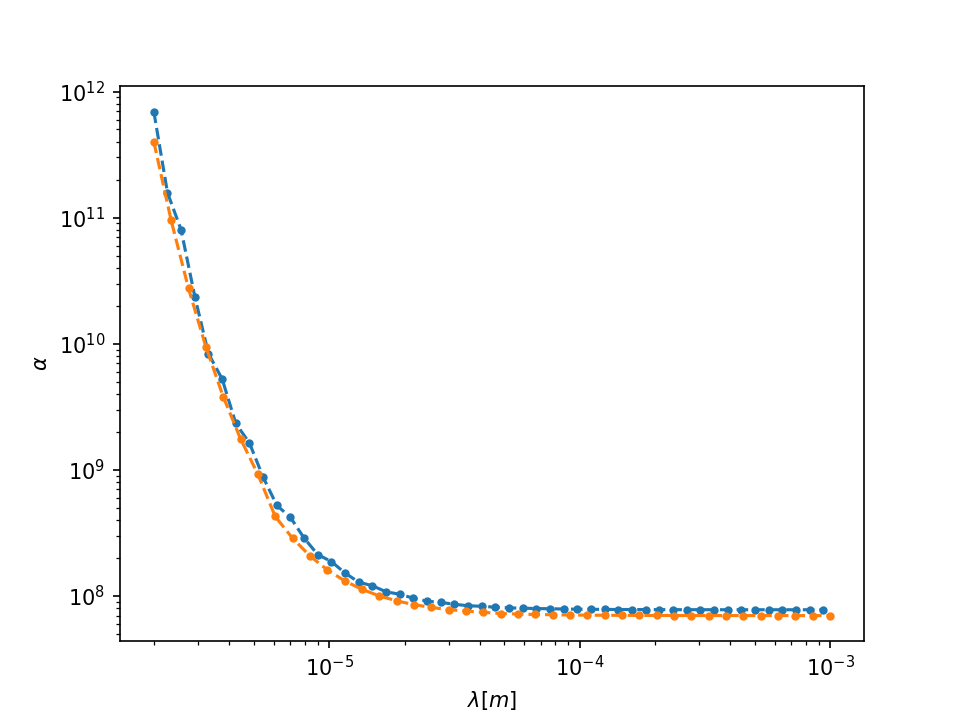

[Text(0, 0.5, '$\\alpha$'), Text(0.5, 0, '$\\lambda [m]$')]

In [529]:
_,ax = plt.subplots()
ax.loglog(L[::2],np.array(limit[::2])*1e8,'.--', label='small grid')
ax.loglog(L2[::],np.array(limit2[::])*1e8,'.--', label='shaking378-3')
# ax.loglog(L[::2],np.array(limit2[::2])*1e8,'.--')
ax.set(xlabel='$\lambda [m]$', ylabel=r'$\alpha$')

In [516]:
lim_array = np.array([L[::2],np.array(limit[::2])])

In [520]:
!pwd

/home/analysis_user/New_trap_code/Scripts/DM search


In [521]:
np.savetxt("/home/analysis_user/New_trap_code/Scripts/DM search/tmp.csv", lim_array)

In [522]:
tttt = np.loadtxt("/home/analysis_user/New_trap_code/Scripts/DM search/tmp.csv")
tttt.shape

(2, 50)